# Reference

- https://www.kaggle.com/datasets/theforcecoder/wind-power-forecasting/data
- https://www.sciencedirect.com/science/article/abs/pii/S0925231201007020
- Optimization of missing value imputation for neural networks
- https://arxiv.org/ftp/arxiv/papers/0704/0704.3474.pdf
- https://arxiv.org/abs/2302.10902

# Import

In [75]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
from sklearn.preprocessing import PowerTransformer, MinMaxScaler

from sklearn.impute import KNNImputer

import tensorflow as tf

import sklearn.metrics as metrics

In [76]:
path ='./Turbine_Data.csv'
data_df = pd.read_csv(path)
data_df.rename(columns={'Unnamed: 0':'Timestamp'},inplace=True)
data_df['Timestamp'] = pd.to_datetime(data_df['Timestamp'])
data_df.drop(['WTG'],axis=1,inplace=True)

In [77]:
entry_time_diff = 10 # 10 minute difference
test_period_days = 15
valid_period_days = 15

def day_to_sample_len(days, sample_timespan):
    return (days * 24 * 60) // sample_timespan

test_len = day_to_sample_len(test_period_days, entry_time_diff)
valid_len = day_to_sample_len(valid_period_days, entry_time_diff)
train_len = len(data_df) - test_len - valid_len

train_set = data_df[:train_len]
valid_set = data_df[train_len:(train_len+valid_len)]
test_set  = data_df[(train_len+valid_len):]

# Analiza

In [78]:
plt.style.use('dark_background')
sns.set_palette("flare")

## Statistics

In [79]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113904 entries, 0 to 113903
Data columns (total 21 columns):
 #   Column                        Non-Null Count   Dtype              
---  ------                        --------------   -----              
 0   Timestamp                     113904 non-null  datetime64[ns, UTC]
 1   ActivePower                   90443 non-null   float64            
 2   AmbientTemperatue             89960 non-null   float64            
 3   BearingShaftTemperature       58664 non-null   float64            
 4   Blade1PitchAngle              37689 non-null   float64            
 5   Blade2PitchAngle              37584 non-null   float64            
 6   Blade3PitchAngle              37584 non-null   float64            
 7   ControlBoxTemperature         58308 non-null   float64            
 8   GearboxBearingTemperature     58686 non-null   float64            
 9   GearboxOilTemperature         58581 non-null   float64            
 10  GeneratorRPM        

In [80]:
train_set.describe()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
count,90443.000000,89960.000000,58664.000000,37689.000000,37584.000000,37584.000000,58308.0,58686.000000,58581.000000,58438.000000,58570.000000,58592.000000,58553.000000,58653.000000,67980.000000,90441.000000,58270.000000,5.860100e+04,67980.000000,90288.000000
mean,626.114797,28.714650,42.923423,9.623666,9.910967,9.910967,0.0,64.352642,57.679677,1109.109794,72.767056,72.135625,36.771213,39.398021,197.358431,88.745886,9.973172,2.443701e+03,197.358431,5.913630
std,614.336698,4.376230,5.623370,20.689283,20.303583,20.303583,0.0,10.616193,6.422529,527.869378,22.876087,22.900584,5.276440,5.789157,90.205512,117.525931,4.714380,3.715476e+05,90.205512,2.640065
min,-38.312299,0.000000,0.000000,-43.156734,-26.443415,-26.443415,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-43.223254,0.000000,0.000000e+00,0.000000,0.000000
25%,83.685743,25.574706,39.732156,-0.942075,-0.431958,-0.431958,0.0,58.033171,54.064817,1029.847473,55.678263,54.954565,33.318612,35.611727,142.000000,-0.426717,9.231879,2.000000e+00,142.000000,3.852563
50%,409.100091,28.282997,42.847244,0.411006,0.909792,0.909792,0.0,64.941191,57.267477,1131.407832,65.918595,65.138622,36.996185,39.354167,182.000000,35.235984,10.159453,2.000000e+00,182.000000,5.586348
75%,1091.070518,31.569321,47.000606,7.957683,8.351700,8.351700,0.0,71.353026,61.552599,1525.803707,86.562889,86.055481,40.004934,43.187500,276.000000,149.246044,13.692264,2.000000e+00,276.000000,7.546368
max,1779.032433,42.405597,55.088655,90.143610,90.017830,90.017830,0.0,82.237932,70.764581,1809.941700,126.773031,126.043018,47.996185,54.250000,357.000000,403.713620,16.273495,6.574653e+07,357.000000,22.970893


In [81]:
train_set.head()

,Timestamp,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,...,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
0,2017-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2017-12-31 00:10:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2017-12-31 00:20:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2017-12-31 00:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2017-12-31 00:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Distributions

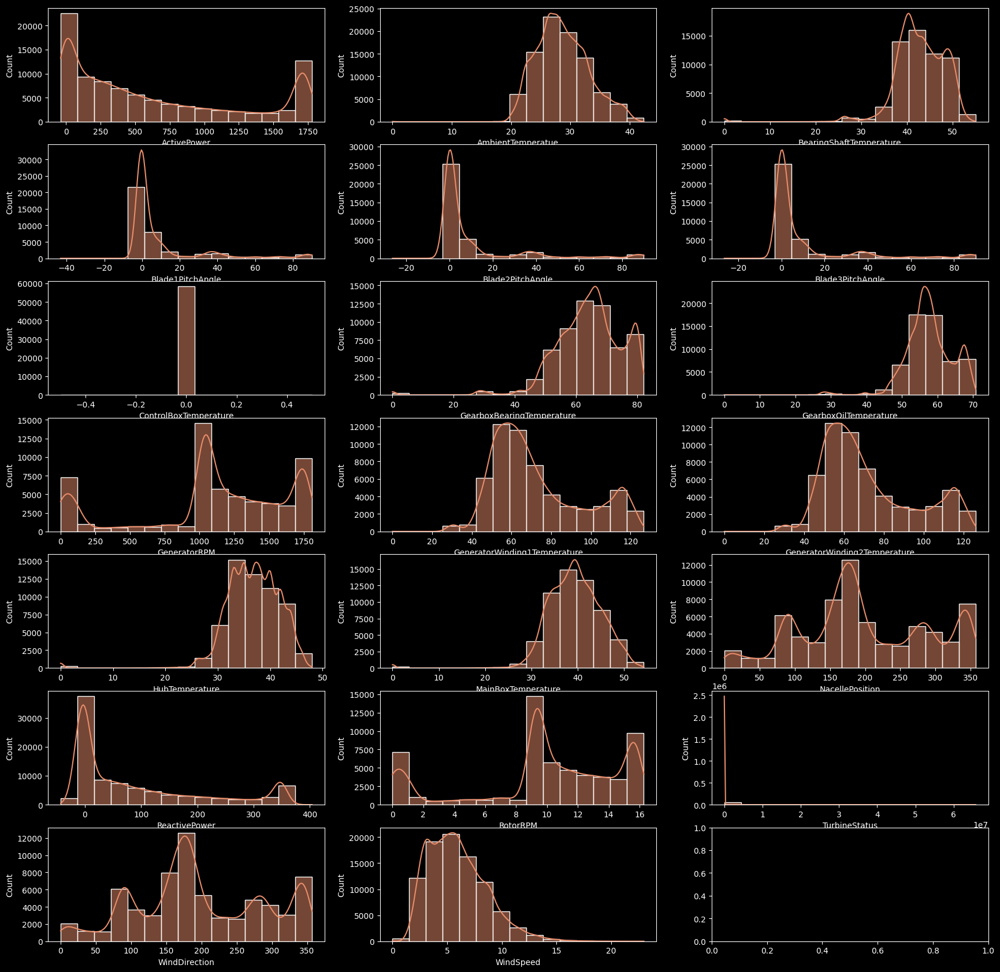

In [82]:
attributes = train_set.keys()[1:]
fig, axs = plt.subplots(len(attributes)//3+1, 3,
                        figsize=(21, 21))
for i, f in enumerate(attributes):
    sns.histplot(x=f, data=train_set,  kde=True,
                 ax=axs[i//3][i % 3], bins=15)
plt.show()

In [83]:
train_set['TurbineStatus'].describe()

count    5.860100e+04
mean     2.443701e+03
std      3.715476e+05
min      0.000000e+00
25%      2.000000e+00
50%      2.000000e+00
75%      2.000000e+00
max      6.574653e+07
Name: TurbineStatus, dtype: float64

## Distribution across time

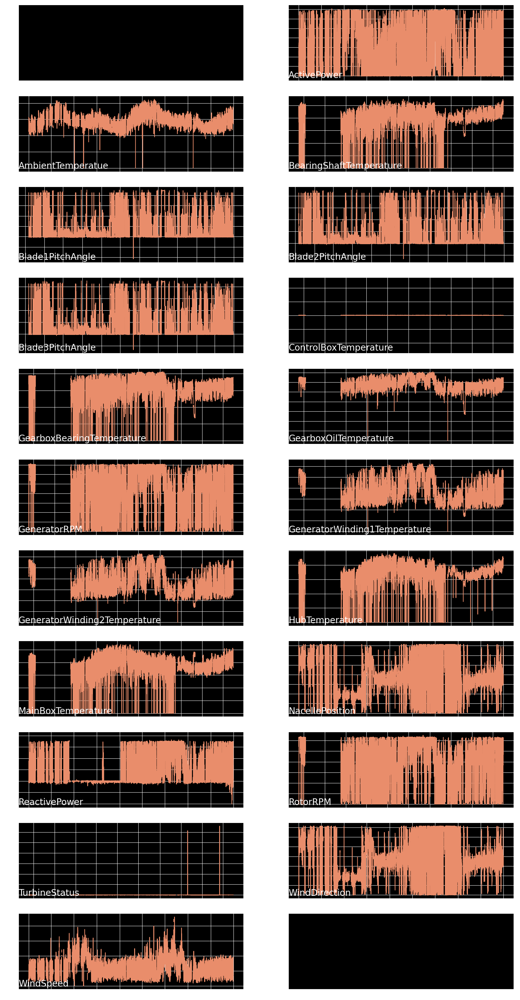

In [84]:
def plot_time(df, showNan=False):
    attributes = df.keys()[1:]

    _, axs = plt.subplots(len(attributes)//2+1, 2, figsize=(20, 40), facecolor='white')
    i = 1
    for col in attributes:
        ax = axs[i//2][i%2]
        ax.plot(df['Timestamp'], df[col] if not showNan else df[col].isna())
        ax.set_title(col, y=0, loc='left', fontsize=20)
        ax.grid(True)
        i += 1
    plt.show()
plot_time(data_df)


## NaN values

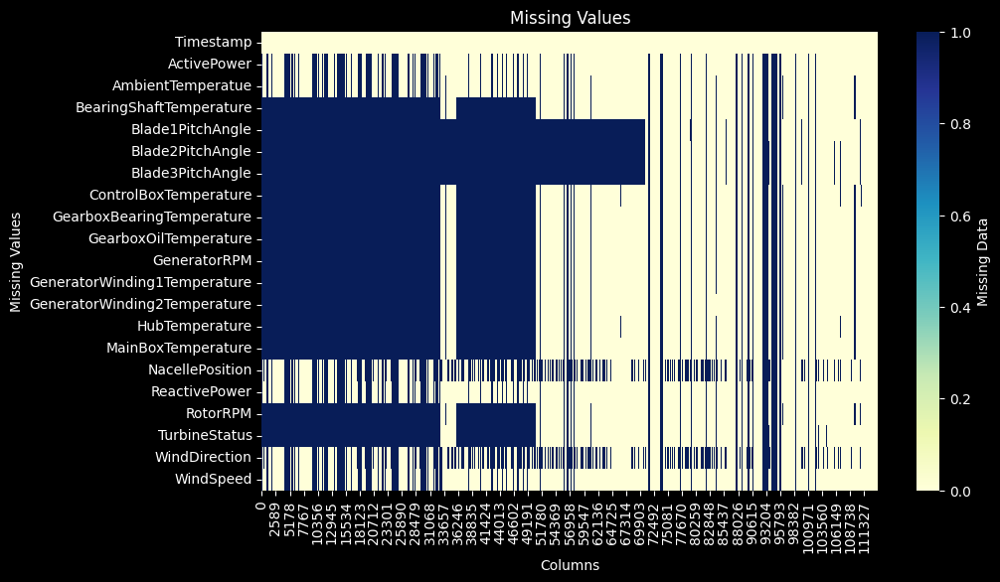

In [85]:
def plot_nulls(df):
    plt.figure(figsize=(10, 6))
    sns.heatmap(df.isna().transpose(), cmap="YlGnBu", cbar_kws={'label': 'Missing Data'})
    plt.title("Missing Values", fontsize=12)
    plt.xlabel('Columns', fontsize=10)
    plt.ylabel('Missing Values', fontsize=10)
    plt.show()
plot_nulls(train_set)

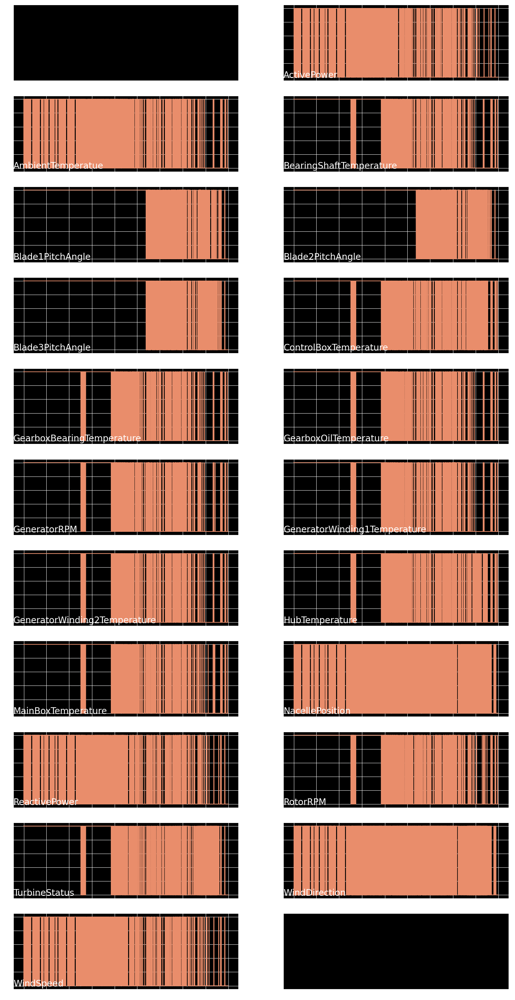

In [86]:
plot_time(data_df, showNan=True)

## Correlation

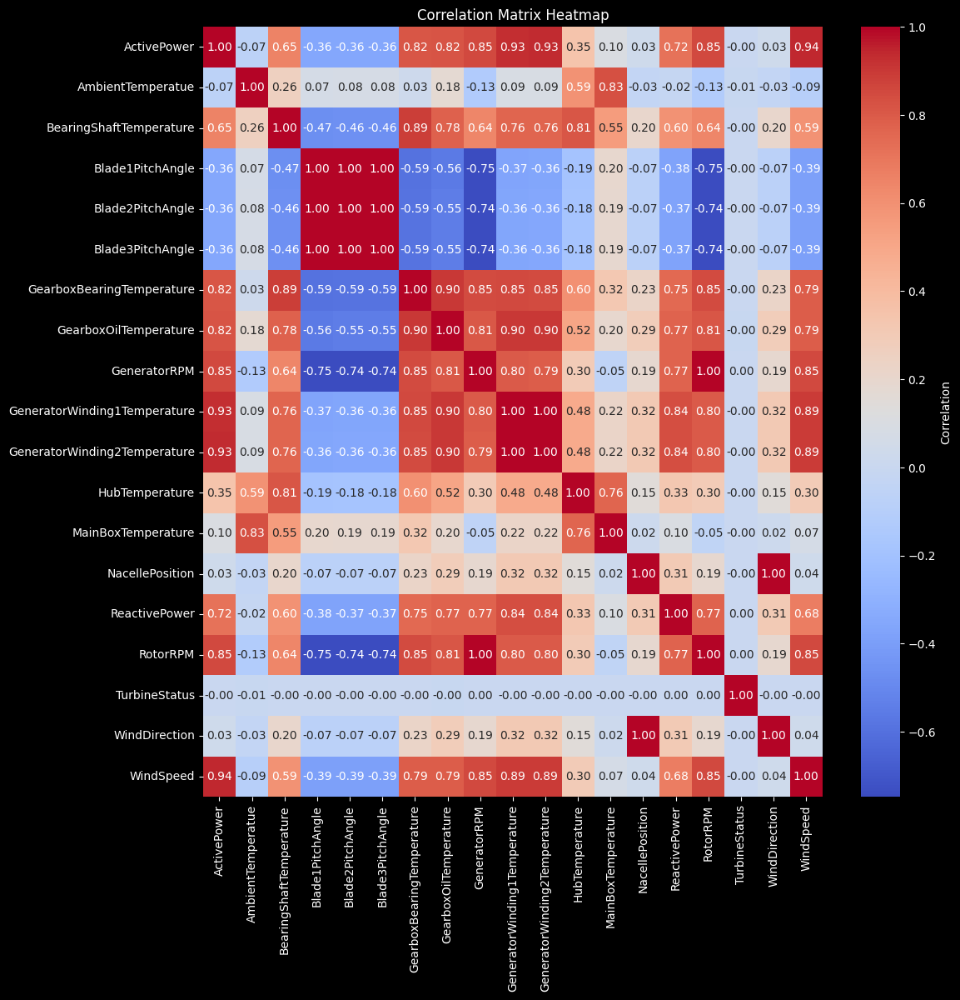

In [87]:
def correlation_heatmap(df, cols):
    corr_matrix = df[cols].corr()
    plt.figure(figsize=(12, 12))
    sns.heatmap(corr_matrix, cmap="coolwarm", annot=True, fmt=".2f", cbar_kws={'label': 'Correlation'})
    plt.title("Correlation Matrix Heatmap")
    plt.show()

attributes = list(train_set.keys()[1:])
attributes.remove('ControlBoxTemperature')
correlation_heatmap(train_set, attributes)

# Missing values

In [88]:
def get_longest_nan_streak(df):
    keys = df.keys()
    X = np.transpose(df.to_numpy())
    longest = 0

    streak_started = False
    streak_ind = 0
    for i in range(1,len(X)):
        for j in range(len(X[i])):
            if np.isnan(X[i][j]) and not streak_started:
                streak_started = True
                streak_ind = j
            elif not np.isnan(X[i][j]) and streak_started:
                longest = max(longest, j-streak_ind)
                streak_started = False

    return longest
l_streak = get_longest_nan_streak(train_set)

In [89]:
def impute_average(df, window_size = 10, is_reversed = False):
    r = range(0,len(df)) if not is_reversed else range(len(df),-1,-1)

    keys = df.keys()
    X = np.transpose(df.to_numpy())

    for i in range(1,len(X)):
        window = [0 for _ in range(window_size)]
        ind = 0
    
        for j in r:
            if np.isnan(X[i][j]):
                X[i][j] = np.average(window)
            window[ind] = X[i][j]
            ind = (ind+1)%window_size

    return pd.DataFrame(np.transpose(X),columns=keys)

def impute_last_known(df, is_reversed = False):
    r = range(0,len(df)) if not is_reversed else range(len(df),-1,-1)

    keys = df.keys()
    X = np.transpose(df.to_numpy())

    for i in range(1,len(X)):
        last_val = 0
        for j in r:
            if np.isnan(X[i][j]):
                X[i][j] = last_val
            else:
                last_val = X[i][j]

    return pd.DataFrame(np.transpose(X),columns=keys)

def impute_knn(df, n_neighbors, window_size):
    keys = df.keys()
    X = np.transpose(df.to_numpy())
    knn = KNNImputer(n_neighbors=n_neighbors)
    for i in range(1,len(X)):
        j = 0
        print(f"Atribut {i} processing...")
        while j<len(X[i]):
            if j+window_size<len(X[i]):
                try:
                    X[i][j:j+window_size] = knn.fit_transform(X[i][j:j+window_size].reshape(-1,1)).reshape(1,-1)
                except ValueError as e:
                    print(X[i][j:j+window_size])
            else:
                X[i][j:] = knn.fit_transform(X[i][j:].reshape(-1,1)).reshape(1,-1)
            j+=window_size

    return pd.DataFrame(np.transpose(X),columns=keys)


In [90]:
avg_train = impute_average(train_set, window_size=6000)
lk_train = impute_last_known(train_set)

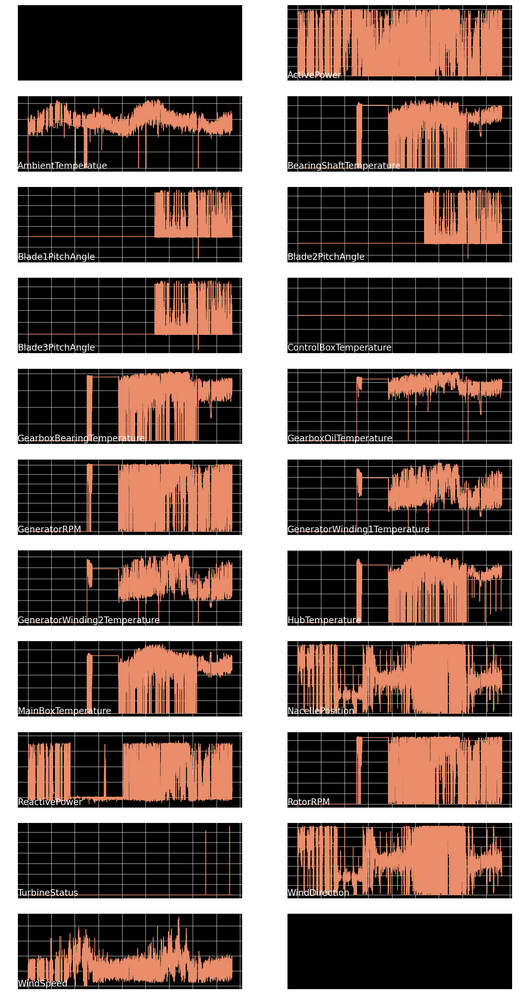

In [91]:
plot_time(lk_train)

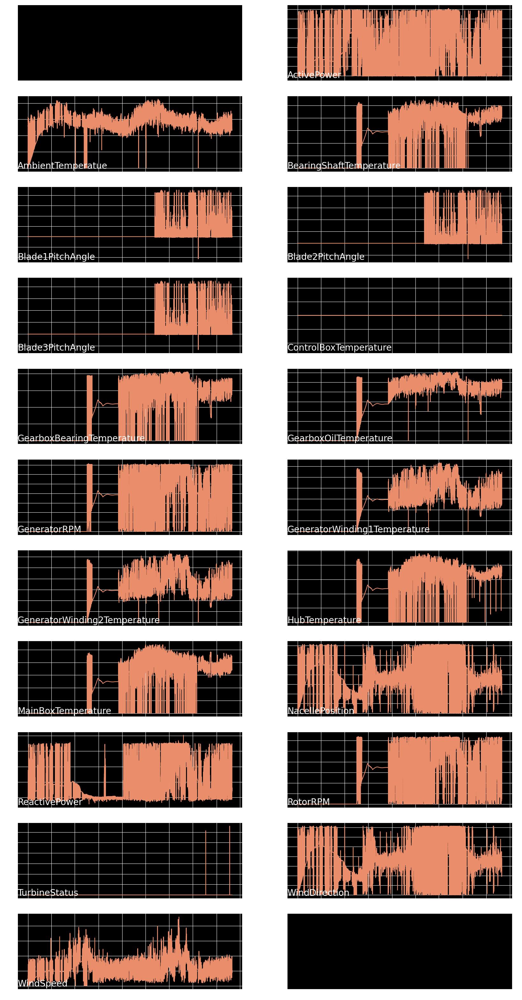

In [92]:
plot_time(avg_train)

In [94]:
knn_train = impute_knn(train_set, 100, l_streak + 100)

Atribut 1 processing...
Atribut 2 processing...
Atribut 3 processing...
Atribut 4 processing...
Atribut 5 processing...
Atribut 6 processing...
Atribut 7 processing...
Atribut 8 processing...
Atribut 9 processing...
Atribut 10 processing...
Atribut 11 processing...
Atribut 12 processing...
Atribut 13 processing...
Atribut 14 processing...
Atribut 15 processing...
Atribut 16 processing...
Atribut 17 processing...
Atribut 18 processing...
Atribut 19 processing...
Atribut 20 processing...


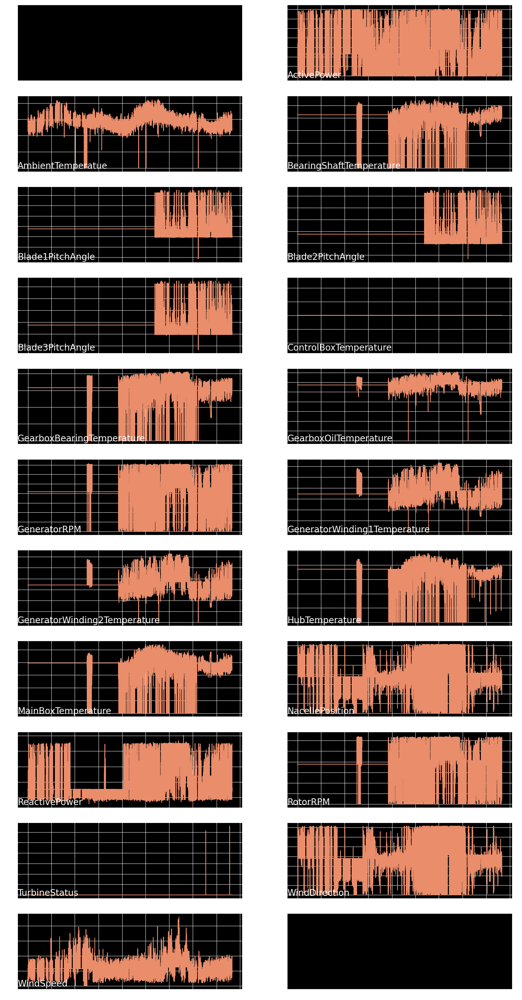

In [95]:
plot_time(knn_train)

# Priprema za trening

## Transformacije

In [96]:
def apply_yeo_johnson(df, columns, skew_threshold=1.0):
    transformations = {i: [None] for i in columns}
    data_to_ret = df.copy()
    for col in columns:
        if col in df.columns:
            skewness = df[col].skew()
            if abs(skewness) > skew_threshold:
                pt = PowerTransformer(method='yeo-johnson')
                transformed_col = pt.fit_transform(data_to_ret[[col]])
                data_to_ret[col] = transformed_col.flatten()
                transformations[col] = [pt]
        else:
            print("Column ", col, " not in the dataframe")

    return (transformations,data_to_ret)

def apply_minmax_scaler(df, columns, transformations):
    data_to_ret = df.copy()
    for col in columns:
        if col in df.columns:
            mm = MinMaxScaler()
            transformed_col = mm.fit_transform(data_to_ret[[col]])
            data_to_ret[col] = transformed_col.flatten()
            transformations[col].append(mm)
        else:
            print("Column ", col, " not in the dataframe")
    return (transformations,data_to_ret)

def apply_transforms(X, transformations):
    X_to_ret = X.copy()
    for col in transformations.keys():
        for transf in transformations[col]:
            if transf is None: continue
            transformed_col = transf.transform(X_to_ret[[col]])
            X_to_ret[col] = transformed_col.flatten()
    return X_to_ret

In [97]:
attributes = list(train_set.keys()[1:])
transformations_stand, normalized_data_stand = apply_yeo_johnson(train_set, attributes, 0)
transformations_stand, transf_data_stand = apply_minmax_scaler(normalized_data_stand, attributes, transformations_stand)
test_stand = apply_transforms(test_set,transformations=transformations_stand)
valid_stand = apply_transforms(valid_set,transformations=transformations_stand)

In [98]:
transformations_mean, normalized_data_mean = apply_yeo_johnson(avg_train, attributes, 0)
transformations_mean, transf_data_mean = apply_minmax_scaler(normalized_data_mean, attributes, transformations_mean)
test_mean = apply_transforms(test_set,transformations=transformations_mean)
valid_mean = apply_transforms(valid_set,transformations=transformations_mean)

In [99]:
transformations_knn, normalized_data_knn = apply_yeo_johnson(knn_train, attributes, 0)
transformations_knn, transf_data_knn = apply_minmax_scaler(normalized_data_stand, attributes, transformations_knn)
test_knn = apply_transforms(test_set,transformations=transformations_knn)
valid_knn = apply_transforms(valid_set,transformations=transformations_knn)

C:\Users\Danilo\AppData\Local\Temp\ipykernel_2312\715146215.py:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(x=f, data=transf_data_stand,  kde=True,
C:\Users\Danilo\AppData\Local\Temp\ipykernel_2312\715146215.py:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(x=f, data=transf_data_stand,  kde=True,
C:\Users\Danilo\AppData\Local\Temp\ipykernel_2312\715146215.py:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(x=f, data=transf_data_stand,  kde=True,
C:\Users\Danilo\AppData\Local\Temp\ipykernel_2312\715146215.py:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(x=f, data=transf_data_stand,  kde=True,
C:\Users\Danilo\AppData\Local\Temp\ipykernel_2312\715146215.py:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(x=f, data=transf_data_stand,  kde=True,
C:\Users\D

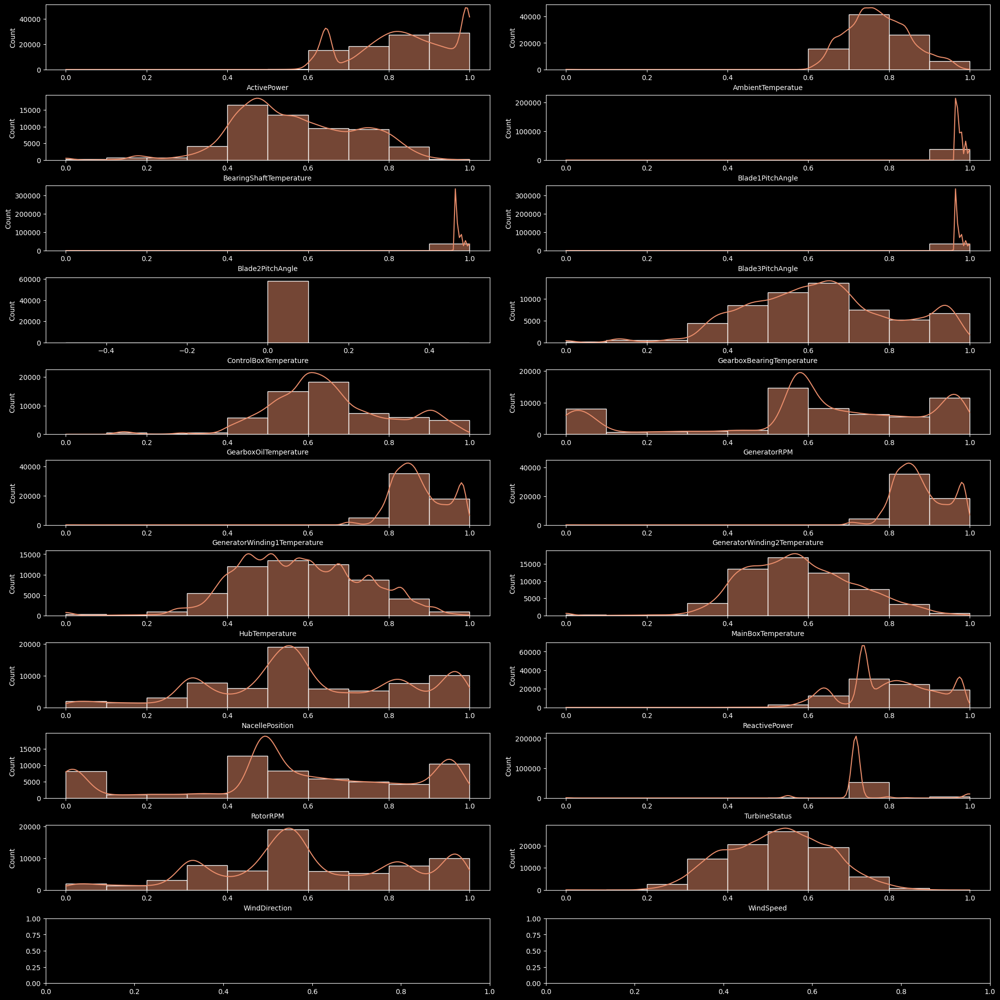

In [100]:
attributes = transf_data_stand.keys()[1:]
fig, axs = plt.subplots(len(attributes)//2+1, 2,
                        figsize=(20, 20), constrained_layout=True)
for i, f in enumerate(attributes):
    sns.histplot(x=f, data=transf_data_stand,  kde=True,
                 ax=axs[i//2][i % 2], bins=10, palette=sns.color_palette("flare"))

plt.show()

## Prozori

In [101]:
def get_nan_percentage(df):
    nan_count = 0
    for x in df[0]:
        if np.isnan(x): nan_count+=1
    return nan_count/len(df)

def generate_windows(df, target, timestamp_col, window_size_hours=1, timestep_size_minutes = 10, step=1):
    X, y = [], []
    data_values = df.drop(columns=[target,timestamp_col])
    window_size_entries = (window_size_hours*60)//timestep_size_minutes
    for i in range(0, len(df) - window_size_entries, step):
        y_val = df.iloc[i+window_size_entries][target]
        if np.isnan(y_val):
            continue
        X_val = data_values.iloc[i:i+window_size_entries].values
        if pd.isnull(X_val).any():
            continue
        X.append(X_val)
        y.append(y_val)
    return np.array(X), np.array(y)

In [102]:
def remove_nan_rows(X, y):
    nan_rows = np.any(np.isnan(X), axis=1)
    indices = np.where(nan_rows)[0]
    uniques = []
    for ind in indices:
        if ind not in uniques: uniques.append(ind)
    return np.delete(X, uniques, 0), np.delete(y, uniques, 0)

In [103]:
X_train_stand, y_train_stand = generate_windows(transf_data_stand,'ActivePower','Timestamp',step=1)
X_valid_stand, y_valid_stand = generate_windows(valid_stand,'ActivePower','Timestamp')
X_test_stand, y_test_stand = generate_windows(test_stand,'ActivePower','Timestamp')

In [104]:
X_train_mean, y_train_mean = generate_windows(transf_data_mean,'ActivePower','Timestamp',step=1)
X_valid_mean, y_valid_mean = generate_windows(valid_mean,'ActivePower','Timestamp')
X_test_mean, y_test_mean = generate_windows(test_mean,'ActivePower','Timestamp')

In [105]:
X_train_knn, y_train_knn = generate_windows(transf_data_knn,'ActivePower','Timestamp',step=1)
X_valid_knn, y_valid_knn = generate_windows(valid_knn,'ActivePower','Timestamp')
X_test_knn, y_test_knn = generate_windows(test_knn,'ActivePower','Timestamp')

In [106]:
# to_save = []
# for x in ['X','y']:
#     for y in ['_train_','_test_','_valid_']:
#         for z in ['stand','mean','knn']:
#             to_save.append(x+y+z)

In [107]:
# load = True
# if load:
#     to_load=[path for path in to_save]
#     for l in to_load:
#         globals()[l] = np.load('./data/'+l+'.npy')

In [108]:
X_train_stand, y_train_stand = remove_nan_rows(X_train_stand, y_train_stand)
X_valid_stand, y_valid_stand = remove_nan_rows(X_valid_stand, y_valid_stand)
X_test_stand, y_test_stand = remove_nan_rows(X_test_stand, y_test_stand)

# Arhitektura

In [109]:
def plot_train_history(history):
    plt.figure(figsize=(15, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

def test_model(model, model_name, X_test, y_test):
    y_pred = model.predict(X_test).flatten()
    rmse = np.sqrt(metrics.mean_squared_error(y_test, y_pred))
    mae = metrics.mean_absolute_error(y_test, y_pred)
    r2 = metrics.r2_score(y_test, y_pred)
    all_results.loc[len(all_results)] = [model_name, rmse, mae, r2]

    plt.figure(figsize=(15, 6))
    plt.plot(y_test, label='True')
    plt.plot(y_pred, label='Predicted')
    plt.title(f'{model_name} Predictions')
    plt.legend()
    plt.show()

    print(all_results)

all_results = pd.DataFrame(columns=['Model', 'RMSE', 'MAE', 'R2'])
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=10, restore_best_weights=True)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'best_model.keras', monitor='val_loss', save_best_only=True)

In [110]:
def get_name(m):
    rez = ''
    for (i,x) in enumerate(m):
        rez += str(x)
        if i!=len(m)-1:
            rez+='x'
    return rez

## FFT

In [111]:
import tensorflow as tf
from tensorflow.signal import rfft
from tensorflow.math import real

class FFTLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(FFTLayer, self).__init__(**kwargs)

    def call(self, inputs):
        # Perform the FFT on the inputs
        fft_result = rfft(inputs)
        
        # Extract the real part of the FFT results
        real_part = real(fft_result)
        
        # Concatenate the original inputs with the real part of the FFT results
        output = tf.concat([inputs, real_part], axis=-1)
        return output


## LSTM

In [112]:
def generate_LSTM(lstm_sizes, X_shape, droput_rate, add_fft = False):
    model = tf.keras.Sequential()
    
    for (i,size) in enumerate(lstm_sizes):
        if not i==len(lstm_sizes)-1:
            model.add(tf.keras.layers.LSTM(size, input_shape=X_shape,return_sequences=True))
            if droput_rate !=0:
                model.add(tf.keras.layers.Dropout(droput_rate))
        else:
            model.add(tf.keras.layers.LSTM(size, return_sequences=False))
            if add_fft: model.add(FFTLayer())
            model.add(tf.keras.layers.Dense(size))
            model.add(tf.keras.layers.Dense(1))
    return model
    
def gen_train_LSTM(X_train, y_train, X_test, y_test, model_sizes, learn_rate, droput_rate, extra_label,fft=False):
    for model_size in model_sizes:
        model = generate_LSTM(model_size,(X_train.shape[1],X_train.shape[2]), droput_rate=droput_rate,add_fft=fft)
        model.compile(
            loss=tf.losses.MeanSquaredError(),
            optimizer=tf.optimizers.Adam(learning_rate=learn_rate),
            metrics=[tf.metrics.RootMeanSquaredError()]
        )
        model.summary()
        history = model.fit(X_train, y_train,
                            epochs=20, batch_size=32,
                            validation_split=0.1,
                            callbacks=[early_stopping, checkpoint])
        plot_train_history(history)
        test_model(model, f'LSTM_{extra_label}_{get_name(model_size)}_lr{learn_rate}_drop{droput_rate}',
                X_test, y_test)

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_29 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_16 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_30 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.1188 - root_mean_squared_error: 0.3107 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0440
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0038 - root_mean_squared_error: 0.0615 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0421
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0031 - root_mean_squared_error: 0.0559 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0028 - root_mean_squared_error: 0.0527 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0397
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0026 - root_mean_squared_error: 0.0505 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0383
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0023 - root_mean_squared_error: 0.0475 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step 

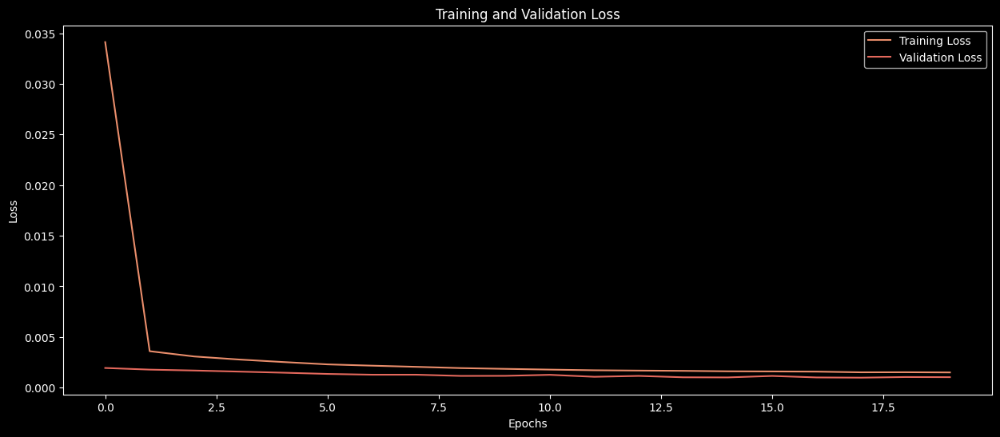

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


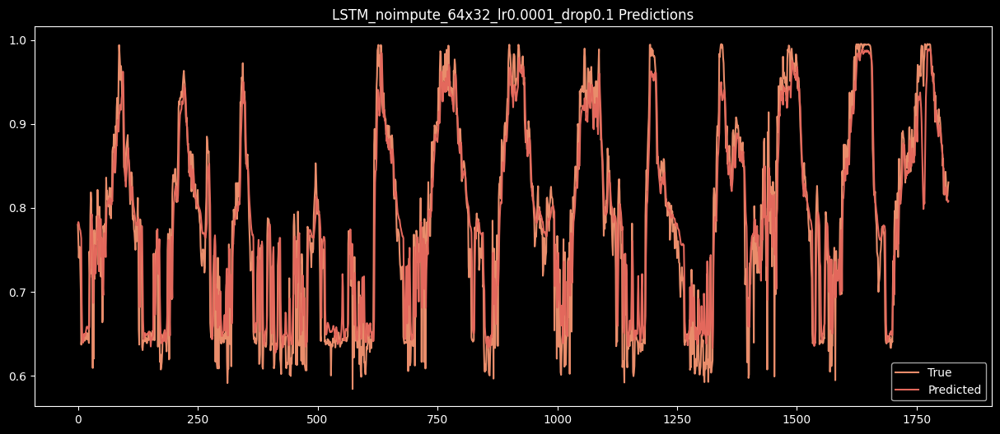

                                  Model      RMSE       MAE        R2
0  LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_31 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_17 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_32 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_18 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_33 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.1108 - root_mean_squared_error: 0.3026 - val_loss: 0.0027 - val_root_mean_squared_error: 0.0524
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0039 - root_mean_squared_error: 0.0621 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0469
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0034 - root_mean_squared_error: 0.0582 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0476
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0032 - root_mean_squared_error: 0.0569 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0464
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0549 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0471
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0029 - root_mean_squared_error: 0.0534 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0438
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step 

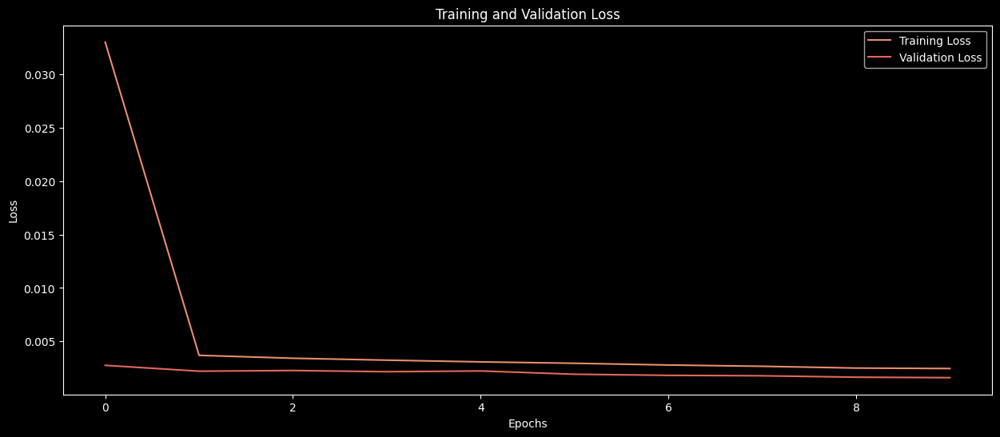

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


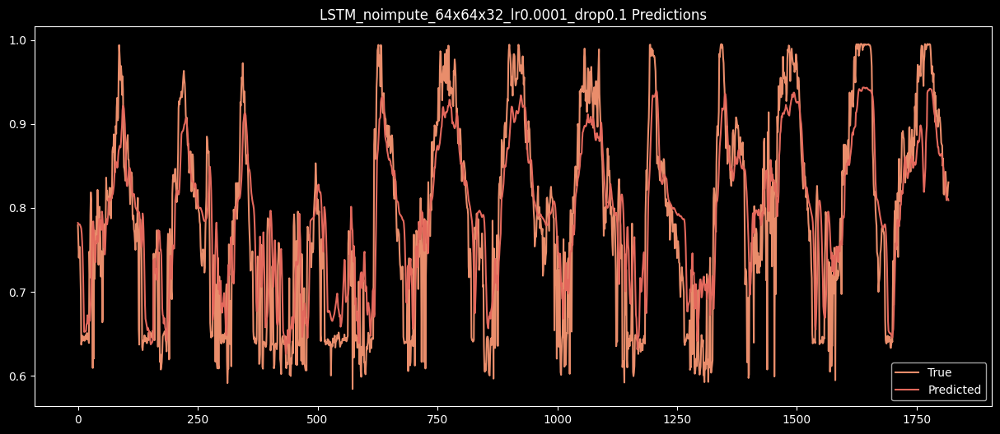

                                     Model      RMSE       MAE        R2
0     LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1  LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_34 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_19 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_35 (LSTM)                  │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_20 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_36 (LSTM)                  │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - loss: 0.1428 - root_mean_squared_error: 0.3487 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0476
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0044 - root_mean_squared_error: 0.0666 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0468
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0039 - root_mean_squared_error: 0.0626 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0466
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0036 - root_mean_squared_error: 0.0604 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0458
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0032 - root_mean_squared_error: 0.0569 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0445
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0031 - root_mean_squared_error: 0.0553 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0434
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step 

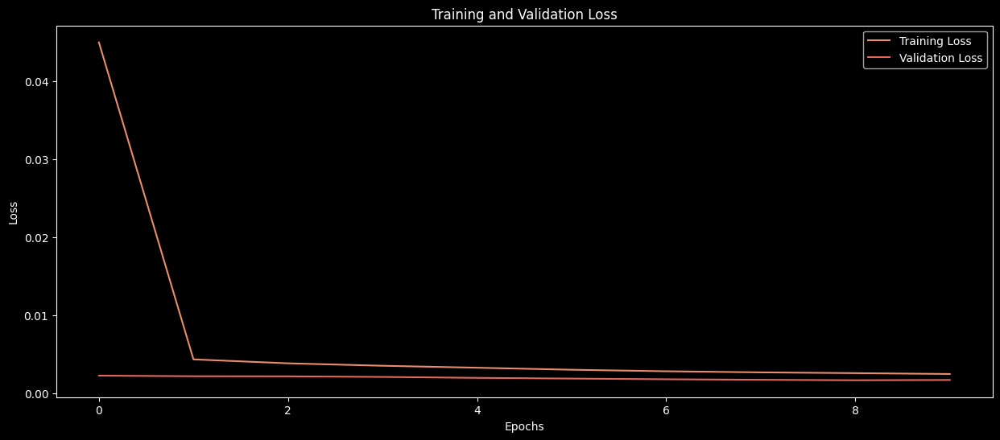

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


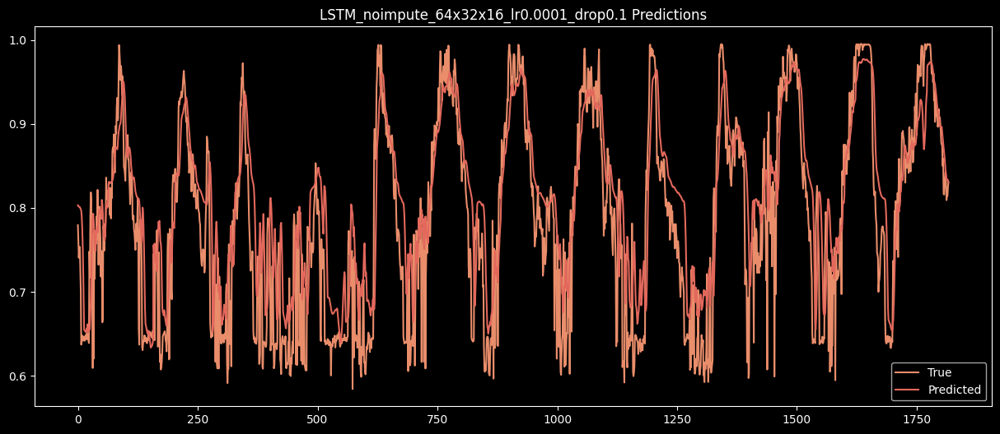

                                     Model      RMSE       MAE        R2
0     LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1  LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2  LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_37 (LSTM)                  │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_21 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_38 (LSTM)                  │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_39 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 0.1076 - root_mean_squared_error: 0.2956 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0464
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0034 - root_mean_squared_error: 0.0582 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0459
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0031 - root_mean_squared_error: 0.0553 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0447
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0030 - root_mean_squared_error: 0.0548 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0462
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0519 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0430
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0516 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0415
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

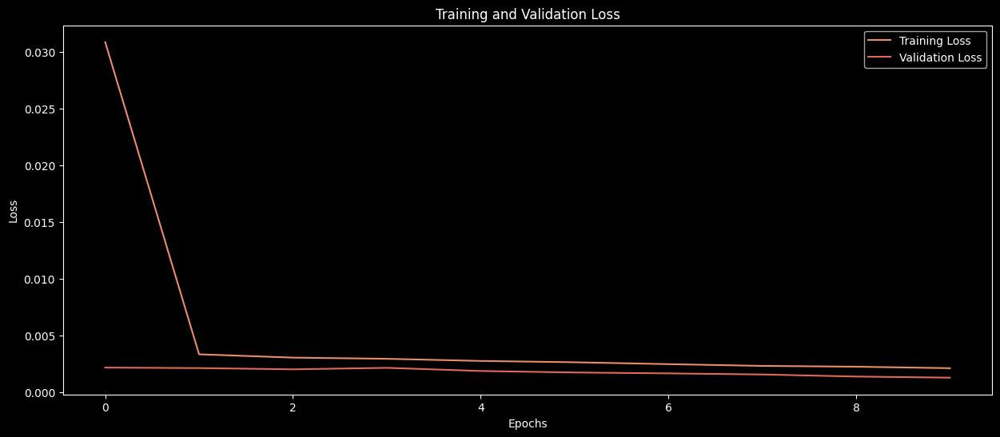

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


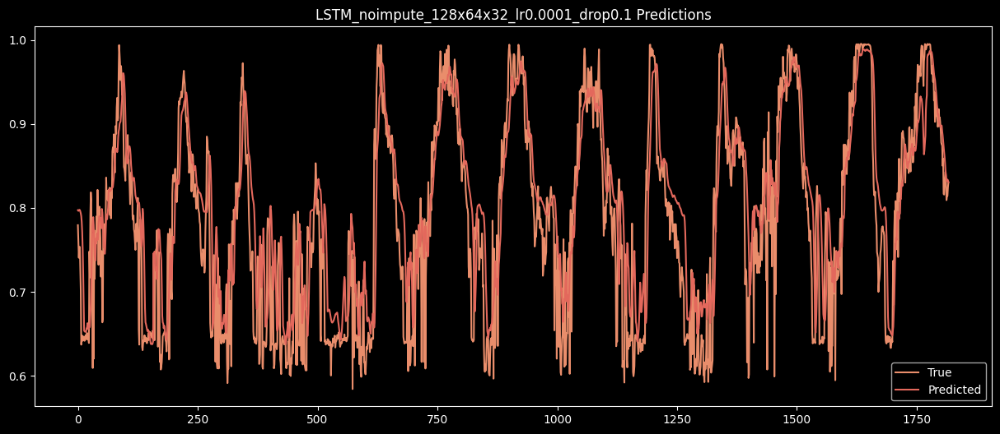

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_40 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_41 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0322 - root_mean_squared_error: 0.1532 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0422
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0498 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0020 - root_mean_squared_error: 0.0444 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0321
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0017 - root_mean_squared_error: 0.0410 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0016 - root_mean_squared_error: 0.0399 - val_loss: 9.7217e-04 - val_root_mean_squared_error: 0.0312
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/s

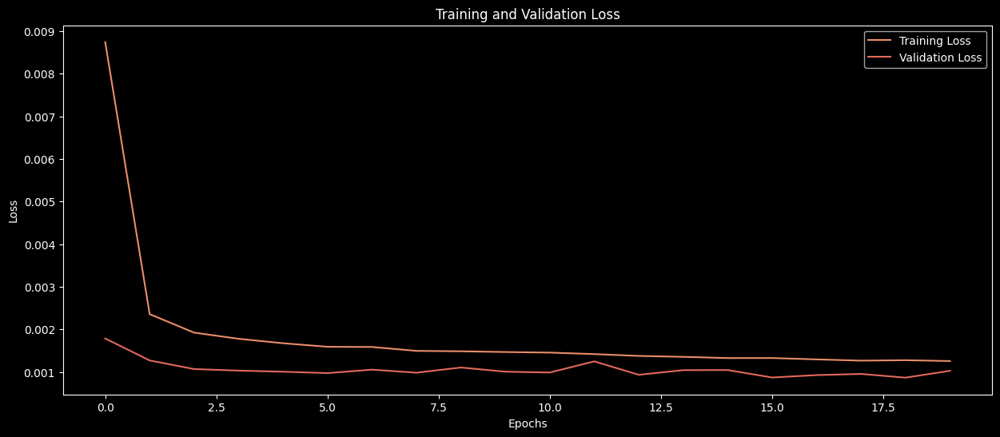

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


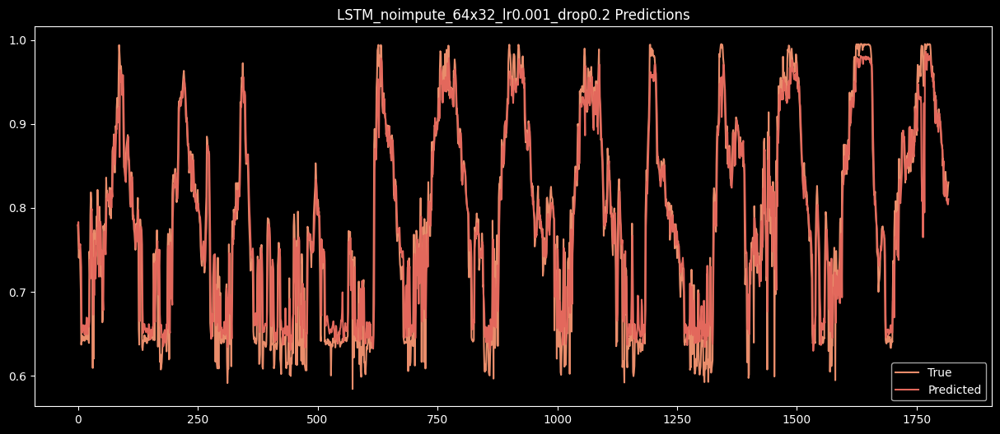

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4       LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_42 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_43 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_44 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0396 - root_mean_squared_error: 0.1721 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0438
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0548 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0418
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0023 - root_mean_squared_error: 0.0482 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0331
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0422 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0406 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step 

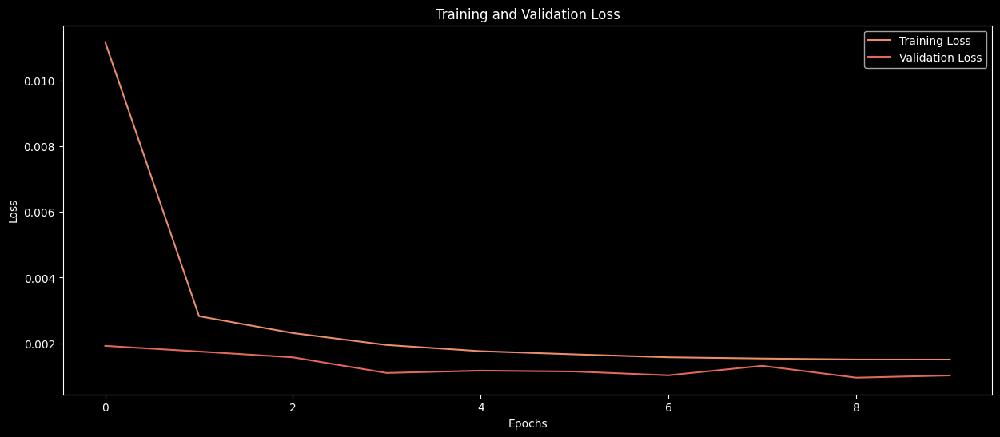

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


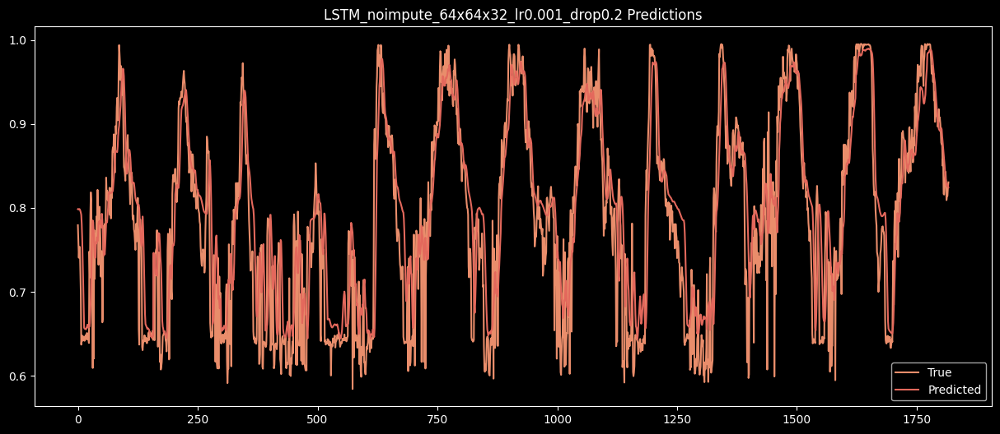

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4       LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5    LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_45 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_46 (LSTM)                  │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_47 (LSTM)                  │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0519 - root_mean_squared_error: 0.1981 - val_loss: 0.0027 - val_root_mean_squared_error: 0.0518
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0544 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0493 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0368
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0018 - root_mean_squared_error: 0.0419 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0018 - root_mean_squared_error: 0.0418 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step 

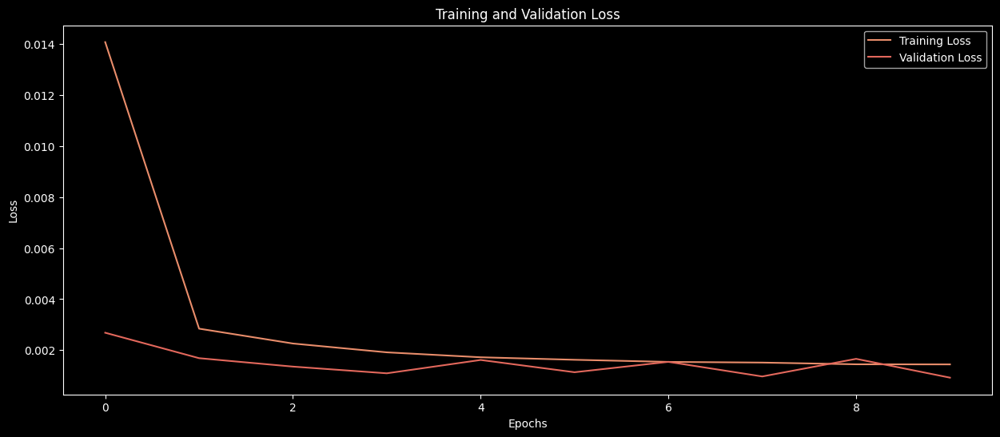

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


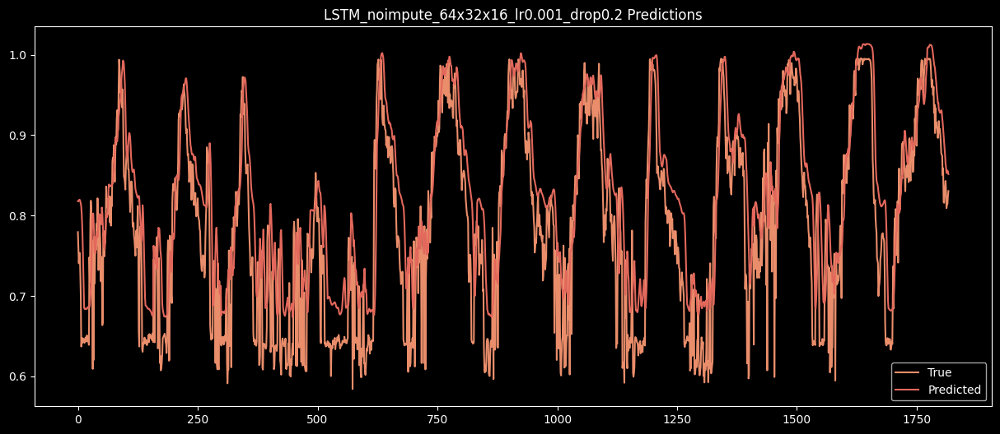

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4       LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5    LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6    LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_48 (LSTM)                  │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_28 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_49 (LSTM)                  │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_29 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_50 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0329 - root_mean_squared_error: 0.1550 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0427
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0028 - root_mean_squared_error: 0.0531 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0391
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0486 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0415 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0413 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

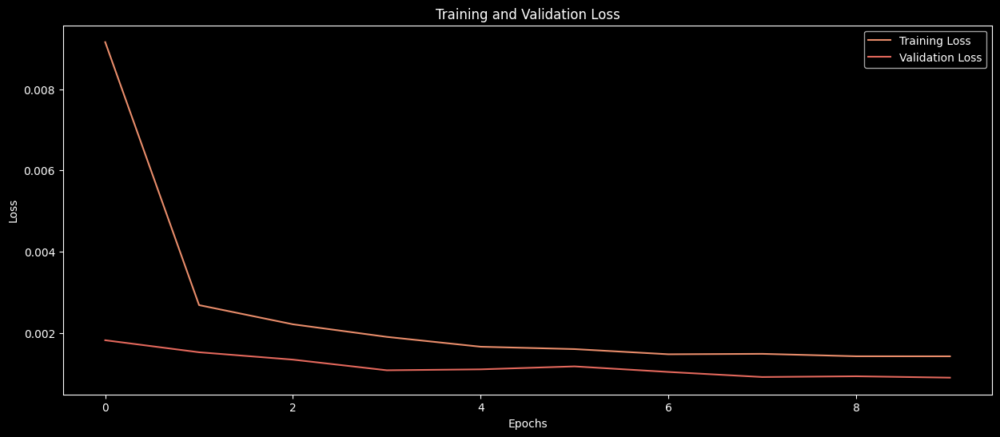

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


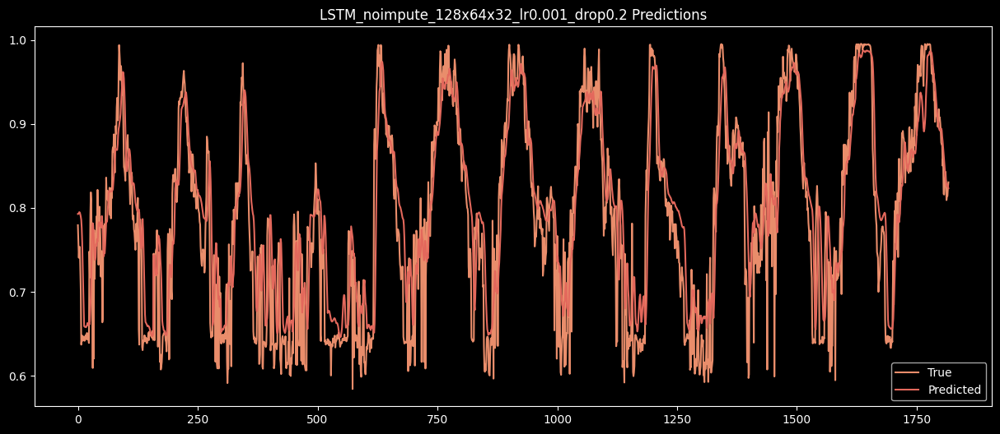

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4       LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5    LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6    LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7   LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_51 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_30 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_52 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - loss: 0.0330 - root_mean_squared_error: 0.1541 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0019 - root_mean_squared_error: 0.0432 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0359
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0016 - root_mean_squared_error: 0.0405 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0016 - root_mean_squared_error: 0.0403 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0385
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0015 - root_mean_squared_error: 0.0381 - val_loss: 9.6616e-04 - val_root_mean_squared_error: 0.0311
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0015 - root_mean_squared_error: 0.0386 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/s

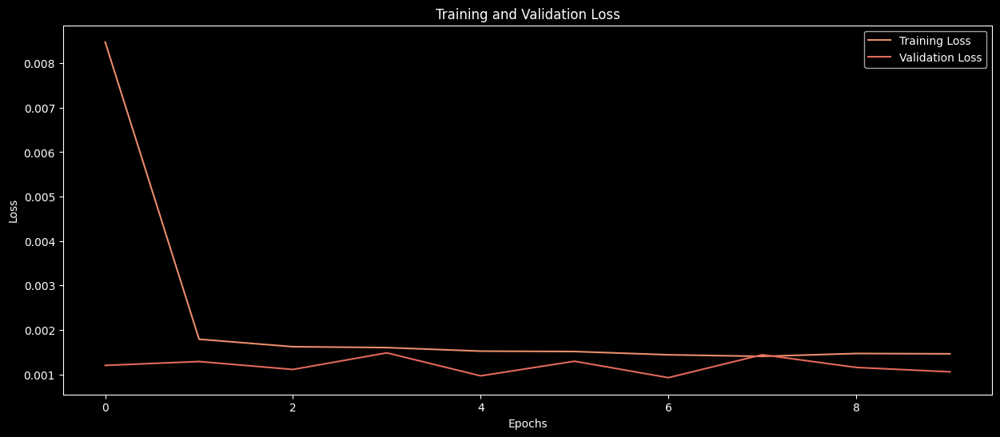

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


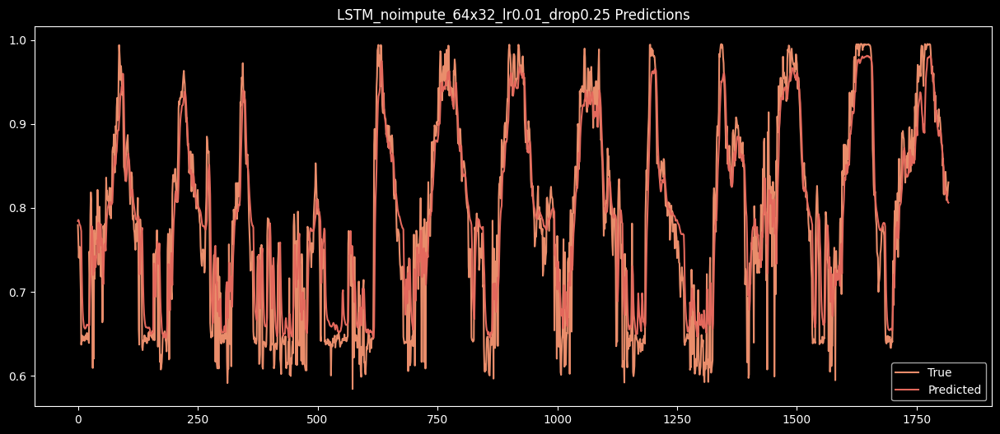

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4       LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5    LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6    LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7   LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8       LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_53 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_31 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_54 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_32 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_55 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0231 - root_mean_squared_error: 0.1305 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0390
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0455 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0320
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0402 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0015 - root_mean_squared_error: 0.0388 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0400 - val_loss: 9.5304e-04 - val_root_mean_squared_error: 0.0309
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0015 - root_mean_squared_error: 0.0385 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0436
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/

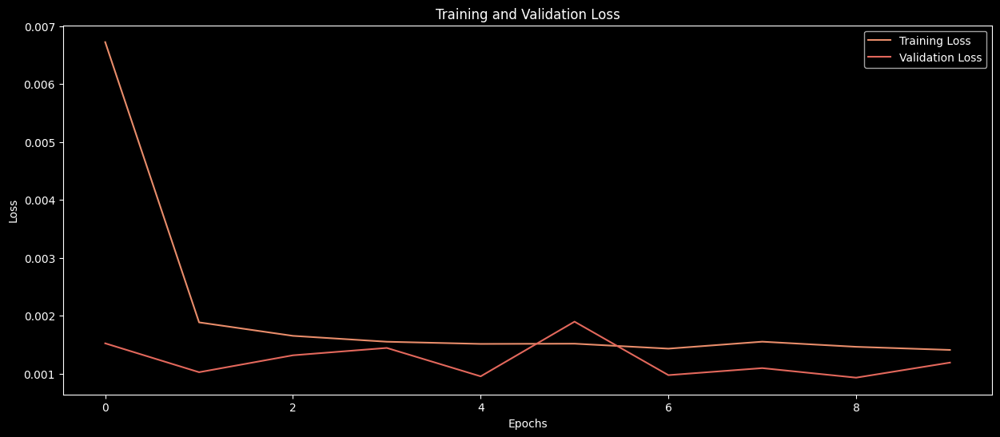

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


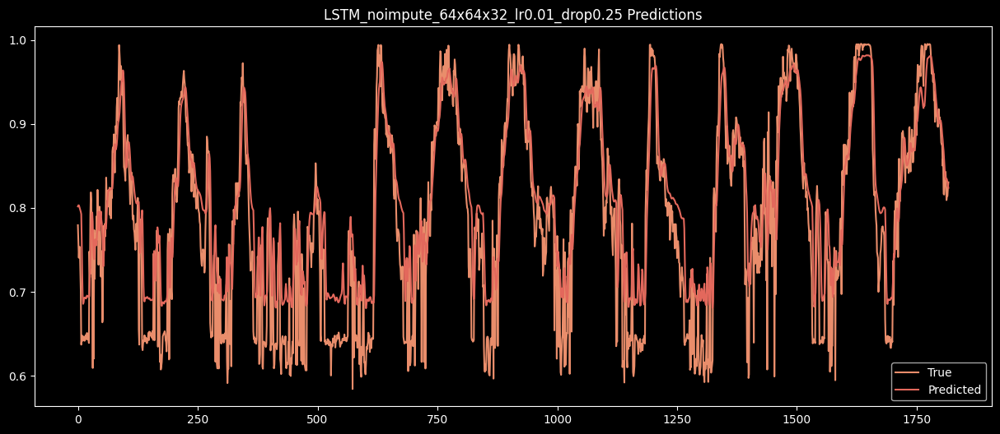

                                      Model      RMSE       MAE        R2
0      LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1   LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2   LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3  LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4       LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5    LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6    LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7   LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8       LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9    LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_56 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_33 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_57 (LSTM)                  │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_34 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_58 (LSTM)                  │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0260 - root_mean_squared_error: 0.1417 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0022 - root_mean_squared_error: 0.0469 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0439
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 9.8369e-04 - val_root_mean_squared_error: 0.0314
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0015 - root_mean_squared_error: 0.0393 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0015 - root_mean_squared_error: 0.0389 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0473
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0016 - root_mean_squared_error: 0.0395 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0378
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/s

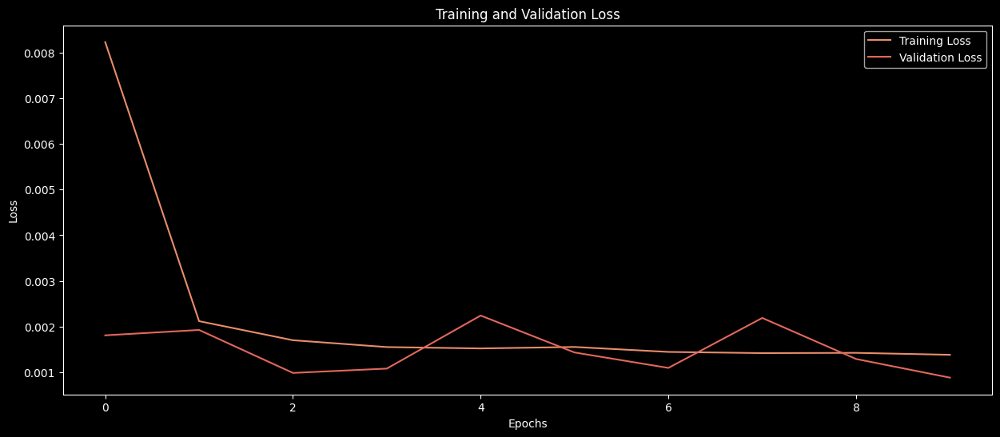

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


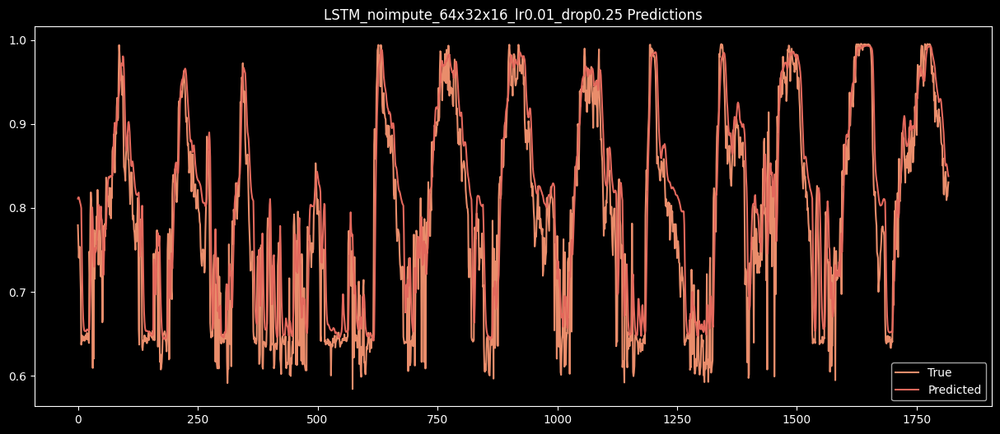

                                       Model      RMSE       MAE        R2
0       LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1    LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2    LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3   LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4        LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5     LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6     LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7    LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8        LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9     LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10    LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_59 (LSTM)                  │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_35 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_60 (LSTM)                  │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_36 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_61 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0452 - root_mean_squared_error: 0.1817 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0361
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0416 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0342
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0016 - root_mean_squared_error: 0.0395 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0381
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0015 - root_mean_squared_error: 0.0390 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0016 - root_mean_squared_error: 0.0398 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0449
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

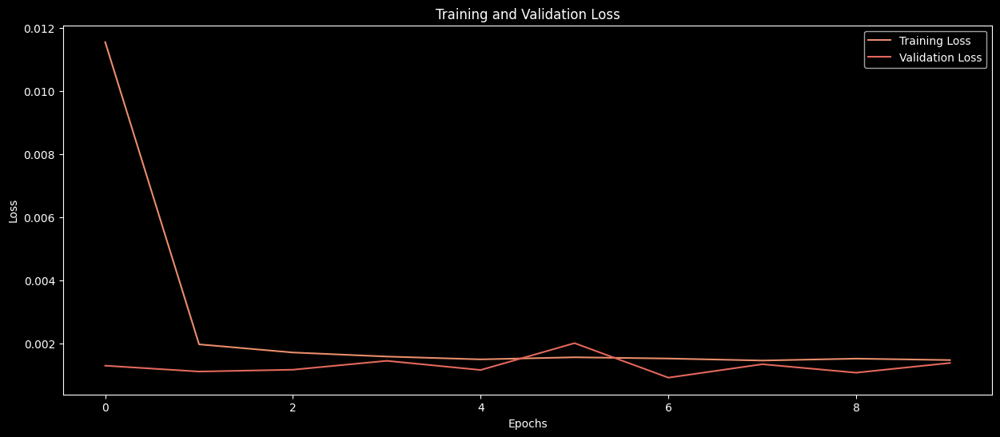

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


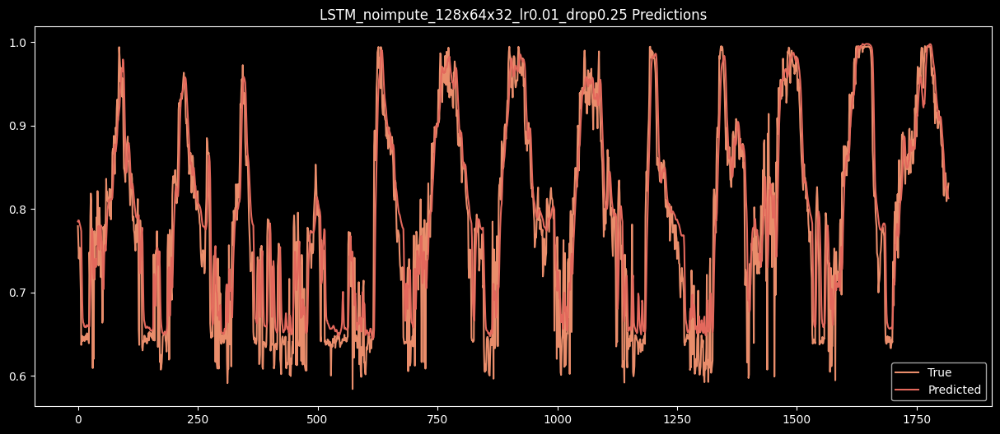

                                       Model      RMSE       MAE        R2
0       LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1    LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2    LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3   LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4        LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5     LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6     LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7    LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8        LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9     LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10    LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11   LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036149  0.832029


In [113]:
model_sizes = [[64,32],[64,64,32],[64,32,16],[128,64,32]]
gen_train_LSTM(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.0001, 0.1,'noimpute')
gen_train_LSTM(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.001, 0.2,'noimpute')
gen_train_LSTM(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.01, 0.25,'noimpute')

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_62 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_37 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_63 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 5ms/step - loss: 0.0258 - root_mean_squared_error: 0.1426 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0478
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0036 - root_mean_squared_error: 0.0599 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0030 - root_mean_squared_error: 0.0550 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0026 - root_mean_squared_error: 0.0514 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0023 - root_mean_squared_error: 0.0484 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0381
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0022 - root_mean_squared_error: 0.0474 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0392
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

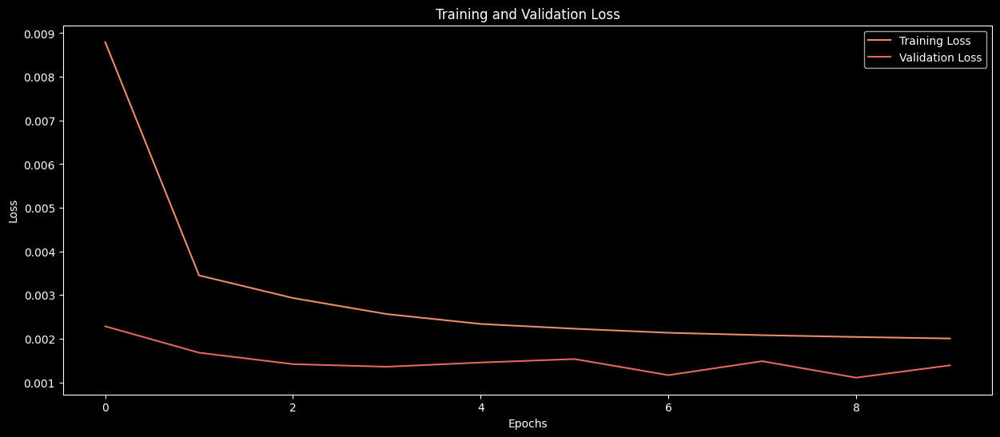

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


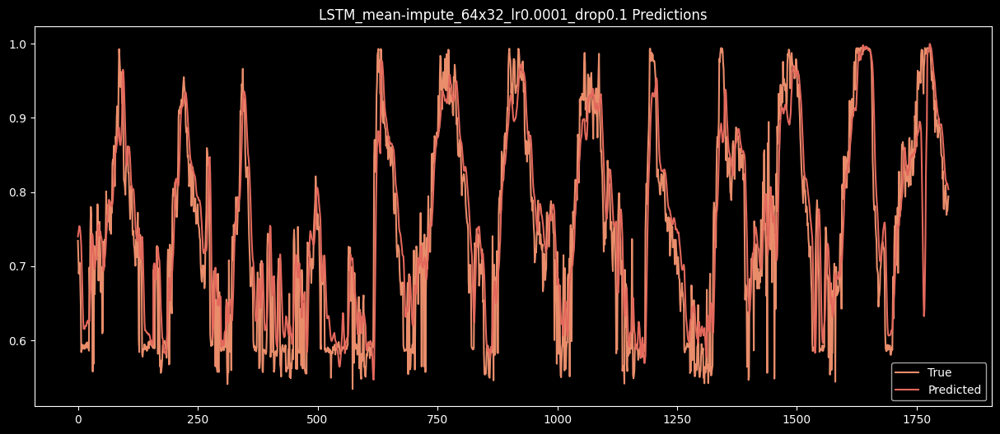

                                       Model      RMSE       MAE        R2
0       LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1    LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2    LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3   LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4        LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5     LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6     LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7    LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8        LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9     LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10    LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11   LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036149  0.832029
12   LSTM_mean-impute_64x

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_64 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_38 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_65 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_39 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_66 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 8ms/step - loss: 0.0379 - root_mean_squared_error: 0.1691 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0511
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0043 - root_mean_squared_error: 0.0654 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0495
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0036 - root_mean_squared_error: 0.0604 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0430
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0552 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0514 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0372
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0489 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0366
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

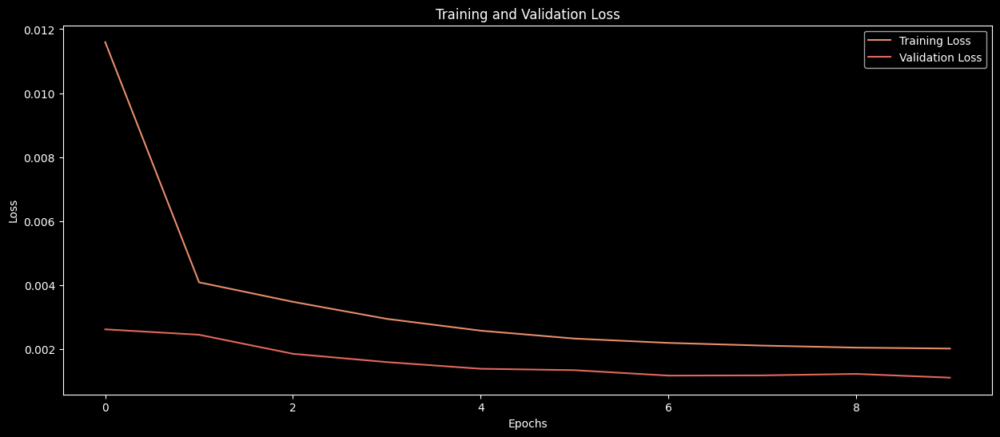

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


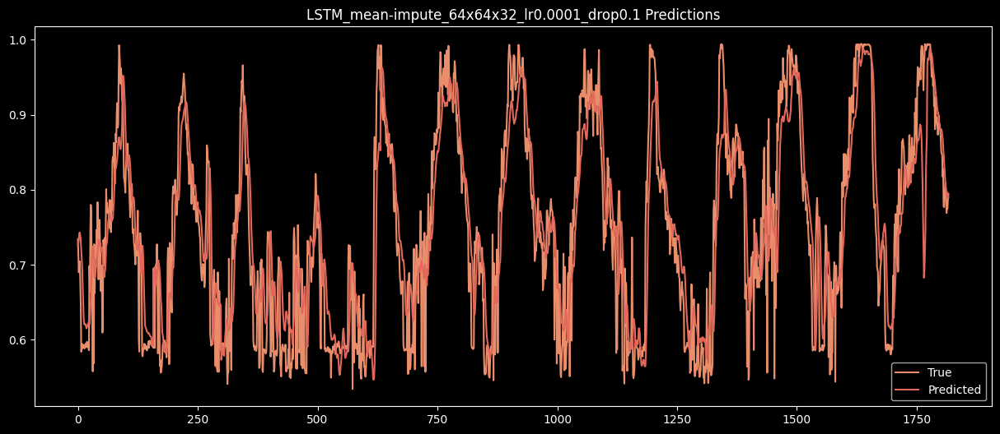

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5       LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6       LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7      LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8          LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9       LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10      LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11     LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036149  0.832029

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_67 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_40 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_68 (LSTM)                  │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_69 (LSTM)                  │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 7ms/step - loss: 0.0655 - root_mean_squared_error: 0.2234 - val_loss: 0.0027 - val_root_mean_squared_error: 0.0519
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0044 - root_mean_squared_error: 0.0661 - val_loss: 0.0025 - val_root_mean_squared_error: 0.0501
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0038 - root_mean_squared_error: 0.0613 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0453
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0033 - root_mean_squared_error: 0.0572 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0404
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0028 - root_mean_squared_error: 0.0533 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0025 - root_mean_squared_error: 0.0503 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

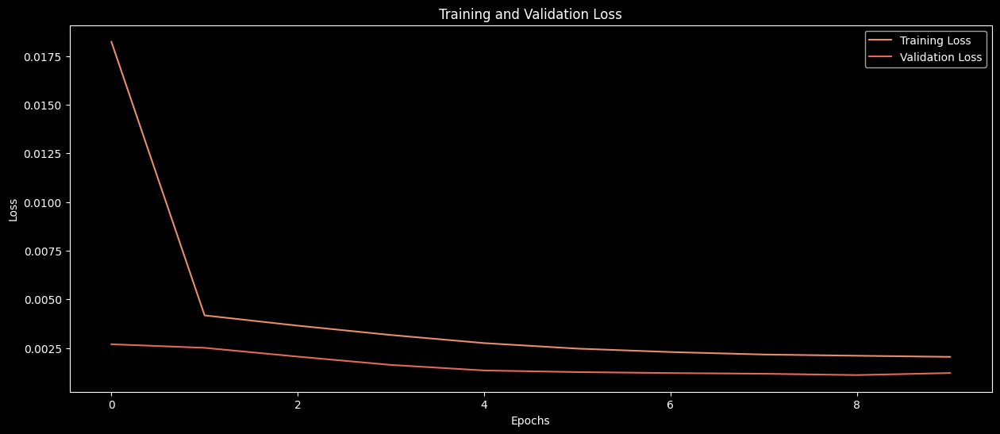

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


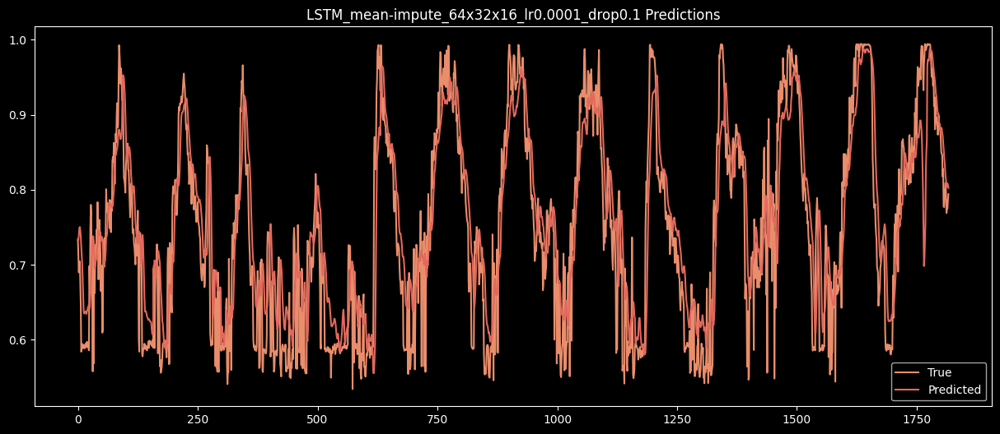

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5       LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6       LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7      LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8          LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9       LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10      LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11     LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036149  0.832029

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_70 (LSTM)                  │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_42 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_71 (LSTM)                  │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_43 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_72 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 9ms/step - loss: 0.0282 - root_mean_squared_error: 0.1459 - val_loss: 0.0025 - val_root_mean_squared_error: 0.0495
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0038 - root_mean_squared_error: 0.0618 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0437
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0032 - root_mean_squared_error: 0.0561 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0516 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0490 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0022 - root_mean_squared_error: 0.0469 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0343
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

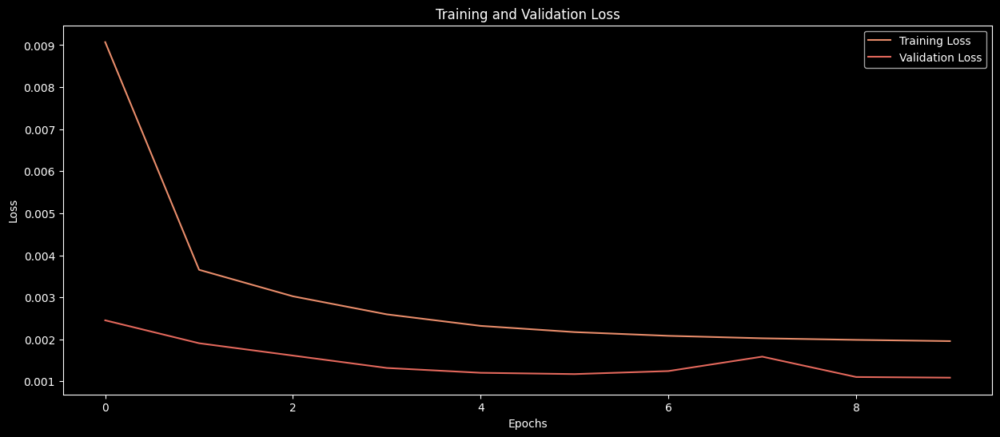

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


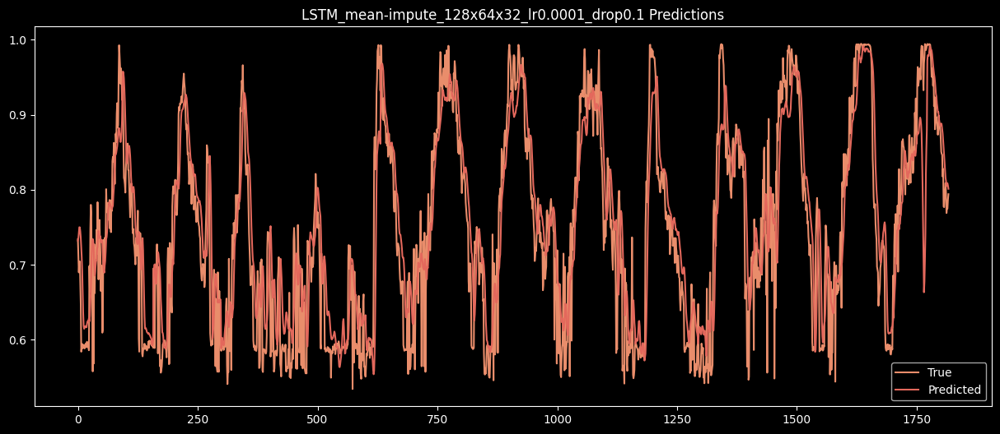

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_73 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_44 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_74 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 5ms/step - loss: 0.0106 - root_mean_squared_error: 0.0919 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0400
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0495 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0339
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

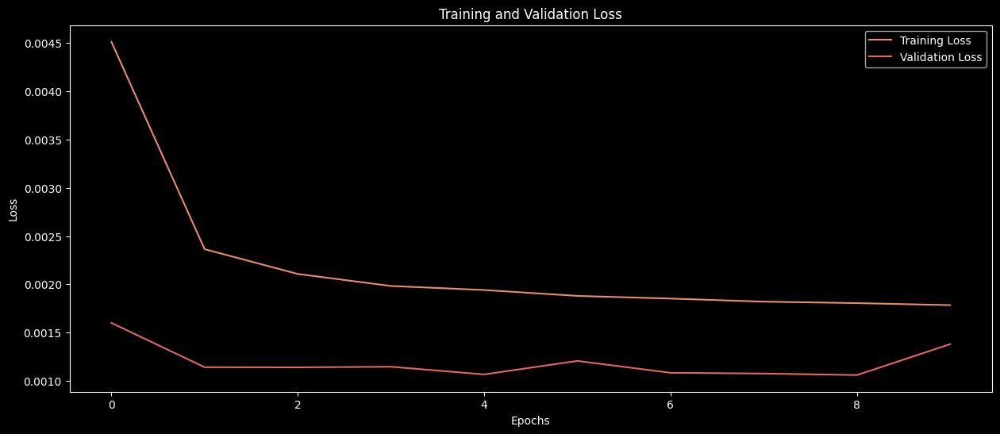

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


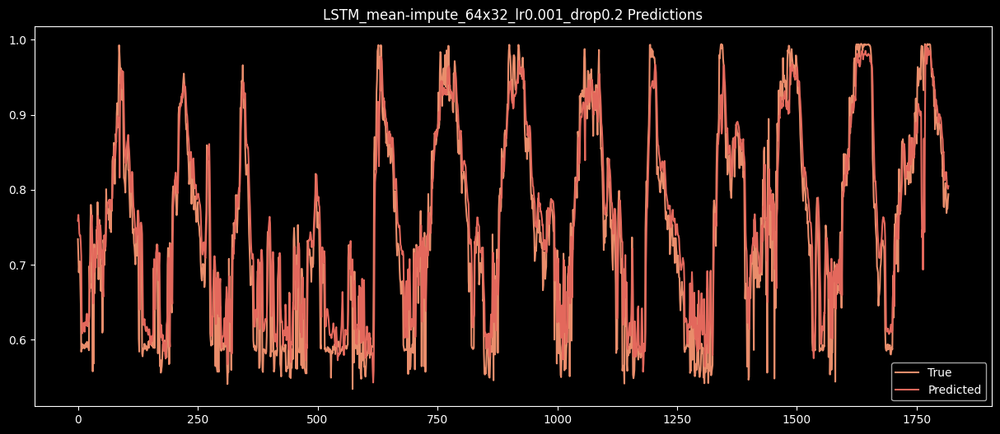

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_75 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_45 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_76 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_46 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_77 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 30s 8ms/step - loss: 0.0130 - root_mean_squared_error: 0.1001 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0387
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0487 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0329
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0446 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0351
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0440 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0400
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

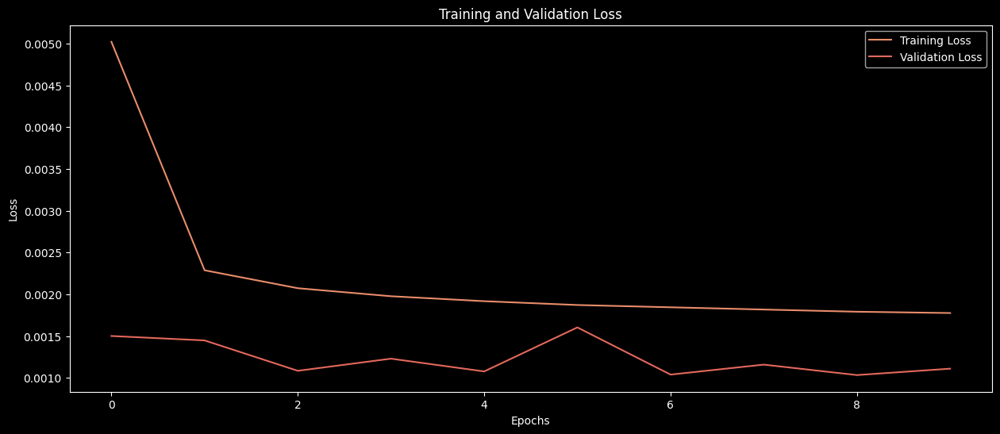

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


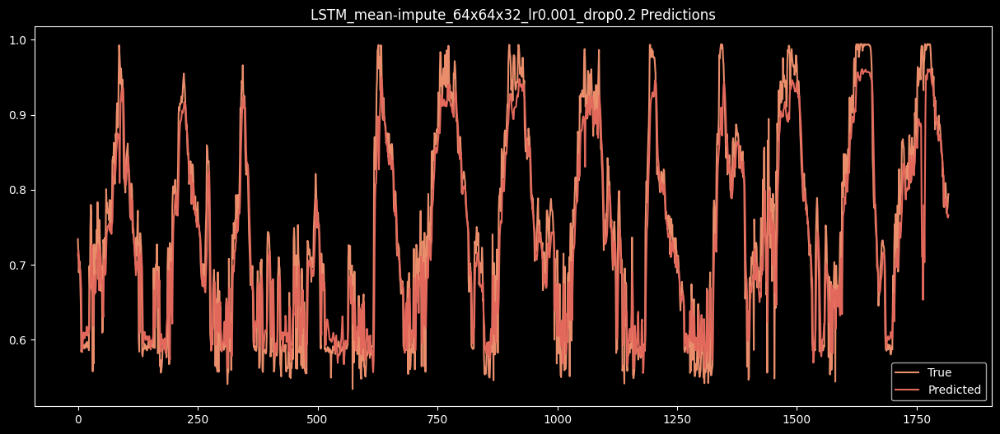

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_78 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_47 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_79 (LSTM)                  │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_48 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_80 (LSTM)                  │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 7ms/step - loss: 0.0127 - root_mean_squared_error: 0.1003 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0372
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0025 - root_mean_squared_error: 0.0500 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0022 - root_mean_squared_error: 0.0464 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0343
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0019 - root_mean_squared_error: 0.0438 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

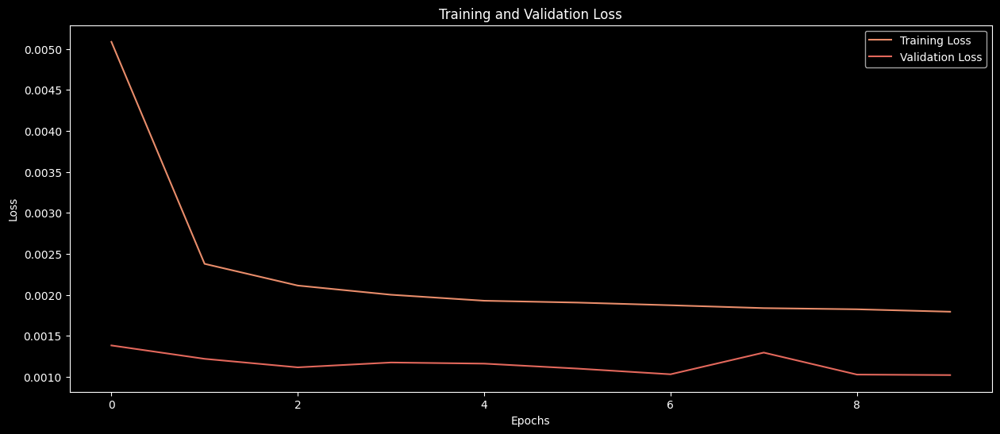

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


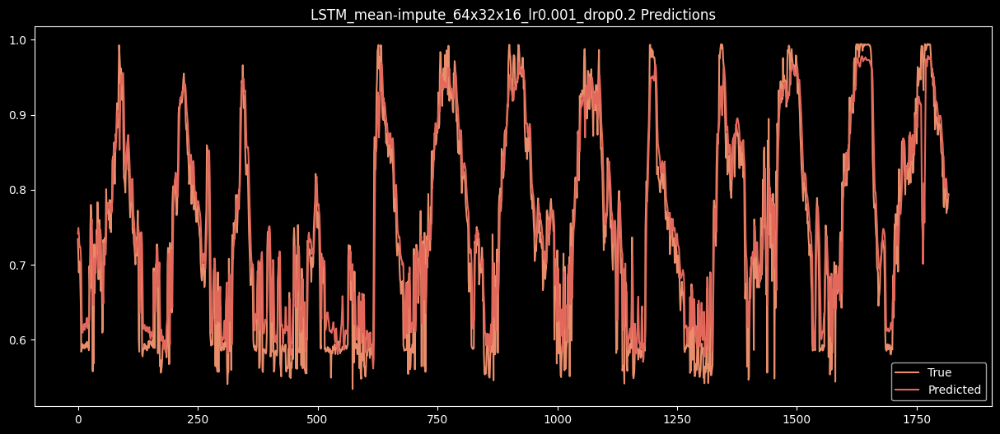

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_81 (LSTM)                  │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_49 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_82 (LSTM)                  │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_50 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_83 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 36s 10ms/step - loss: 0.0116 - root_mean_squared_error: 0.0955 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0407
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0023 - root_mean_squared_error: 0.0484 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0413
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0453 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 30s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0432 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 7/20
3204/3204 ━━━━━━━━

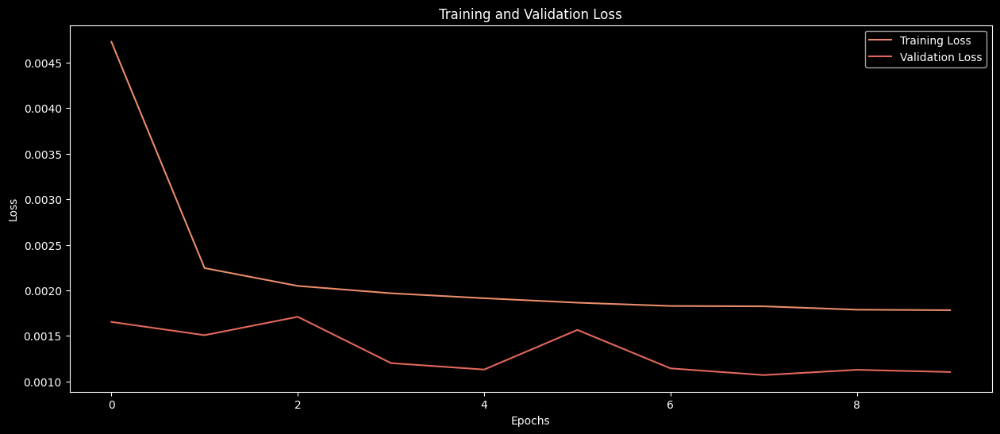

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


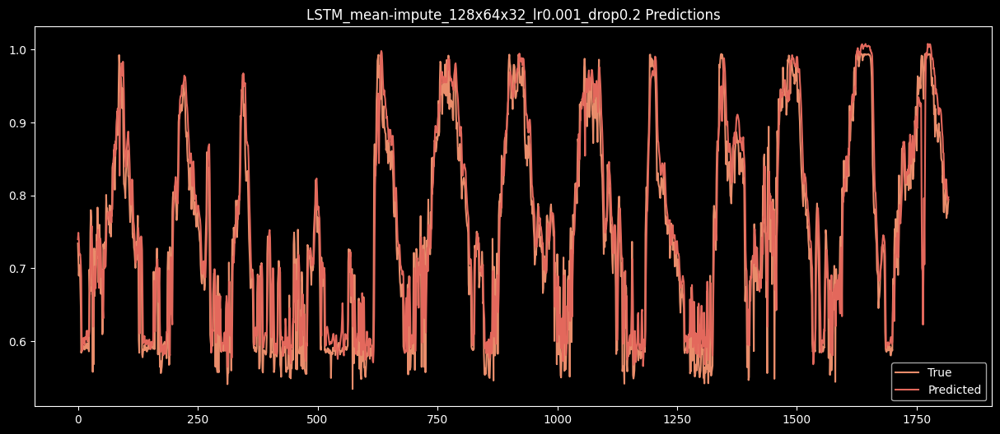

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_84 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_51 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_85 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 20s 5ms/step - loss: 0.0077 - root_mean_squared_error: 0.0794 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0458 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 16s 5ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

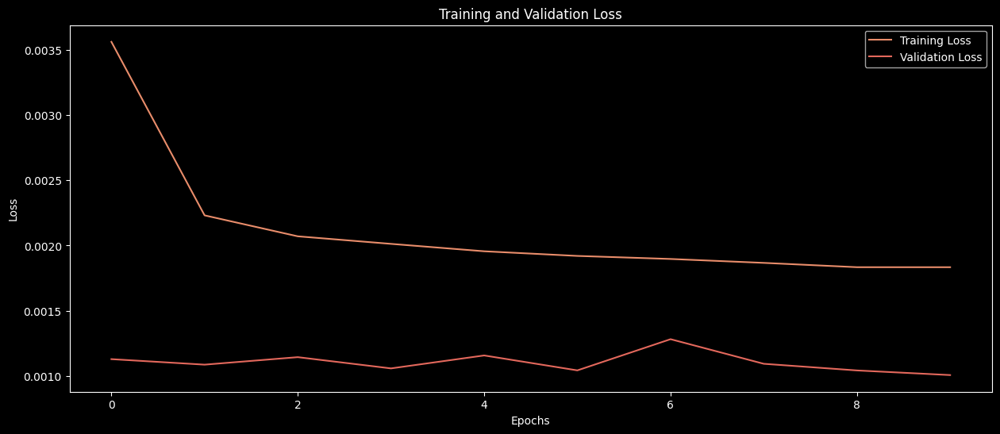

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


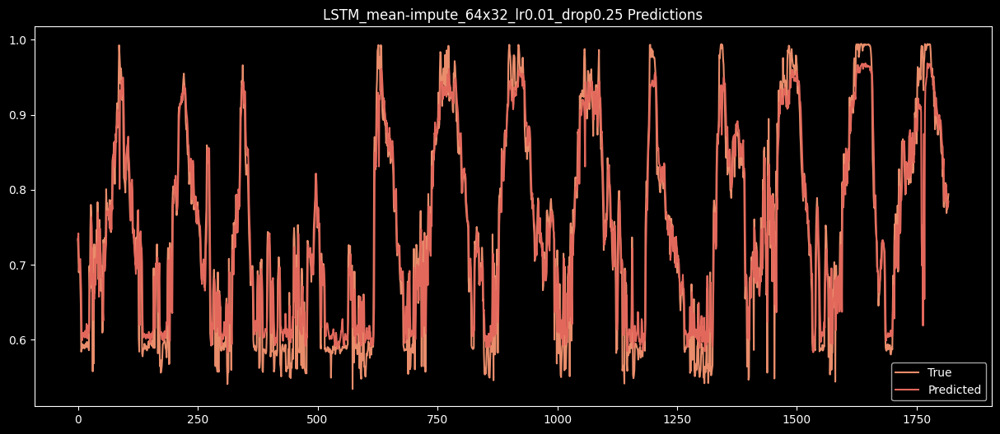

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_86 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_52 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_87 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_53 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_88 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 8ms/step - loss: 0.0087 - root_mean_squared_error: 0.0835 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0485 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0443
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0339
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

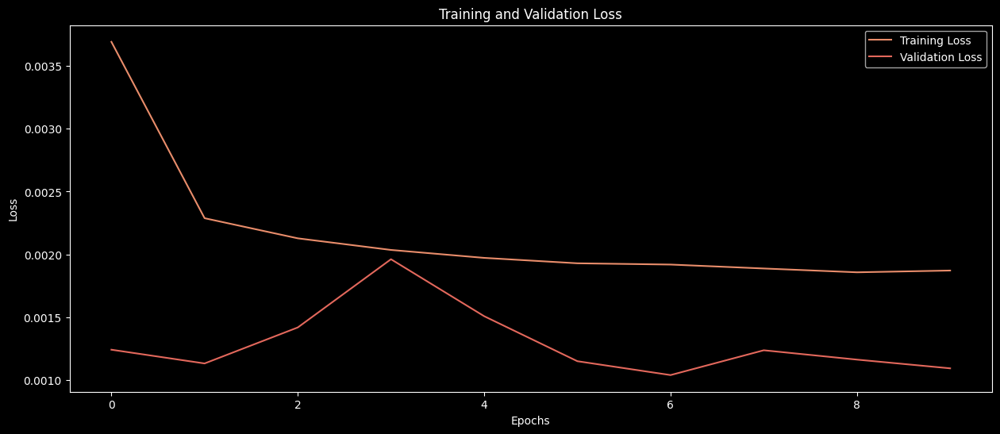

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


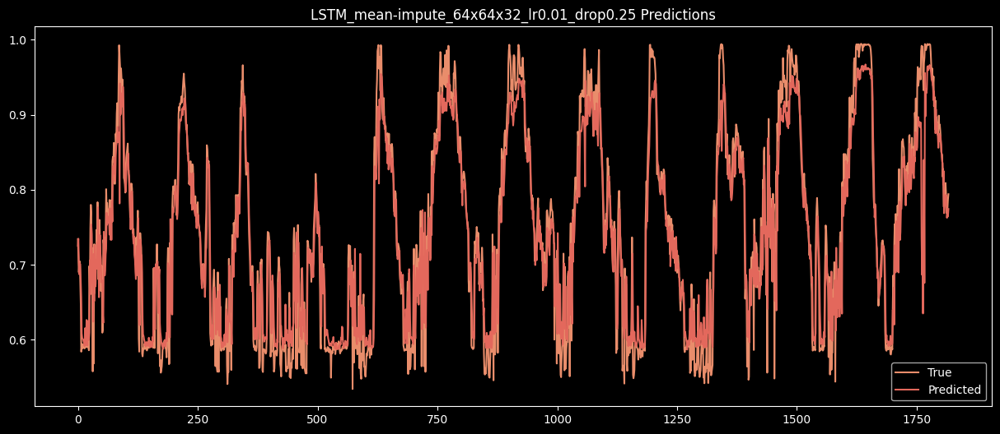

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_89 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_54 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_90 (LSTM)                  │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_55 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_91 (LSTM)                  │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 7ms/step - loss: 0.0104 - root_mean_squared_error: 0.0918 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0022 - root_mean_squared_error: 0.0466 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0443
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0339
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0324
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

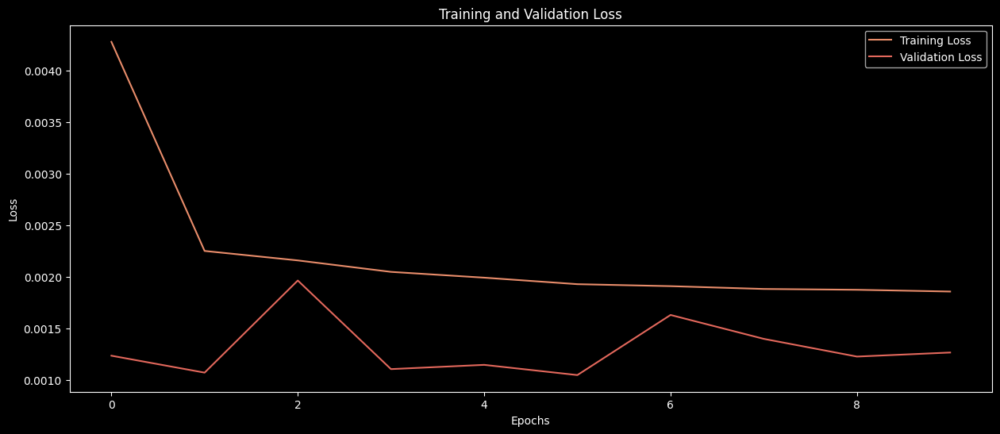

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


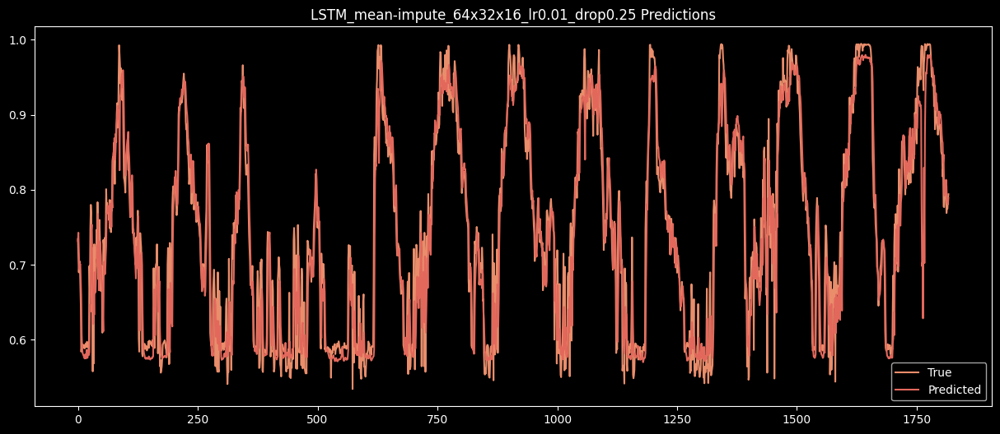

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_92 (LSTM)                  │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_56 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_93 (LSTM)                  │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_57 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_94 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.0097 - root_mean_squared_error: 0.0872 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0428
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0023 - root_mean_squared_error: 0.0483 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0460 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0350
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0020 - root_mean_squared_error: 0.0446 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0442 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 7/20
3204/3204 ━━━━━━━

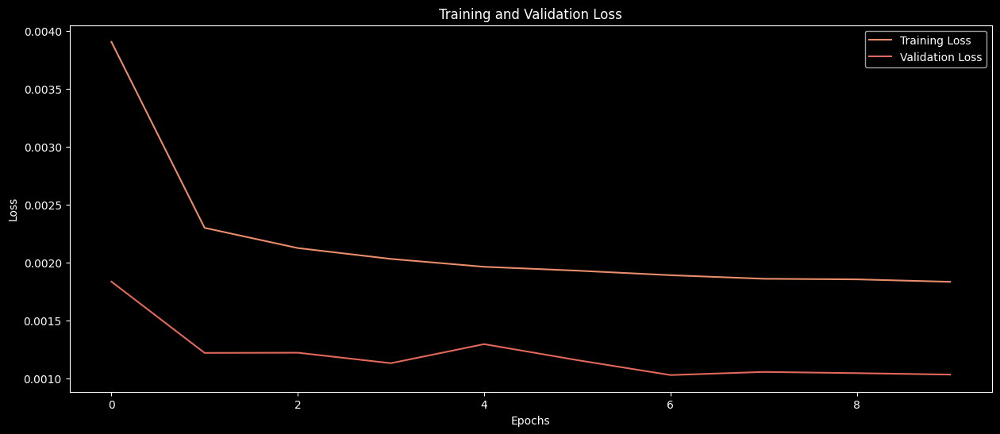

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


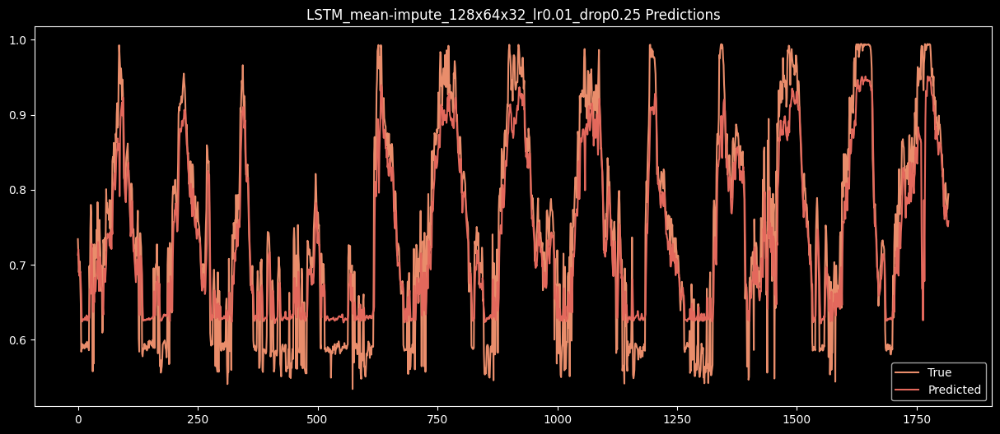

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

In [114]:
gen_train_LSTM(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.0001, 0.1,'mean-impute')
gen_train_LSTM(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.001, 0.2,'mean-impute')
gen_train_LSTM(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.01, 0.25,'mean-impute')

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_95 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_58 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_96 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0808 - root_mean_squared_error: 0.2573 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0439
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0031 - root_mean_squared_error: 0.0557 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0429
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0028 - root_mean_squared_error: 0.0533 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0414
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0503 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0412
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0495 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0381
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0457 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step 

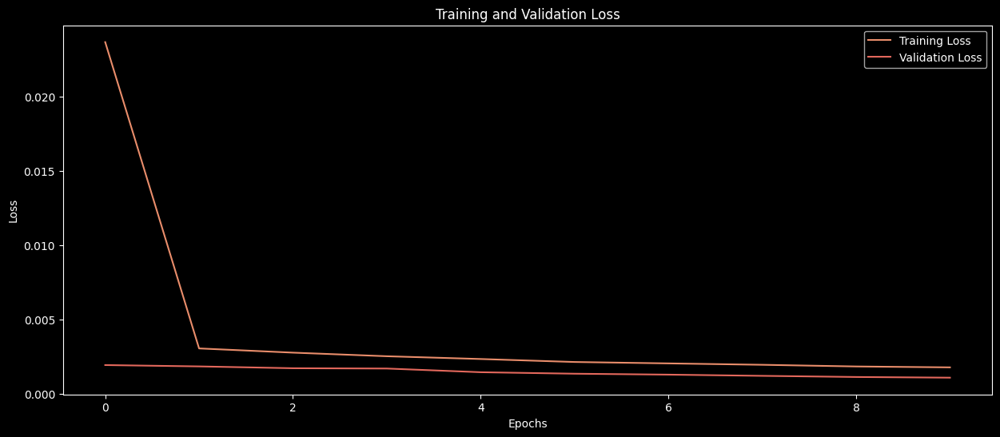

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


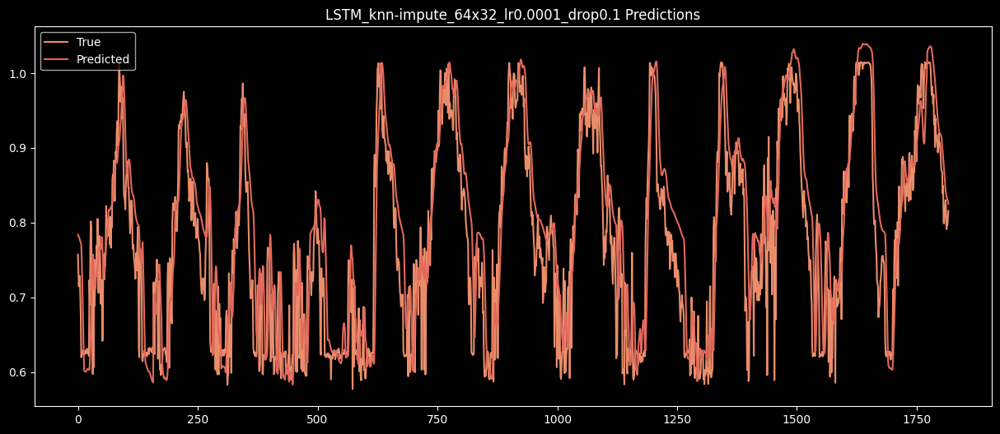

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_97 (LSTM)                  │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_59 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_98 (LSTM)                  │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_60 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_99 (LSTM)                  │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.1632 - root_mean_squared_error: 0.3699 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0474
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0039 - root_mean_squared_error: 0.0622 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0457
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0033 - root_mean_squared_error: 0.0579 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0451
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0031 - root_mean_squared_error: 0.0561 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0441
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0551 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0446
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0029 - root_mean_squared_error: 0.0538 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0424
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step 

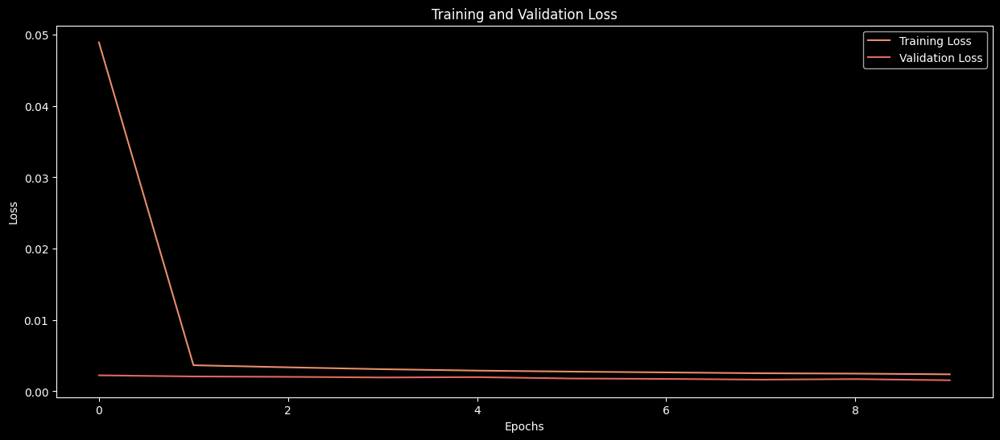

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


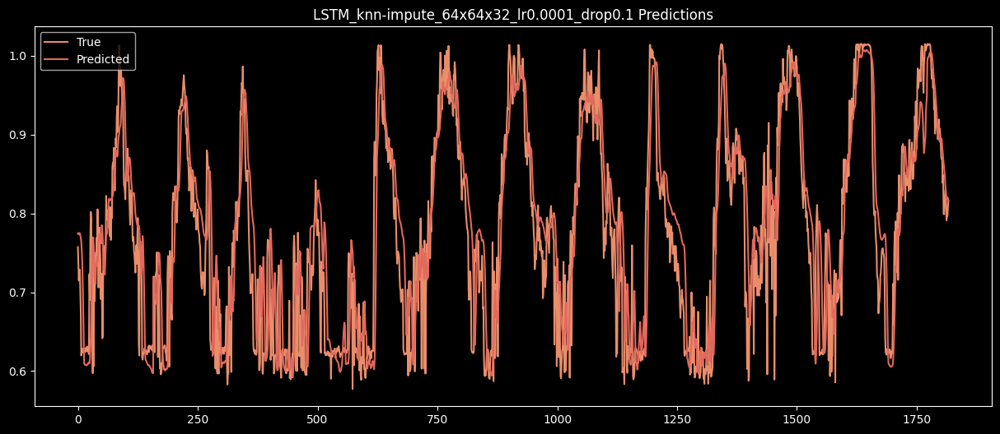

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_100 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_61 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_101 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_62 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_102 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.1868 - root_mean_squared_error: 0.4025 - val_loss: 0.0025 - val_root_mean_squared_error: 0.0498
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0048 - root_mean_squared_error: 0.0693 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0474
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0043 - root_mean_squared_error: 0.0653 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0462
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0037 - root_mean_squared_error: 0.0605 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0460
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0034 - root_mean_squared_error: 0.0579 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0451
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0031 - root_mean_squared_error: 0.0552 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0443
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step 

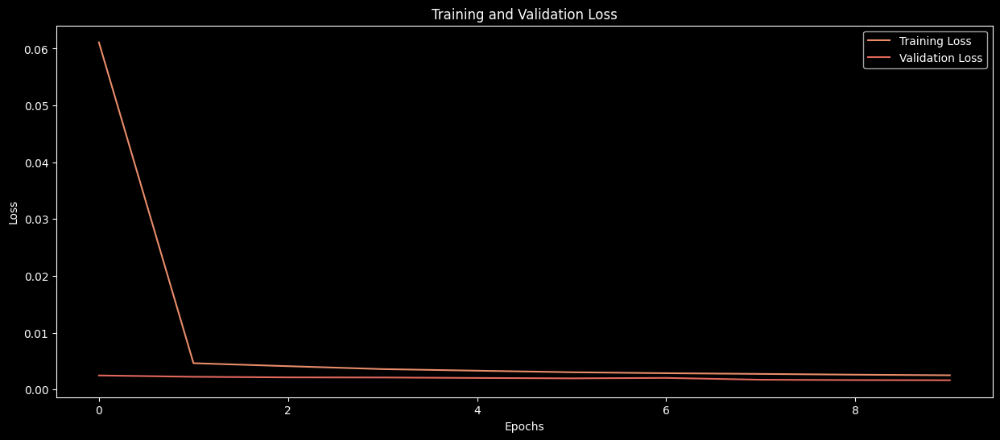

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


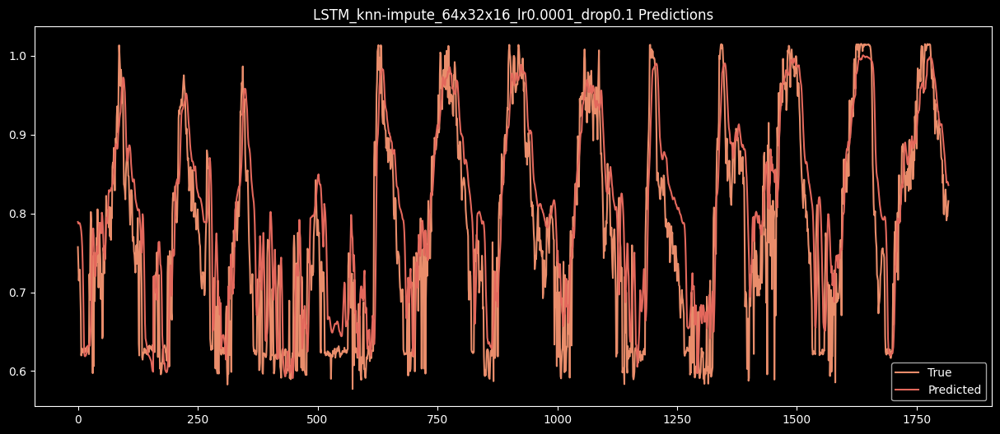

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_103 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_63 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_104 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_64 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_105 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.1462 - root_mean_squared_error: 0.3470 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0469
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0035 - root_mean_squared_error: 0.0594 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0460
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0031 - root_mean_squared_error: 0.0556 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0447
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0030 - root_mean_squared_error: 0.0546 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0438
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0028 - root_mean_squared_error: 0.0527 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0516 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

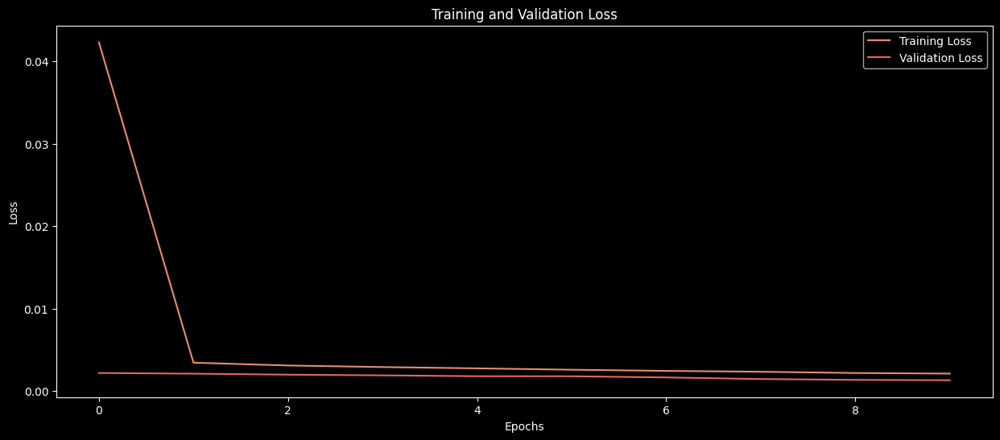

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


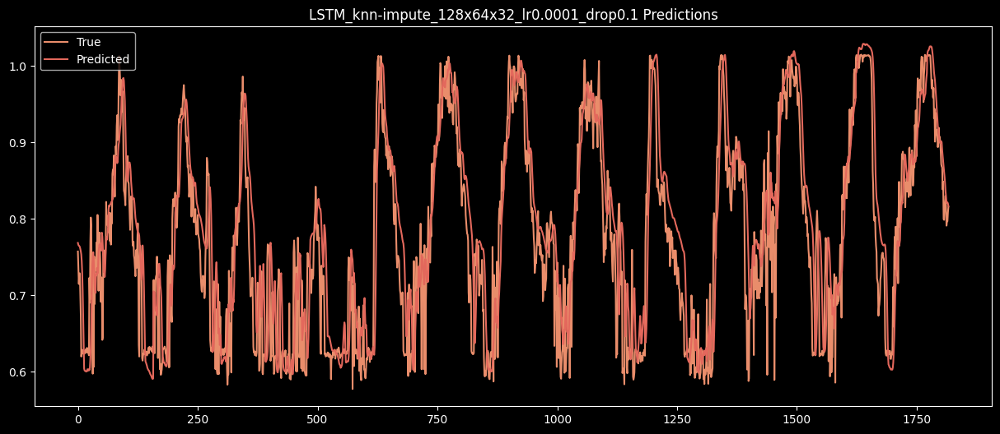

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_106 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_65 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_107 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0346 - root_mean_squared_error: 0.1583 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0409
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0404
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0373
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0016 - root_mean_squared_error: 0.0406 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0350
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0016 - root_mean_squared_error: 0.0396 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step 

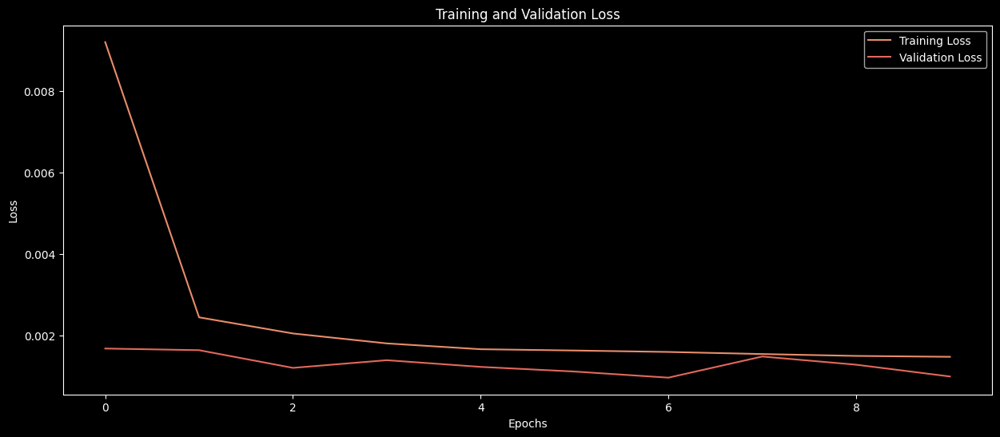

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


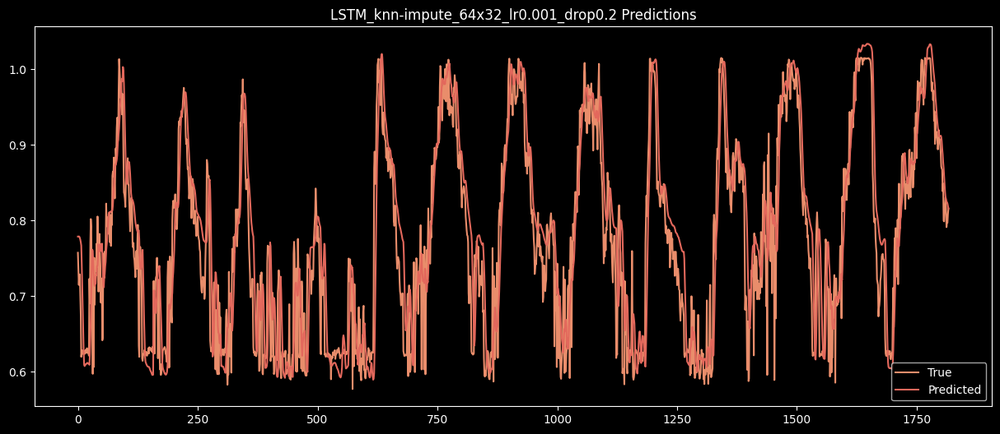

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_108 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_66 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_109 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_67 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_110 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0281 - root_mean_squared_error: 0.1443 - val_loss: 0.0028 - val_root_mean_squared_error: 0.0533
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0548 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0421
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0485 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0353
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0449 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0343
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0405 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0398 - val_loss: 9.7363e-04 - val_root_mean_squared_error: 0.0312
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/s

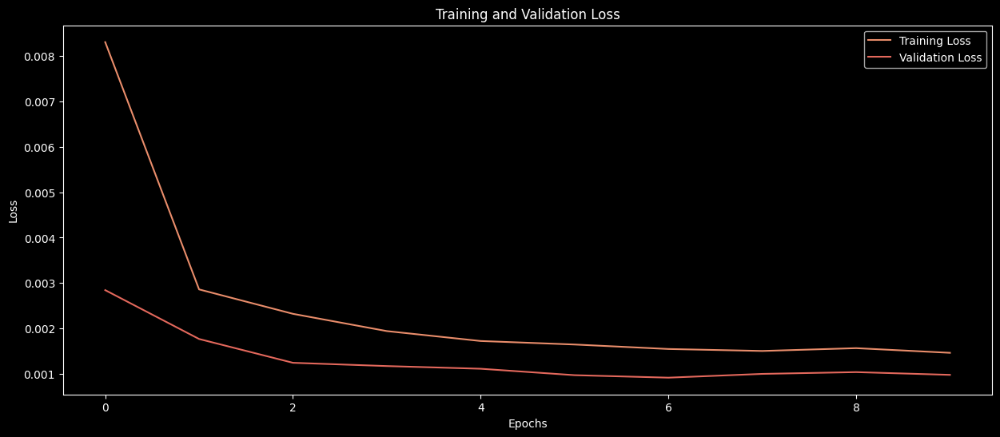

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


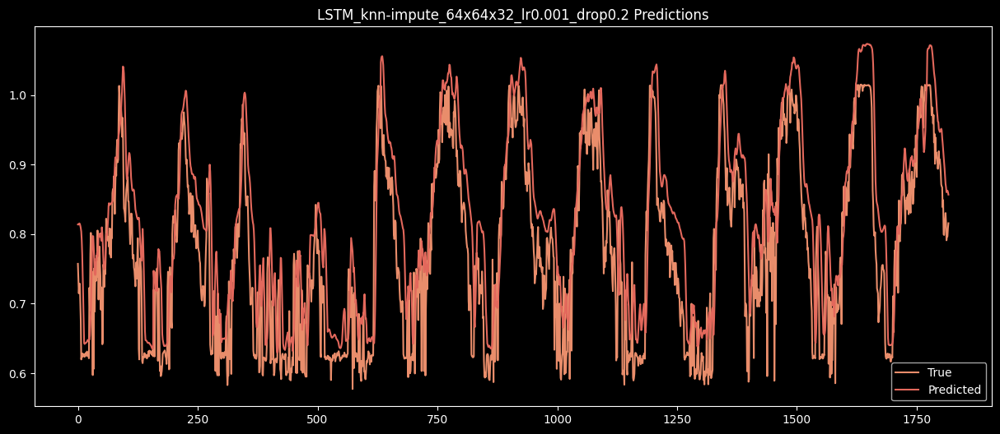

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_43"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_111 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_68 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_112 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_69 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_113 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0315 - root_mean_squared_error: 0.1546 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0460
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0031 - root_mean_squared_error: 0.0554 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0427
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0025 - root_mean_squared_error: 0.0499 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0418
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0407 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step 

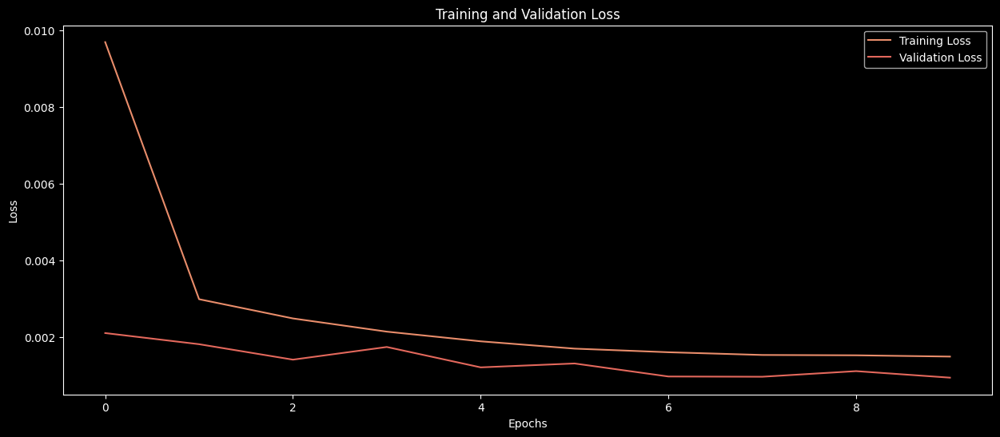

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


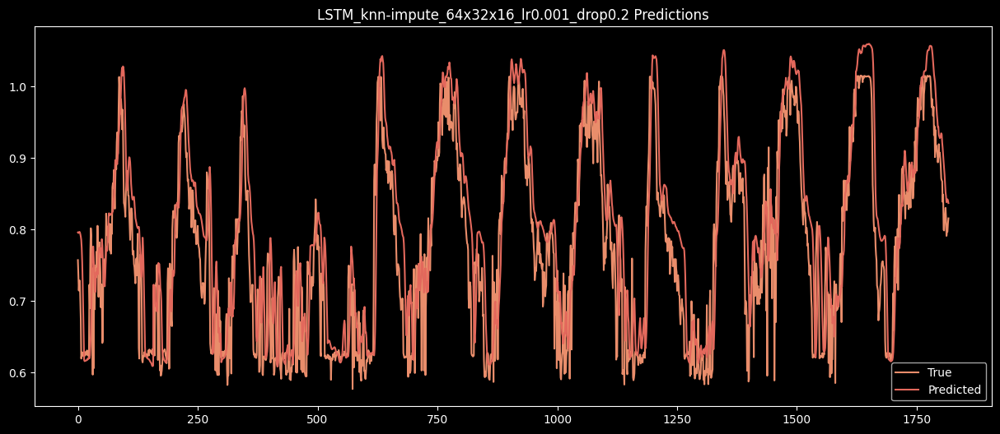

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_44"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_114 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_70 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_115 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_71 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_116 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0371 - root_mean_squared_error: 0.1646 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0510
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0028 - root_mean_squared_error: 0.0529 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0431
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0479 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0405
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0438 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0412 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0408 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0397
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

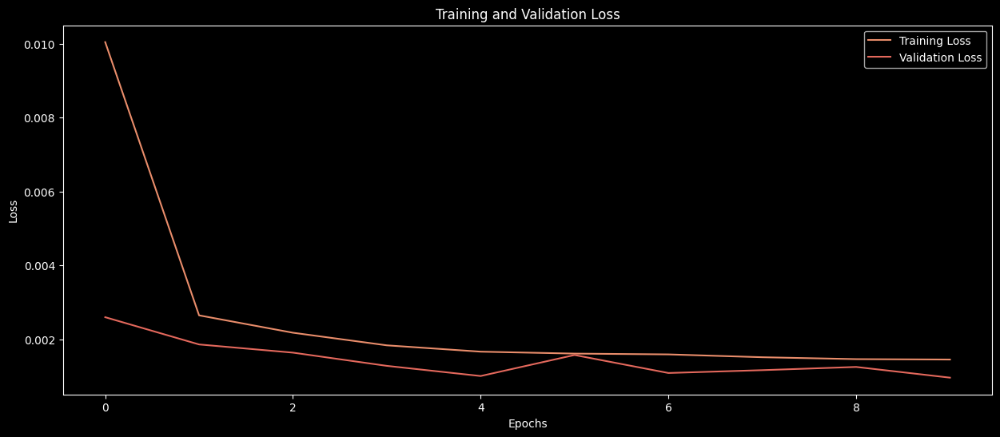

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


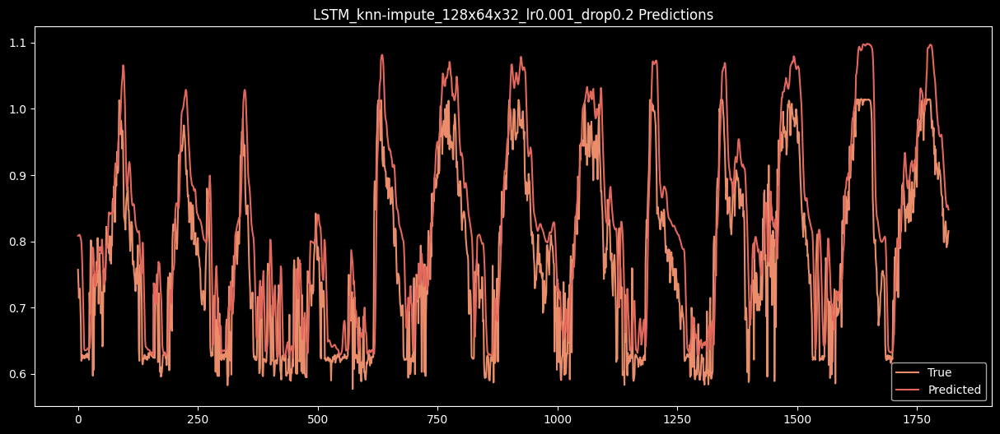

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_45"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_117 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_72 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_118 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,009 (136.75 KB)

 Trainable params: 35,009 (136.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.0249 - root_mean_squared_error: 0.1353 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0016 - root_mean_squared_error: 0.0398 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0321
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0015 - root_mean_squared_error: 0.0390 - val_loss: 9.2676e-04 - val_root_mean_squared_error: 0.0304
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0015 - root_mean_squared_error: 0.0390 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0015 - root_mean_squared_error: 0.0382 - val_loss: 9.8996e-04 - val_root_mean_squared_error: 0.0315
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5

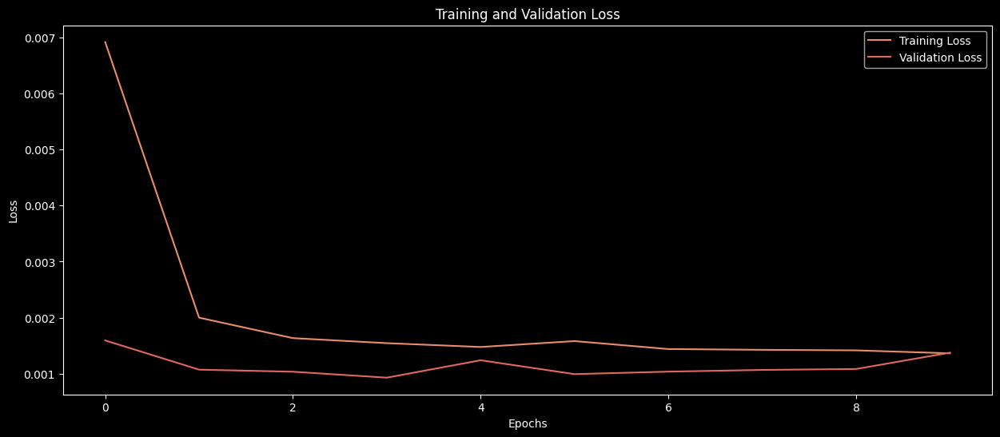

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


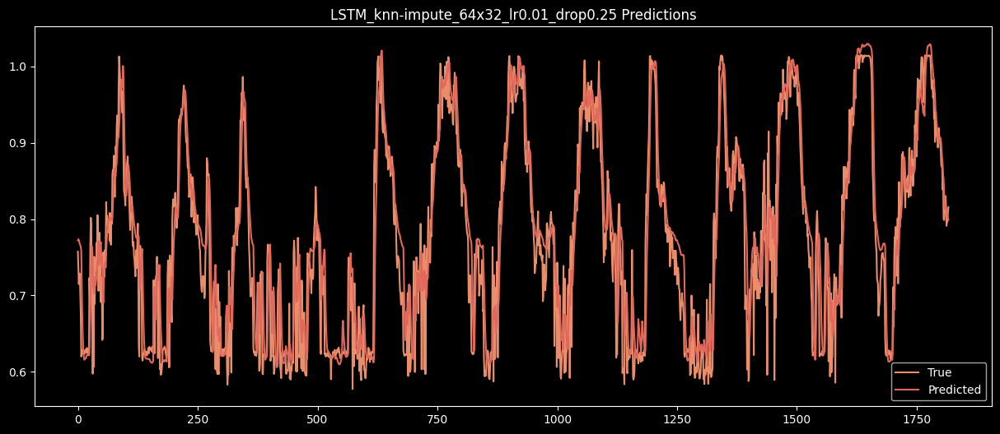

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_46"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_119 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_73 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_120 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_74 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_121 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,033 (265.75 KB)

 Trainable params: 68,033 (265.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0274 - root_mean_squared_error: 0.1415 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0416
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 9.9320e-04 - val_root_mean_squared_error: 0.0315
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0395 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0467
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0394 - val_loss: 0.0028 - val_root_mean_squared_error: 0.0528
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0015 - root_mean_squared_error: 0.0386 - val_loss: 9.8406e-04 - val_root_mean_squared_error: 0.0314
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0015 - root_mean_squared_error: 0.0391 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8

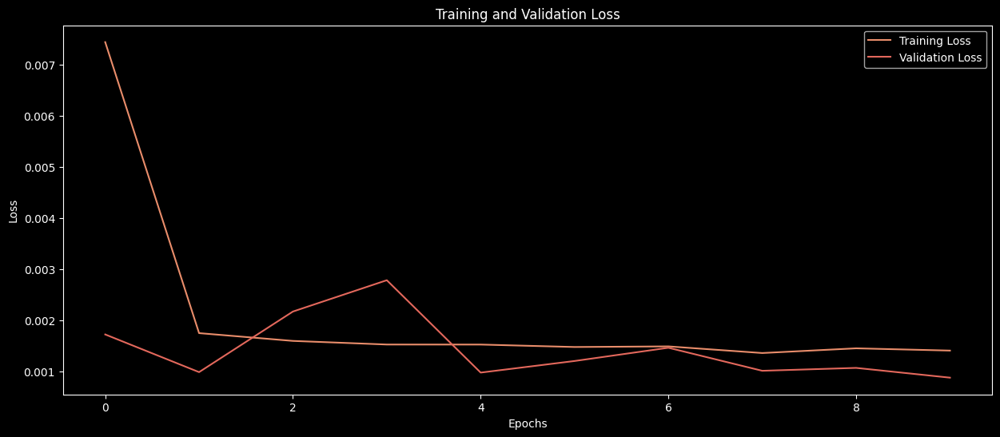

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


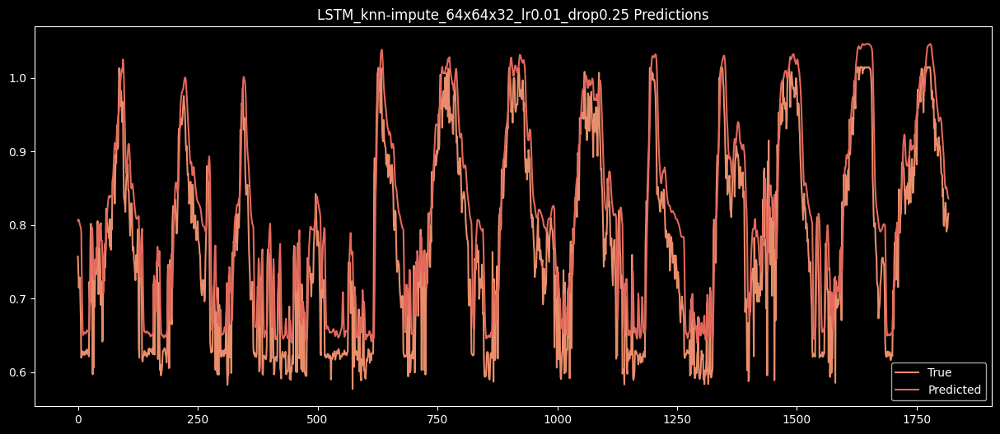

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_47"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_122 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_75 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_123 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_76 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_124 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,345 (145.88 KB)

 Trainable params: 37,345 (145.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0255 - root_mean_squared_error: 0.1386 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0452
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0021 - root_mean_squared_error: 0.0460 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0324
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0016 - root_mean_squared_error: 0.0398 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0016 - root_mean_squared_error: 0.0396 - val_loss: 9.8963e-04 - val_root_mean_squared_error: 0.0315
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0015 - root_mean_squared_error: 0.0391 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0321
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0015 - root_mean_squared_error: 0.0393 - val_loss: 9.7378e-04 - val_root_mean_squared_error: 0.0312
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7

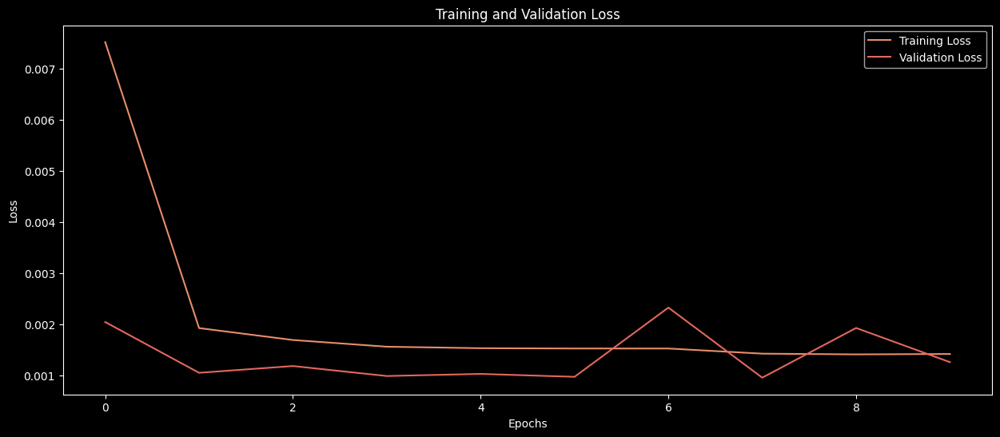

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


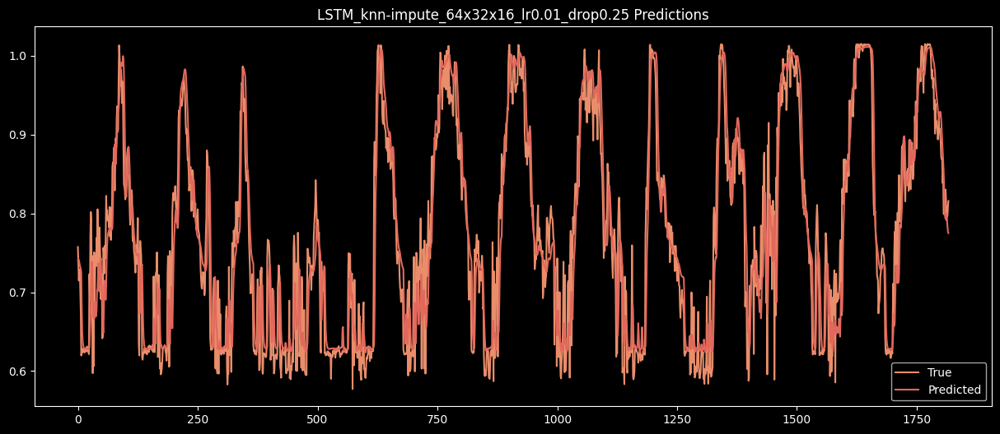

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_48"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_125 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_77 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_126 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_78 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_127 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,689 (541.75 KB)

 Trainable params: 138,689 (541.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0328 - root_mean_squared_error: 0.1548 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0430 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0321
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0016 - root_mean_squared_error: 0.0401 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0015 - root_mean_squared_error: 0.0393 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0343
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0015 - root_mean_squared_error: 0.0389 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0014 - root_mean_squared_error: 0.0374 - val_loss: 9.4397e-04 - val_root_mean_squared_error: 0.0307
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms

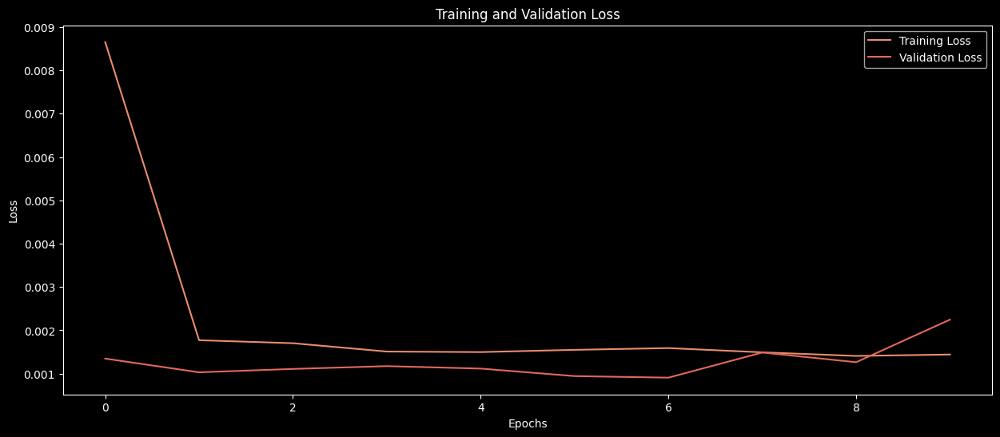

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


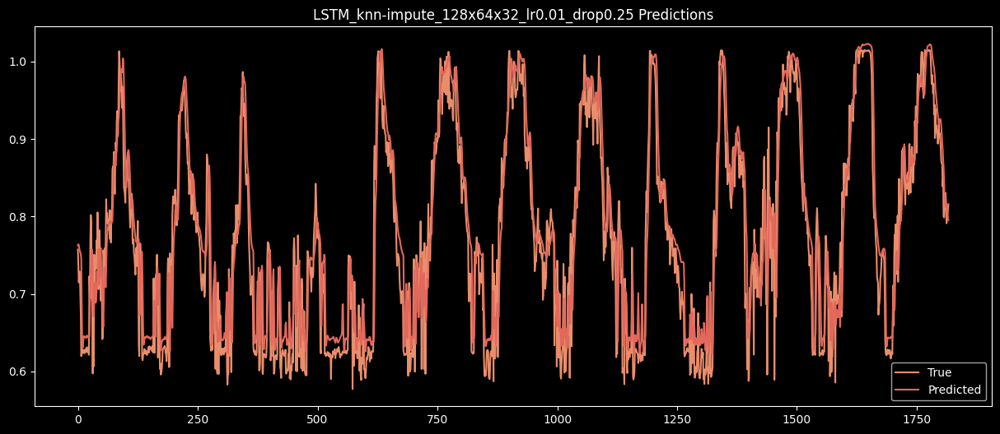

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

In [115]:
gen_train_LSTM(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.0001, 0.1,'knn-impute')
gen_train_LSTM(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.001, 0.2,'knn-impute')
gen_train_LSTM(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.01, 0.25,'knn-impute')

## GRU

In [118]:
def generate_GRU(lstm_sizes, X_shape, droput_rate, add_fft = False):
    model = tf.keras.Sequential()
    for (i,size) in enumerate(lstm_sizes):
        if not i==len(lstm_sizes)-1:
            model.add(tf.keras.layers.GRU(size, input_shape=X_shape,return_sequences=True))
            if droput_rate !=0:
                model.add(tf.keras.layers.Dropout(droput_rate))
        else:
            model.add(tf.keras.layers.GRU(size, return_sequences=False))
            if add_fft: model.add(FFTLayer())
            model.add(tf.keras.layers.Dense(size))
            model.add(tf.keras.layers.Dense(1))
    return model
    
def gen_train_GRU(X_train, y_train, X_test, y_test, model_sizes, learn_rate, droput_rate, extra_label,fft=False):
    for model_size in model_sizes:
        model = generate_GRU(model_size,(X_train.shape[1],X_train.shape[2]), droput_rate=droput_rate,add_fft=fft)
        model.compile(
            loss=tf.losses.MeanSquaredError(),
            optimizer=tf.optimizers.Adam(learning_rate=learn_rate),
            metrics=[tf.metrics.RootMeanSquaredError()]
        )
        model.summary()
        history = model.fit(X_train, y_train,
                            epochs=20, batch_size=32,
                            validation_split=0.1,
                            callbacks=[early_stopping, checkpoint])
        plot_train_history(history)
        test_model(model, f'GRU_{extra_label}_{get_name(model_size)}_lr{learn_rate}_drop{droput_rate}',
                X_test, y_test)

Model: "sequential_50"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_2 (GRU)                     │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_80 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_3 (GRU)                     │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0942 - root_mean_squared_error: 0.2764 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0420
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0048 - root_mean_squared_error: 0.0690 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0035 - root_mean_squared_error: 0.0595 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0394
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0031 - root_mean_squared_error: 0.0553 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0379
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0025 - root_mean_squared_error: 0.0505 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0023 - root_mean_squared_error: 0.0475 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step 

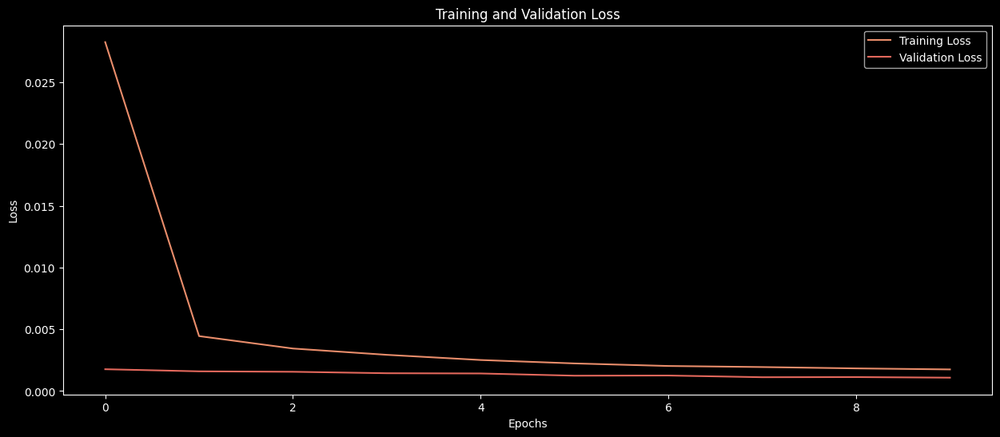

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


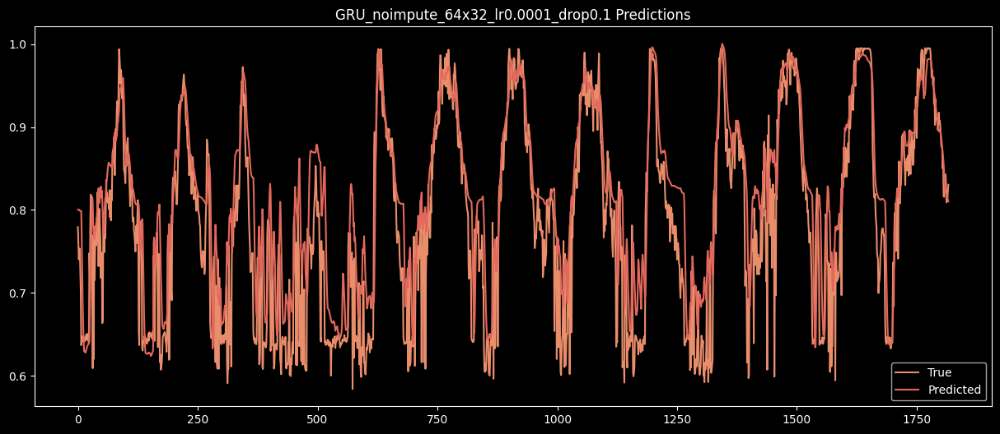

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_51"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_4 (GRU)                     │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_81 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_5 (GRU)                     │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_82 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_6 (GRU)                     │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0371 - root_mean_squared_error: 0.1722 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0432
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0043 - root_mean_squared_error: 0.0657 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0421
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0034 - root_mean_squared_error: 0.0584 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0408
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0029 - root_mean_squared_error: 0.0542 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0521 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0378
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0489 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0366
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

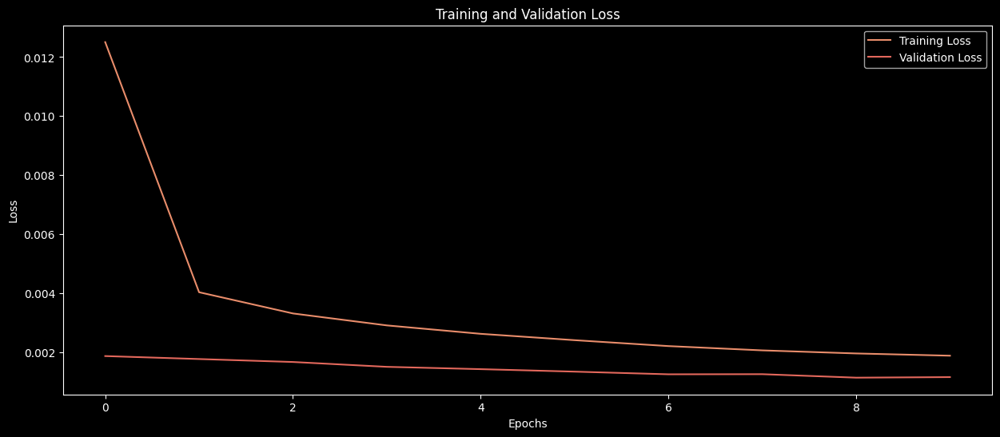

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


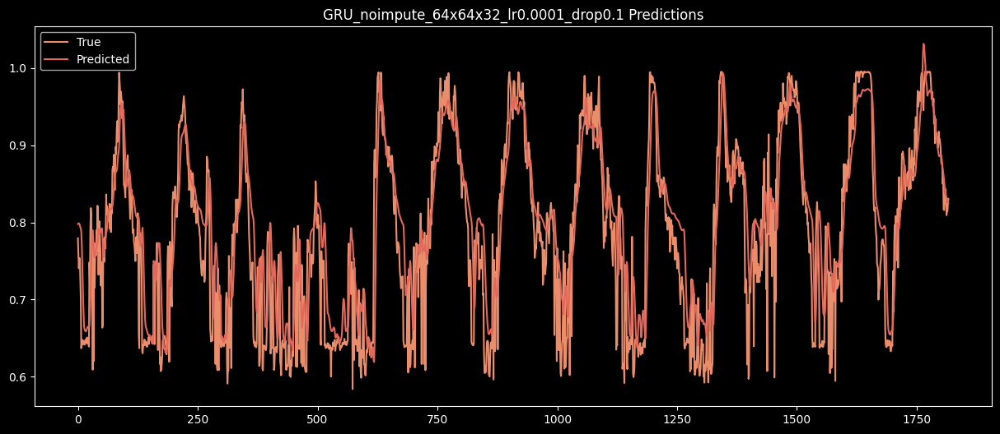

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_52"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_7 (GRU)                     │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_83 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_8 (GRU)                     │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_84 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_9 (GRU)                     │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0717 - root_mean_squared_error: 0.2378 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0398
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0062 - root_mean_squared_error: 0.0789 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0422
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0046 - root_mean_squared_error: 0.0678 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0038 - root_mean_squared_error: 0.0619 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0034 - root_mean_squared_error: 0.0587 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0429
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0029 - root_mean_squared_error: 0.0539 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step 

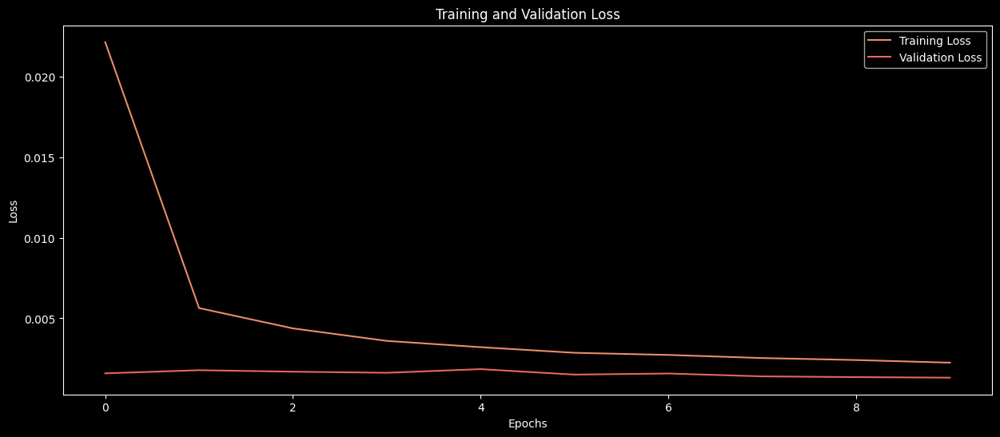

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


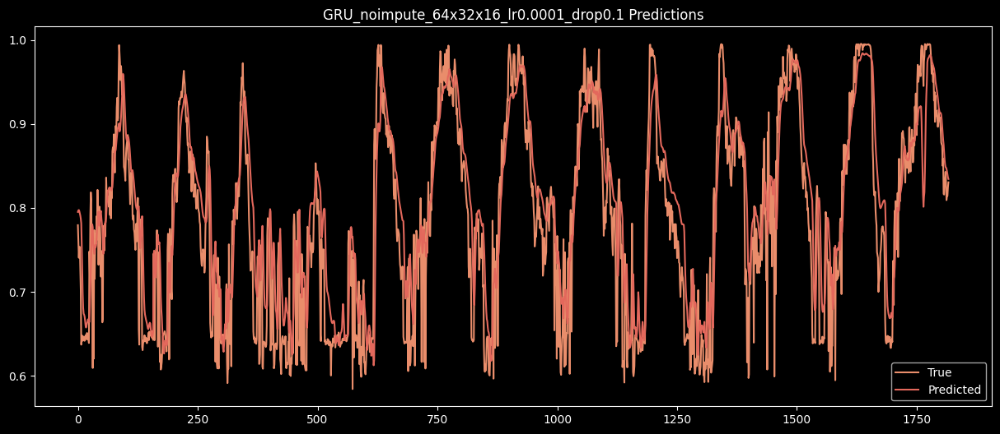

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_53"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_10 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_85 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_11 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_86 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_12 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.0479 - root_mean_squared_error: 0.1928 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0444
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0044 - root_mean_squared_error: 0.0664 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0414
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0035 - root_mean_squared_error: 0.0587 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0394
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0028 - root_mean_squared_error: 0.0527 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0025 - root_mean_squared_error: 0.0504 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0343
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10

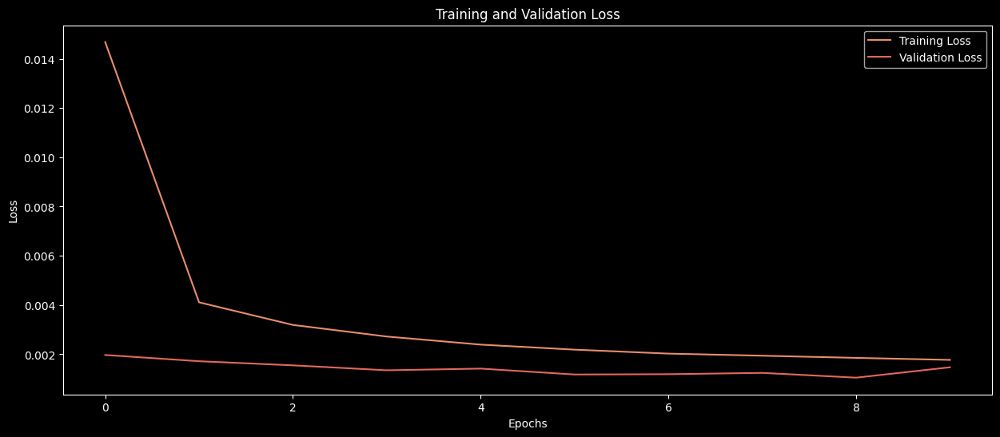

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


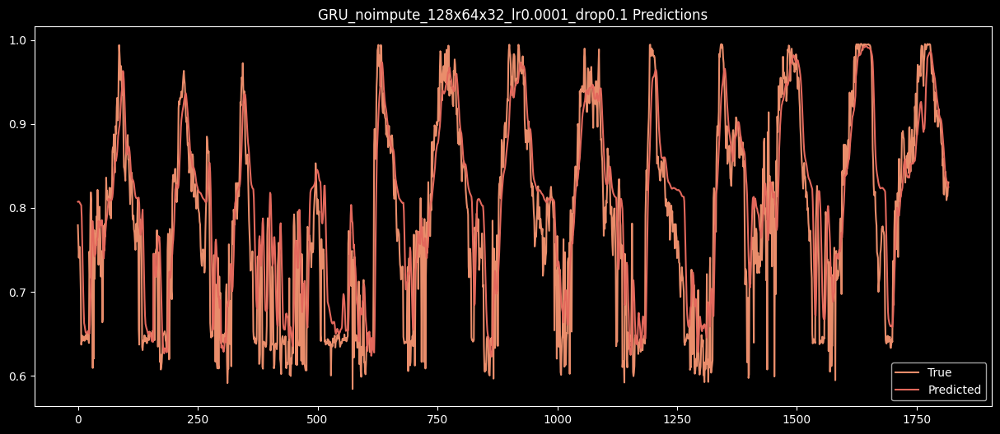

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_54"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_13 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_87 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_14 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0117 - root_mean_squared_error: 0.0989 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0458 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0407
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0017 - root_mean_squared_error: 0.0418 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0441
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0017 - root_mean_squared_error: 0.0411 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0016 - root_mean_squared_error: 0.0402 - val_loss: 9.7801e-04 - val_root_mean_squared_error: 0.0313
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0015 - root_mean_squared_error: 0.0385 - val_loss: 9.6179e-04 - val_root_mean_squared_error: 0.0310
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6

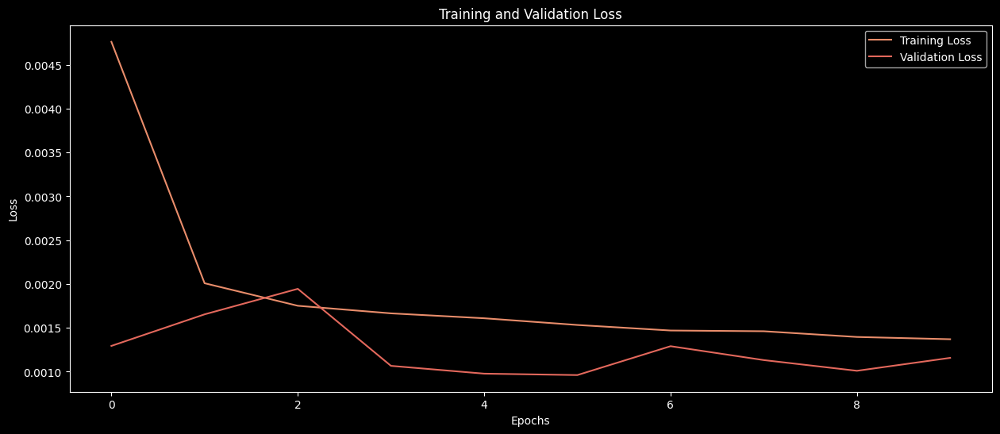

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


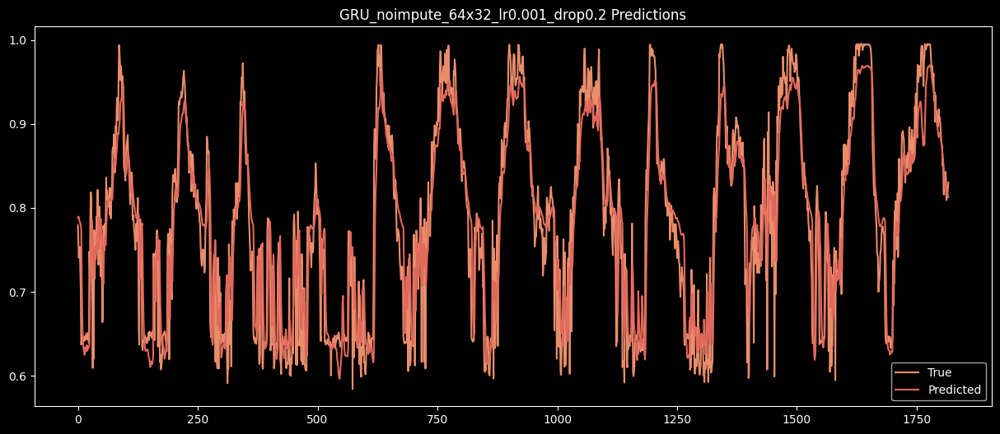

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_55"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_15 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_88 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_16 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_89 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_17 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 11s 10ms/step - loss: 0.0227 - root_mean_squared_error: 0.1348 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0428
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0524 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0456
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0483 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0387
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0455 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0423 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0379
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0421 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/ste

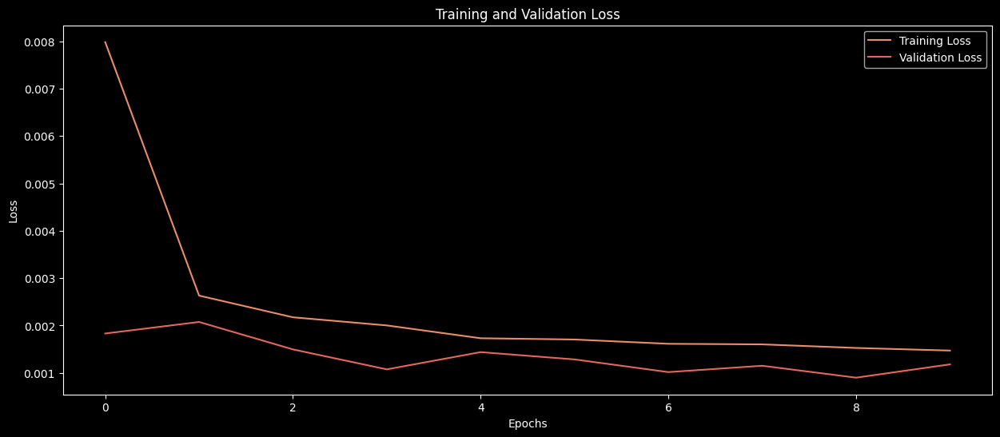

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


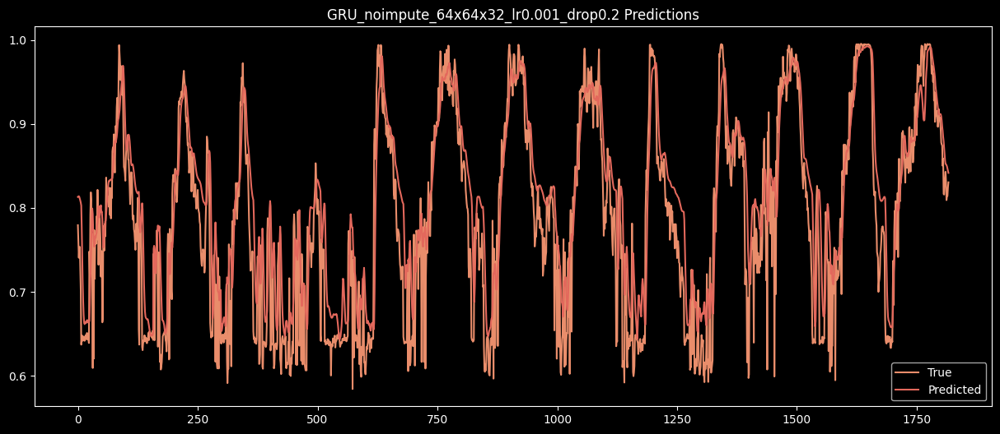

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_56"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_18 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_90 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_19 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_91 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_20 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0309 - root_mean_squared_error: 0.1539 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0411
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0029 - root_mean_squared_error: 0.0536 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0376
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0354
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0385
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0421 - val_loss: 9.7498e-04 - val_root_mean_squared_error: 0.0312
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/s

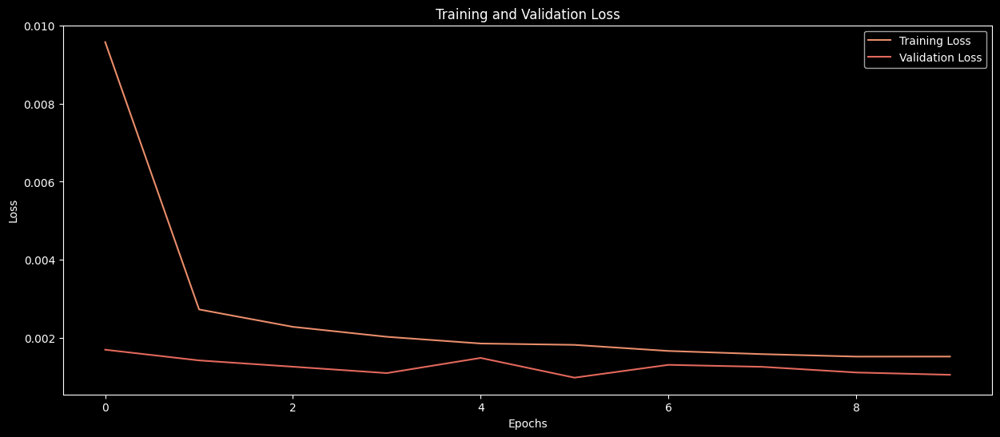

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


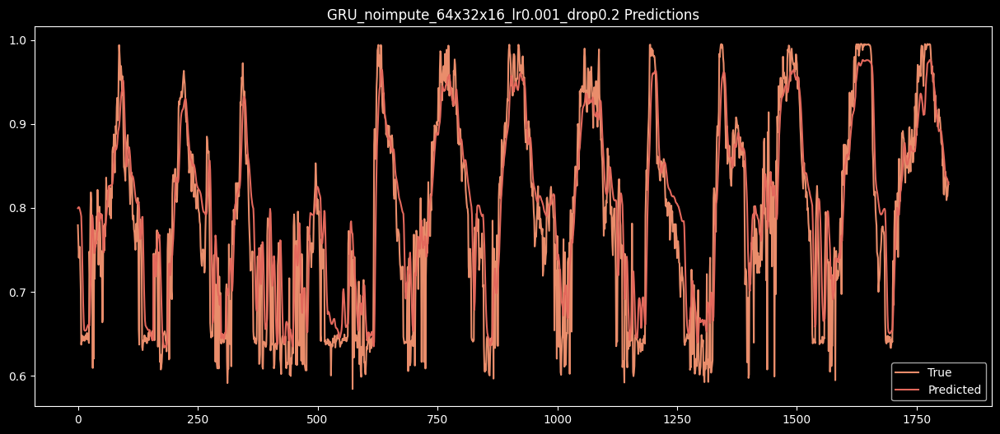

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_57"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_21 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_92 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_22 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_93 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_23 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - loss: 0.0300 - root_mean_squared_error: 0.1508 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0413
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - loss: 0.0027 - root_mean_squared_error: 0.0520 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0462
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0466 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0324
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0426 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0412 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0321
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 10

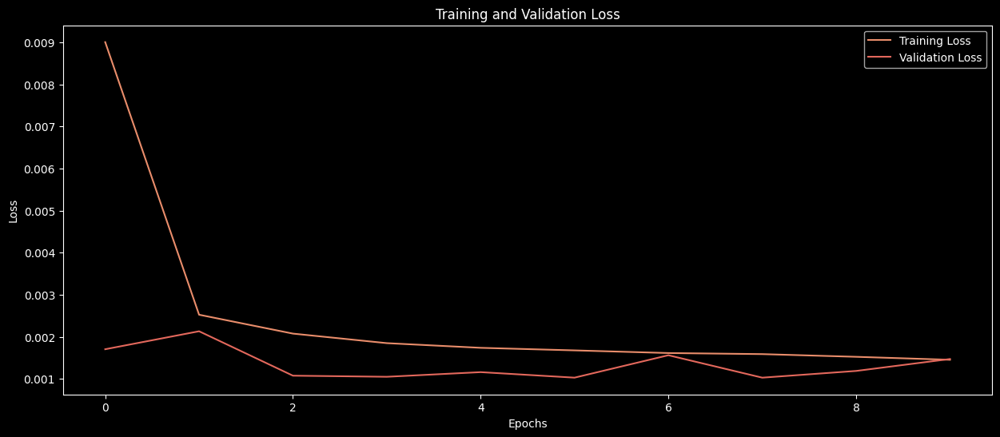

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


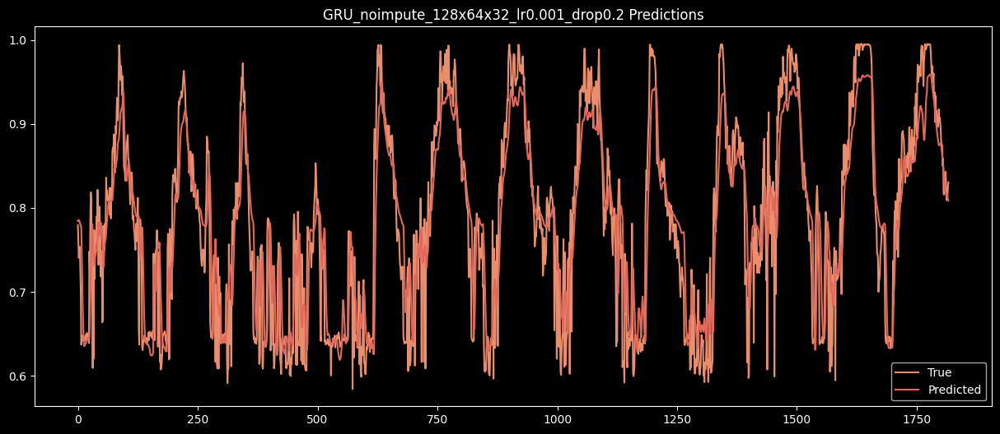

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_58"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_24 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_94 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_25 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0850 - root_mean_squared_error: 0.2439 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0453 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0389
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 9.9404e-04 - val_root_mean_squared_error: 0.0315
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0016 - root_mean_squared_error: 0.0398 - val_loss: 9.2017e-04 - val_root_mean_squared_error: 0.0303
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0015 - root_mean_squared_error: 0.0389 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0015 - root_mean_squared_error: 0.0381 - val_loss: 9.0163e-04 - val_root_mean_squared_error: 0.0300
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 

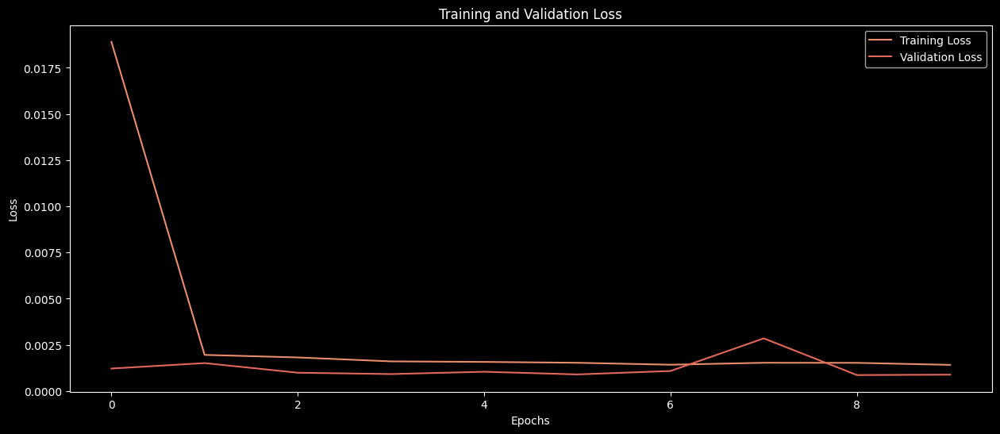

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


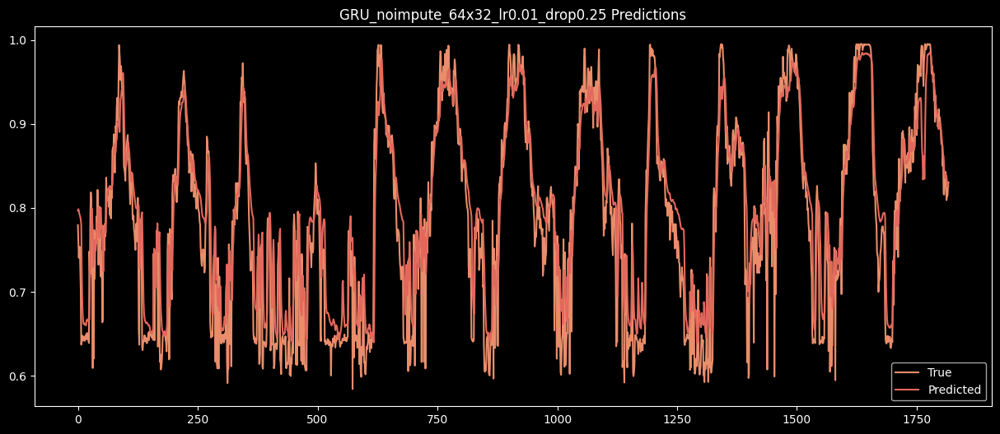

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_59"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_26 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_95 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_27 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_96 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_28 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0668 - root_mean_squared_error: 0.2153 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0406
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0485 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0427 - val_loss: 9.9819e-04 - val_root_mean_squared_error: 0.0316
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0424 - val_loss: 9.6263e-04 - val_root_mean_squared_error: 0.0310
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0409 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0409 - val_loss: 9.1955e-04 - val_root_mean_squared_error: 0.0303
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━

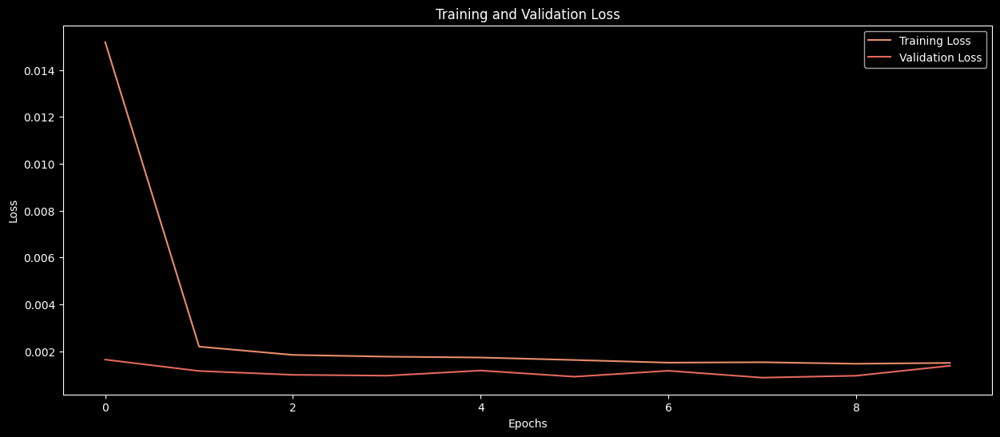

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


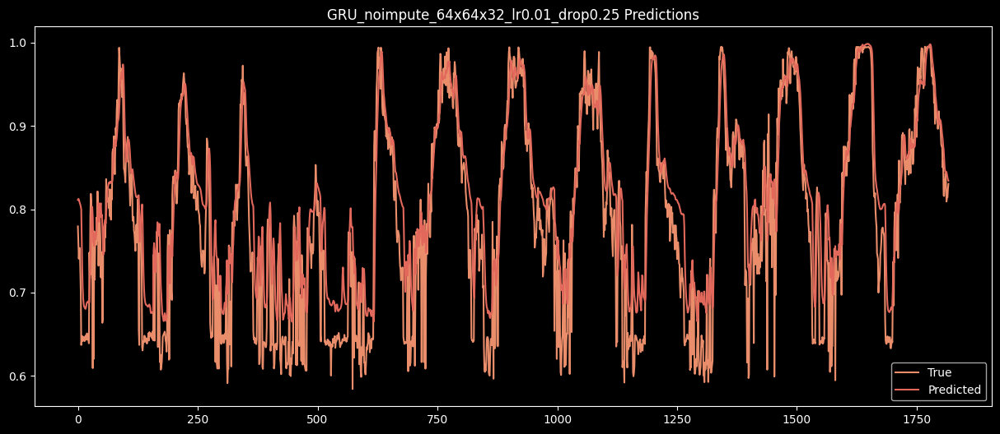

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_60"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_29 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_97 (Dropout)            │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_30 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_98 (Dropout)            │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_31 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0327 - root_mean_squared_error: 0.1523 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0405
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0457 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0430
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0432 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0403 - val_loss: 9.6939e-04 - val_root_mean_squared_error: 0.0311
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0017 - root_mean_squared_error: 0.0411 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0383
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0397 - val_loss: 9.5025e-04 - val_root_mean_squared_error: 0.0308
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8

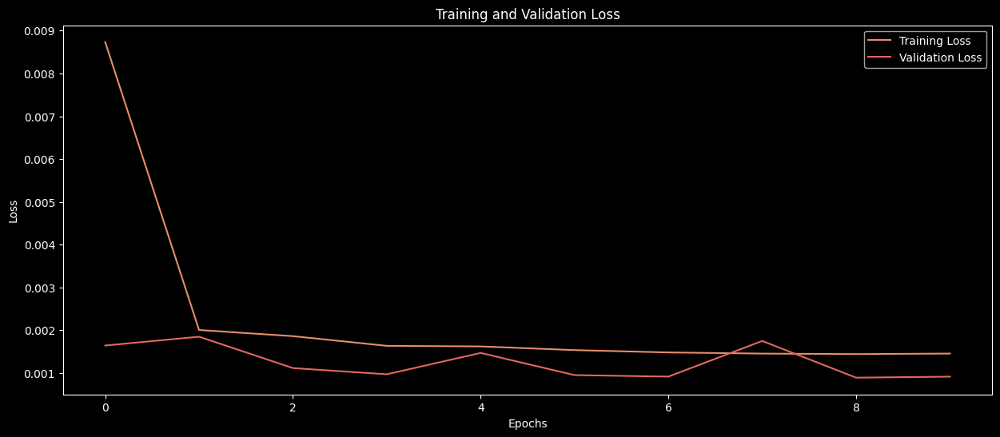

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


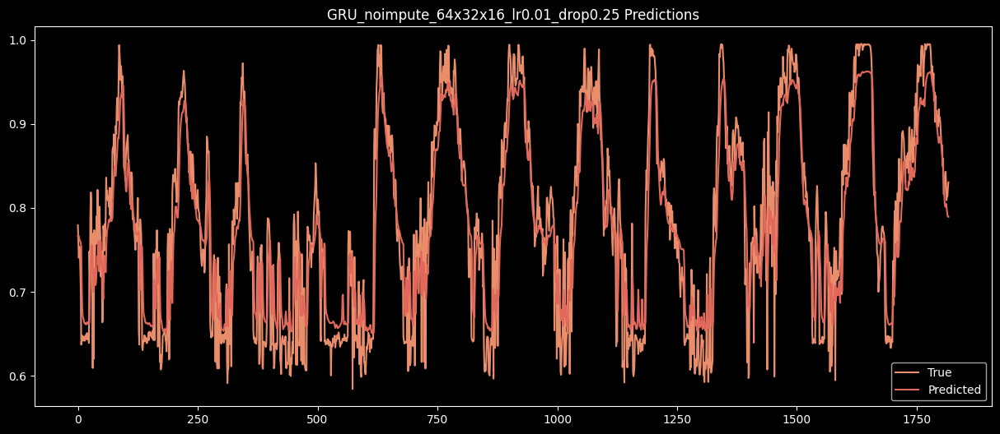

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_61"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_32 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_99 (Dropout)            │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_33 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_100 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_34 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.1897 - root_mean_squared_error: 0.3562 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0397
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0026 - root_mean_squared_error: 0.0505 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0507
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0486 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0350
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0417 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 0.0034 - val_root_mean_squared_error: 0.0580
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10

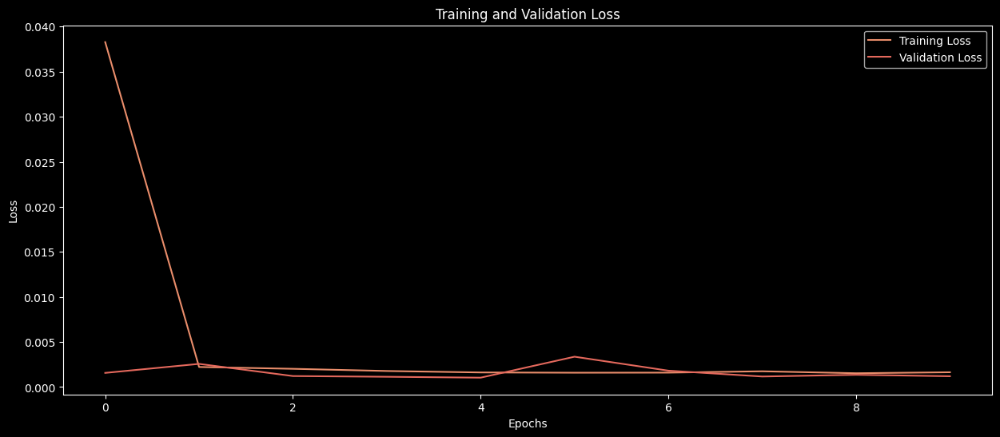

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


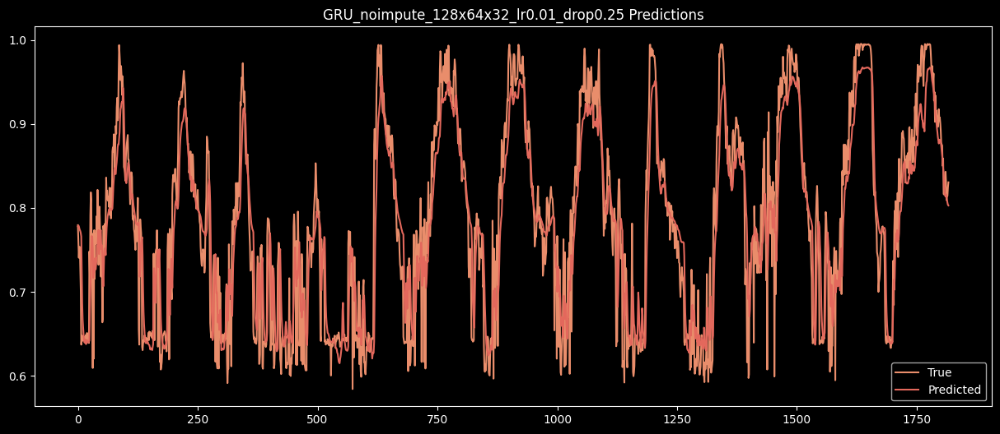

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

In [119]:
model_sizes = [[64,32],[64,64,32],[64,32,16],[128,64,32]]
gen_train_GRU(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.0001, 0.1,'noimpute')
gen_train_GRU(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.001, 0.2,'noimpute')
gen_train_GRU(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.01, 0.25,'noimpute')

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_62"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_35 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_101 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_36 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.0386 - root_mean_squared_error: 0.1713 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0445
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 0.0035 - root_mean_squared_error: 0.0592 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0403
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0029 - root_mean_squared_error: 0.0536 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0368
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0025 - root_mean_squared_error: 0.0504 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0413
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0024 - root_mean_squared_error: 0.0492 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0023 - root_mean_squared_error: 0.0483 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

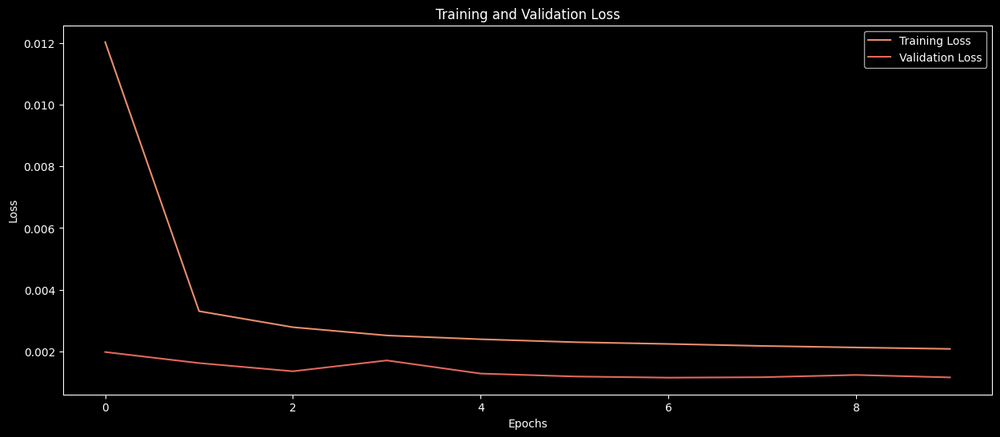

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


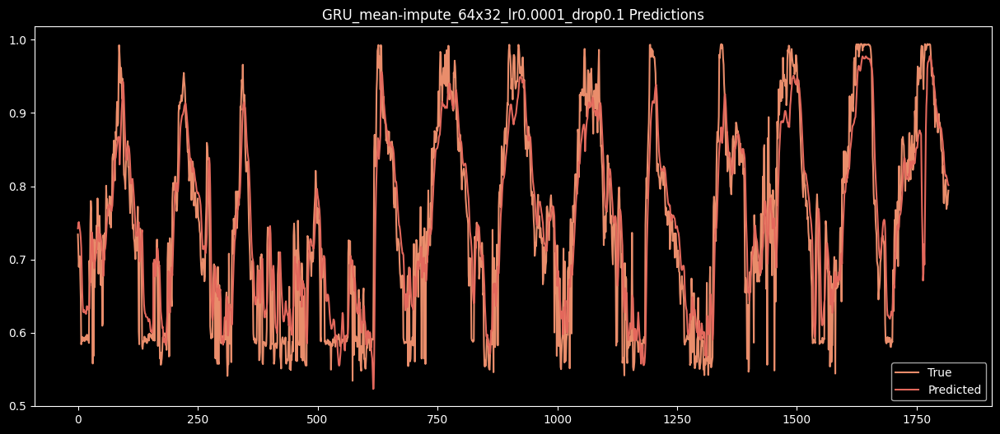

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_63"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_37 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_102 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_38 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_103 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_39 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_120 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_121 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 9ms/step - loss: 0.0113 - root_mean_squared_error: 0.1010 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0446
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0035 - root_mean_squared_error: 0.0591 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0386
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0029 - root_mean_squared_error: 0.0537 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0359
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0506 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0023 - root_mean_squared_error: 0.0484 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0339
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0467 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

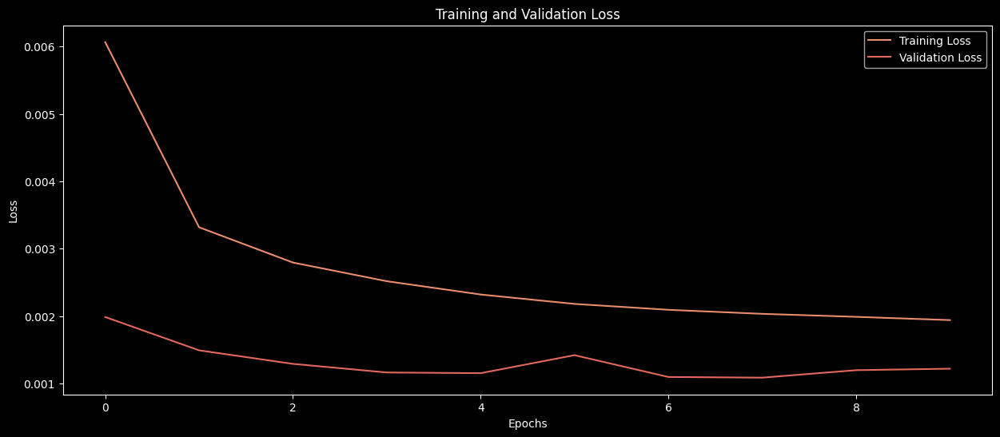

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


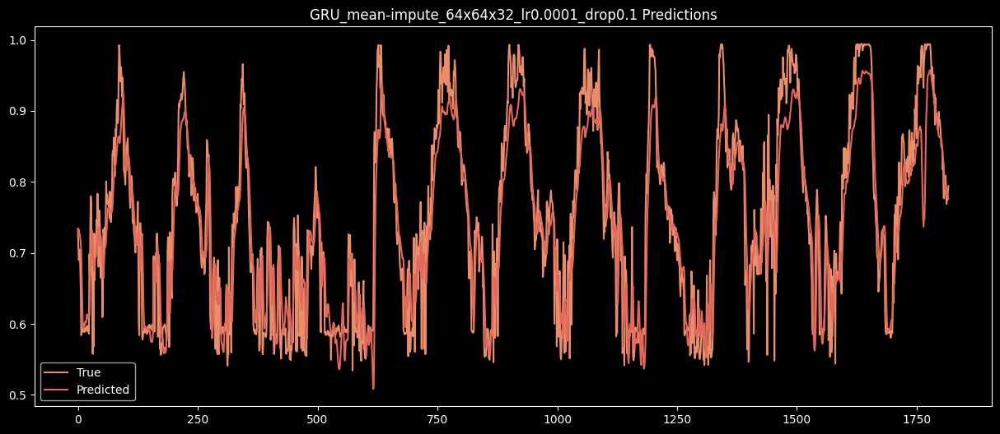

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_64"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_40 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_104 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_41 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_105 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_42 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_122 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_123 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 8ms/step - loss: 0.0168 - root_mean_squared_error: 0.1204 - val_loss: 0.0039 - val_root_mean_squared_error: 0.0624
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0037 - root_mean_squared_error: 0.0612 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0413
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0552 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0395
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0513 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0390
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0345
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

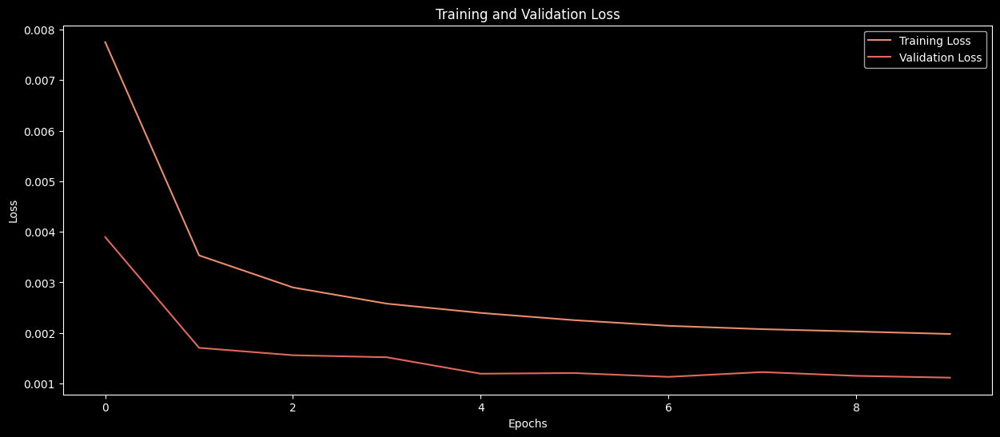

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


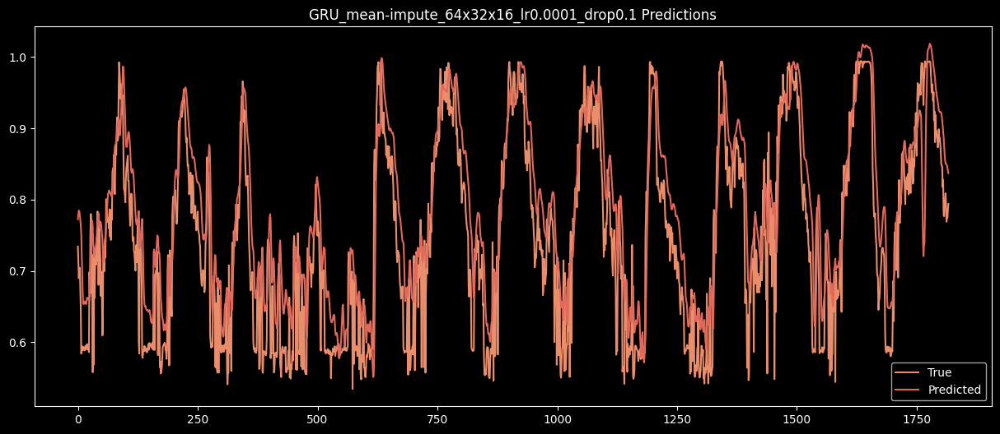

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_65"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_43 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_106 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_44 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_107 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_45 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_124 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_125 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 42s 11ms/step - loss: 0.0158 - root_mean_squared_error: 0.1125 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0445
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 11ms/step - loss: 0.0033 - root_mean_squared_error: 0.0572 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0394
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 11ms/step - loss: 0.0027 - root_mean_squared_error: 0.0519 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 11ms/step - loss: 0.0024 - root_mean_squared_error: 0.0491 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0386
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 11ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 11ms/step - loss: 0.0021 - root_mean_squared_error: 0.0460 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 7/20
3204/3204 ━━━━━━━

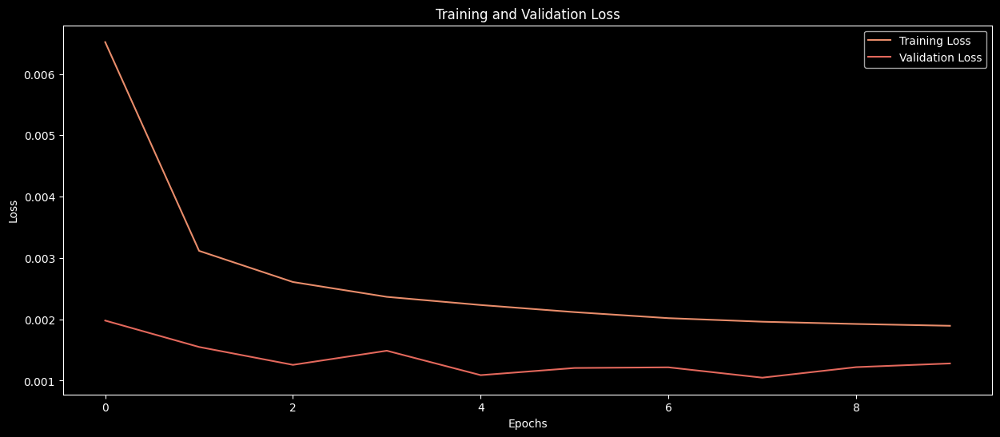

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


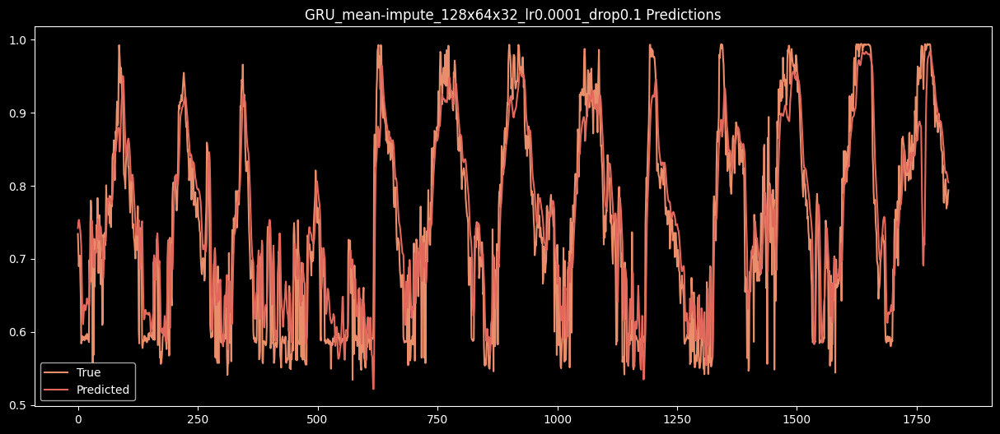

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_66"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_46 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_108 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_47 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_126 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_127 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 23s 6ms/step - loss: 0.0154 - root_mean_squared_error: 0.1060 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0490
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 0.0026 - root_mean_squared_error: 0.0512 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0329
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0453 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 19s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

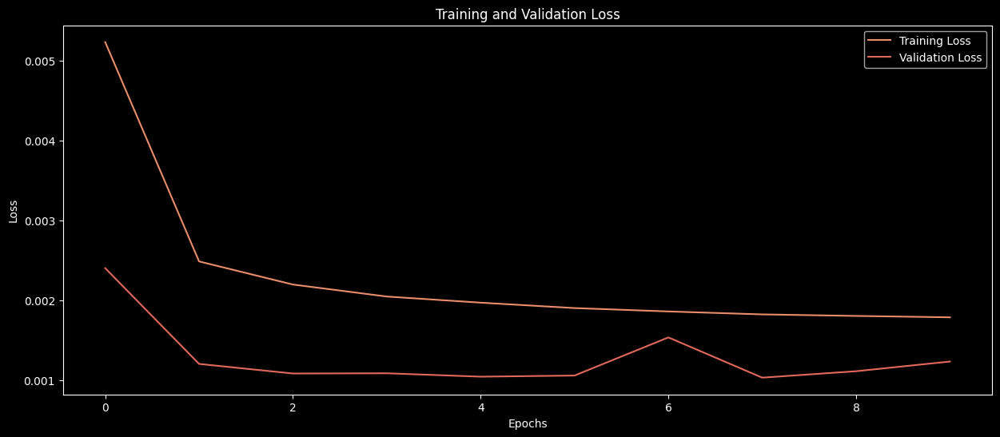

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


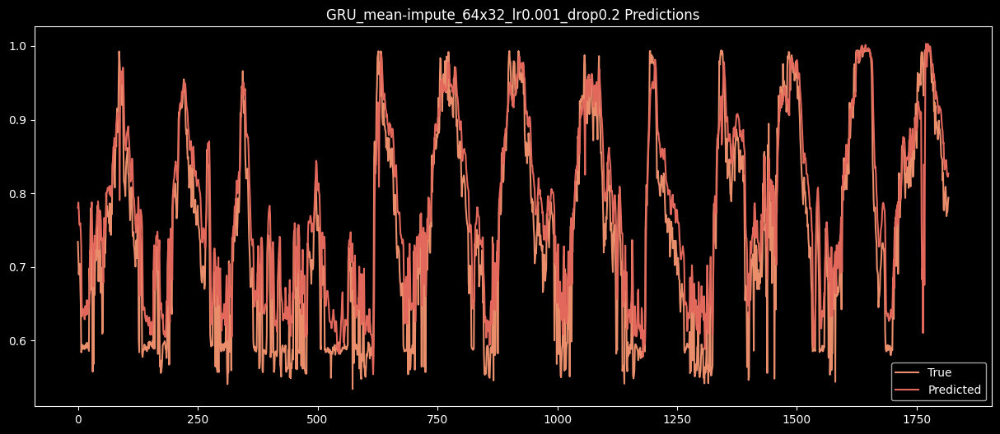

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_67"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_48 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_109 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_49 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_110 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_50 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_128 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_129 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 9ms/step - loss: 0.0082 - root_mean_squared_error: 0.0838 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0403
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0486 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0436 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0324
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0436 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

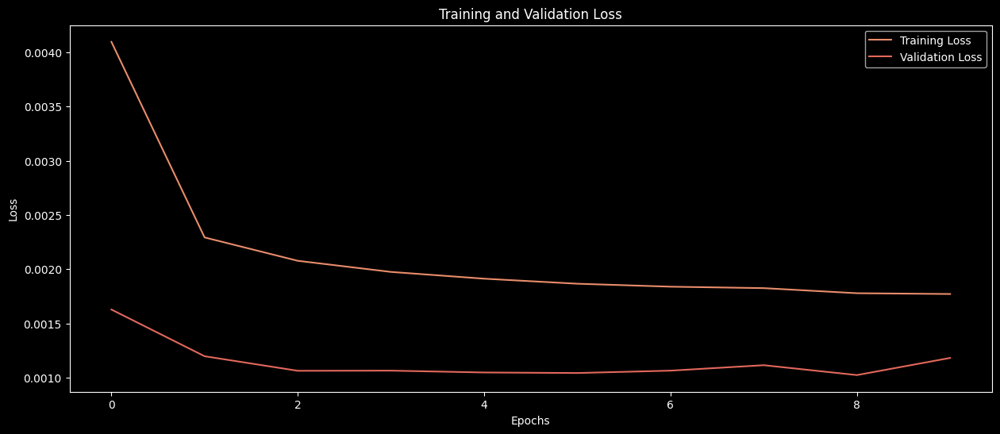

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


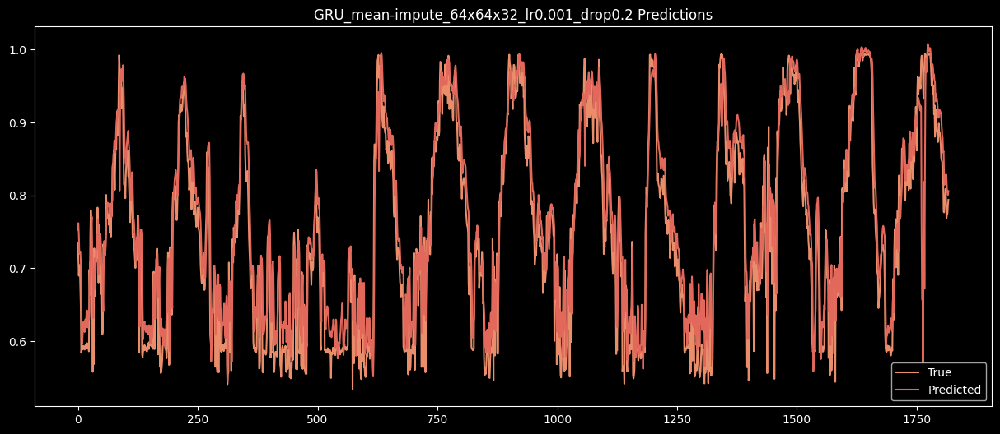

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_68"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_51 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_111 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_52 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_112 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_53 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_130 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_131 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 8ms/step - loss: 0.0079 - root_mean_squared_error: 0.0839 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0025 - root_mean_squared_error: 0.0500 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0469 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0437 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

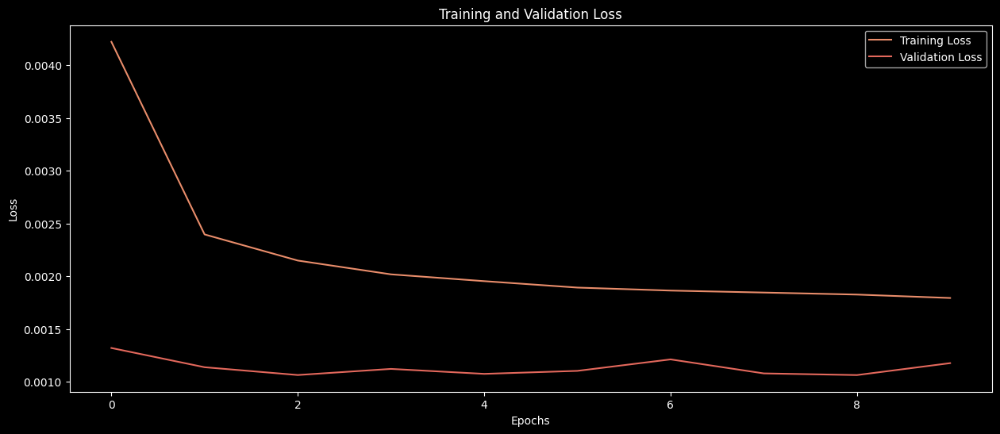

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


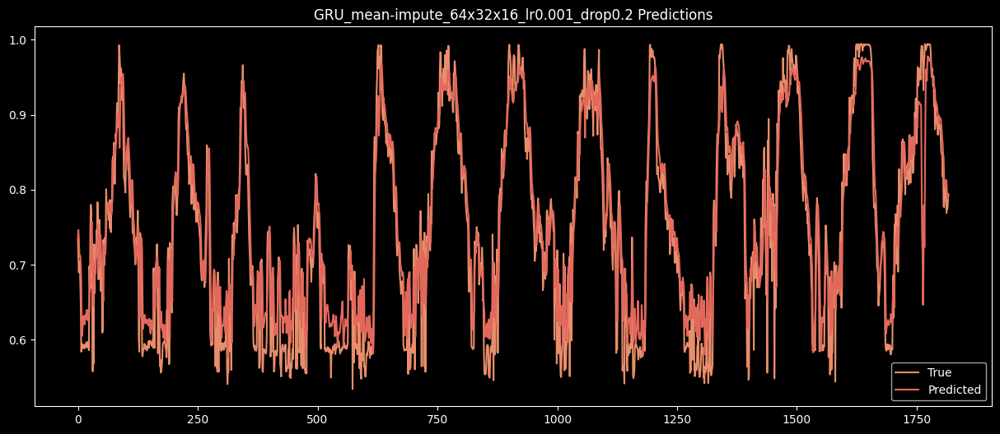

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_69"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_54 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_113 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_55 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_114 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_56 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_132 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_133 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.0085 - root_mean_squared_error: 0.0847 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0384
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0376
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0020 - root_mean_squared_error: 0.0446 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0436 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0319
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0331
Epoch 7/20
3204/3204 ━━━━━━━

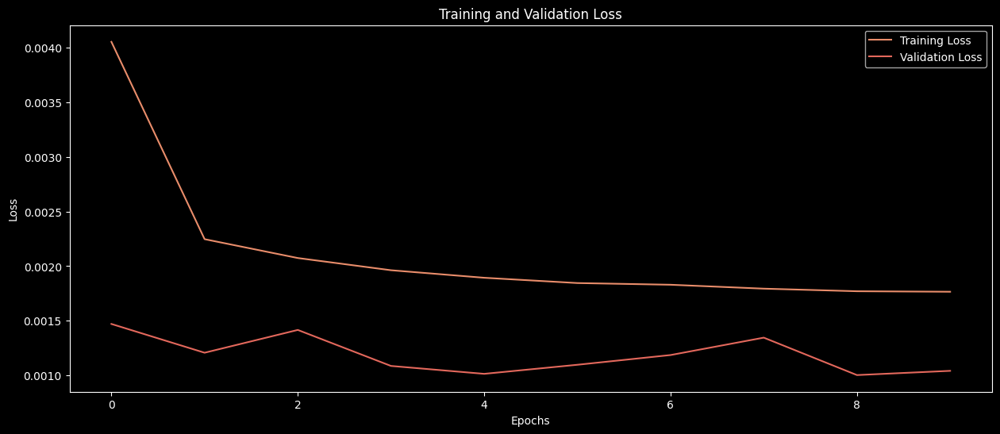

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


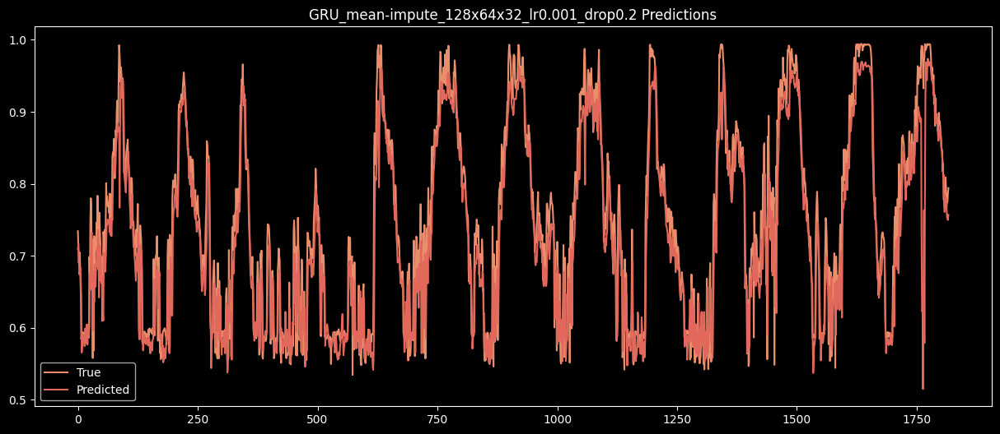

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_70"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_57 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_115 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_58 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_134 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_135 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step - loss: 0.0200 - root_mean_squared_error: 0.1156 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0024 - root_mean_squared_error: 0.0492 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0471 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0452 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0364
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0446 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0389
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

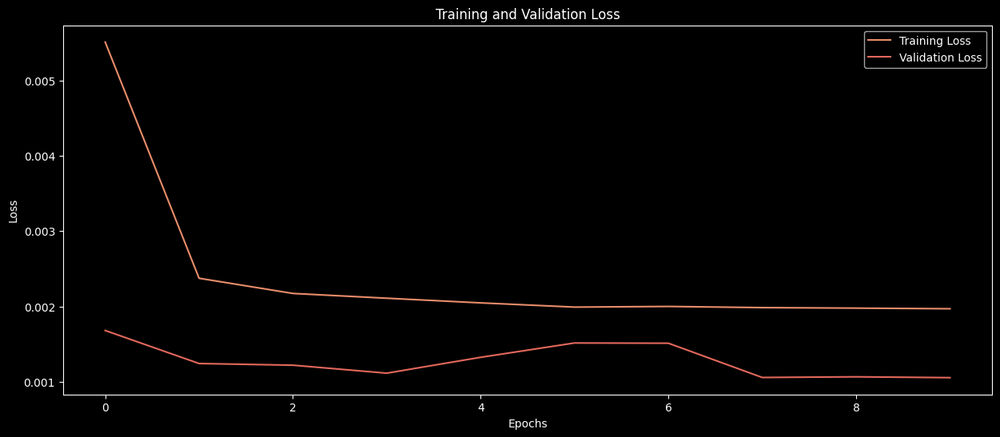

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


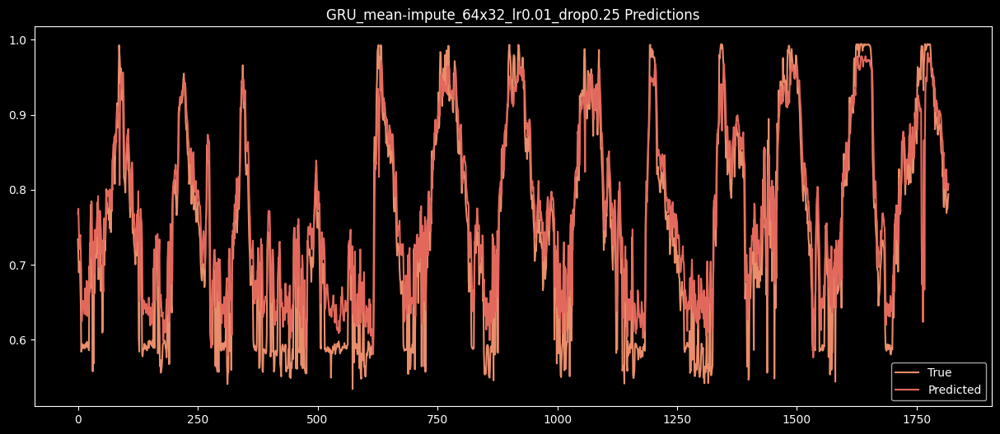

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_71"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_59 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_116 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_60 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_117 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_61 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_136 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_137 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 9ms/step - loss: 0.0127 - root_mean_squared_error: 0.0950 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0492 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0463 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0354
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0459 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0455 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

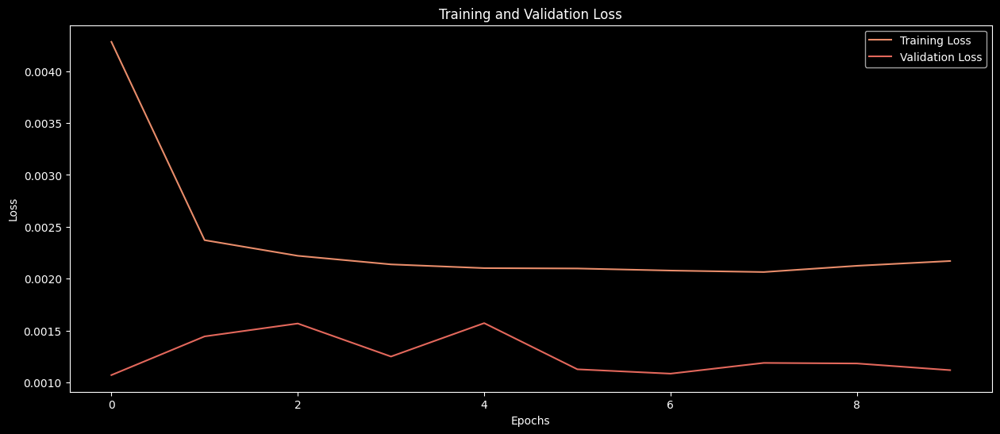

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


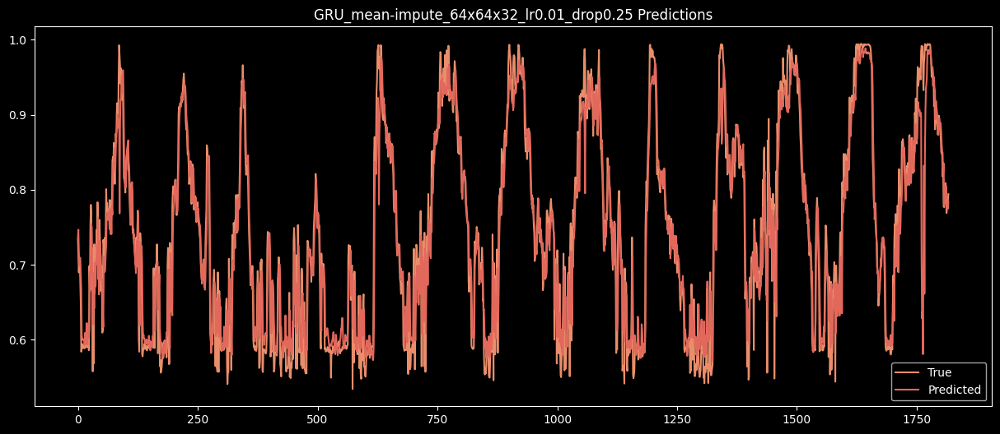

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_72"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_62 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_118 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_63 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_119 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_64 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_138 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_139 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 8ms/step - loss: 0.0116 - root_mean_squared_error: 0.0941 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0376
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0486 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0023 - root_mean_squared_error: 0.0479 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0387
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0459 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0389
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0339
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

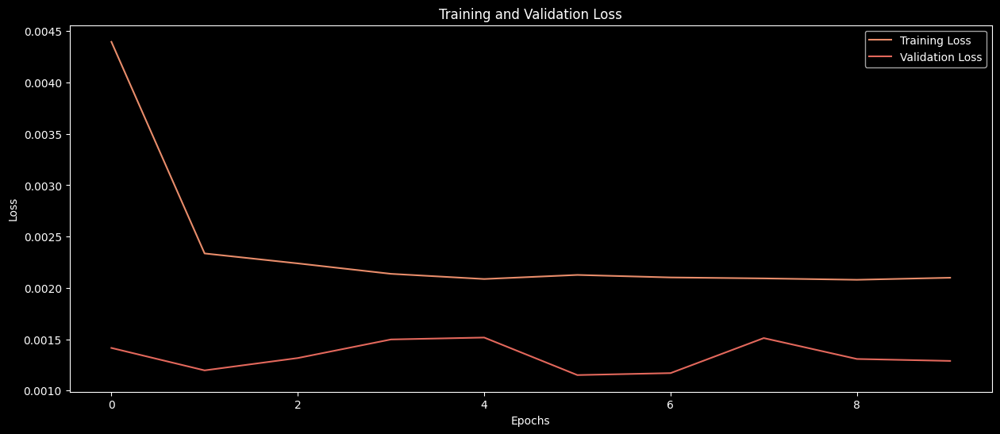

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


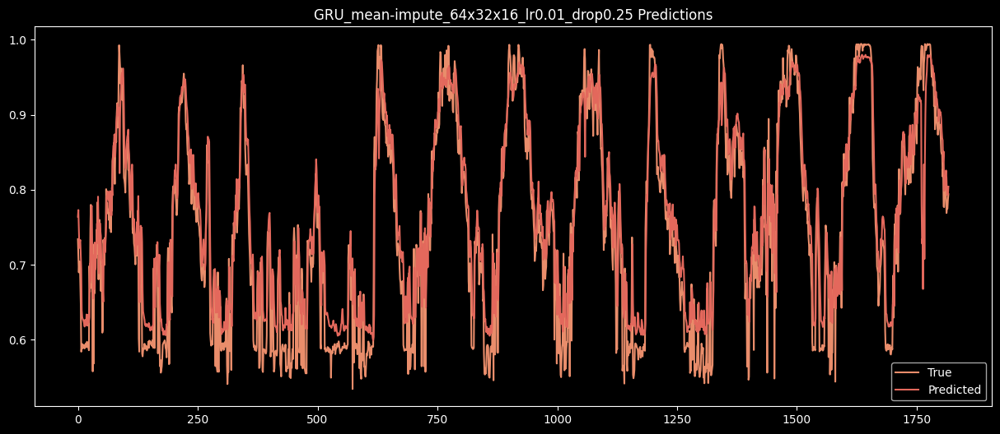

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_73"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_65 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_120 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_66 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_121 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_67 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_140 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_141 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.0184 - root_mean_squared_error: 0.1113 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0490 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0488
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 35s 11ms/step - loss: 0.0023 - root_mean_squared_error: 0.0477 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0449
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0465 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0471 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0379
Epoch 7/20
3204/3204 ━━━━━━━

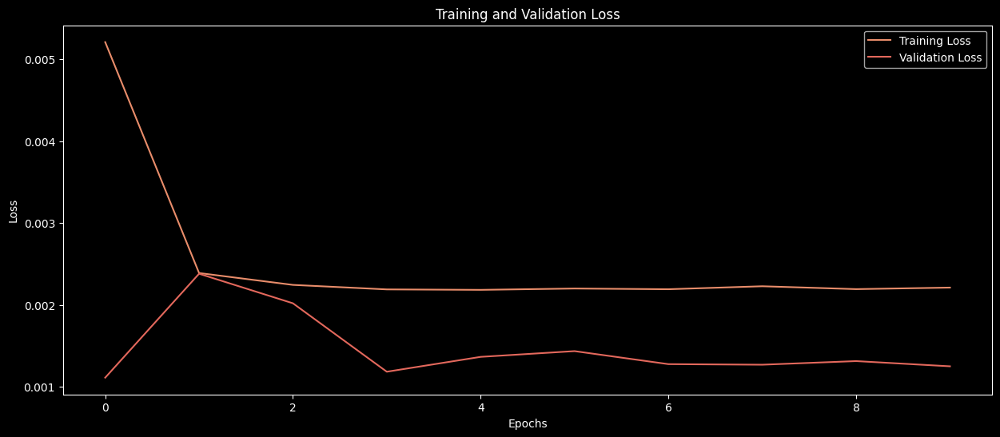

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


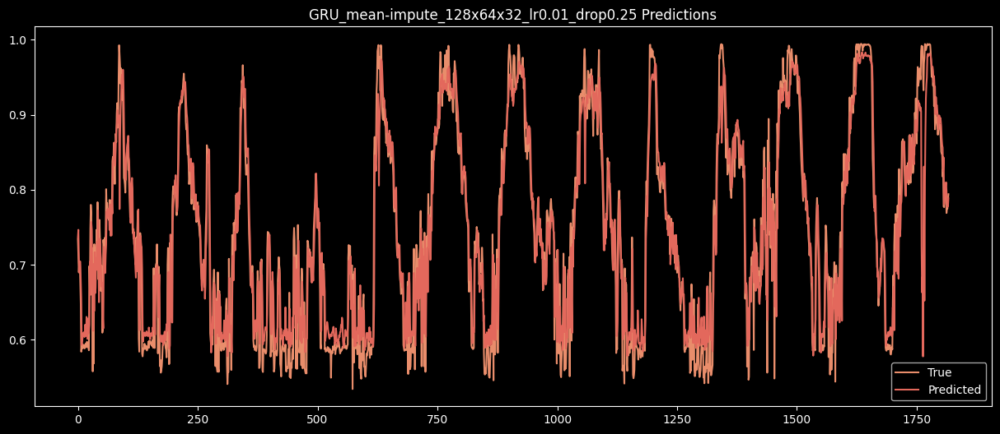

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
5        LSTM_noimpute_64x64x32_lr0.001_drop0.2  0.059490  0.044600  0.745776
6        LSTM_noimpute_64x32x16_lr0.001_drop0.2  0.069418  0.055137  0.653838
7       LSTM_noimpute_128x64x32_lr0.001_drop0.2  0.058238  0.044042  0.756359
8           LSTM_noimpute_64x32_lr0.01_drop0.25  0.046944  0.035249  0.841696
9        LSTM_noimpute_64x64x32_lr0.01_drop0.25  0.056219  0.043809  0.772961
10       LSTM_noimpute_64x32x16_lr0.01_drop0.25  0.055142  0.041767  0.781580
11      LSTM_noimpute_128x64x32_lr0.01_drop0.25  0.048356  0.036

In [120]:
gen_train_GRU(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.0001, 0.1,'mean-impute')
gen_train_GRU(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.001, 0.2,'mean-impute')
gen_train_GRU(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.01, 0.25,'mean-impute')

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_74"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_68 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_122 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_69 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_142 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_143 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0146 - root_mean_squared_error: 0.1152 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0036 - root_mean_squared_error: 0.0602 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0026 - root_mean_squared_error: 0.0505 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0354
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0447 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0449 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step 

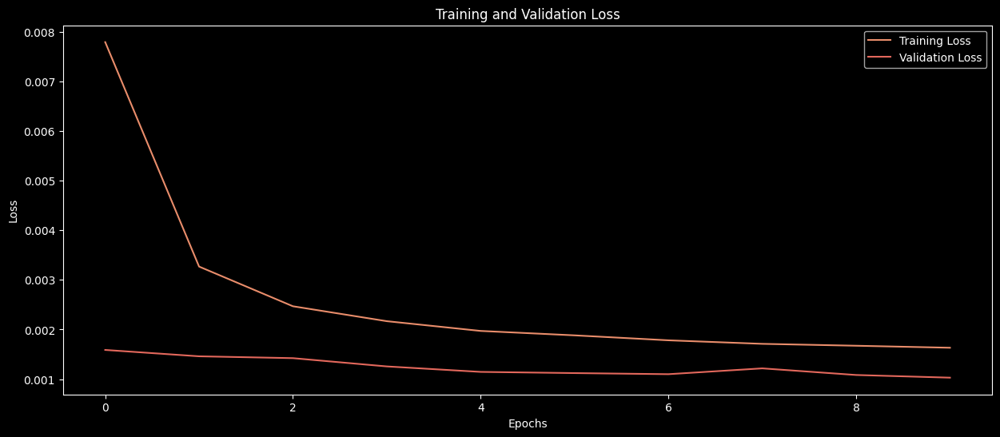

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


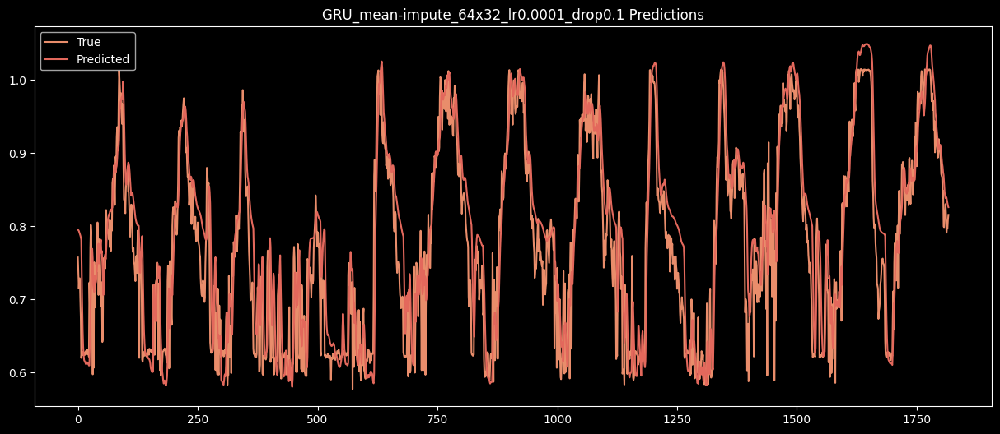

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
56      GRU_mean-impute_64x32_lr0.01_drop0.25  0.055598  0.042889  0.826931
57   GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.046198  0.030993  0.880506
58   GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.049299  0.037766  0.863925
59  GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.046006  0.031928  0.881496
60     GRU_mean-impute_64x32_lr0.0001_drop0.1  0.057404  0.044026  0.798979

[61 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_75"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_70 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_123 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_71 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_124 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_72 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_144 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_145 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0429 - root_mean_squared_error: 0.1846 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0452
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0040 - root_mean_squared_error: 0.0633 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0427
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0033 - root_mean_squared_error: 0.0572 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0029 - root_mean_squared_error: 0.0537 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0398
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0026 - root_mean_squared_error: 0.0512 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0379
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0493 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0384
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

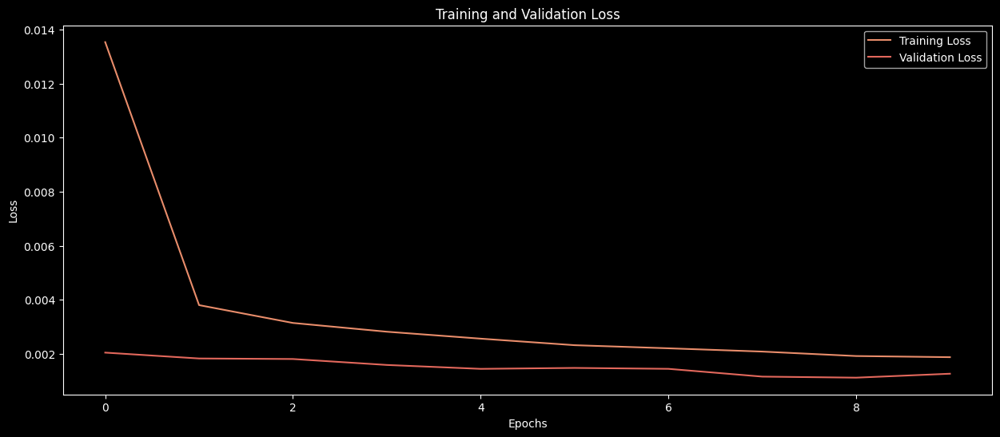

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


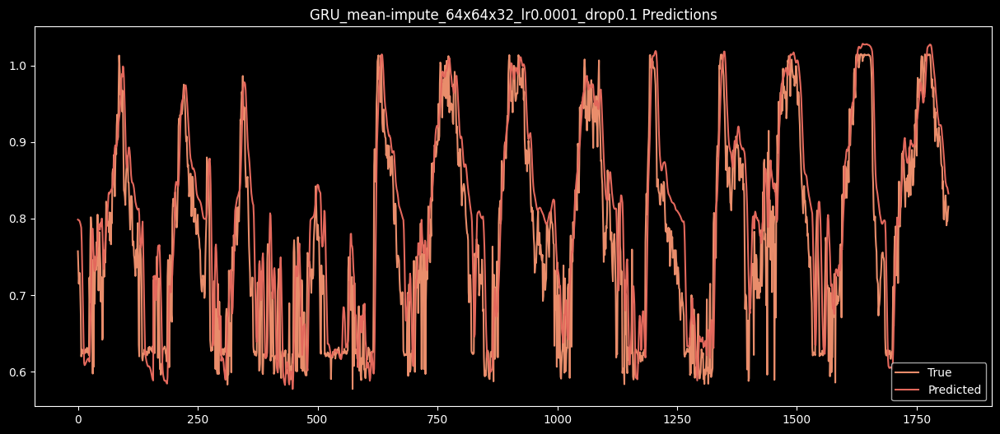

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
57   GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.046198  0.030993  0.880506
58   GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.049299  0.037766  0.863925
59  GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.046006  0.031928  0.881496
60     GRU_mean-impute_64x32_lr0.0001_drop0.1  0.057404  0.044026  0.798979
61  GRU_mean-impute_64x64x32_lr0.0001_drop0.1  0.068435  0.052717  0.714295

[62 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_76"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_73 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_125 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_74 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_126 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_75 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_146 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_147 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0991 - root_mean_squared_error: 0.2873 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0481
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0043 - root_mean_squared_error: 0.0656 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0433
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0036 - root_mean_squared_error: 0.0599 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0419
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0033 - root_mean_squared_error: 0.0570 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0412
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0546 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0398
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0511 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step 

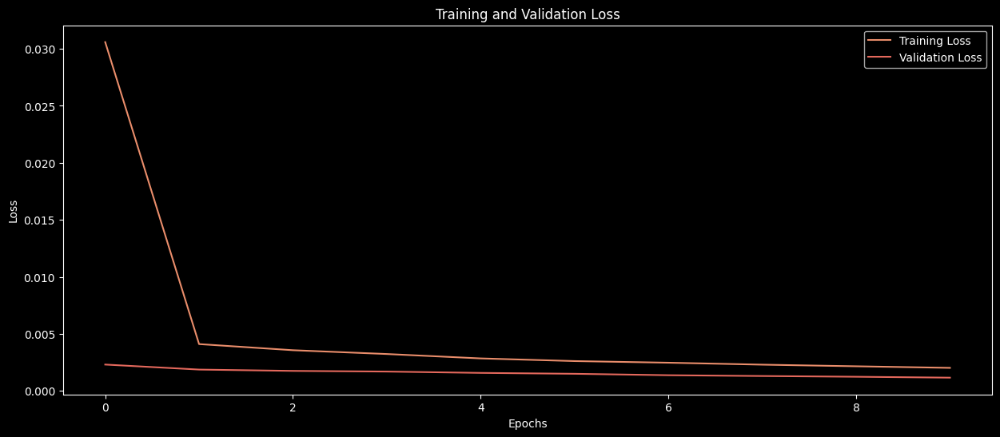

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


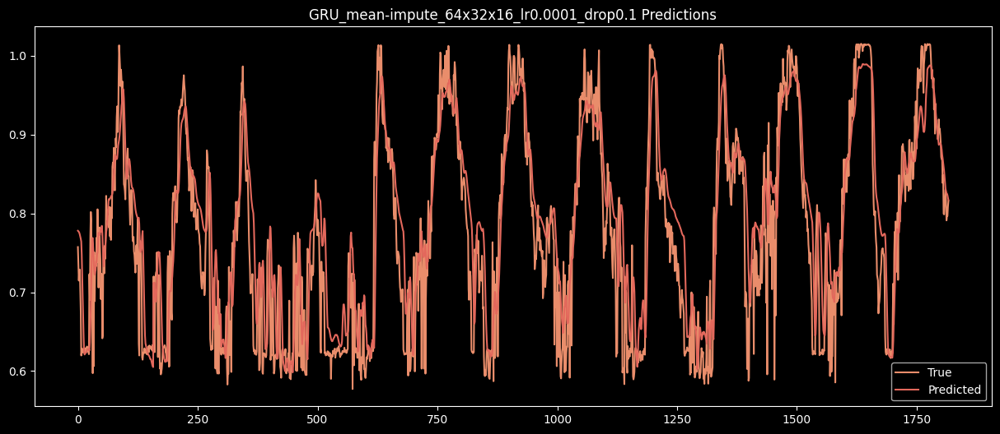

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
58   GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.049299  0.037766  0.863925
59  GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.046006  0.031928  0.881496
60     GRU_mean-impute_64x32_lr0.0001_drop0.1  0.057404  0.044026  0.798979
61  GRU_mean-impute_64x64x32_lr0.0001_drop0.1  0.068435  0.052717  0.714295
62  GRU_mean-impute_64x32x16_lr0.0001_drop0.1  0.061776  0.047147  0.767188

[63 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_77"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_76 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_127 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_77 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_128 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_78 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_148 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_149 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 0.0386 - root_mean_squared_error: 0.1733 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0036 - root_mean_squared_error: 0.0604 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0389
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0030 - root_mean_squared_error: 0.0545 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0025 - root_mean_squared_error: 0.0503 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0365
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11

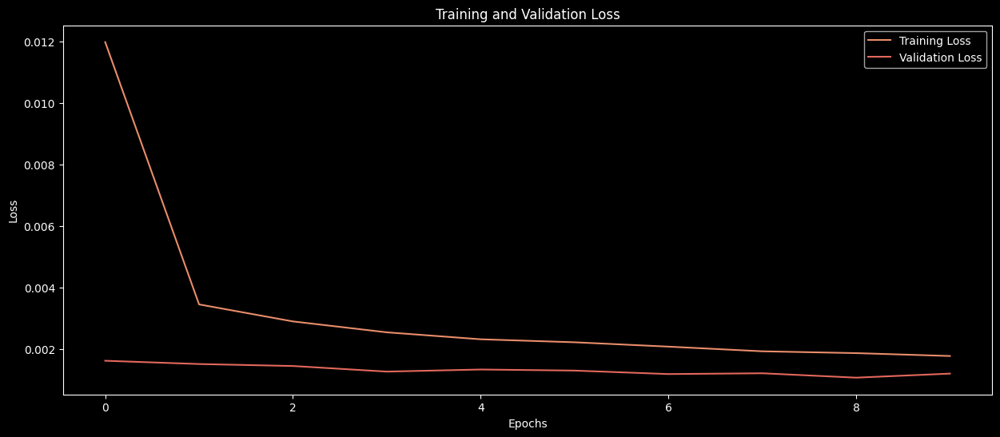

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


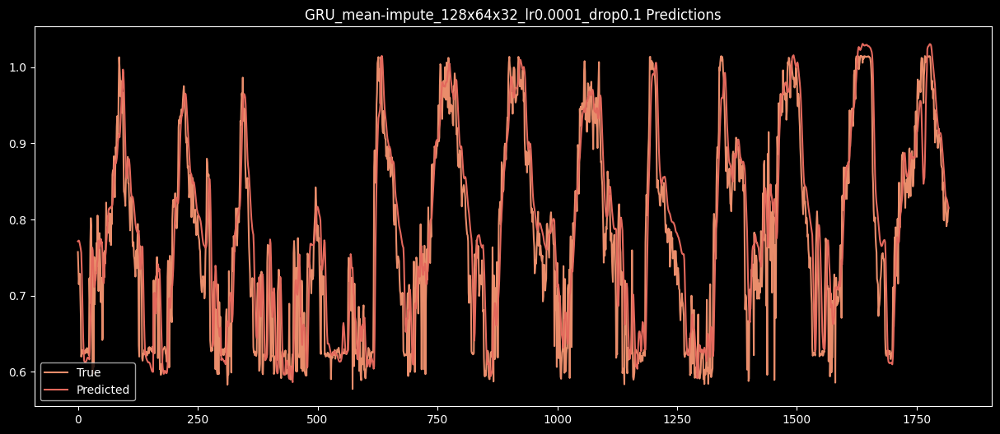

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                         ...       ...       ...       ...
59   GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.046006  0.031928  0.881496
60      GRU_mean-impute_64x32_lr0.0001_drop0.1  0.057404  0.044026  0.798979
61   GRU_mean-impute_64x64x32_lr0.0001_drop0.1  0.068435  0.052717  0.714295
62   GRU_mean-impute_64x32x16_lr0.0001_drop0.1  0.061776  0.047147  0.767188
63  GRU_mean-impute_128x64x32_lr0.0001_drop0.1  0.057733  0.043970  0.796668

[64 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_78"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_79 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_129 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_80 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_150 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_151 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0188 - root_mean_squared_error: 0.1234 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0404
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0428
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0350
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0018 - root_mean_squared_error: 0.0422 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0411
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0433 - val_loss: 9.5516e-04 - val_root_mean_squared_error: 0.0309
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0016 - root_mean_squared_error: 0.0398 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0366
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/s

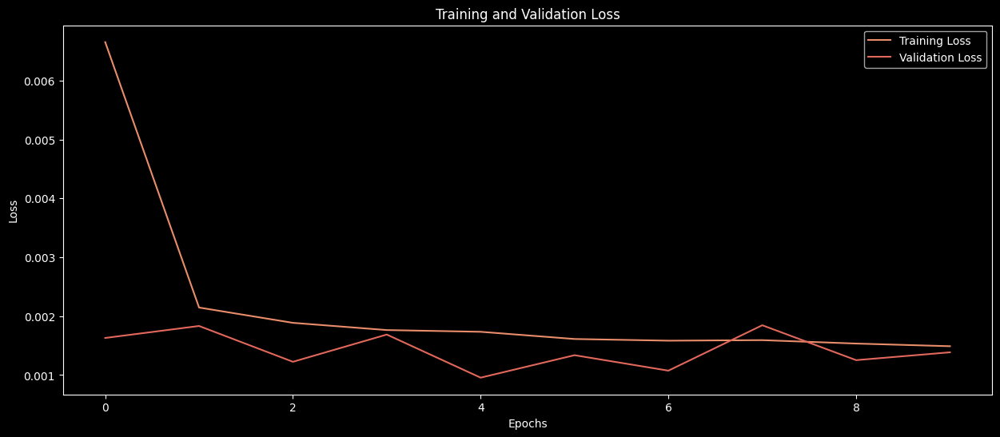

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


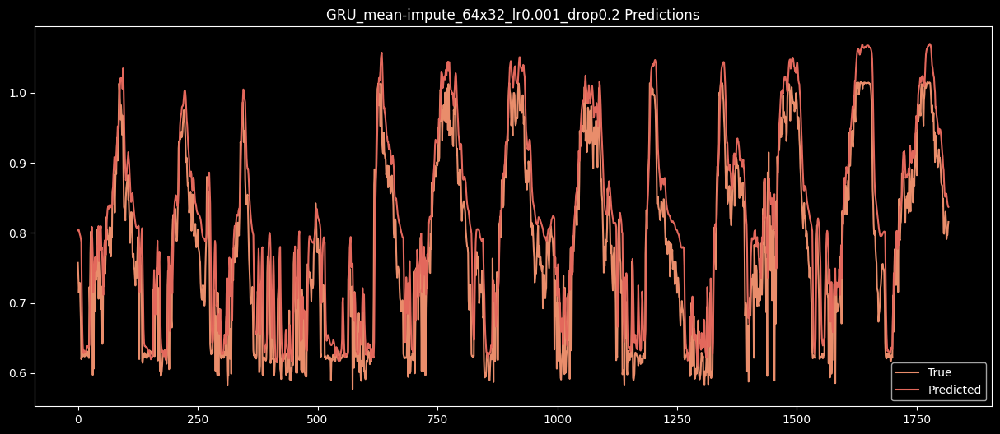

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                         ...       ...       ...       ...
60      GRU_mean-impute_64x32_lr0.0001_drop0.1  0.057404  0.044026  0.798979
61   GRU_mean-impute_64x64x32_lr0.0001_drop0.1  0.068435  0.052717  0.714295
62   GRU_mean-impute_64x32x16_lr0.0001_drop0.1  0.061776  0.047147  0.767188
63  GRU_mean-impute_128x64x32_lr0.0001_drop0.1  0.057733  0.043970  0.796668
64       GRU_mean-impute_64x32_lr0.001_drop0.2  0.063671  0.051355  0.752688

[65 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_79"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_81 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_130 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_82 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_131 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_83 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_152 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_153 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0327 - root_mean_squared_error: 0.1562 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0441
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0028 - root_mean_squared_error: 0.0531 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0365
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0319
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0016 - root_mean_squared_error: 0.0405 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

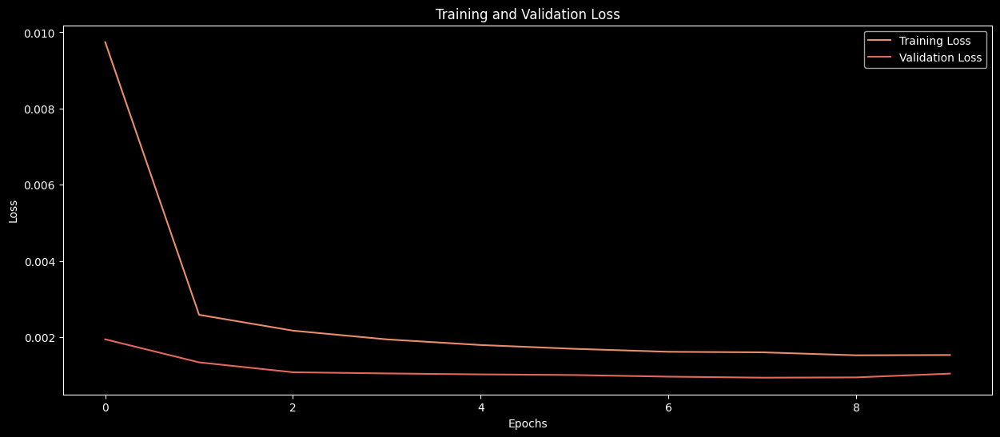

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


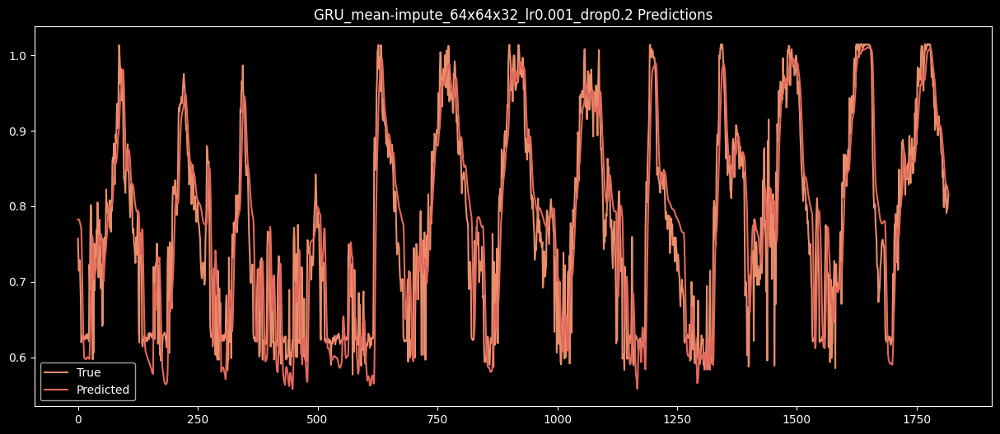

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                         ...       ...       ...       ...
61   GRU_mean-impute_64x64x32_lr0.0001_drop0.1  0.068435  0.052717  0.714295
62   GRU_mean-impute_64x32x16_lr0.0001_drop0.1  0.061776  0.047147  0.767188
63  GRU_mean-impute_128x64x32_lr0.0001_drop0.1  0.057733  0.043970  0.796668
64       GRU_mean-impute_64x32_lr0.001_drop0.2  0.063671  0.051355  0.752688
65    GRU_mean-impute_64x64x32_lr0.001_drop0.2  0.059828  0.045753  0.781643

[66 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_80"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_84 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_132 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_85 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_133 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_86 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_154 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_155 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0434 - root_mean_squared_error: 0.1824 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0481
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0031 - root_mean_squared_error: 0.0560 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0384
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0506 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0469 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0376
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0359
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step 

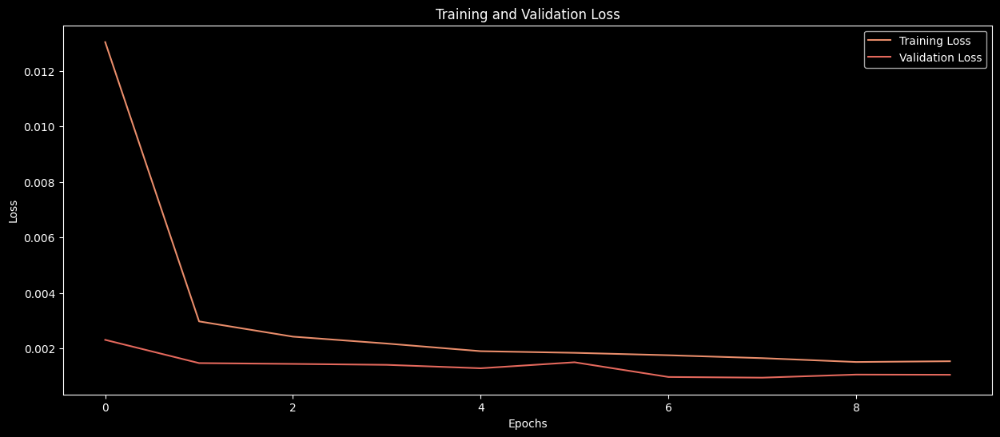

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


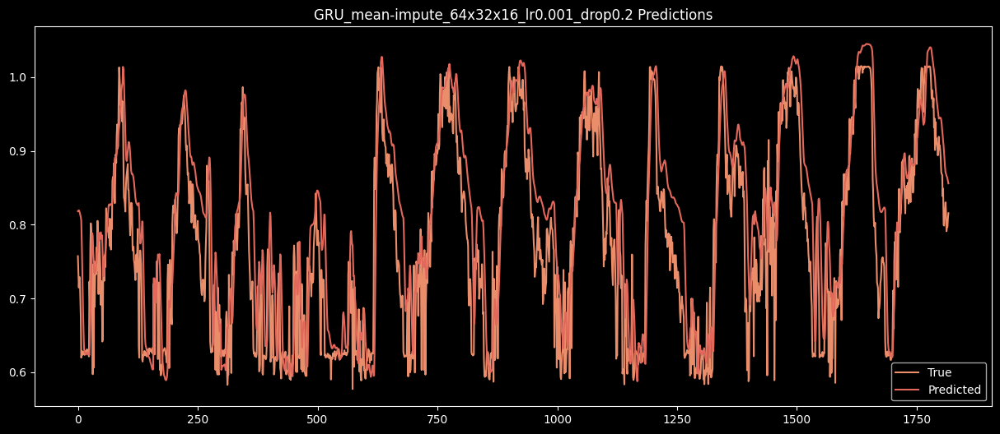

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                         ...       ...       ...       ...
62   GRU_mean-impute_64x32x16_lr0.0001_drop0.1  0.061776  0.047147  0.767188
63  GRU_mean-impute_128x64x32_lr0.0001_drop0.1  0.057733  0.043970  0.796668
64       GRU_mean-impute_64x32_lr0.001_drop0.2  0.063671  0.051355  0.752688
65    GRU_mean-impute_64x64x32_lr0.001_drop0.2  0.059828  0.045753  0.781643
66    GRU_mean-impute_64x32x16_lr0.001_drop0.2  0.072155  0.056542  0.682389

[67 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_81"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_87 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_134 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_88 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_135 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_89 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_156 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_157 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - loss: 0.0417 - root_mean_squared_error: 0.1738 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0027 - root_mean_squared_error: 0.0522 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0023 - root_mean_squared_error: 0.0475 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0421 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0407 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10

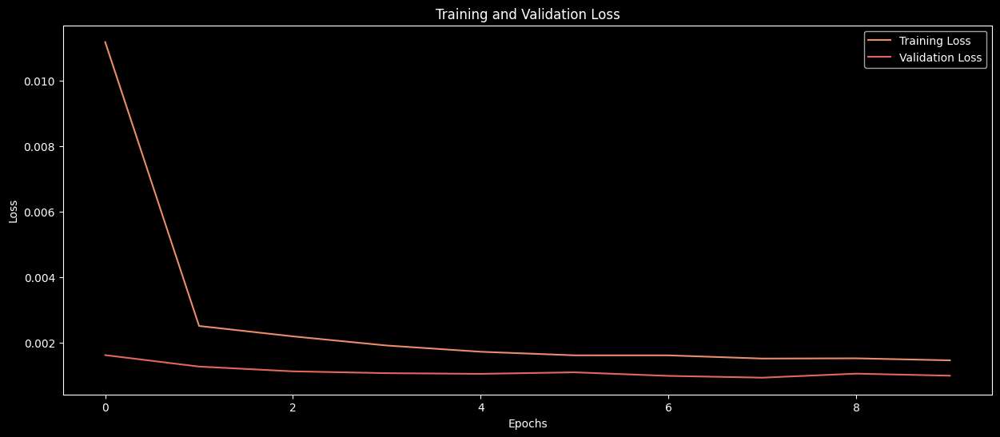

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


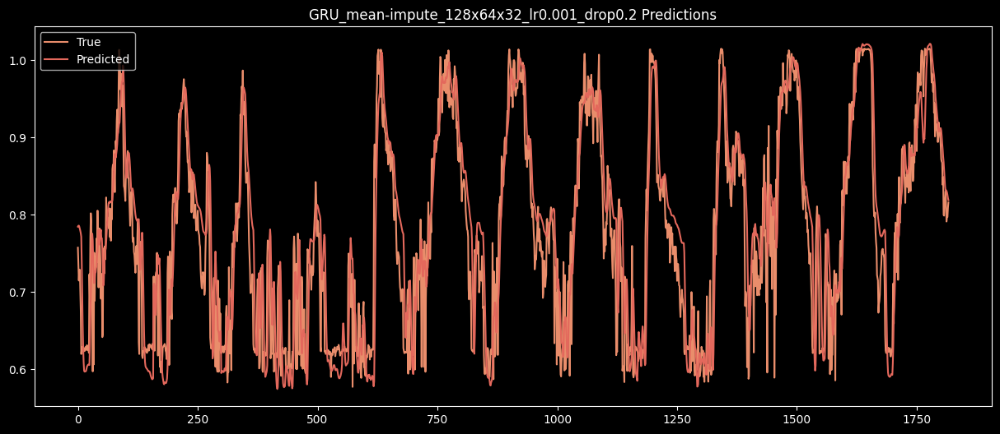

                                         Model      RMSE       MAE        R2
0         LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1      LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2      LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3     LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4          LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                         ...       ...       ...       ...
63  GRU_mean-impute_128x64x32_lr0.0001_drop0.1  0.057733  0.043970  0.796668
64       GRU_mean-impute_64x32_lr0.001_drop0.2  0.063671  0.051355  0.752688
65    GRU_mean-impute_64x64x32_lr0.001_drop0.2  0.059828  0.045753  0.781643
66    GRU_mean-impute_64x32x16_lr0.001_drop0.2  0.072155  0.056542  0.682389
67   GRU_mean-impute_128x64x32_lr0.001_drop0.2  0.057423  0.043824  0.798845

[68 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_82"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_90 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_136 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_91 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_158 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_159 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,817 (104.75 KB)

 Trainable params: 26,817 (104.75 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.1584 - root_mean_squared_error: 0.3285 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0409
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0023 - root_mean_squared_error: 0.0477 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0320
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0017 - root_mean_squared_error: 0.0416 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0444
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0444 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0016 - root_mean_squared_error: 0.0397 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step 

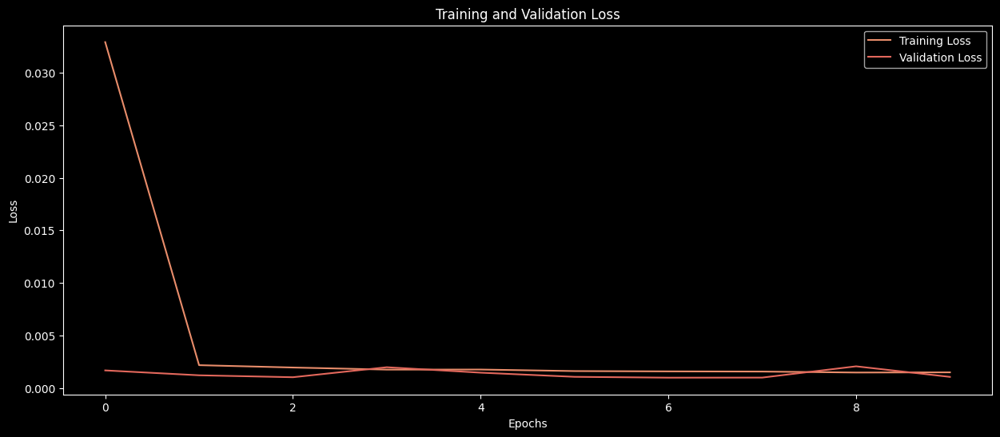

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


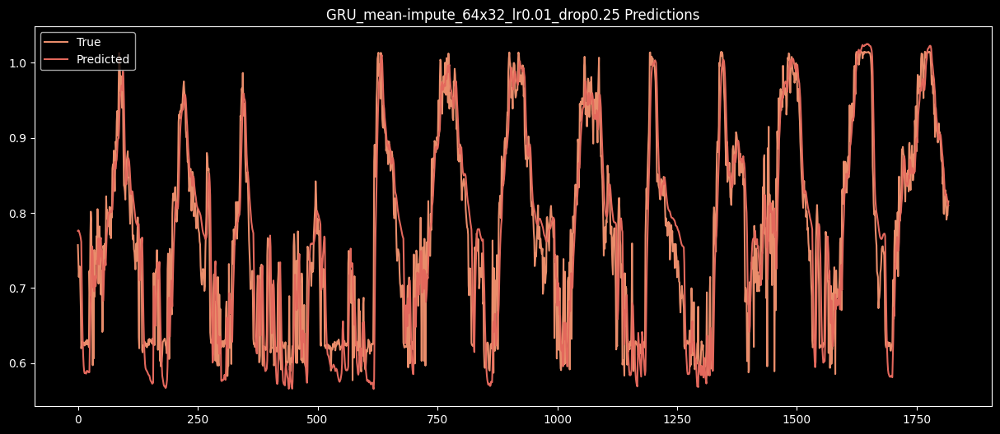

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
64      GRU_mean-impute_64x32_lr0.001_drop0.2  0.063671  0.051355  0.752688
65   GRU_mean-impute_64x64x32_lr0.001_drop0.2  0.059828  0.045753  0.781643
66   GRU_mean-impute_64x32x16_lr0.001_drop0.2  0.072155  0.056542  0.682389
67  GRU_mean-impute_128x64x32_lr0.001_drop0.2  0.057423  0.043824  0.798845
68      GRU_mean-impute_64x32_lr0.01_drop0.25  0.053933  0.041404  0.822551

[69 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_83"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_92 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_137 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_93 (GRU)                    │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_138 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_94 (GRU)                    │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_160 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_161 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,777 (202.25 KB)

 Trainable params: 51,777 (202.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0771 - root_mean_squared_error: 0.2301 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0473
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0416 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0324
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0434 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0424
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0412 - val_loss: 9.1695e-04 - val_root_mean_squared_error: 0.0303
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0015 - root_mean_squared_error: 0.0392 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0354
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/

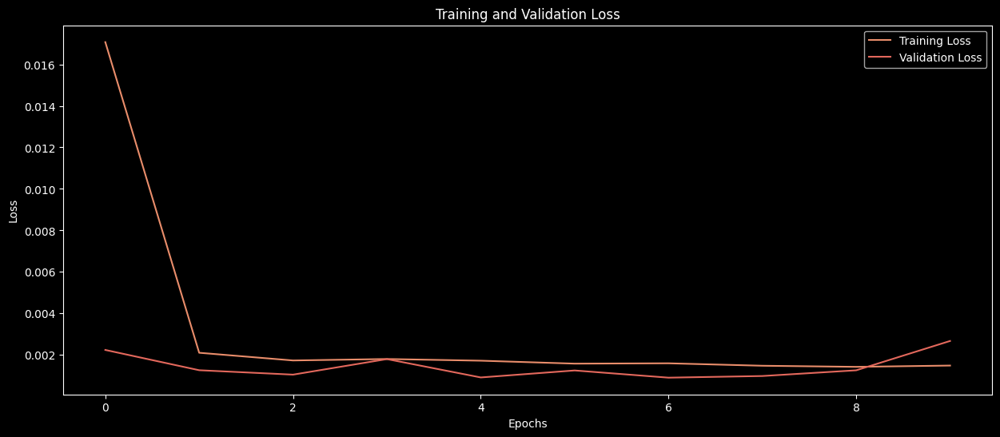

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


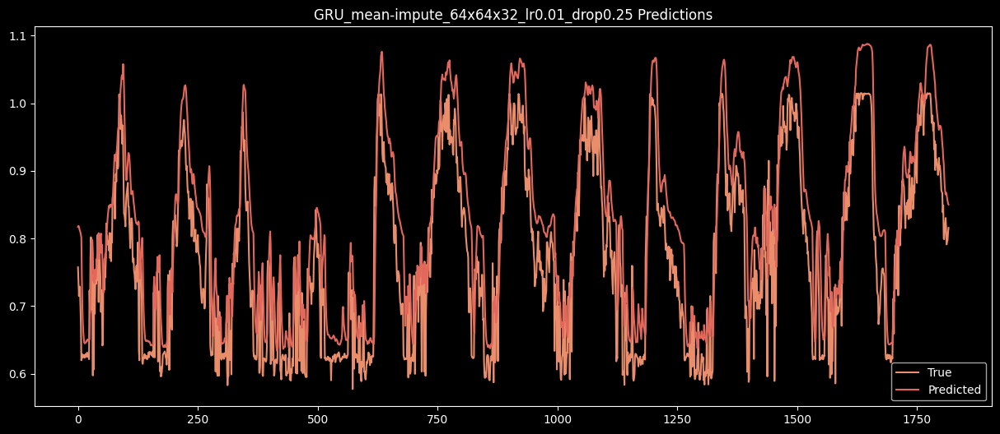

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
65   GRU_mean-impute_64x64x32_lr0.001_drop0.2  0.059828  0.045753  0.781643
66   GRU_mean-impute_64x32x16_lr0.001_drop0.2  0.072155  0.056542  0.682389
67  GRU_mean-impute_128x64x32_lr0.001_drop0.2  0.057423  0.043824  0.798845
68      GRU_mean-impute_64x32_lr0.01_drop0.25  0.053933  0.041404  0.822551
69   GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.073323  0.061822  0.672022

[70 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_84"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_95 (GRU)                    │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_139 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_96 (GRU)                    │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_140 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_97 (GRU)                    │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_162 (Dense)               │ (None, 16)             │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_163 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,417 (111.00 KB)

 Trainable params: 28,417 (111.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.0432 - root_mean_squared_error: 0.1787 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0415
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0467 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0316
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0420 - val_loss: 9.5908e-04 - val_root_mean_squared_error: 0.0310
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0017 - root_mean_squared_error: 0.0408 - val_loss: 9.7196e-04 - val_root_mean_squared_error: 0.0312
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0017 - root_mean_squared_error: 0.0409 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0395 - val_loss: 9.3354e-04 - val_root_mean_squared_error: 0.0306
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 

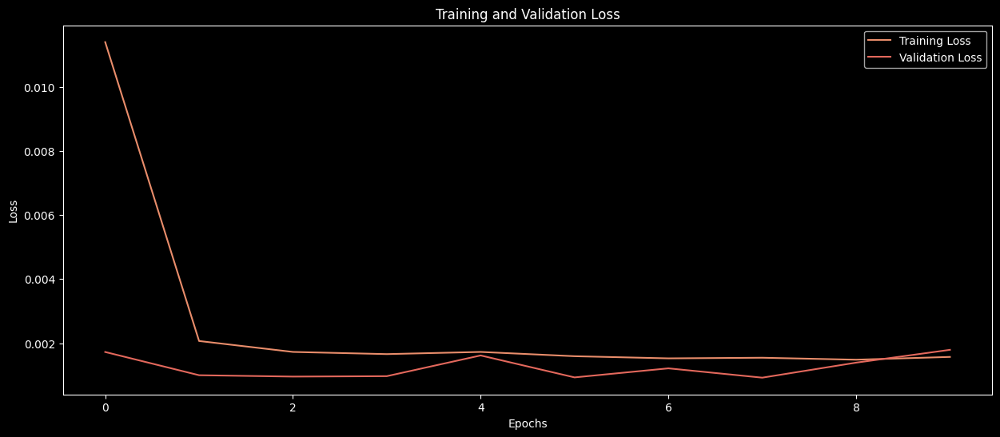

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


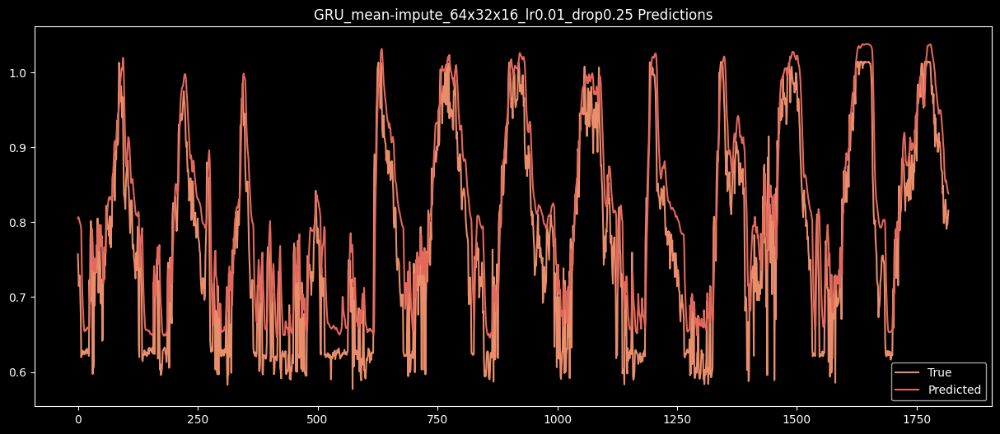

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
66   GRU_mean-impute_64x32x16_lr0.001_drop0.2  0.072155  0.056542  0.682389
67  GRU_mean-impute_128x64x32_lr0.001_drop0.2  0.057423  0.043824  0.798845
68      GRU_mean-impute_64x32_lr0.01_drop0.25  0.053933  0.041404  0.822551
69   GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.073323  0.061822  0.672022
70   GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.065093  0.053634  0.741515

[71 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_85"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_98 (GRU)                    │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_141 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_99 (GRU)                    │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_142 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_100 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_164 (Dense)               │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_165 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,961 (410.00 KB)

 Trainable params: 104,961 (410.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.1007 - root_mean_squared_error: 0.2628 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0471 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0405
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0020 - root_mean_squared_error: 0.0452 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0420 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0426 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0406
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0016 - root_mean_squared_error: 0.0394 - val_loss: 9.7405e-04 - val_root_mean_squared_error: 0.0312
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4

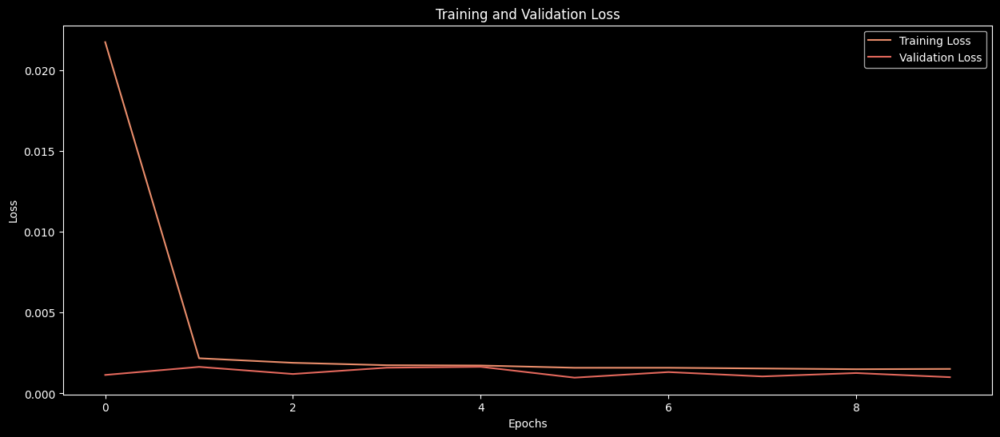

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


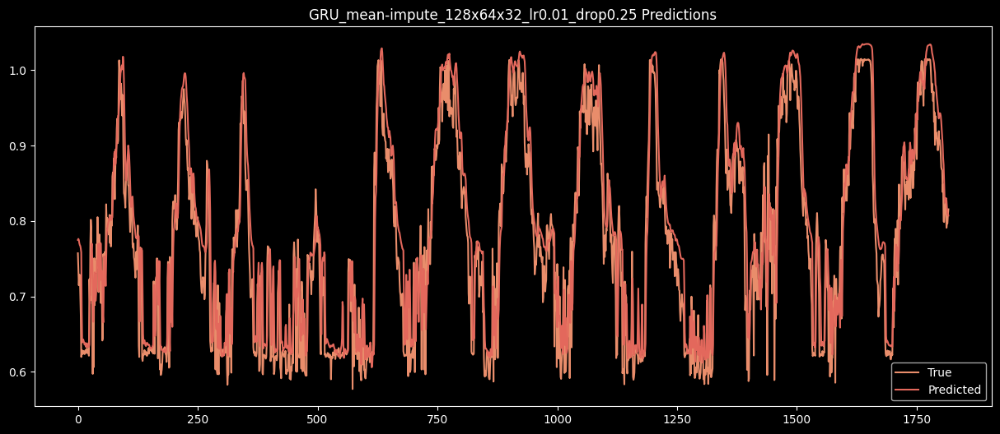

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
67  GRU_mean-impute_128x64x32_lr0.001_drop0.2  0.057423  0.043824  0.798845
68      GRU_mean-impute_64x32_lr0.01_drop0.25  0.053933  0.041404  0.822551
69   GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.073323  0.061822  0.672022
70   GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.065093  0.053634  0.741515
71  GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.050837  0.039153  0.842340

[72 rows x 4 columns]


In [121]:
gen_train_GRU(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.0001, 0.1,'mean-impute')
gen_train_GRU(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.001, 0.2,'mean-impute')
gen_train_GRU(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.01, 0.25,'mean-impute')


- Konvolucija
- Transformer
- Izaberi najbolji model i dodaj mu 

## +FFT

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_86"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_128 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_143 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_129 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_6 (FFTLayer)          │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_166 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_167 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0191 - root_mean_squared_error: 0.1268 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0485
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0038 - root_mean_squared_error: 0.0619 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0029 - root_mean_squared_error: 0.0539 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0504 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0365
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0351
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step 

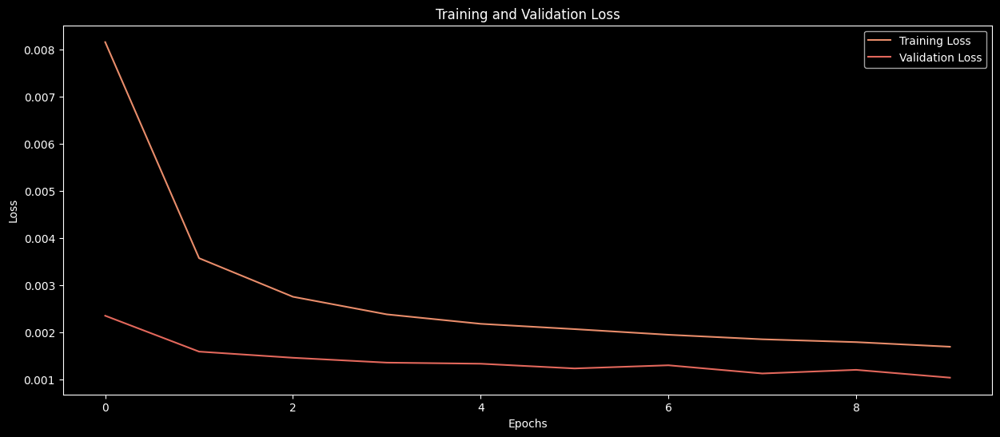

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


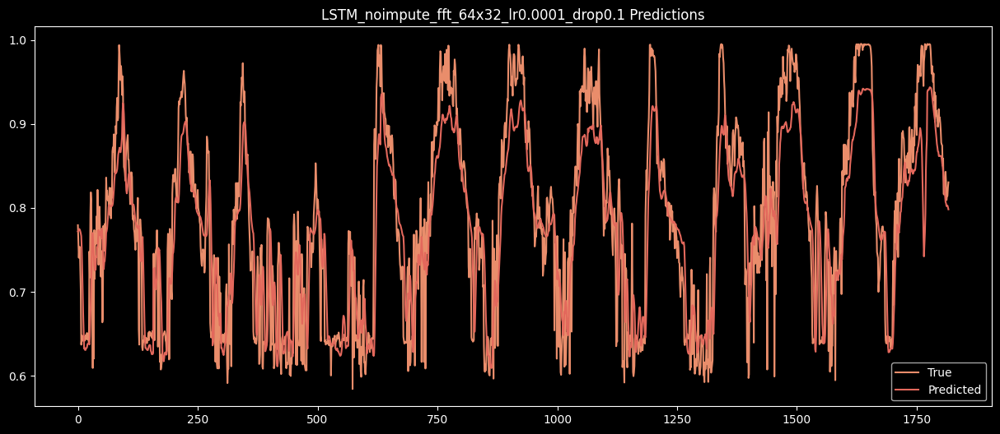

                                        Model      RMSE       MAE        R2
0        LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1     LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2     LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3    LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4         LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                        ...       ...       ...       ...
68      GRU_mean-impute_64x32_lr0.01_drop0.25  0.053933  0.041404  0.822551
69   GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.073323  0.061822  0.672022
70   GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.065093  0.053634  0.741515
71  GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.050837  0.039153  0.842340
72   LSTM_noimpute_fft_64x32_lr0.0001_drop0.1  0.059576  0.046324  0.745033

[73 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_87"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_130 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_144 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_131 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_145 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_132 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_7 (FFTLayer)          │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_168 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_169 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0547 - root_mean_squared_error: 0.2059 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0480
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0047 - root_mean_squared_error: 0.0684 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0462
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0038 - root_mean_squared_error: 0.0619 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0437
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0033 - root_mean_squared_error: 0.0571 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0432
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0030 - root_mean_squared_error: 0.0543 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0417
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0028 - root_mean_squared_error: 0.0532 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0409
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step 

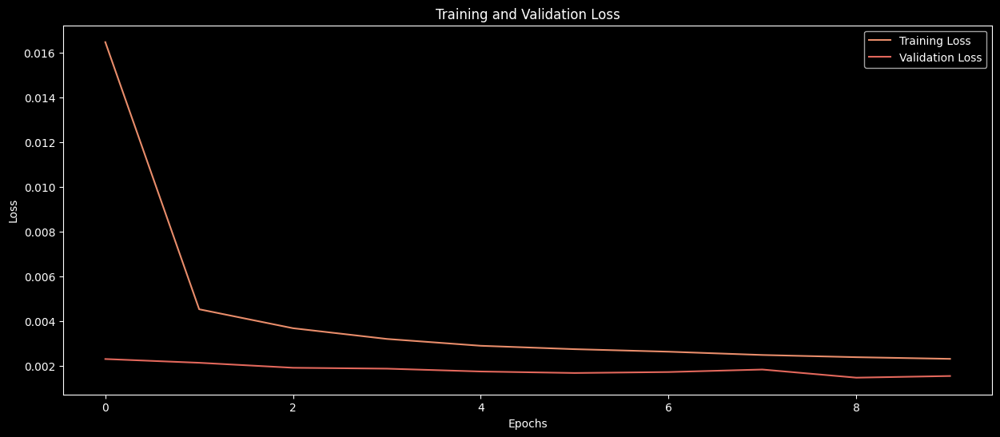

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


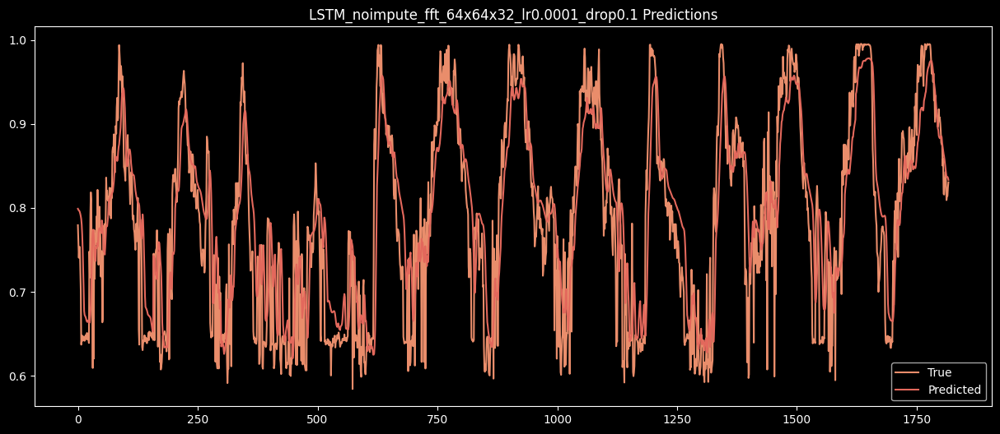

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
69     GRU_mean-impute_64x64x32_lr0.01_drop0.25  0.073323  0.061822  0.672022
70     GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.065093  0.053634  0.741515
71    GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.050837  0.039153  0.842340
72     LSTM_noimpute_fft_64x32_lr0.0001_drop0.1  0.059576  0.046324  0.745033
73  LSTM_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.062722  0.048380  0.717397

[74 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_88"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_133 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_146 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_134 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_147 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_135 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_8 (FFTLayer)          │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_170 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_171 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - loss: 0.0562 - root_mean_squared_error: 0.2149 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0462
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0041 - root_mean_squared_error: 0.0641 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0445
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0036 - root_mean_squared_error: 0.0603 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0441
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0032 - root_mean_squared_error: 0.0569 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0437
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0030 - root_mean_squared_error: 0.0551 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0426
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0029 - root_mean_squared_error: 0.0542 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0434
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step 

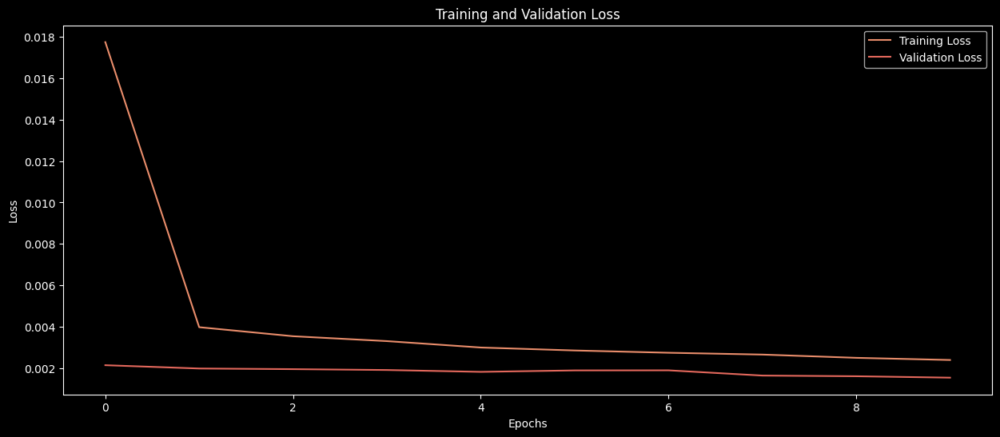

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


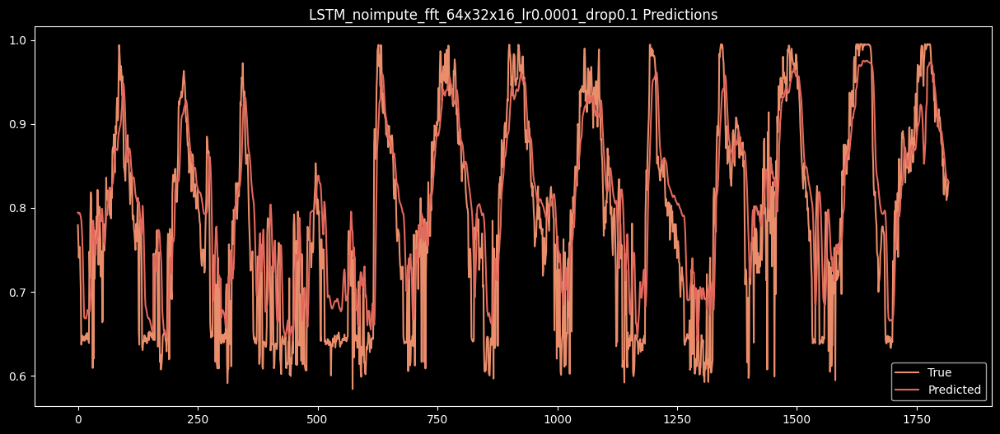

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
70     GRU_mean-impute_64x32x16_lr0.01_drop0.25  0.065093  0.053634  0.741515
71    GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.050837  0.039153  0.842340
72     LSTM_noimpute_fft_64x32_lr0.0001_drop0.1  0.059576  0.046324  0.745033
73  LSTM_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.062722  0.048380  0.717397
74  LSTM_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.064323  0.049705  0.702786

[75 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_89"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_136 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_148 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_137 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_149 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_138 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_9 (FFTLayer)          │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_172 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_173 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0630 - root_mean_squared_error: 0.2184 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0456
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0041 - root_mean_squared_error: 0.0644 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0447
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0035 - root_mean_squared_error: 0.0592 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0432
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0030 - root_mean_squared_error: 0.0551 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0436
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0028 - root_mean_squared_error: 0.0528 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0404
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0027 - root_mean_squared_error: 0.0516 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0395
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10m

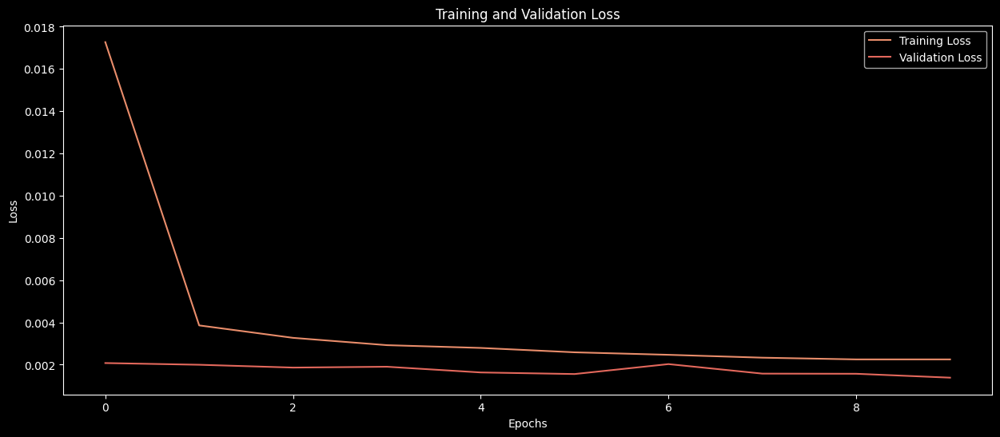

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


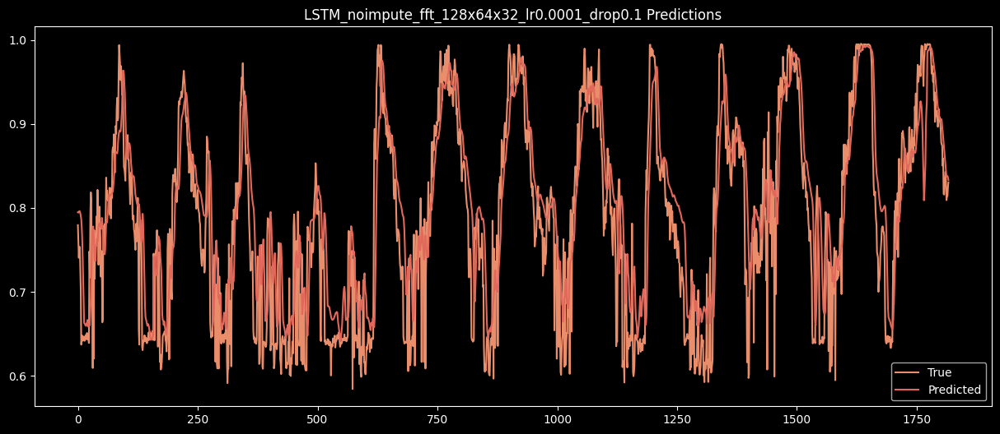

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
71     GRU_mean-impute_128x64x32_lr0.01_drop0.25  0.050837  0.039153  0.842340
72      LSTM_noimpute_fft_64x32_lr0.0001_drop0.1  0.059576  0.046324  0.745033
73   LSTM_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.062722  0.048380  0.717397
74   LSTM_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.064323  0.049705  0.702786
75  LSTM_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.062922  0.048644  0.715592

[76 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_90"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_139 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_150 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_140 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_10 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_174 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_175 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0556 - root_mean_squared_error: 0.2005 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0416
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0028 - root_mean_squared_error: 0.0528 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0433
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0024 - root_mean_squared_error: 0.0490 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0366
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0457 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0438 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0347
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0018 - root_mean_squared_error: 0.0420 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step 

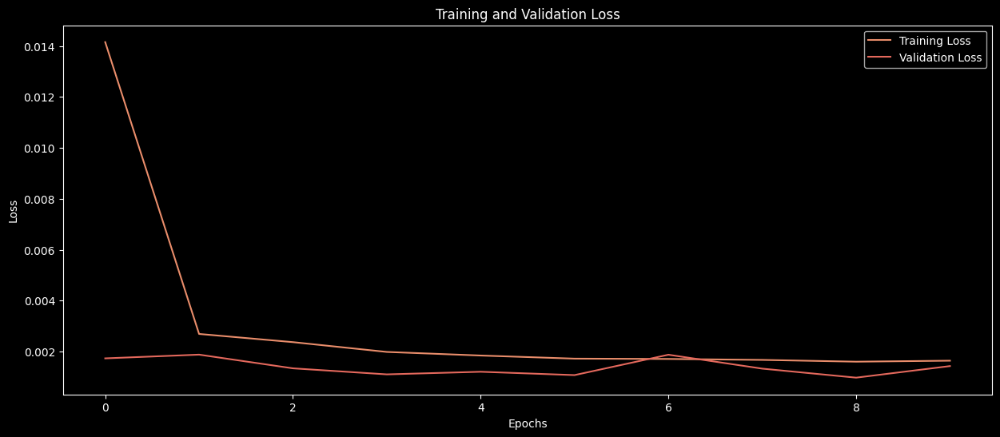

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


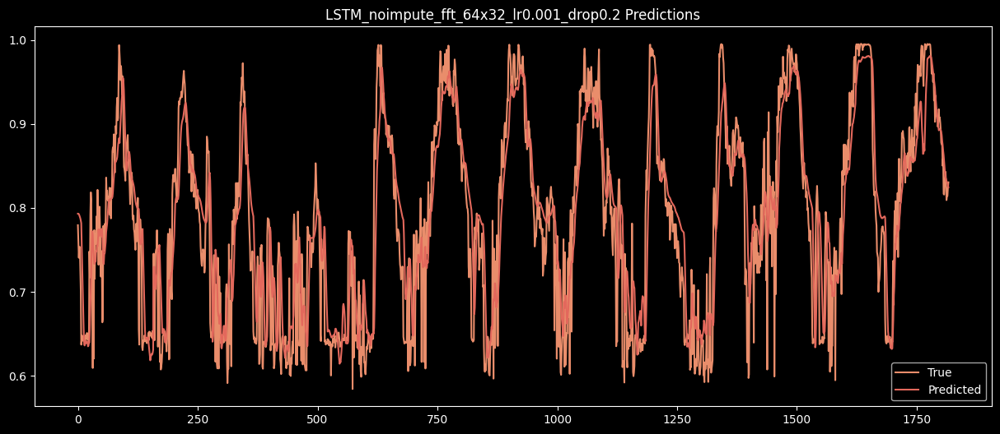

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
72      LSTM_noimpute_fft_64x32_lr0.0001_drop0.1  0.059576  0.046324  0.745033
73   LSTM_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.062722  0.048380  0.717397
74   LSTM_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.064323  0.049705  0.702786
75  LSTM_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.062922  0.048644  0.715592
76       LSTM_noimpute_fft_64x32_lr0.001_drop0.2  0.055603  0.042191  0.777910

[77 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_91"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_141 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_151 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_142 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_152 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_143 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_11 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_176 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_177 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0466 - root_mean_squared_error: 0.1828 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0437
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0033 - root_mean_squared_error: 0.0574 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0431
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0507 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0461
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0490 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 9.8229e-04 - val_root_mean_squared_error: 0.0313
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/s

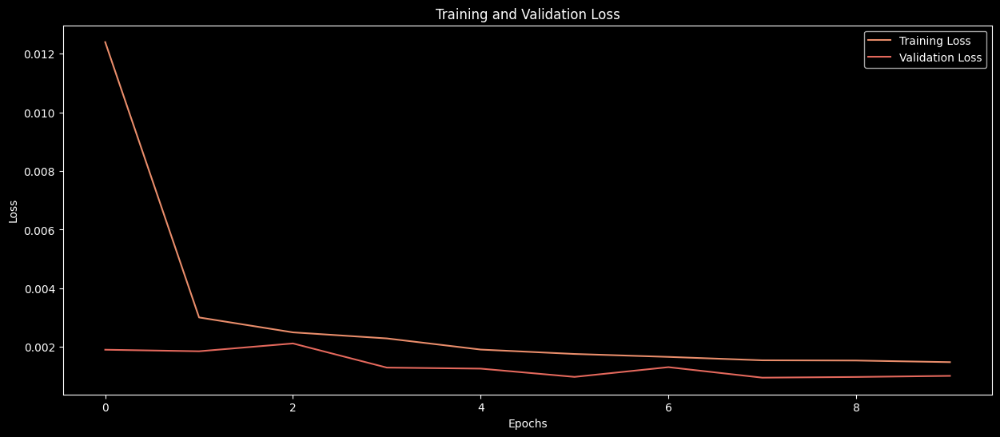

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


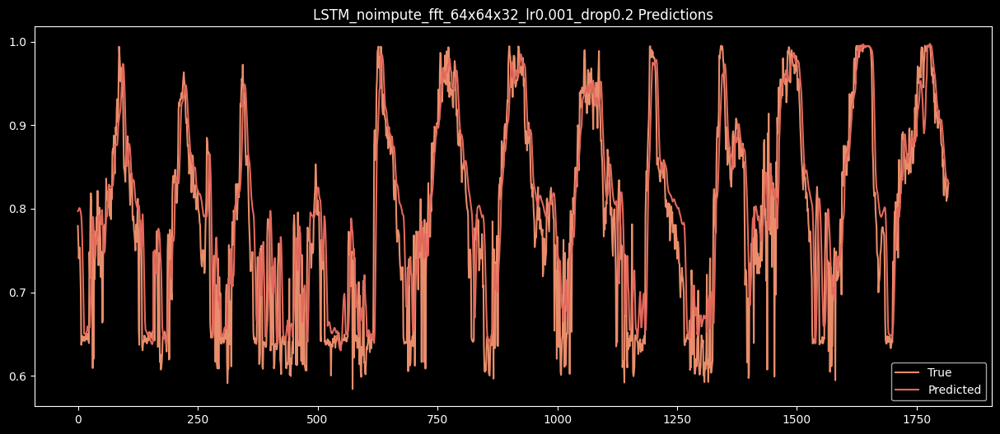

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
73   LSTM_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.062722  0.048380  0.717397
74   LSTM_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.064323  0.049705  0.702786
75  LSTM_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.062922  0.048644  0.715592
76       LSTM_noimpute_fft_64x32_lr0.001_drop0.2  0.055603  0.042191  0.777910
77    LSTM_noimpute_fft_64x64x32_lr0.001_drop0.2  0.059991  0.044579  0.741470

[78 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_92"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_144 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_153 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_145 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_154 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_146 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_12 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_178 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_179 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step - loss: 0.0335 - root_mean_squared_error: 0.1578 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0441
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0031 - root_mean_squared_error: 0.0559 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0443
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0025 - root_mean_squared_error: 0.0502 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0361
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0434 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0017 - root_mean_squared_error: 0.0417 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step

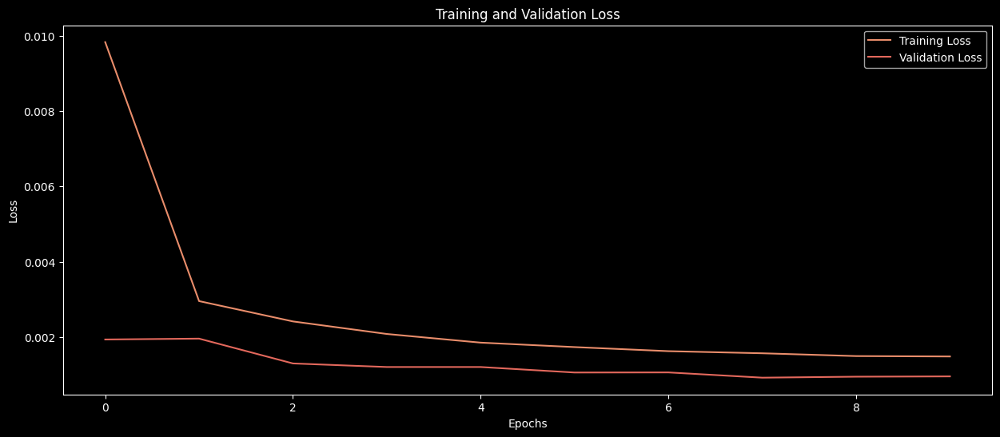

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


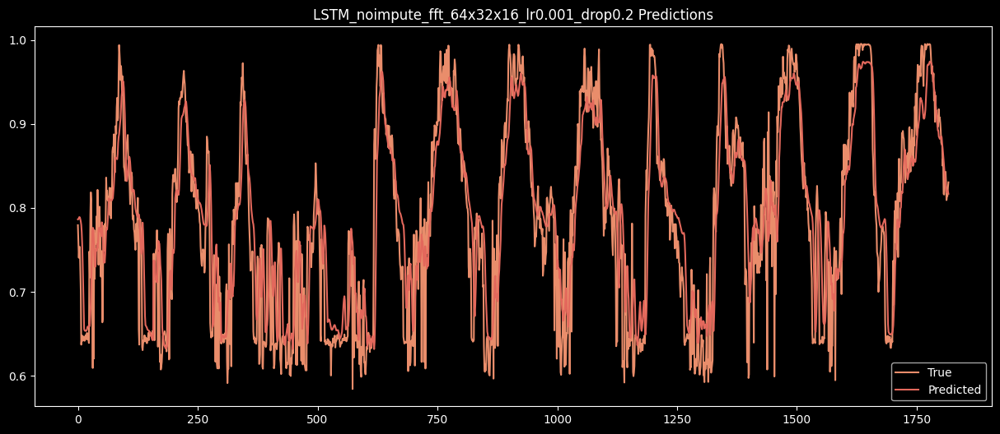

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
74   LSTM_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.064323  0.049705  0.702786
75  LSTM_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.062922  0.048644  0.715592
76       LSTM_noimpute_fft_64x32_lr0.001_drop0.2  0.055603  0.042191  0.777910
77    LSTM_noimpute_fft_64x64x32_lr0.001_drop0.2  0.059991  0.044579  0.741470
78    LSTM_noimpute_fft_64x32x16_lr0.001_drop0.2  0.058079  0.043827  0.757689

[79 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_93"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_147 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_155 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_148 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_156 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_149 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_13 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_180 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_181 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - loss: 0.0260 - root_mean_squared_error: 0.1396 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0467
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0029 - root_mean_squared_error: 0.0539 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0433
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0020 - root_mean_squared_error: 0.0446 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0017 - root_mean_squared_error: 0.0416 - val_loss: 9.7767e-04 - val_root_mean_squared_error: 0.0313
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0017 - root_mean_squared_error: 0.0413 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s

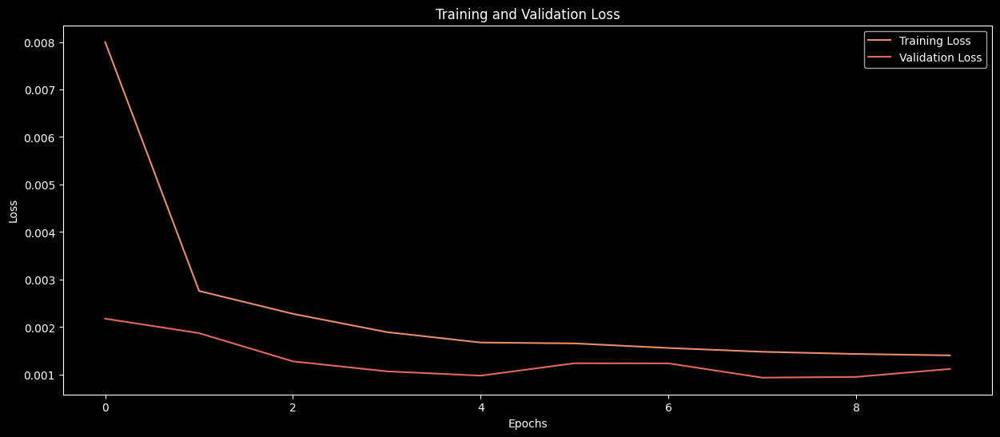

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


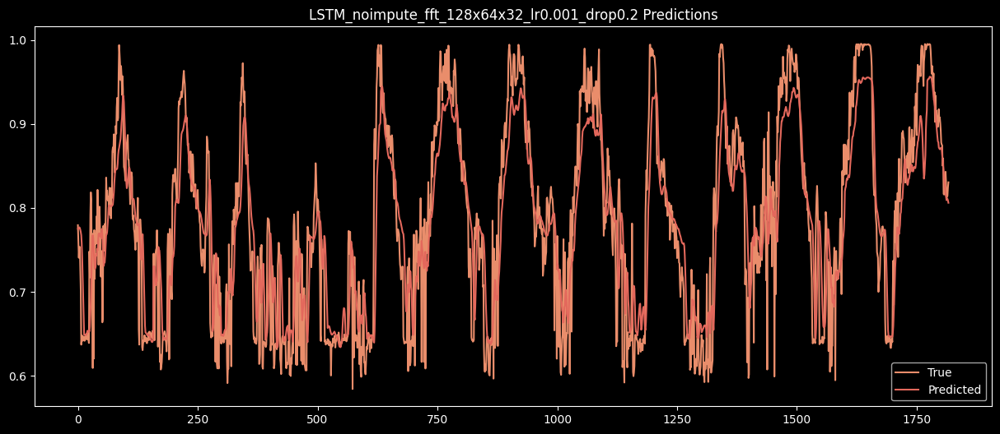

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
75  LSTM_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.062922  0.048644  0.715592
76       LSTM_noimpute_fft_64x32_lr0.001_drop0.2  0.055603  0.042191  0.777910
77    LSTM_noimpute_fft_64x64x32_lr0.001_drop0.2  0.059991  0.044579  0.741470
78    LSTM_noimpute_fft_64x32x16_lr0.001_drop0.2  0.058079  0.043827  0.757689
79   LSTM_noimpute_fft_128x64x32_lr0.001_drop0.2  0.058330  0.045095  0.755586

[80 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_94"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_150 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_157 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_151 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_14 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_182 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_183 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.2333 - root_mean_squared_error: 0.3970 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0398
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0426
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0361
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0321
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0018 - root_mean_squared_error: 0.0424 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0376
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0017 - root_mean_squared_error: 0.0409 - val_loss: 9.9123e-04 - val_root_mean_squared_error: 0.0315
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/s

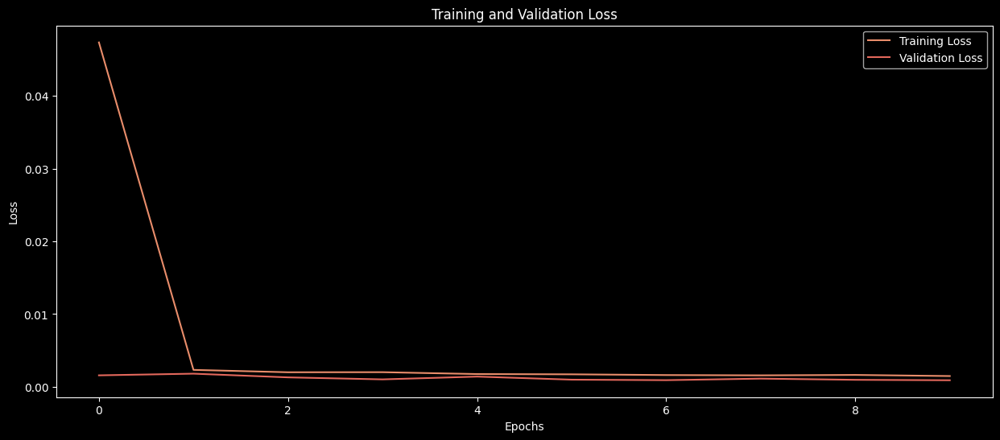

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


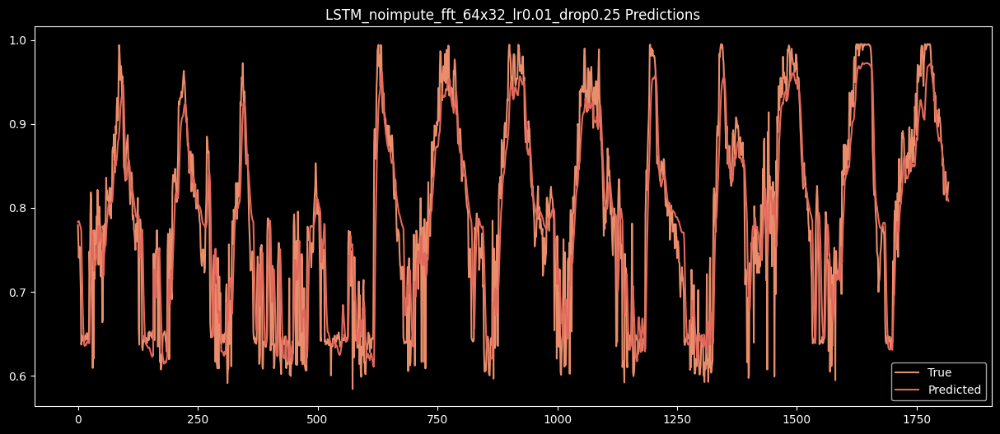

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
76      LSTM_noimpute_fft_64x32_lr0.001_drop0.2  0.055603  0.042191  0.777910
77   LSTM_noimpute_fft_64x64x32_lr0.001_drop0.2  0.059991  0.044579  0.741470
78   LSTM_noimpute_fft_64x32x16_lr0.001_drop0.2  0.058079  0.043827  0.757689
79  LSTM_noimpute_fft_128x64x32_lr0.001_drop0.2  0.058330  0.045095  0.755586
80      LSTM_noimpute_fft_64x32_lr0.01_drop0.25  0.050824  0.038136  0.814447

[81 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_95"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_152 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_158 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_153 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_159 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_154 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_15 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_184 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_185 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0469 - root_mean_squared_error: 0.1836 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0401
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0433 - val_loss: 0.0027 - val_root_mean_squared_error: 0.0515
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0421 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0366
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0016 - root_mean_squared_error: 0.0404 - val_loss: 9.9318e-04 - val_root_mean_squared_error: 0.0315
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0015 - root_mean_squared_error: 0.0383 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0329
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/

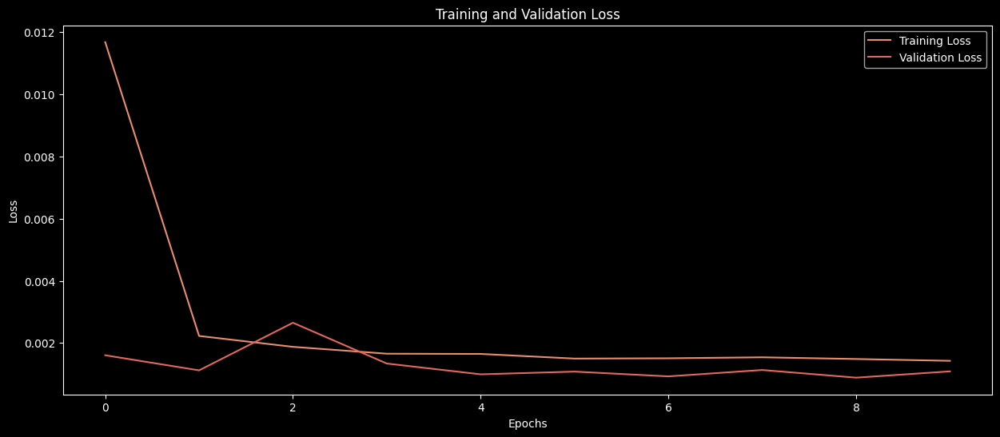

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


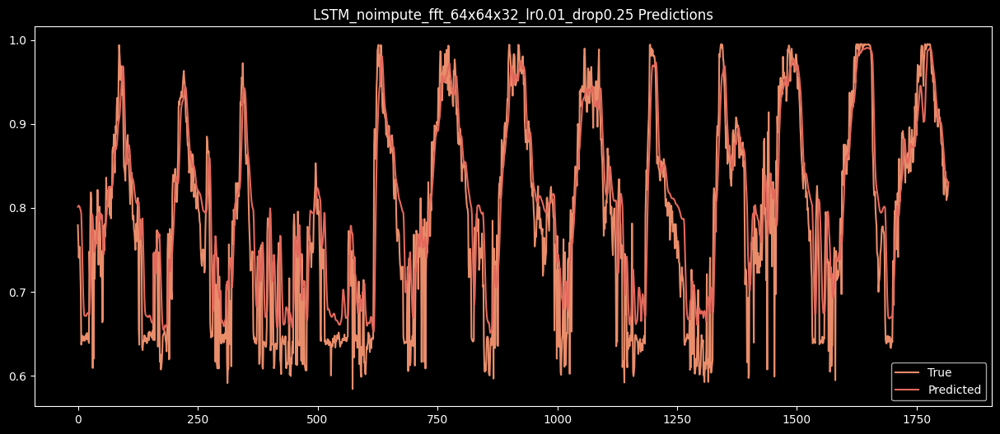

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
77   LSTM_noimpute_fft_64x64x32_lr0.001_drop0.2  0.059991  0.044579  0.741470
78   LSTM_noimpute_fft_64x32x16_lr0.001_drop0.2  0.058079  0.043827  0.757689
79  LSTM_noimpute_fft_128x64x32_lr0.001_drop0.2  0.058330  0.045095  0.755586
80      LSTM_noimpute_fft_64x32_lr0.01_drop0.25  0.050824  0.038136  0.814447
81   LSTM_noimpute_fft_64x64x32_lr0.01_drop0.25  0.056298  0.042757  0.772320

[82 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_96"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_155 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_160 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_156 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_161 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_157 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_16 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_186 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_187 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0337 - root_mean_squared_error: 0.1514 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0385
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0463 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0430 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0329
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0395 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0395 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0411
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0015 - root_mean_squared_error: 0.0388 - val_loss: 9.0047e-04 - val_root_mean_squared_error: 0.0300
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/s

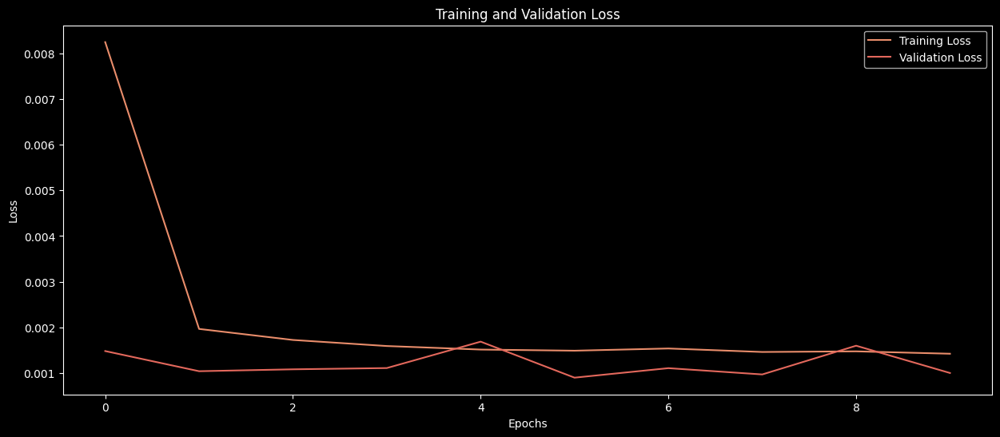

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


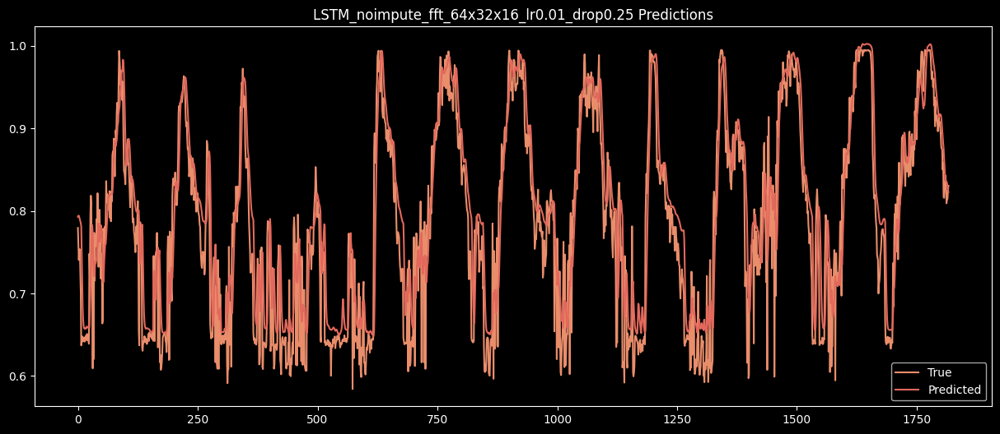

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
78   LSTM_noimpute_fft_64x32x16_lr0.001_drop0.2  0.058079  0.043827  0.757689
79  LSTM_noimpute_fft_128x64x32_lr0.001_drop0.2  0.058330  0.045095  0.755586
80      LSTM_noimpute_fft_64x32_lr0.01_drop0.25  0.050824  0.038136  0.814447
81   LSTM_noimpute_fft_64x64x32_lr0.01_drop0.25  0.056298  0.042757  0.772320
82   LSTM_noimpute_fft_64x32x16_lr0.01_drop0.25  0.051276  0.038868  0.811129

[83 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_97"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_158 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_162 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_159 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_163 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_160 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_17 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_188 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_189 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.2235 - root_mean_squared_error: 0.3841 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0465
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0029 - root_mean_squared_error: 0.0539 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0463 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0417
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0426 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0365
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0465
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10m

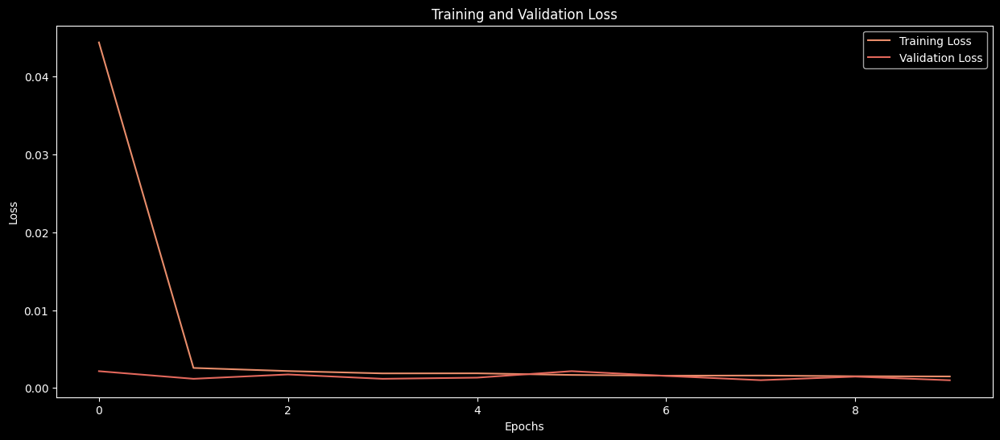

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


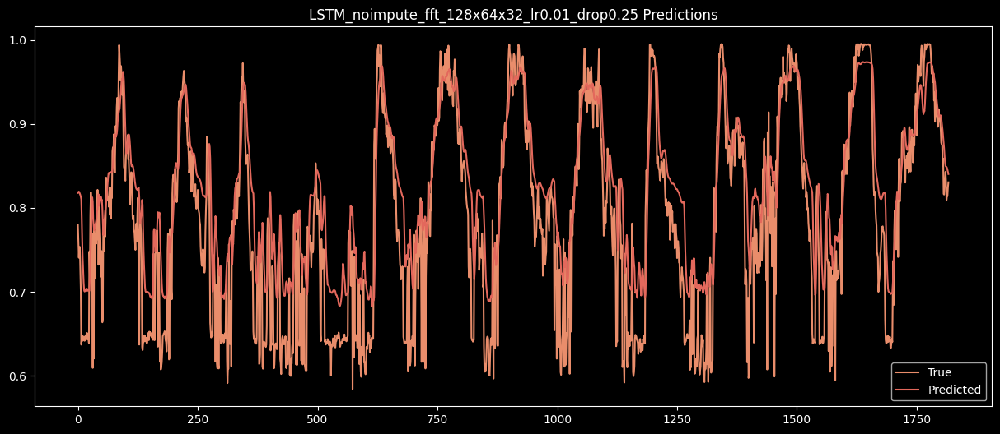

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
79  LSTM_noimpute_fft_128x64x32_lr0.001_drop0.2  0.058330  0.045095  0.755586
80      LSTM_noimpute_fft_64x32_lr0.01_drop0.25  0.050824  0.038136  0.814447
81   LSTM_noimpute_fft_64x64x32_lr0.01_drop0.25  0.056298  0.042757  0.772320
82   LSTM_noimpute_fft_64x32x16_lr0.01_drop0.25  0.051276  0.038868  0.811129
83  LSTM_noimpute_fft_128x64x32_lr0.01_drop0.25  0.066509  0.051977  0.682246

[84 rows x 4 columns]


In [122]:
model_sizes = [[64,32],[64,64,32],[64,32,16],[128,64,32]]
gen_train_LSTM(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.0001, 0.1,'noimpute_fft',fft=True)
gen_train_LSTM(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.001, 0.2,'noimpute_fft',fft=True)
gen_train_LSTM(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.01, 0.25,'noimpute_fft',fft=True)

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_98"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_161 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_164 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_162 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_18 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_190 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_191 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 0.0244 - root_mean_squared_error: 0.1380 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0442
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 6ms/step - loss: 0.0036 - root_mean_squared_error: 0.0599 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0030 - root_mean_squared_error: 0.0549 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0375
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 5ms/step - loss: 0.0026 - root_mean_squared_error: 0.0513 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 5ms/step - loss: 0.0024 - root_mean_squared_error: 0.0491 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0354
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

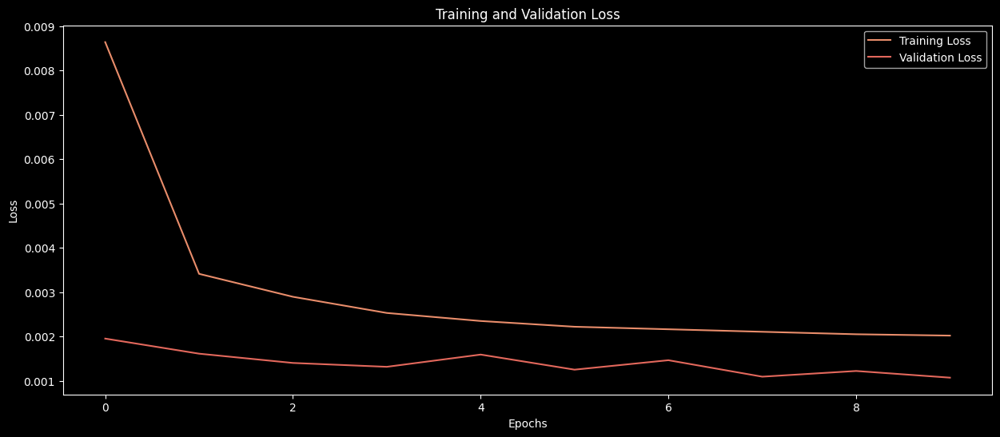

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


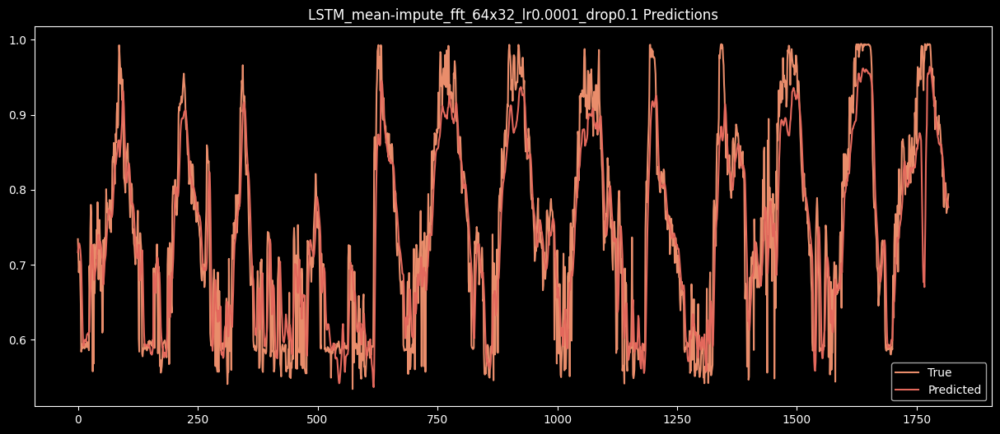

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
80      LSTM_noimpute_fft_64x32_lr0.01_drop0.25  0.050824  0.038136  0.814447
81   LSTM_noimpute_fft_64x64x32_lr0.01_drop0.25  0.056298  0.042757  0.772320
82   LSTM_noimpute_fft_64x32x16_lr0.01_drop0.25  0.051276  0.038868  0.811129
83  LSTM_noimpute_fft_128x64x32_lr0.01_drop0.25  0.066509  0.051977  0.682246
84  LSTM_mean-impute_fft_64x32_lr0.0001_drop0.1  0.057351  0.042700  0.815843

[85 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_99"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_163 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_165 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_164 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_166 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_165 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_19 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_192 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_193 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 8ms/step - loss: 0.0371 - root_mean_squared_error: 0.1639 - val_loss: 0.0025 - val_root_mean_squared_error: 0.0501
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0041 - root_mean_squared_error: 0.0642 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0493
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0034 - root_mean_squared_error: 0.0580 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0435
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0029 - root_mean_squared_error: 0.0535 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0386
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0026 - root_mean_squared_error: 0.0507 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0375
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0487 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

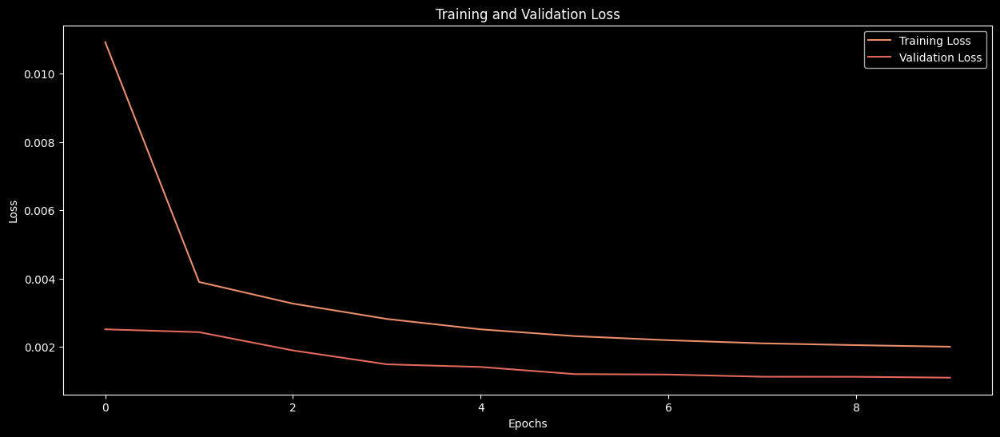

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


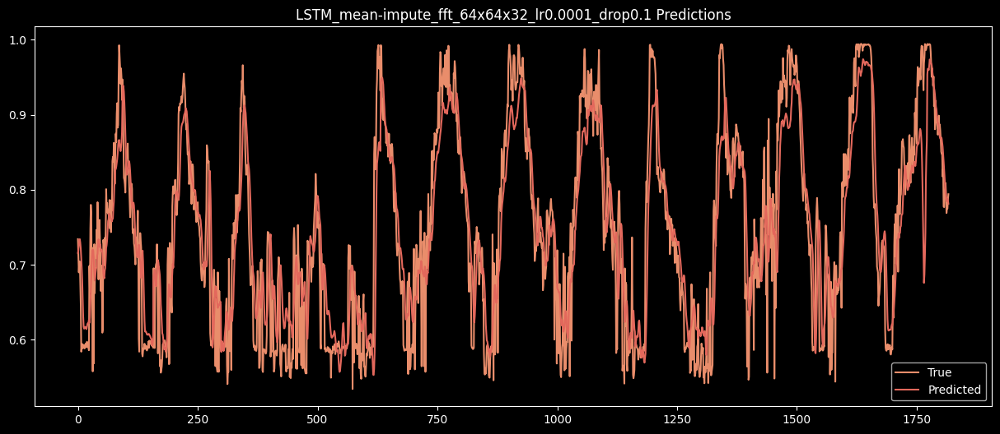

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
81      LSTM_noimpute_fft_64x64x32_lr0.01_drop0.25  0.056298  0.042757   
82      LSTM_noimpute_fft_64x32x16_lr0.01_drop0.25  0.051276  0.038868   
83     LSTM_noimpute_fft_128x64x32_lr0.01_drop0.25  0.066509  0.051977   
84     LSTM_mean-impute_fft_64x32_lr0.0001_drop0.1  0.057351  0.042700   
85  LSTM_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.063097  0.048237   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
81  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_100"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_166 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_167 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_167 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_168 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_168 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_20 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_194 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_195 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 8ms/step - loss: 0.0467 - root_mean_squared_error: 0.1882 - val_loss: 0.0029 - val_root_mean_squared_error: 0.0537
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0044 - root_mean_squared_error: 0.0661 - val_loss: 0.0025 - val_root_mean_squared_error: 0.0496
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0036 - root_mean_squared_error: 0.0601 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0465
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0030 - root_mean_squared_error: 0.0552 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0392
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0026 - root_mean_squared_error: 0.0511 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0362
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0488 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0430
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

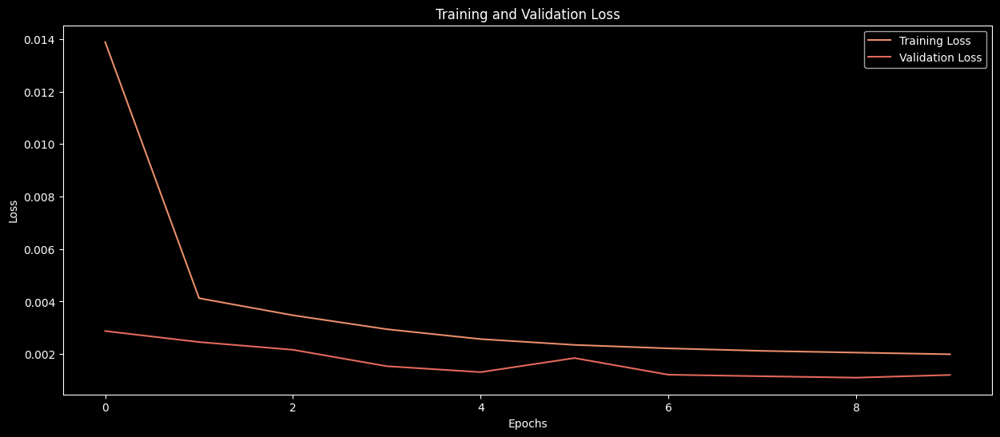

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


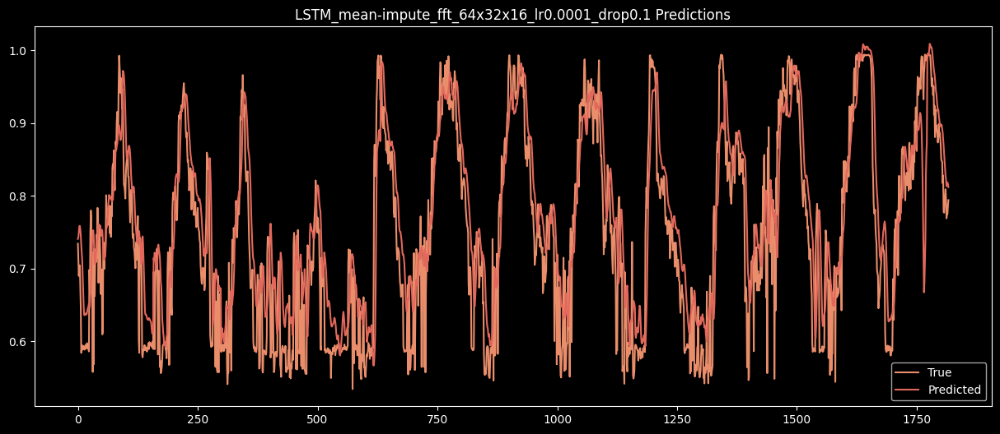

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
82      LSTM_noimpute_fft_64x32x16_lr0.01_drop0.25  0.051276  0.038868   
83     LSTM_noimpute_fft_128x64x32_lr0.01_drop0.25  0.066509  0.051977   
84     LSTM_mean-impute_fft_64x32_lr0.0001_drop0.1  0.057351  0.042700   
85  LSTM_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.063097  0.048237   
86  LSTM_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.068844  0.053721   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
82  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_101"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_169 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_169 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_170 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_170 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_171 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_21 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_196 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_197 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.0215 - root_mean_squared_error: 0.1281 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0487
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0039 - root_mean_squared_error: 0.0628 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0446
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0032 - root_mean_squared_error: 0.0569 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0391
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0027 - root_mean_squared_error: 0.0518 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0357
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0488 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0465 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 7/20
3204/3204 ━━━━━━━

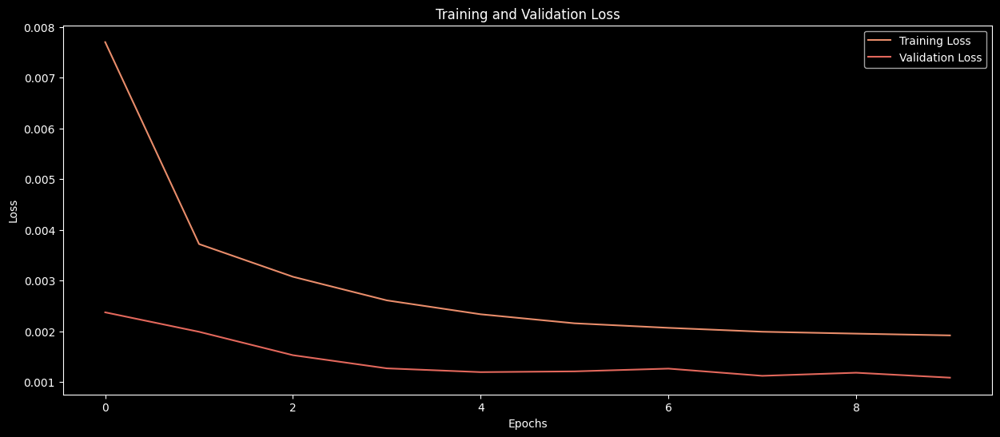

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


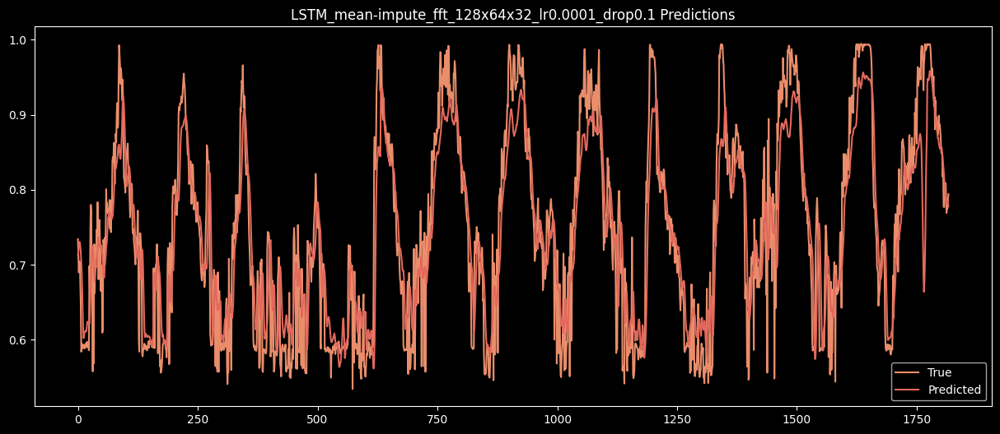

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
83      LSTM_noimpute_fft_128x64x32_lr0.01_drop0.25  0.066509  0.051977   
84      LSTM_mean-impute_fft_64x32_lr0.0001_drop0.1  0.057351  0.042700   
85   LSTM_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.063097  0.048237   
86   LSTM_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.068844  0.053721   
87  LSTM_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.062021  0.047243   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_102"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_172 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_171 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_173 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_22 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_198 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_199 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 0.0086 - root_mean_squared_error: 0.0851 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 18s 5ms/step - loss: 0.0025 - root_mean_squared_error: 0.0501 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0449
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0022 - root_mean_squared_error: 0.0471 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0020 - root_mean_squared_error: 0.0447 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0331
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0020 - root_mean_squared_error: 0.0450 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0405
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0417
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

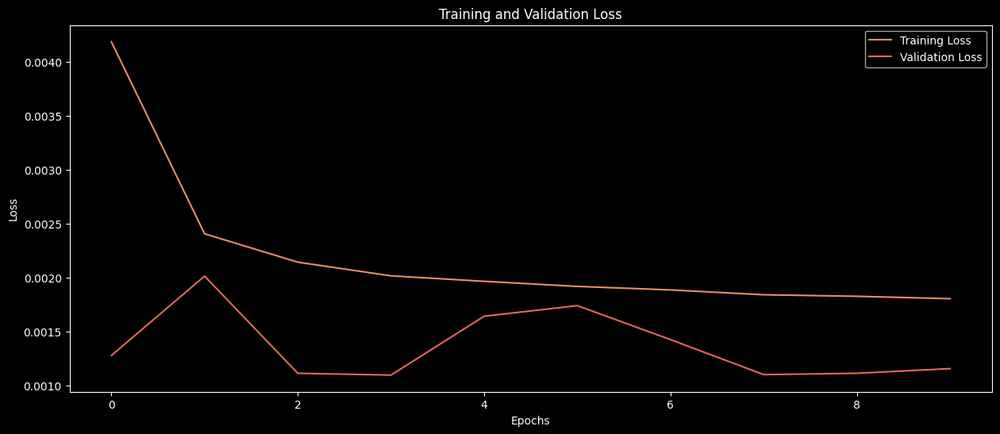

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


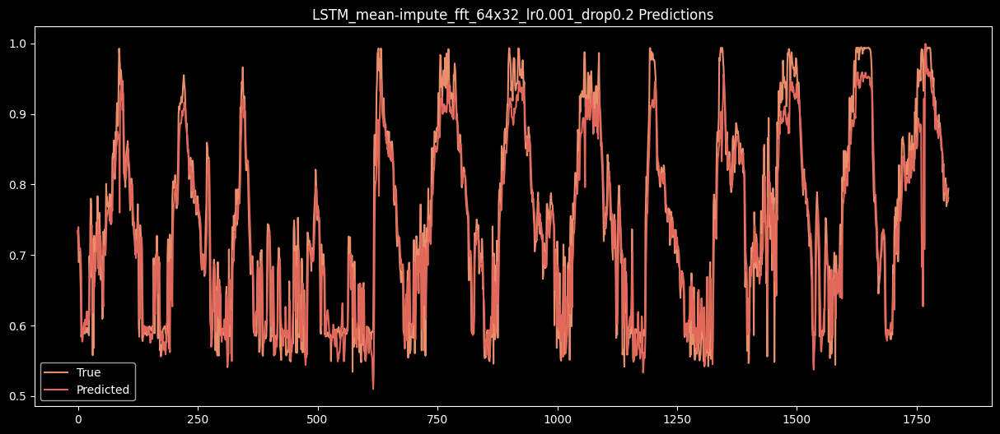

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
84      LSTM_mean-impute_fft_64x32_lr0.0001_drop0.1  0.057351  0.042700   
85   LSTM_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.063097  0.048237   
86   LSTM_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.068844  0.053721   
87  LSTM_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.062021  0.047243   
88       LSTM_mean-impute_fft_64x32_lr0.001_drop0.2  0.048634  0.034273   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_103"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_174 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_172 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_175 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_173 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_176 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_23 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_200 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_201 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 8ms/step - loss: 0.0120 - root_mean_squared_error: 0.0977 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0373
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0353
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0465 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0452 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0353
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 27s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

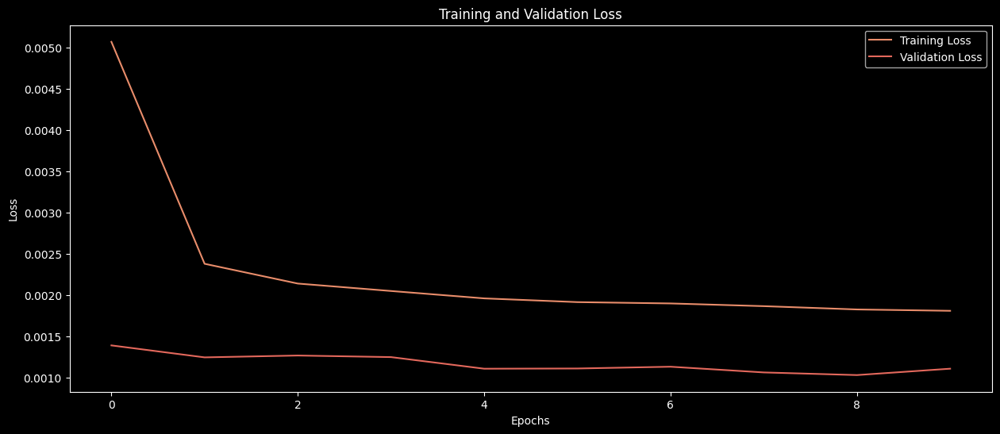

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


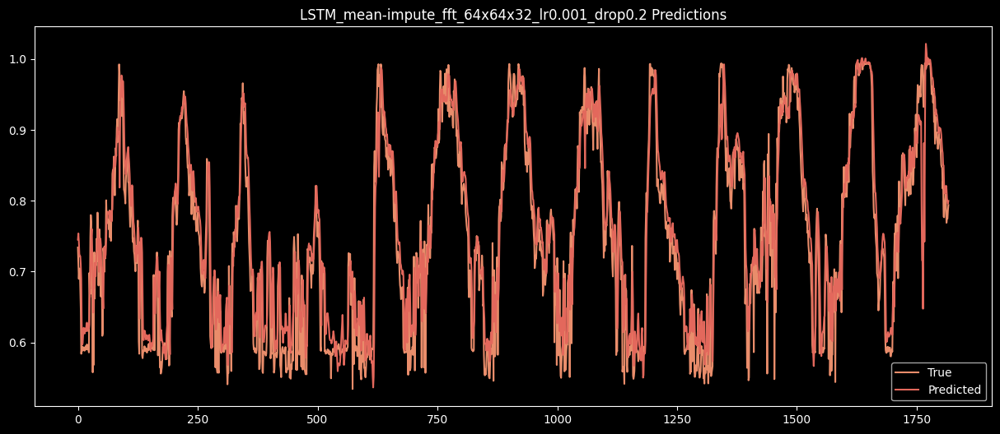

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
85   LSTM_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.063097  0.048237   
86   LSTM_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.068844  0.053721   
87  LSTM_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.062021  0.047243   
88       LSTM_mean-impute_fft_64x32_lr0.001_drop0.2  0.048634  0.034273   
89    LSTM_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.049019  0.036125   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_104"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_177 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_174 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_178 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_175 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_179 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_24 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_202 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_203 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 8ms/step - loss: 0.0093 - root_mean_squared_error: 0.0891 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0384
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0491 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0361
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0329
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0019 - root_mean_squared_error: 0.0436 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

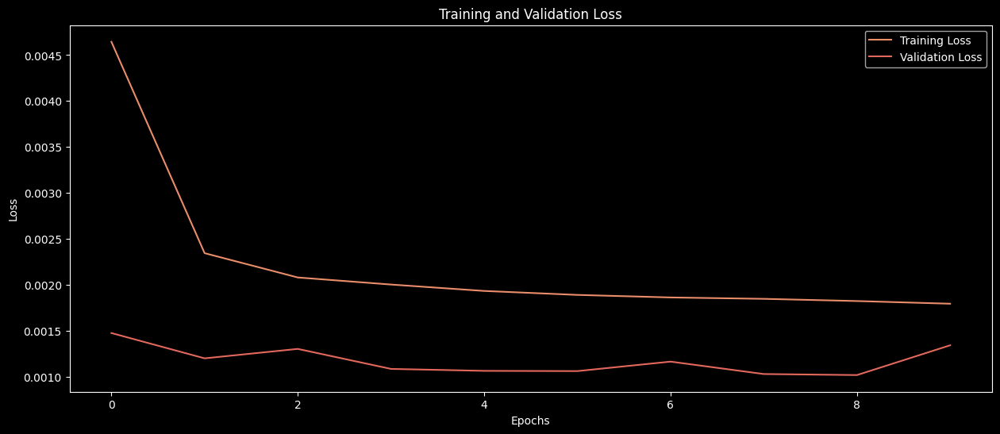

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


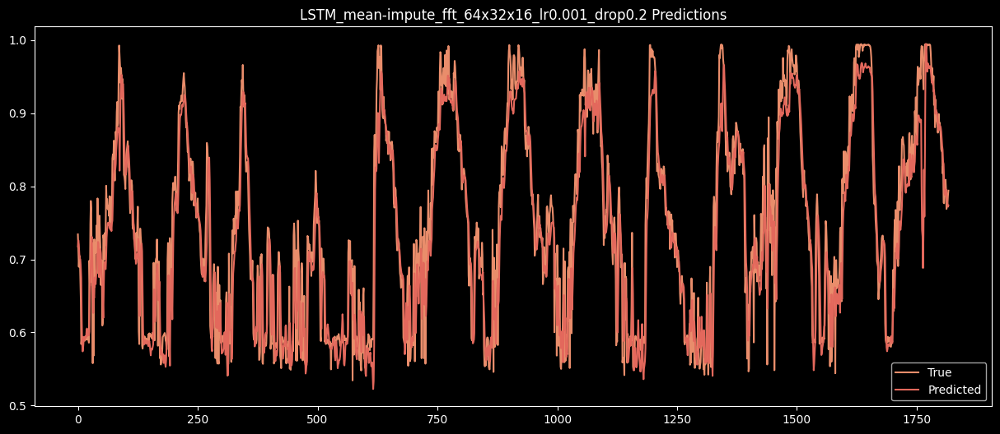

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
86   LSTM_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.068844  0.053721   
87  LSTM_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.062021  0.047243   
88       LSTM_mean-impute_fft_64x32_lr0.001_drop0.2  0.048634  0.034273   
89    LSTM_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.049019  0.036125   
90    LSTM_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.049557  0.035863   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_105"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_180 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_176 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_181 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_177 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_182 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_25 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_204 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_205 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.0117 - root_mean_squared_error: 0.0962 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0431
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0494 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0508
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0416
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0434 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0391
Epoch 7/20
3204/3204 ━━━━━━━

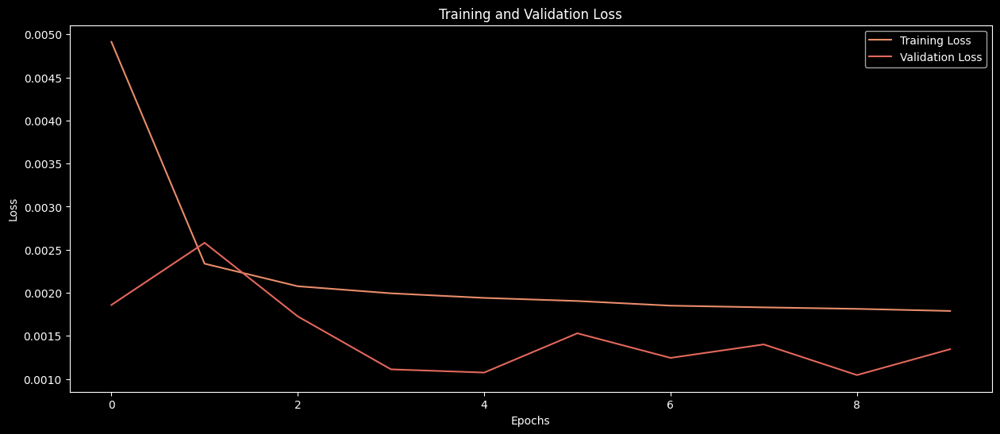

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


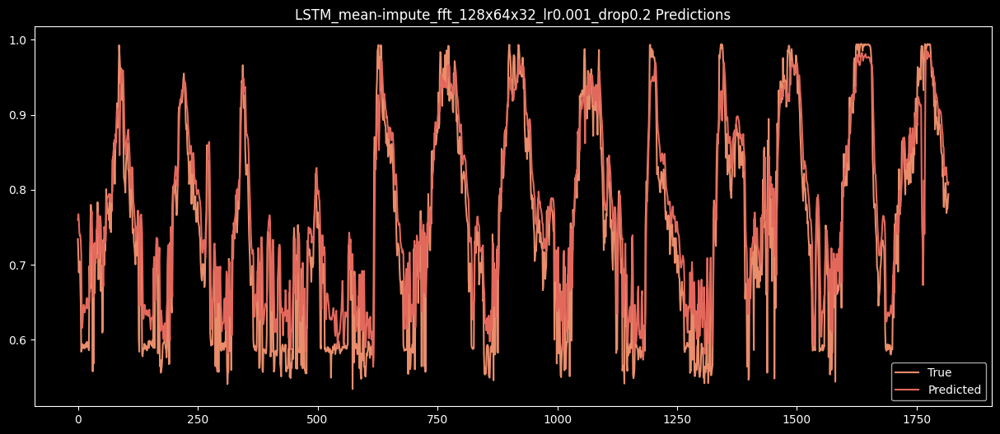

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
87  LSTM_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.062021  0.047243   
88       LSTM_mean-impute_fft_64x32_lr0.001_drop0.2  0.048634  0.034273   
89    LSTM_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.049019  0.036125   
90    LSTM_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.049557  0.035863   
91   LSTM_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.055523  0.043034   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_106"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_183 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_178 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_184 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_26 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_206 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_207 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 5ms/step - loss: 0.0353 - root_mean_squared_error: 0.1461 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0024 - root_mean_squared_error: 0.0490 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0367
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0457 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0422
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0320
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

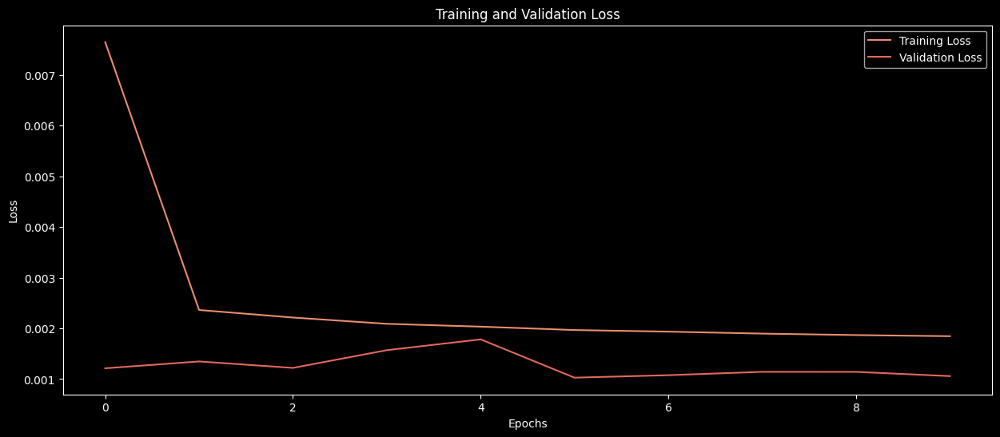

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


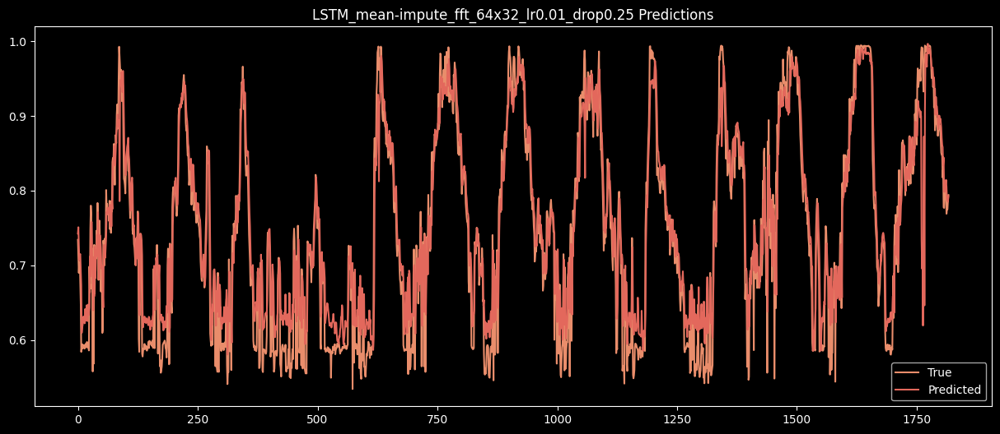

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
88      LSTM_mean-impute_fft_64x32_lr0.001_drop0.2  0.048634  0.034273   
89   LSTM_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.049019  0.036125   
90   LSTM_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.049557  0.035863   
91  LSTM_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.055523  0.043034   
92      LSTM_mean-impute_fft_64x32_lr0.01_drop0.25  0.048015  0.035332   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
88  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_107"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_185 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_179 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_186 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_180 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_187 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_27 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_208 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_209 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 8ms/step - loss: 0.0148 - root_mean_squared_error: 0.1026 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0368
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0024 - root_mean_squared_error: 0.0489 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0351
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0022 - root_mean_squared_error: 0.0474 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0021 - root_mean_squared_error: 0.0459 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0020 - root_mean_squared_error: 0.0453 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 26s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0440 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0381
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

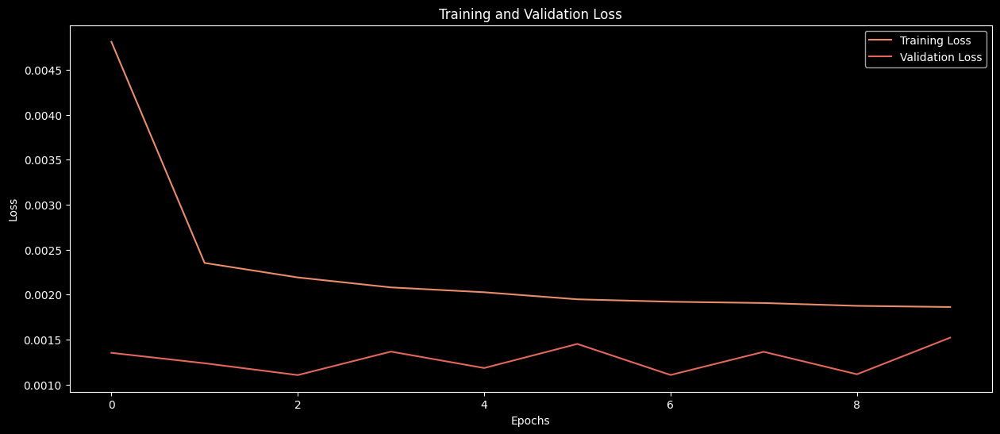

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


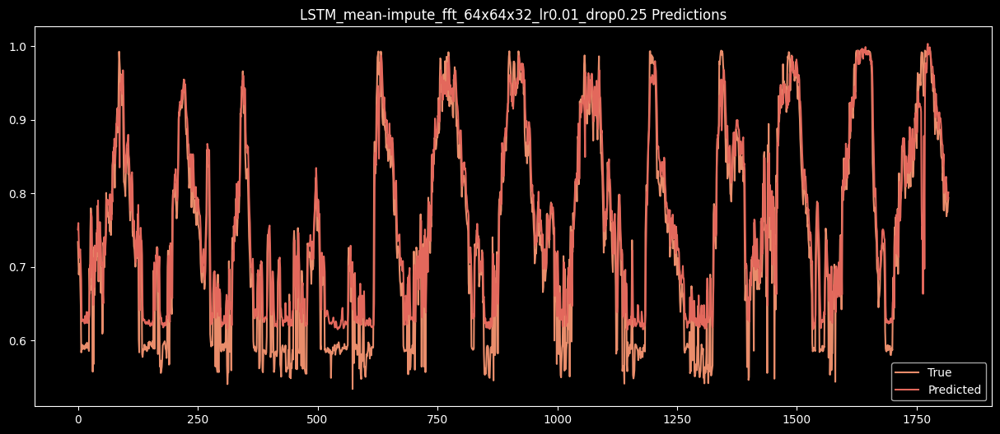

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
89   LSTM_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.049019  0.036125   
90   LSTM_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.049557  0.035863   
91  LSTM_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.055523  0.043034   
92      LSTM_mean-impute_fft_64x32_lr0.01_drop0.25  0.048015  0.035332   
93   LSTM_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.048536  0.037175   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
89  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_108"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_188 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_181 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_189 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_182 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_190 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_28 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_210 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_211 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 8ms/step - loss: 0.0096 - root_mean_squared_error: 0.0877 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0383
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0023 - root_mean_squared_error: 0.0483 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0423
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 24s 7ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0376
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 23s 7ms/step - loss: 0.0021 - root_mean_squared_error: 0.0455 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0357
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 23s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0450 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 23s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

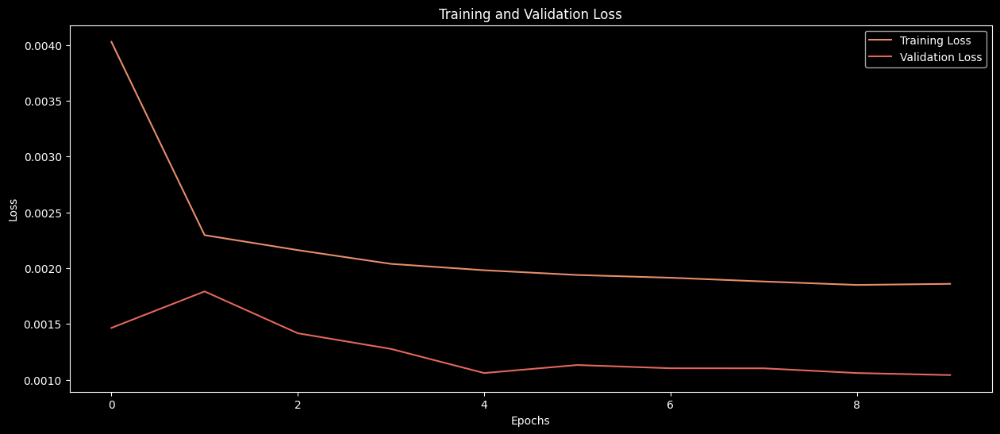

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


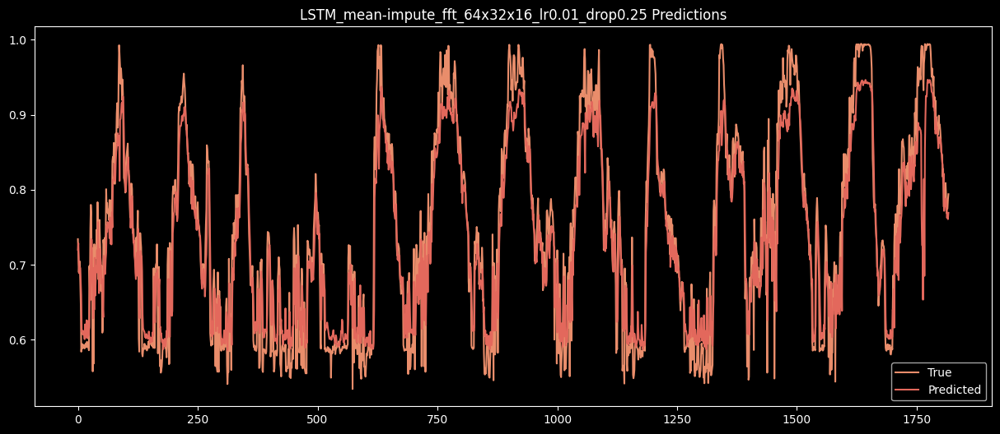

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
90   LSTM_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.049557  0.035863   
91  LSTM_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.055523  0.043034   
92      LSTM_mean-impute_fft_64x32_lr0.01_drop0.25  0.048015  0.035332   
93   LSTM_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.048536  0.037175   
94   LSTM_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.048379  0.035958   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
90  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_109"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_191 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_183 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_192 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_184 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_193 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_29 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_212 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_213 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.0342 - root_mean_squared_error: 0.1451 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0469
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 40s 13ms/step - loss: 0.0025 - root_mean_squared_error: 0.0497 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0023 - root_mean_squared_error: 0.0480 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0468
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0020 - root_mean_squared_error: 0.0449 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0324
Epoch 7/20
3204/3204 ━━━━━━━

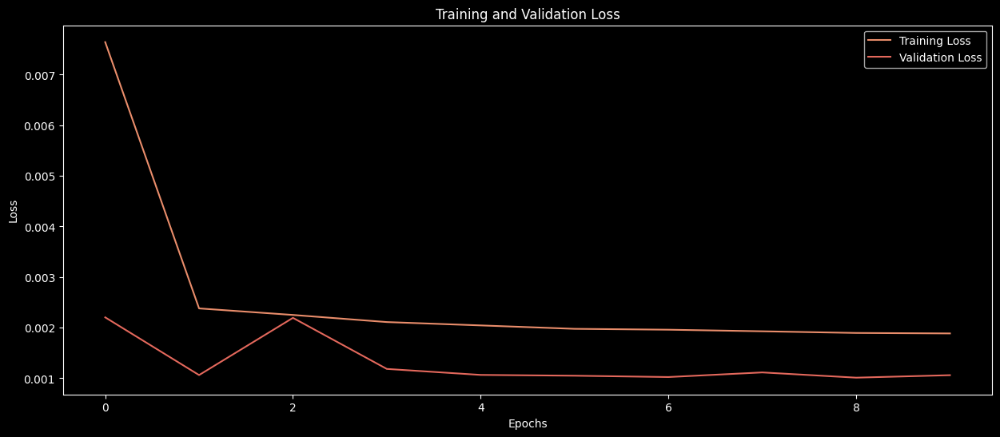

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


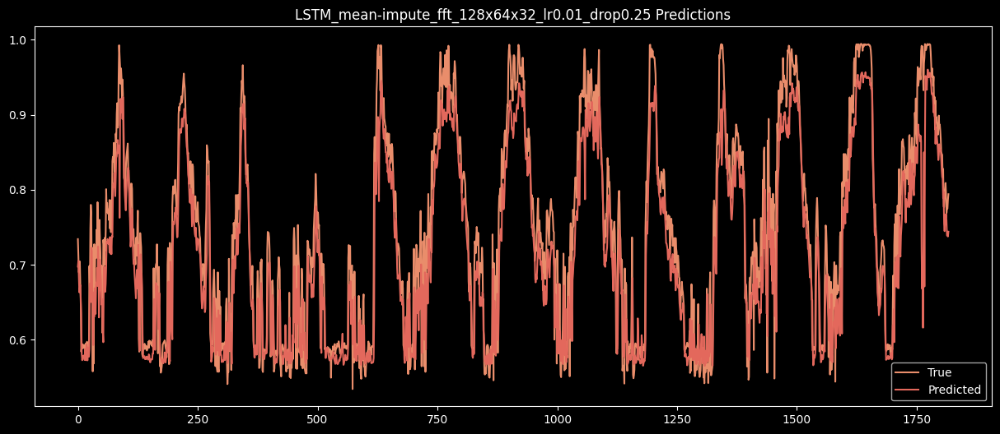

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
91  LSTM_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.055523  0.043034   
92      LSTM_mean-impute_fft_64x32_lr0.01_drop0.25  0.048015  0.035332   
93   LSTM_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.048536  0.037175   
94   LSTM_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.048379  0.035958   
95  LSTM_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.054118  0.040852   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
91  0.

In [123]:
gen_train_LSTM(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.0001, 0.1,'mean-impute_fft',fft=True)
gen_train_LSTM(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.001, 0.2,'mean-impute_fft',fft=True)
gen_train_LSTM(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.01, 0.25,'mean-impute_fft',fft=True)

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_110"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_194 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_185 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_195 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_30 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_214 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_215 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0112 - root_mean_squared_error: 0.1016 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0394
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0038 - root_mean_squared_error: 0.0613 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0385
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0029 - root_mean_squared_error: 0.0537 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0371
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0025 - root_mean_squared_error: 0.0499 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0024 - root_mean_squared_error: 0.0489 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0360
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step 

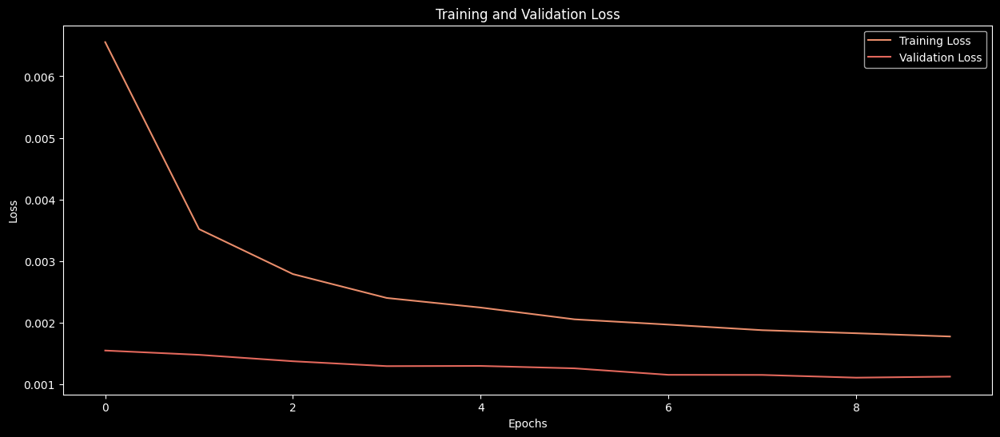

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


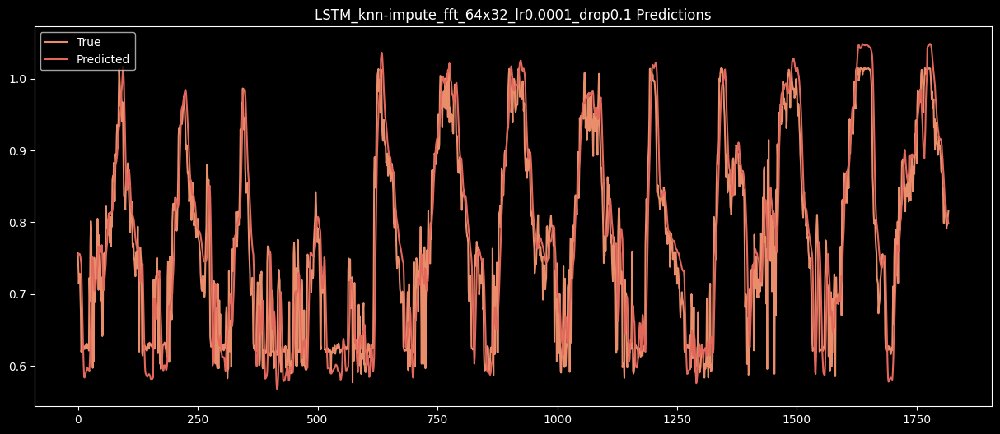

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
92      LSTM_mean-impute_fft_64x32_lr0.01_drop0.25  0.048015  0.035332   
93   LSTM_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.048536  0.037175   
94   LSTM_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.048379  0.035958   
95  LSTM_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.054118  0.040852   
96      LSTM_knn-impute_fft_64x32_lr0.0001_drop0.1  0.056517  0.043745   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
92  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_111"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_196 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_186 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_197 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_187 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_198 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_31 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_216 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_217 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - loss: 0.0517 - root_mean_squared_error: 0.2007 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0473
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0040 - root_mean_squared_error: 0.0630 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0441
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0035 - root_mean_squared_error: 0.0589 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0434
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0032 - root_mean_squared_error: 0.0562 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0030 - root_mean_squared_error: 0.0551 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0424
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0028 - root_mean_squared_error: 0.0530 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0409
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11m

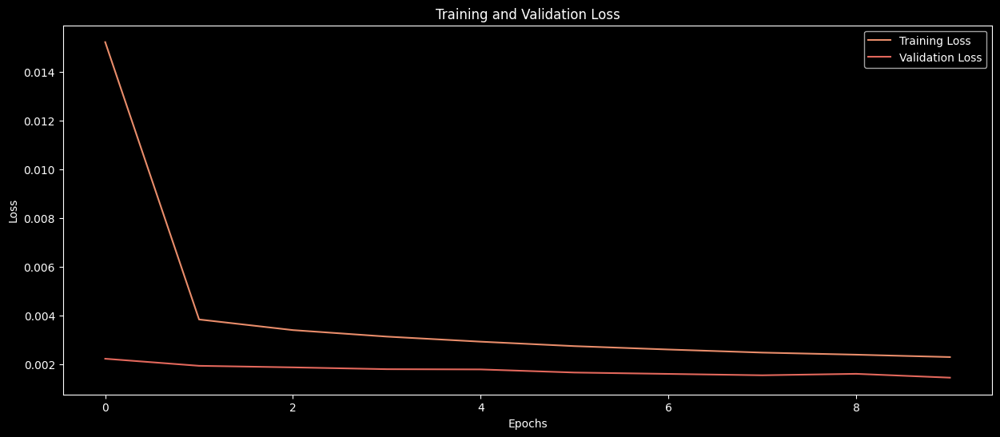

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


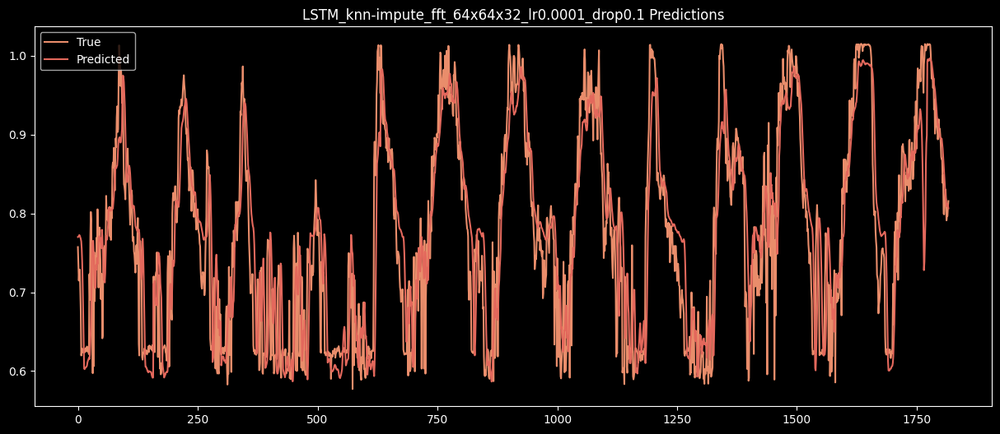

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
93   LSTM_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.048536  0.037175   
94   LSTM_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.048379  0.035958   
95  LSTM_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.054118  0.040852   
96      LSTM_knn-impute_fft_64x32_lr0.0001_drop0.1  0.056517  0.043745   
97   LSTM_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.064558  0.049133   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
93  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_112"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_199 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_188 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_200 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_189 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_201 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_32 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_218 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_219 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.1373 - root_mean_squared_error: 0.3371 - val_loss: 0.0027 - val_root_mean_squared_error: 0.0524
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0050 - root_mean_squared_error: 0.0704 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0468
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0041 - root_mean_squared_error: 0.0643 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0459
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0037 - root_mean_squared_error: 0.0607 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0453
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0032 - root_mean_squared_error: 0.0570 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0445
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0032 - root_mean_squared_error: 0.0565 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0450
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

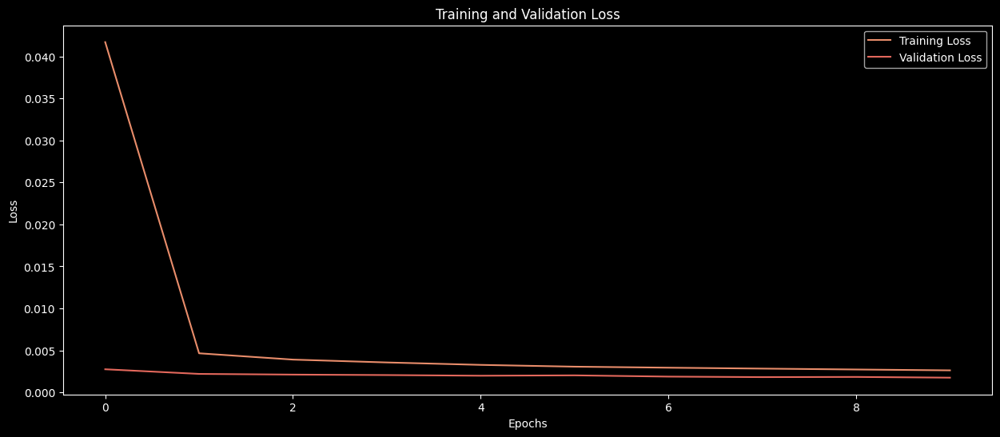

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


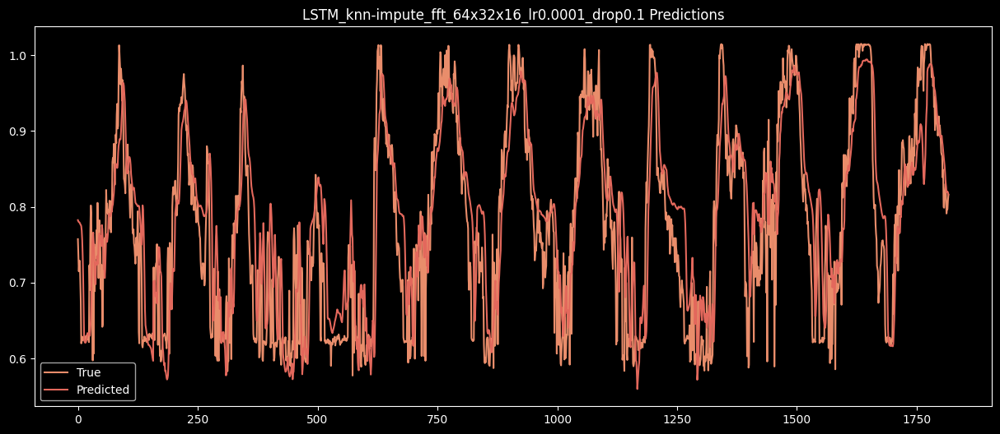

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
94   LSTM_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.048379  0.035958   
95  LSTM_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.054118  0.040852   
96      LSTM_knn-impute_fft_64x32_lr0.0001_drop0.1  0.056517  0.043745   
97   LSTM_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.064558  0.049133   
98   LSTM_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.072465  0.056335   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
94  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_113"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_202 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_190 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_203 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_191 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_204 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_33 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_220 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_221 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 13ms/step - loss: 0.0816 - root_mean_squared_error: 0.2489 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0449
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0036 - root_mean_squared_error: 0.0600 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0446
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0034 - root_mean_squared_error: 0.0583 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0435
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0031 - root_mean_squared_error: 0.0555 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0423
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0028 - root_mean_squared_error: 0.0533 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0419
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0027 - root_mean_squared_error: 0.0522 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0412
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12

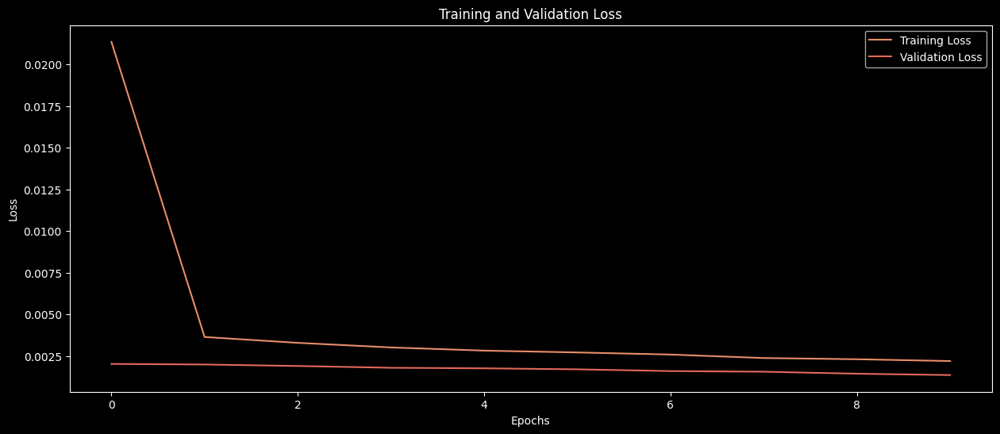

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


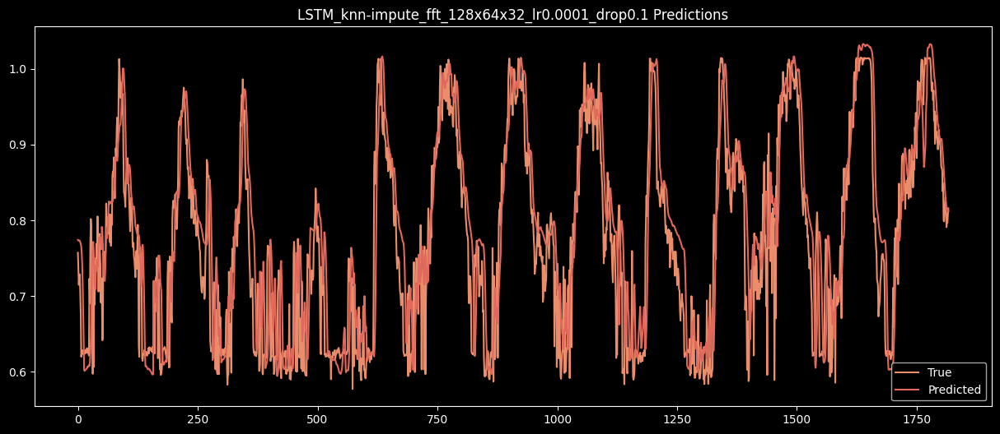

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
95  LSTM_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.054118  0.040852   
96      LSTM_knn-impute_fft_64x32_lr0.0001_drop0.1  0.056517  0.043745   
97   LSTM_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.064558  0.049133   
98   LSTM_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.072465  0.056335   
99  LSTM_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.064335  0.049133   

          R2  
0   0.860394  
1   0.689495  
2   0.672503  
3   0.706795  
4   0.887449  
..       ...  
95  0.

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_114"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_205 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_192 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_206 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_34 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_222 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_223 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0283 - root_mean_squared_error: 0.1487 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0397
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0027 - root_mean_squared_error: 0.0521 - val_loss: 0.0036 - val_root_mean_squared_error: 0.0602
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0025 - root_mean_squared_error: 0.0500 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0016 - root_mean_squared_error: 0.0401 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0322
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step 

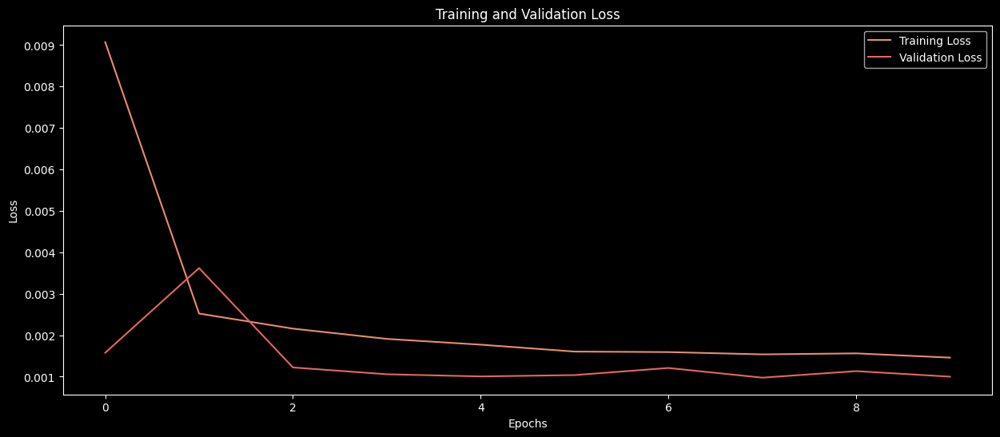

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


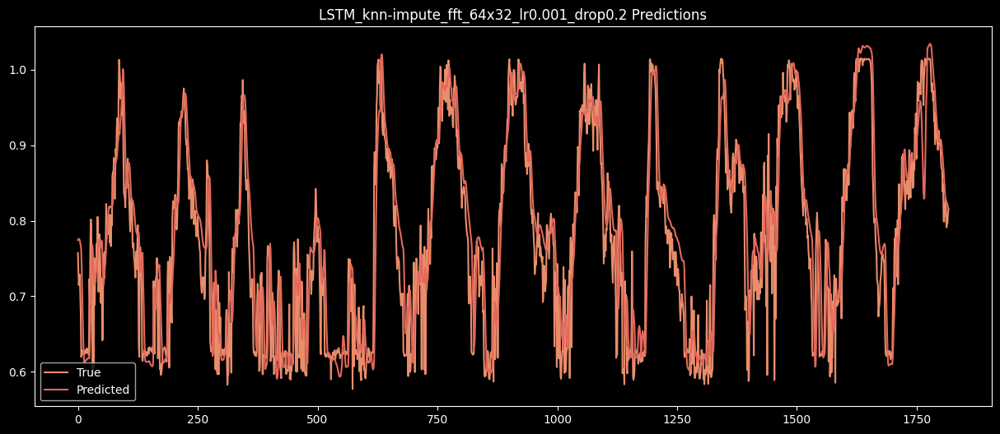

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
96       LSTM_knn-impute_fft_64x32_lr0.0001_drop0.1  0.056517  0.043745   
97    LSTM_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.064558  0.049133   
98    LSTM_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.072465  0.056335   
99   LSTM_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.064335  0.049133   
100       LSTM_knn-impute_fft_64x32_lr0.001_drop0.2  0.056012  0.042306   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_115"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_207 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_193 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_208 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_194 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_209 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_35 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_224 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_225 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0332 - root_mean_squared_error: 0.1561 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0461
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0029 - root_mean_squared_error: 0.0542 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0436
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0026 - root_mean_squared_error: 0.0506 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0379
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0458 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0434 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0318
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0383
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10m

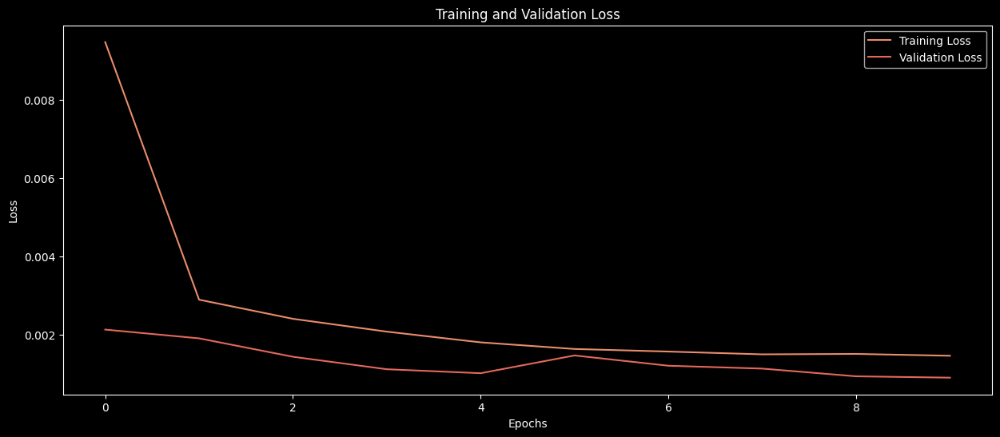

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


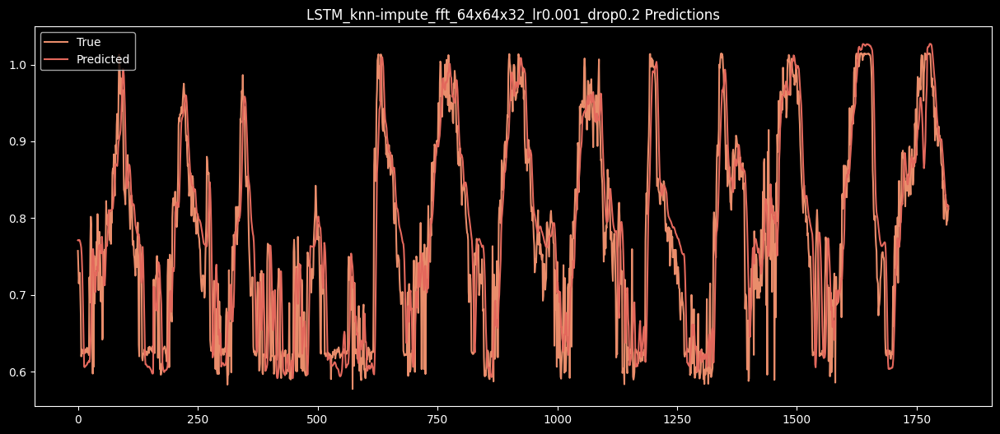

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
97    LSTM_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.064558  0.049133   
98    LSTM_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.072465  0.056335   
99   LSTM_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.064335  0.049133   
100       LSTM_knn-impute_fft_64x32_lr0.001_drop0.2  0.056012  0.042306   
101    LSTM_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.061991  0.047182   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_116"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_210 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_195 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_211 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_196 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_212 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_36 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_226 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_227 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 0.0355 - root_mean_squared_error: 0.1637 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0510
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0032 - root_mean_squared_error: 0.0563 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0469
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0026 - root_mean_squared_error: 0.0514 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0413
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0398
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 9.8151e-04 - val_root_mean_squared_error: 0.0313
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/

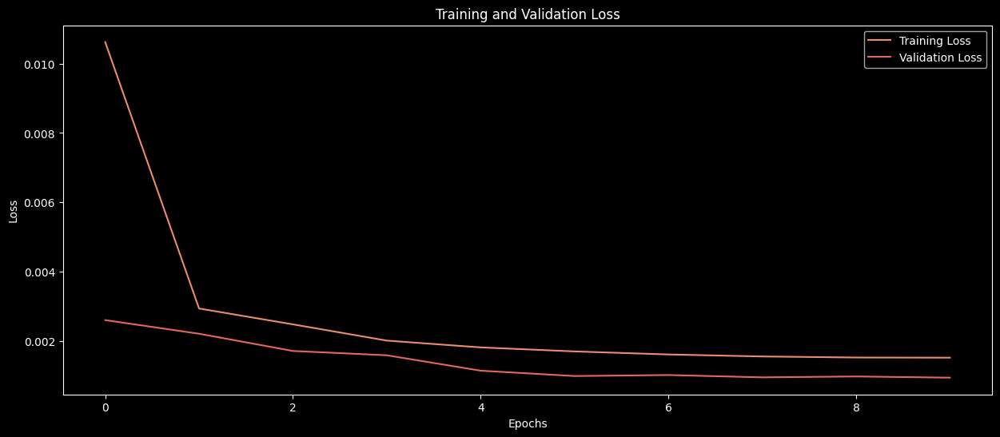

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


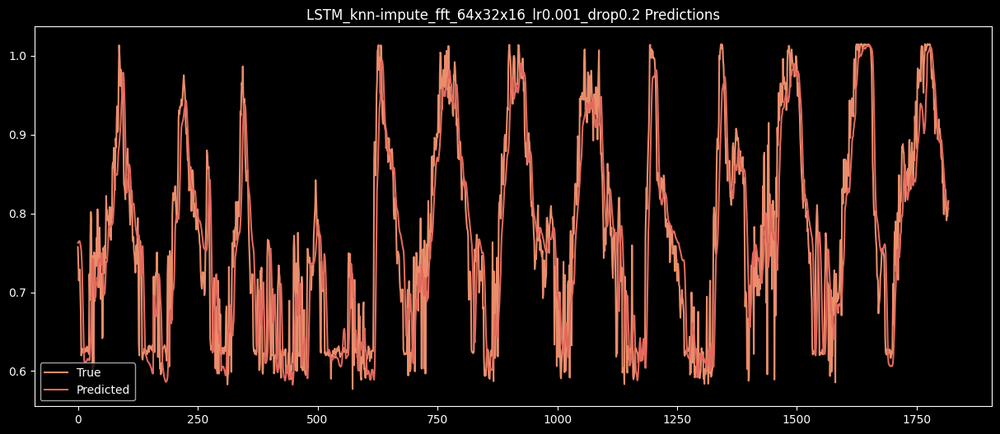

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
98    LSTM_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.072465  0.056335   
99   LSTM_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.064335  0.049133   
100       LSTM_knn-impute_fft_64x32_lr0.001_drop0.2  0.056012  0.042306   
101    LSTM_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.061991  0.047182   
102    LSTM_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.061617  0.046584   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_117"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_213 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_197 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_214 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_198 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_215 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_37 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_228 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_229 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 13ms/step - loss: 0.0171 - root_mean_squared_error: 0.1174 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0454
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0030 - root_mean_squared_error: 0.0545 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0395
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0345
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0019 - root_mean_squared_error: 0.0436 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0019 - root_mean_squared_error: 0.0431 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0017 - root_mean_squared_error: 0.0410 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0329
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12

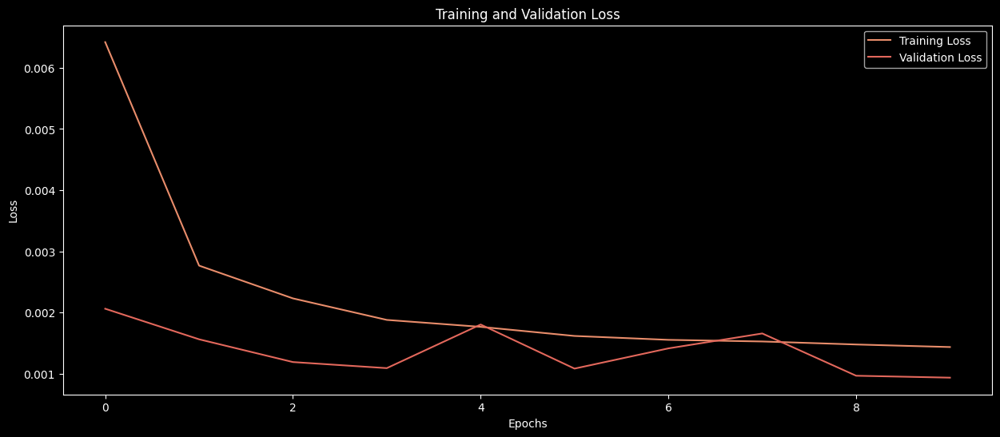

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


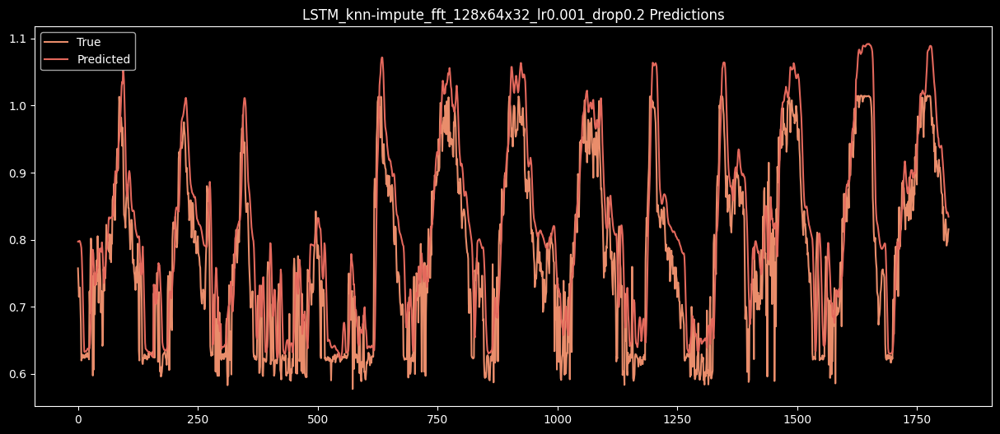

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
99   LSTM_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.064335  0.049133   
100       LSTM_knn-impute_fft_64x32_lr0.001_drop0.2  0.056012  0.042306   
101    LSTM_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.061991  0.047182   
102    LSTM_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.061617  0.046584   
103   LSTM_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.072183  0.057975   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_118"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_216 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_199 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_217 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_38 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_230 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_231 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,553 (138.88 KB)

 Trainable params: 35,553 (138.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0920 - root_mean_squared_error: 0.2500 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0427
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0023 - root_mean_squared_error: 0.0477 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0018 - root_mean_squared_error: 0.0428 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0339
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0416 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0016 - root_mean_squared_error: 0.0405 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0016 - root_mean_squared_error: 0.0400 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step 

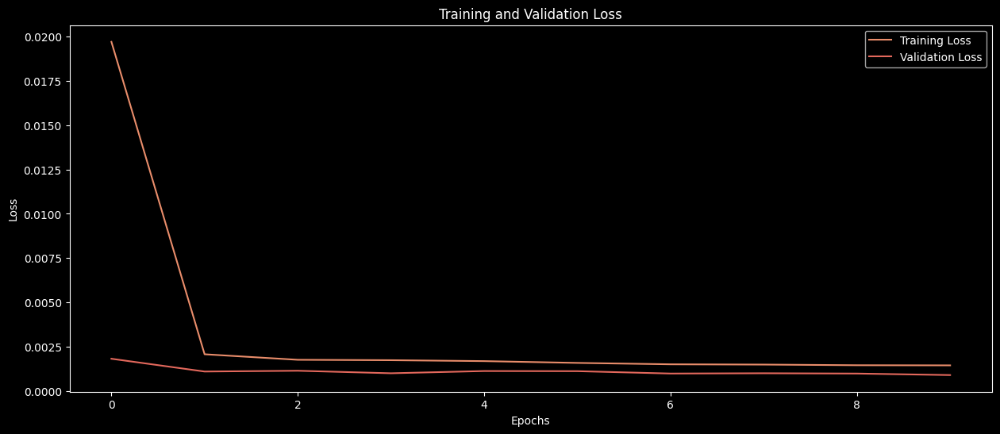

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


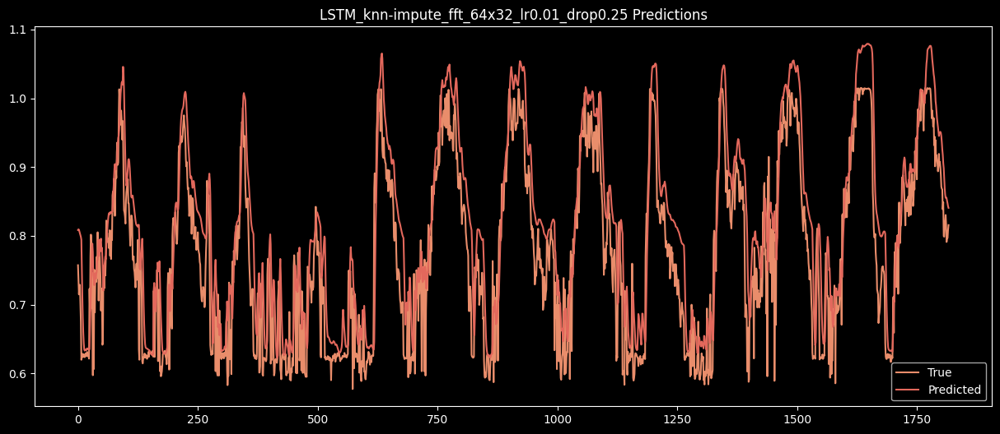

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
100      LSTM_knn-impute_fft_64x32_lr0.001_drop0.2  0.056012  0.042306   
101   LSTM_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.061991  0.047182   
102   LSTM_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.061617  0.046584   
103  LSTM_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.072183  0.057975   
104      LSTM_knn-impute_fft_64x32_lr0.01_drop0.25  0.067579  0.054827   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_119"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_218 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_200 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_219 (LSTM)                 │ (None, 6, 64)          │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_201 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_220 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_39 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_232 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_233 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,577 (267.88 KB)

 Trainable params: 68,577 (267.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0452 - root_mean_squared_error: 0.1793 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0435
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0465 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0445
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0419 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0485
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0422 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0391
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0016 - root_mean_squared_error: 0.0396 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0015 - root_mean_squared_error: 0.0392 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10m

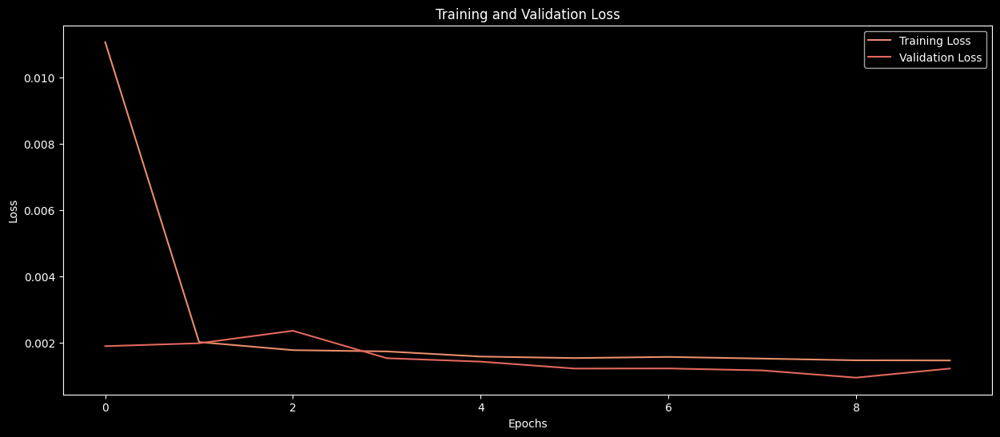

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


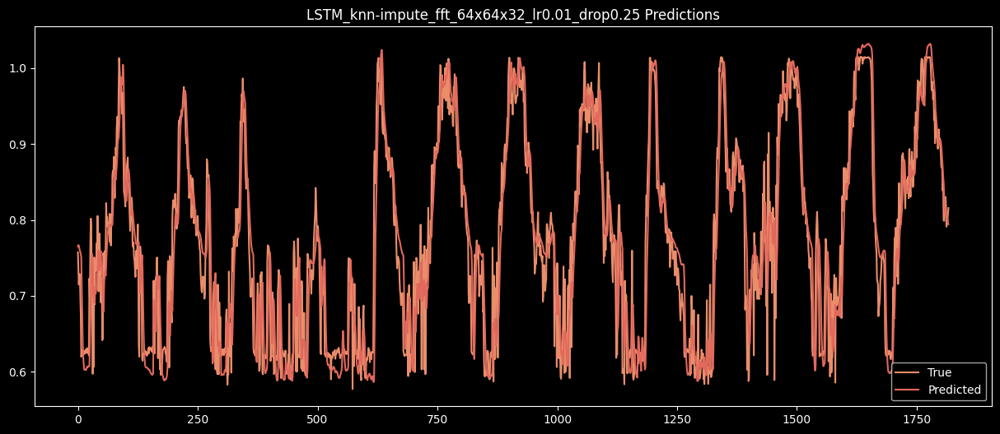

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
101   LSTM_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.061991  0.047182   
102   LSTM_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.061617  0.046584   
103  LSTM_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.072183  0.057975   
104      LSTM_knn-impute_fft_64x32_lr0.01_drop0.25  0.067579  0.054827   
105   LSTM_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.050380  0.037999   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_120"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_221 (LSTM)                 │ (None, 6, 64)          │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_202 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_222 (LSTM)                 │ (None, 6, 32)          │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_203 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_223 (LSTM)                 │ (None, 16)             │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_40 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_234 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_235 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,489 (146.44 KB)

 Trainable params: 37,489 (146.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 0.0303 - root_mean_squared_error: 0.1505 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0462
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0482 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0511
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0018 - root_mean_squared_error: 0.0426 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0446
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0016 - root_mean_squared_error: 0.0405 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0412
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0015 - root_mean_squared_error: 0.0389 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0429
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step

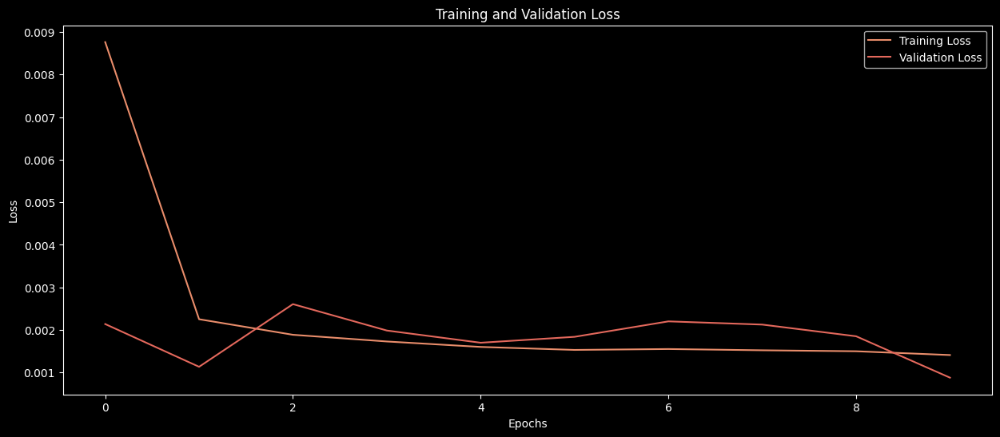

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


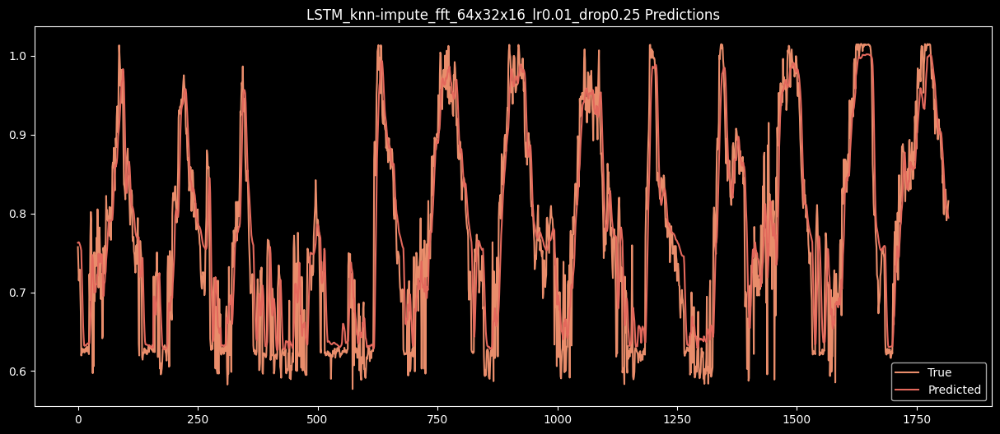

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
102   LSTM_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.061617  0.046584   
103  LSTM_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.072183  0.057975   
104      LSTM_knn-impute_fft_64x32_lr0.01_drop0.25  0.067579  0.054827   
105   LSTM_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.050380  0.037999   
106   LSTM_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.052814  0.040117   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_121"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_224 (LSTM)                 │ (None, 6, 128)         │        75,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_204 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_225 (LSTM)                 │ (None, 6, 64)          │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_205 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_226 (LSTM)                 │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_41 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_236 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_237 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 139,233 (543.88 KB)

 Trainable params: 139,233 (543.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - loss: 0.1240 - root_mean_squared_error: 0.2903 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0378
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0026 - root_mean_squared_error: 0.0507 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0020 - root_mean_squared_error: 0.0450 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0339
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0017 - root_mean_squared_error: 0.0407 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0365
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11

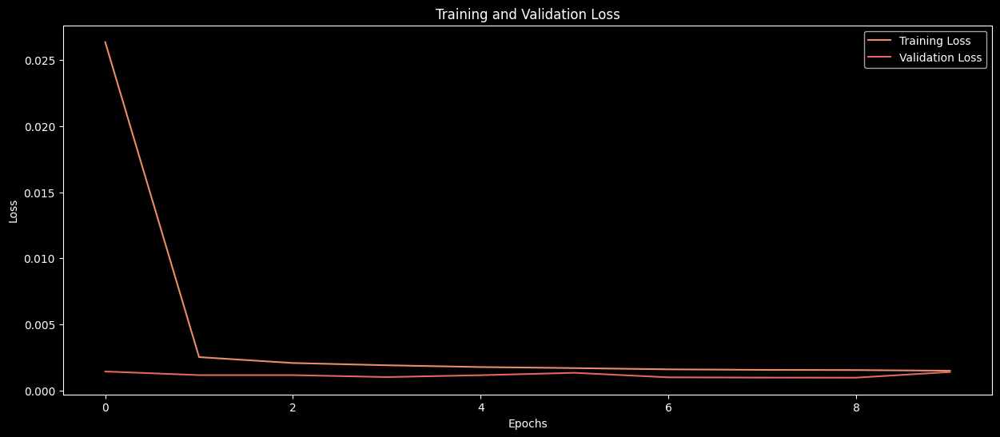

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


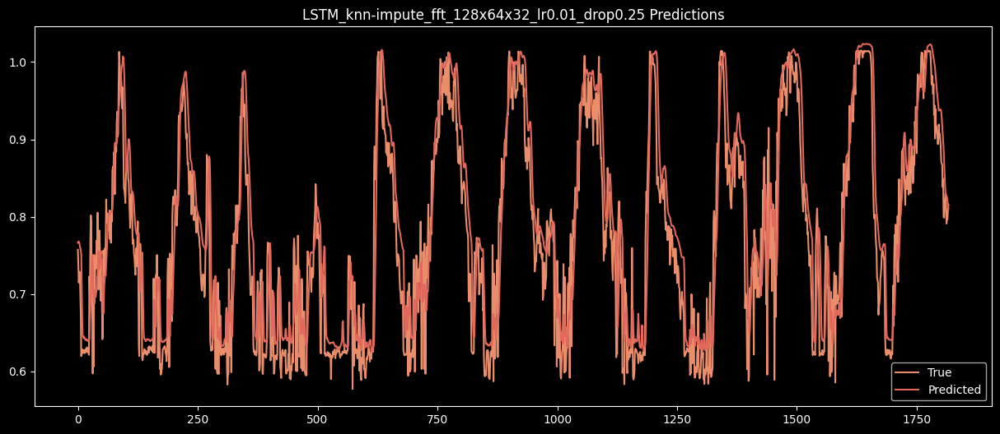

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
103  LSTM_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.072183  0.057975   
104      LSTM_knn-impute_fft_64x32_lr0.01_drop0.25  0.067579  0.054827   
105   LSTM_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.050380  0.037999   
106   LSTM_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.052814  0.040117   
107  LSTM_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.054867  0.042906   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

In [124]:
gen_train_LSTM(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.0001, 0.1,'knn-impute_fft',fft=True)
gen_train_LSTM(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.001, 0.2,'knn-impute_fft',fft=True)
gen_train_LSTM(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.01, 0.25,'knn-impute_fft',fft=True)

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_122"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_101 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_206 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_102 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_42 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_238 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_239 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.1076 - root_mean_squared_error: 0.3176 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0364
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0157 - root_mean_squared_error: 0.1249 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0071 - root_mean_squared_error: 0.0840 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0045 - root_mean_squared_error: 0.0668 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0034 - root_mean_squared_error: 0.0587 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0028 - root_mean_squared_error: 0.0525 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0339
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step 

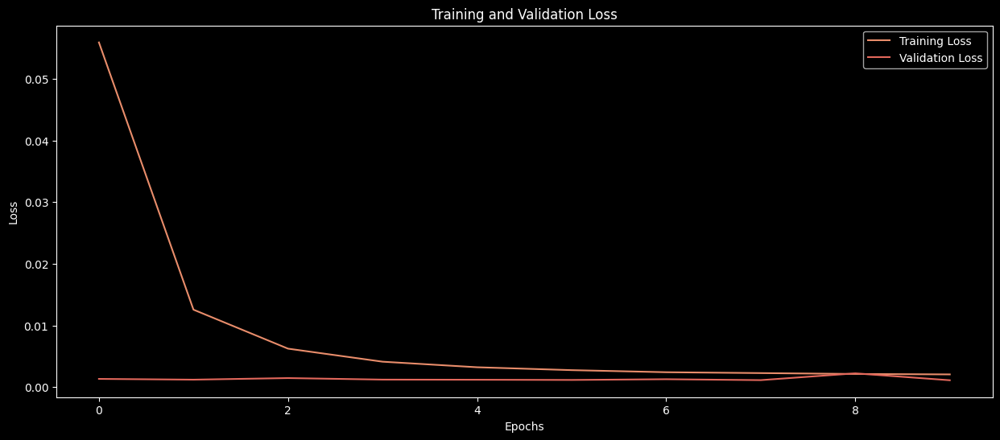

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


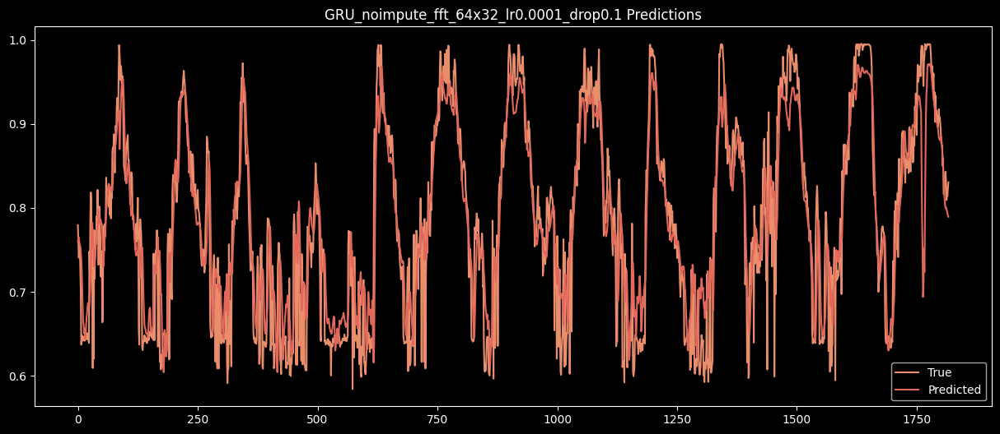

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
104      LSTM_knn-impute_fft_64x32_lr0.01_drop0.25  0.067579  0.054827   
105   LSTM_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.050380  0.037999   
106   LSTM_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.052814  0.040117   
107  LSTM_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.054867  0.042906   
108        GRU_noimpute_fft_64x32_lr0.0001_drop0.1  0.050204  0.036629   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_123"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_103 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_207 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_104 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_208 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_105 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_43 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_240 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_241 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.0613 - root_mean_squared_error: 0.2275 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0421
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0071 - root_mean_squared_error: 0.0843 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0414
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0045 - root_mean_squared_error: 0.0668 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0394
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0035 - root_mean_squared_error: 0.0588 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0388
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0030 - root_mean_squared_error: 0.0551 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0374
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0027 - root_mean_squared_error: 0.0515 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0371
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10

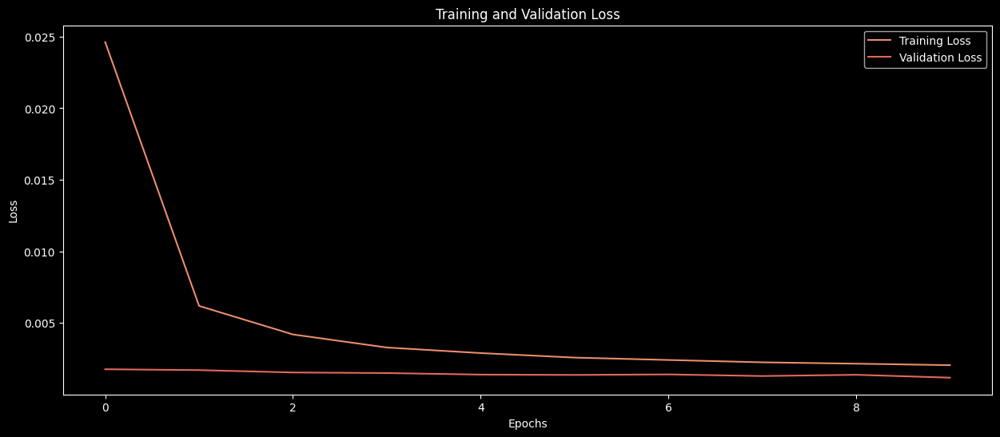

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


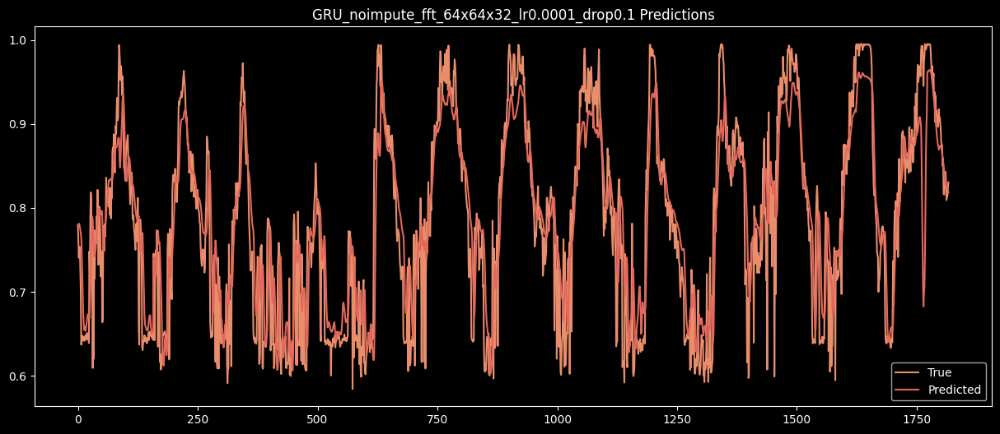

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
105   LSTM_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.050380  0.037999   
106   LSTM_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.052814  0.040117   
107  LSTM_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.054867  0.042906   
108        GRU_noimpute_fft_64x32_lr0.0001_drop0.1  0.050204  0.036629   
109     GRU_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.056396  0.041768   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_124"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_106 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_209 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_107 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_210 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_108 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_44 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_242 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_243 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0719 - root_mean_squared_error: 0.2515 - val_loss: 0.0028 - val_root_mean_squared_error: 0.0530
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0097 - root_mean_squared_error: 0.0984 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0436
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0062 - root_mean_squared_error: 0.0790 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0432
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0044 - root_mean_squared_error: 0.0665 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0037 - root_mean_squared_error: 0.0607 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0395
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0033 - root_mean_squared_error: 0.0570 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0411
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step

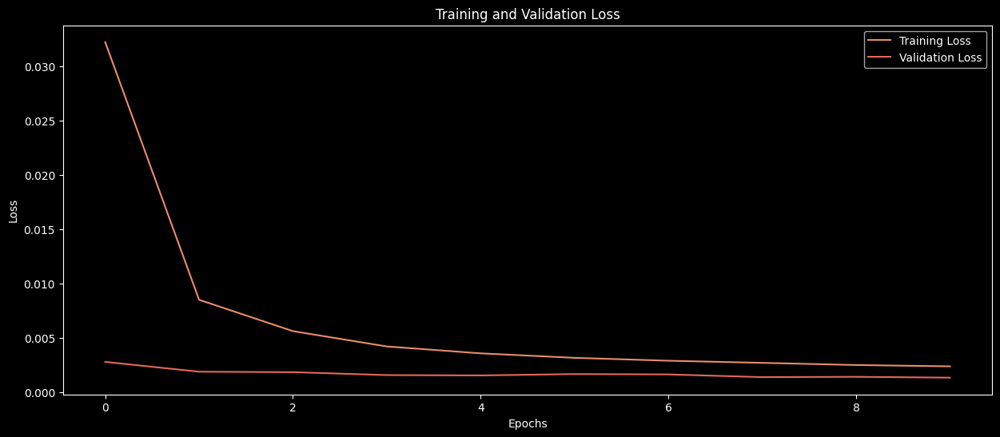

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


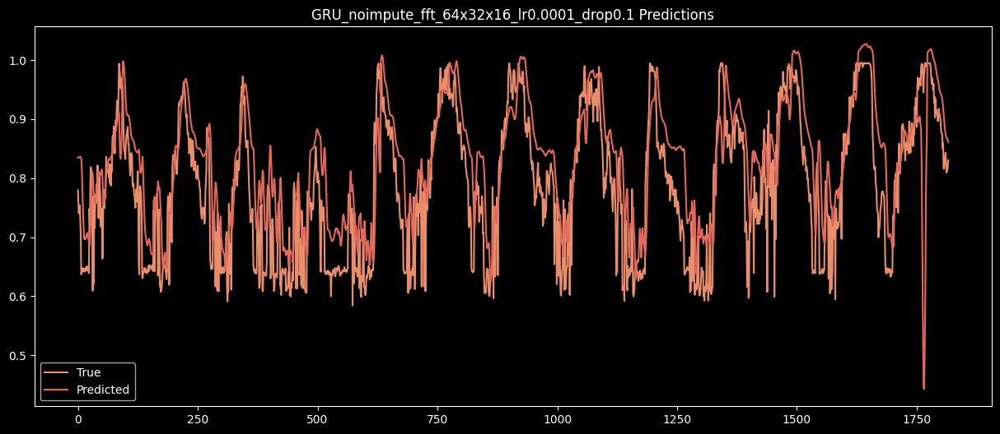

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
106   LSTM_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.052814  0.040117   
107  LSTM_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.054867  0.042906   
108        GRU_noimpute_fft_64x32_lr0.0001_drop0.1  0.050204  0.036629   
109     GRU_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.056396  0.041768   
110     GRU_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.084422  0.066395   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_125"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_109 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_211 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_110 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_212 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_111 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_45 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_244 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_245 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 13ms/step - loss: 0.0229 - root_mean_squared_error: 0.1486 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0418
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0049 - root_mean_squared_error: 0.0701 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0034 - root_mean_squared_error: 0.0582 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0366
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0028 - root_mean_squared_error: 0.0527 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0024 - root_mean_squared_error: 0.0493 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0372
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0023 - root_mean_squared_error: 0.0478 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0354
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12

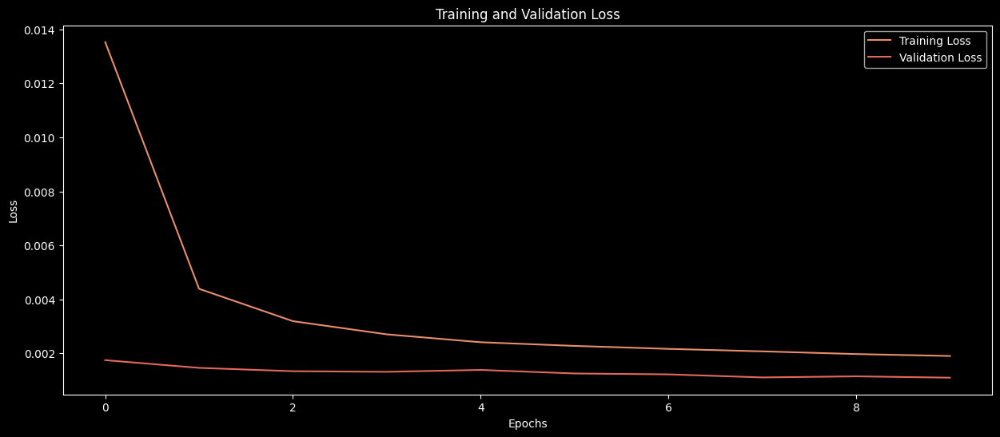

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


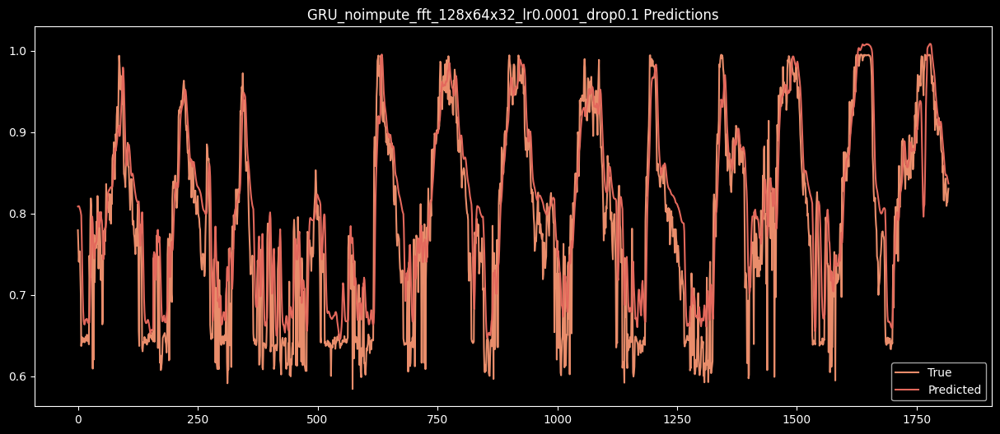

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
107  LSTM_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.054867  0.042906   
108        GRU_noimpute_fft_64x32_lr0.0001_drop0.1  0.050204  0.036629   
109     GRU_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.056396  0.041768   
110     GRU_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.084422  0.066395   
111    GRU_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.058091  0.044457   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_126"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_112 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_213 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_113 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_46 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_246 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_247 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0193 - root_mean_squared_error: 0.1259 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0404
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0470 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - root_mean_squared_error: 0.0436 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0018 - root_mean_squared_error: 0.0427 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0017 - root_mean_squared_error: 0.0406 - val_loss: 9.8560e-04 - val_root_mean_squared_error: 0.0314
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0017 - root_mean_squared_error: 0.0418 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/s

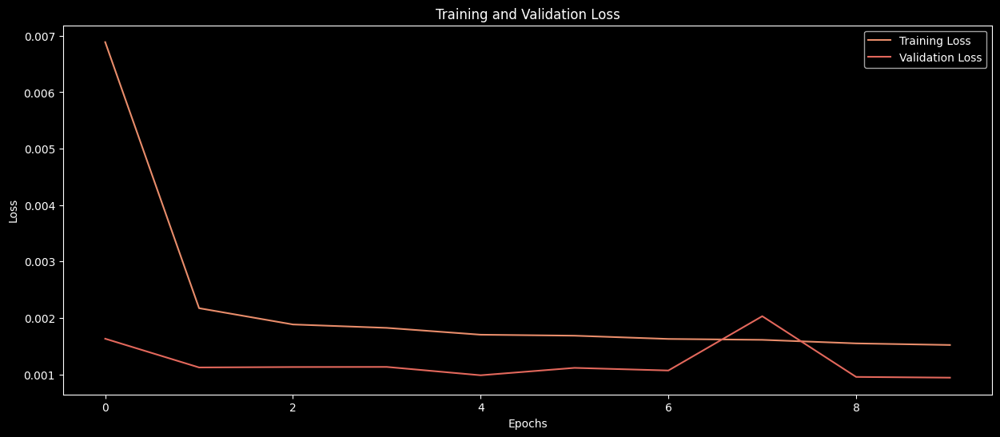

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


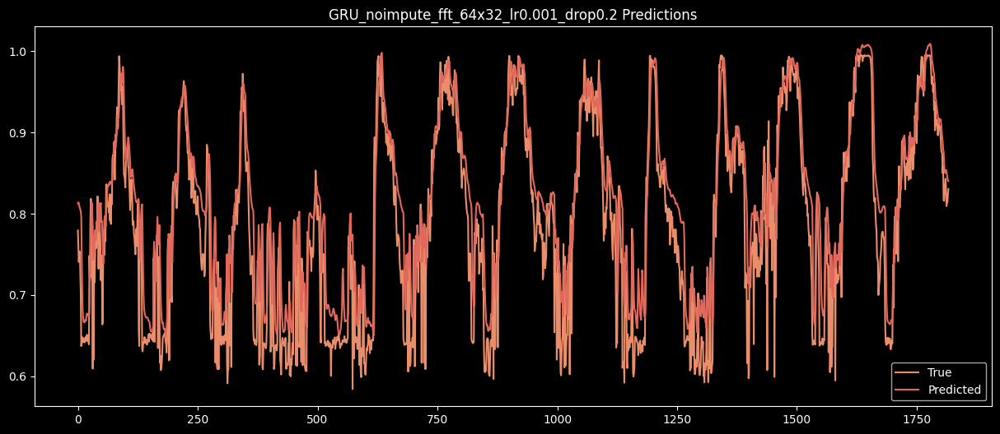

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
108      GRU_noimpute_fft_64x32_lr0.0001_drop0.1  0.050204  0.036629  0.818942
109   GRU_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.056396  0.041768  0.771528
110   GRU_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.084422  0.066395  0.488034
111  GRU_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.058091  0.044457  0.757586
112       GRU_noimpute_fft_64x32_lr0.001_drop0.2  0.054979  0.041743  0.782865

[113 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_127"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_114 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_214 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_115 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_215 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_116 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_47 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_248 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_249 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.0339 - root_mean_squared_error: 0.1670 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0409
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0031 - root_mean_squared_error: 0.0558 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0370
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0025 - root_mean_squared_error: 0.0500 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0022 - root_mean_squared_error: 0.0464 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0392
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0017 - root_mean_squared_error: 0.0418 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/s

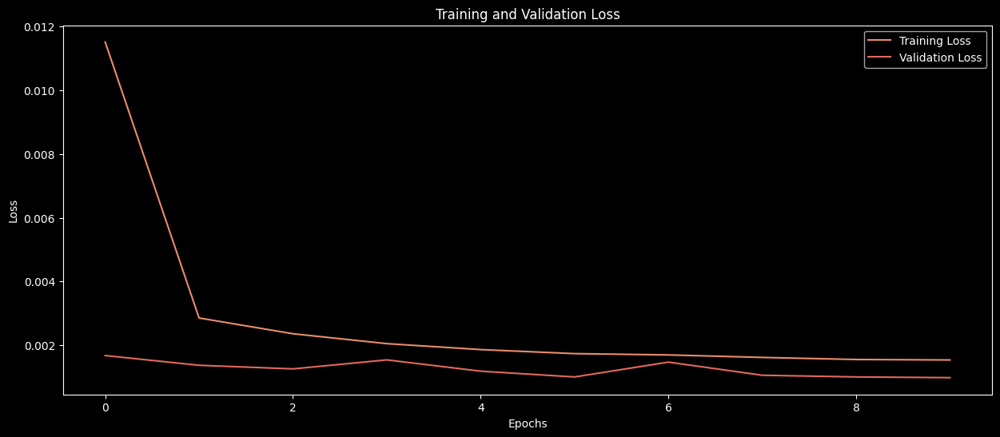

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


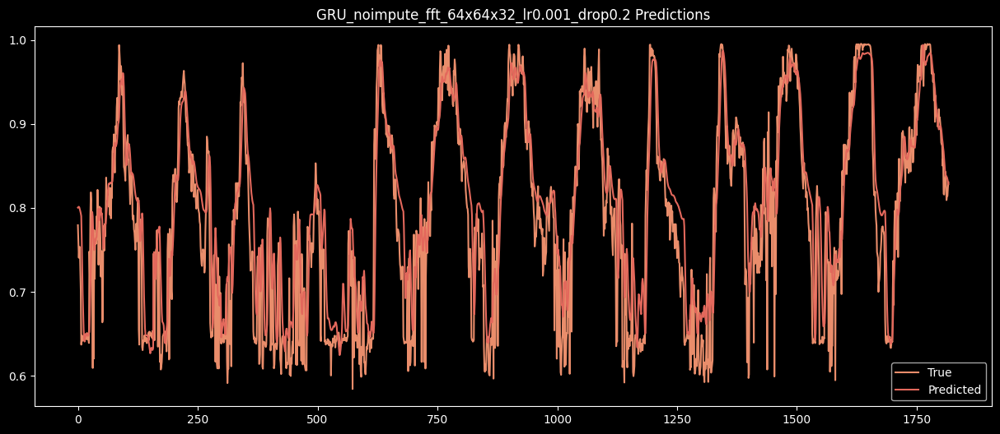

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
109   GRU_noimpute_fft_64x64x32_lr0.0001_drop0.1  0.056396  0.041768  0.771528
110   GRU_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.084422  0.066395  0.488034
111  GRU_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.058091  0.044457  0.757586
112       GRU_noimpute_fft_64x32_lr0.001_drop0.2  0.054979  0.041743  0.782865
113    GRU_noimpute_fft_64x64x32_lr0.001_drop0.2  0.055581  0.040901  0.778081

[114 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_128"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_117 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_216 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_118 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_217 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_119 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_48 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_250 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_251 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0471 - root_mean_squared_error: 0.1932 - val_loss: 0.0026 - val_root_mean_squared_error: 0.0511
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0037 - root_mean_squared_error: 0.0609 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0439
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0027 - root_mean_squared_error: 0.0522 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0368
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0480 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0020 - root_mean_squared_error: 0.0447 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

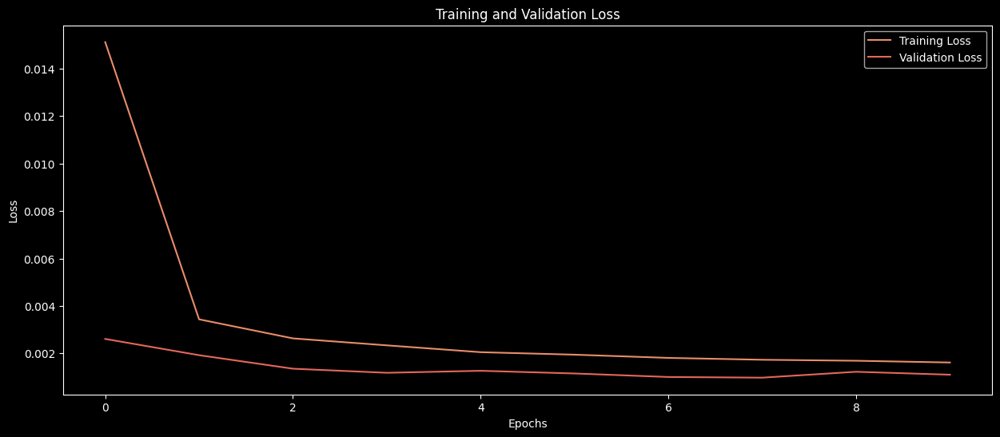

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


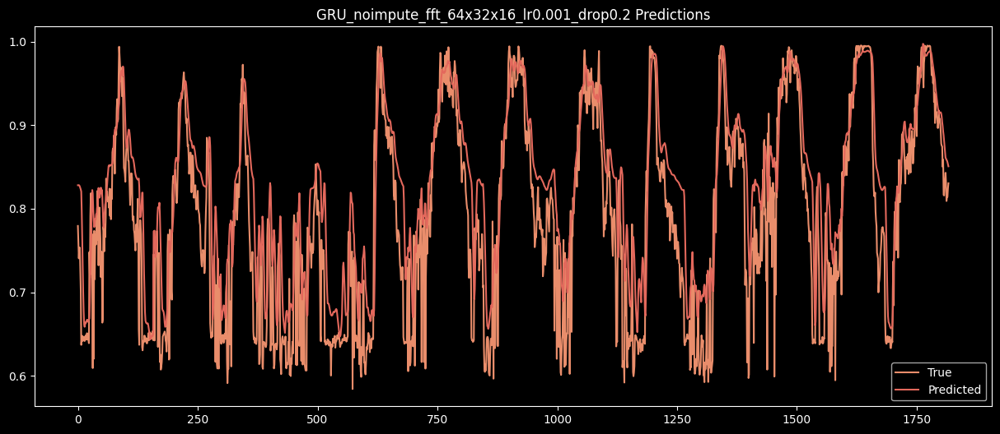

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
110   GRU_noimpute_fft_64x32x16_lr0.0001_drop0.1  0.084422  0.066395  0.488034
111  GRU_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.058091  0.044457  0.757586
112       GRU_noimpute_fft_64x32_lr0.001_drop0.2  0.054979  0.041743  0.782865
113    GRU_noimpute_fft_64x64x32_lr0.001_drop0.2  0.055581  0.040901  0.778081
114    GRU_noimpute_fft_64x32x16_lr0.001_drop0.2  0.068999  0.052608  0.658003

[115 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_129"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_120 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_218 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_121 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_219 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_122 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_49 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_252 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_253 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - loss: 0.0256 - root_mean_squared_error: 0.1441 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0391
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0028 - root_mean_squared_error: 0.0531 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0451
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0024 - root_mean_squared_error: 0.0485 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0362
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0020 - root_mean_squared_error: 0.0449 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0357
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0019 - root_mean_squared_error: 0.0433 - val_loss: 9.5475e-04 - val_root_mean_squared_error: 0.0309
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0017 - root_mean_squared_error: 0.0411 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0465
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7

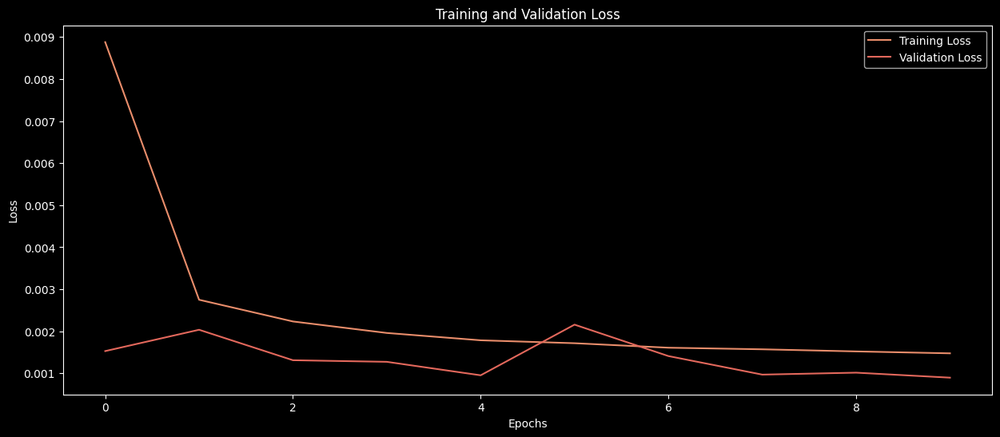

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


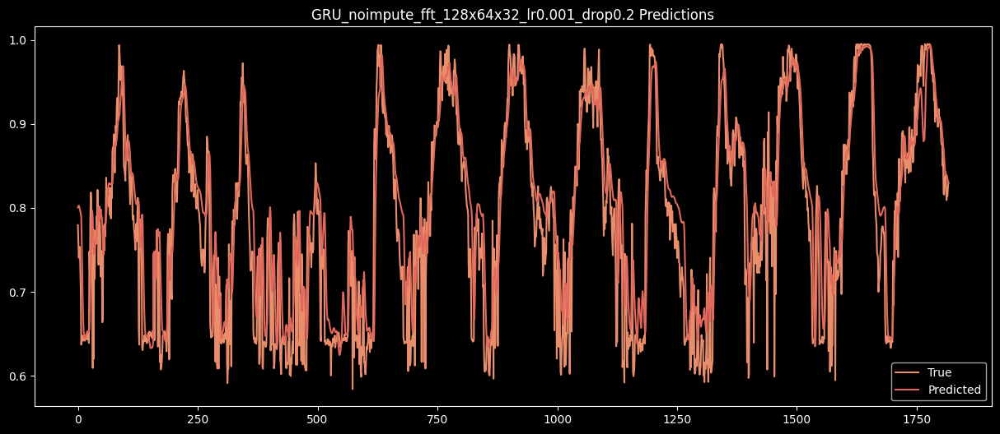

                                           Model      RMSE       MAE        R2
0           LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1        LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2        LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3       LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4            LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                           ...       ...       ...       ...
111  GRU_noimpute_fft_128x64x32_lr0.0001_drop0.1  0.058091  0.044457  0.757586
112       GRU_noimpute_fft_64x32_lr0.001_drop0.2  0.054979  0.041743  0.782865
113    GRU_noimpute_fft_64x64x32_lr0.001_drop0.2  0.055581  0.040901  0.778081
114    GRU_noimpute_fft_64x32x16_lr0.001_drop0.2  0.068999  0.052608  0.658003
115   GRU_noimpute_fft_128x64x32_lr0.001_drop0.2  0.054447  0.040114  0.787045

[116 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_130"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_123 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_220 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_124 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_50 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_254 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_255 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - loss: 0.3073 - root_mean_squared_error: 0.4564 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0426
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0486 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0453
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0021 - root_mean_squared_error: 0.0460 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0420
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 9.6154e-04 - val_root_mean_squared_error: 0.0310
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0412 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0331
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0409 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/s

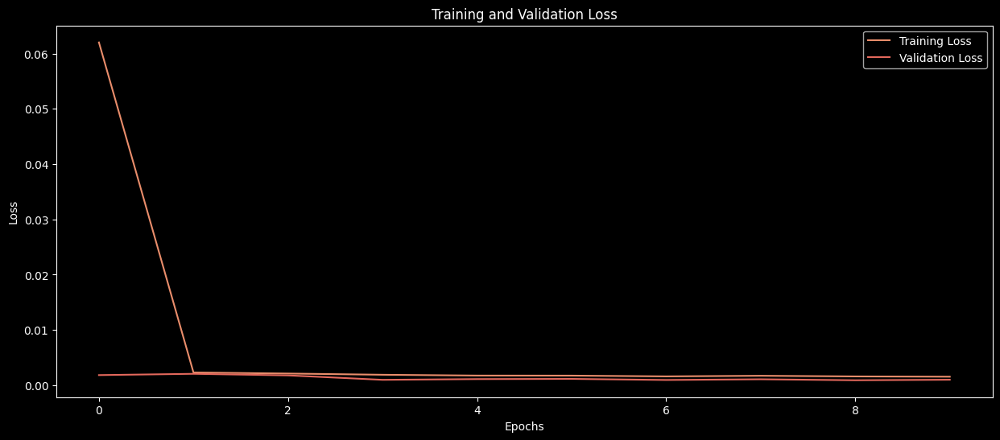

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


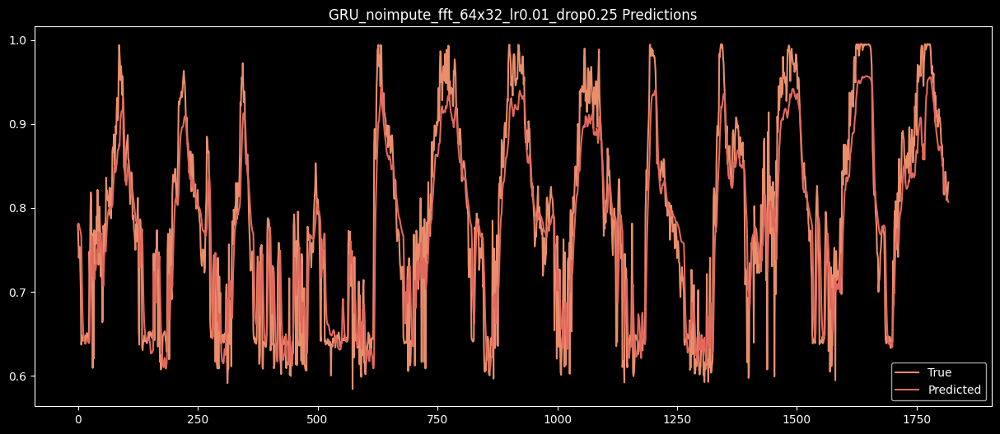

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
112      GRU_noimpute_fft_64x32_lr0.001_drop0.2  0.054979  0.041743  0.782865
113   GRU_noimpute_fft_64x64x32_lr0.001_drop0.2  0.055581  0.040901  0.778081
114   GRU_noimpute_fft_64x32x16_lr0.001_drop0.2  0.068999  0.052608  0.658003
115  GRU_noimpute_fft_128x64x32_lr0.001_drop0.2  0.054447  0.040114  0.787045
116      GRU_noimpute_fft_64x32_lr0.01_drop0.25  0.051148  0.039634  0.812072

[117 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_131"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_125 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_221 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_126 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_222 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_127 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_51 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_256 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_257 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - loss: 1.1910 - root_mean_squared_error: 0.8835 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0409
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0031 - root_mean_squared_error: 0.0559 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0490
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0025 - root_mean_squared_error: 0.0505 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0025 - root_mean_squared_error: 0.0504 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0410
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0020 - root_mean_squared_error: 0.0447 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0019 - root_mean_squared_error: 0.0437 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 11

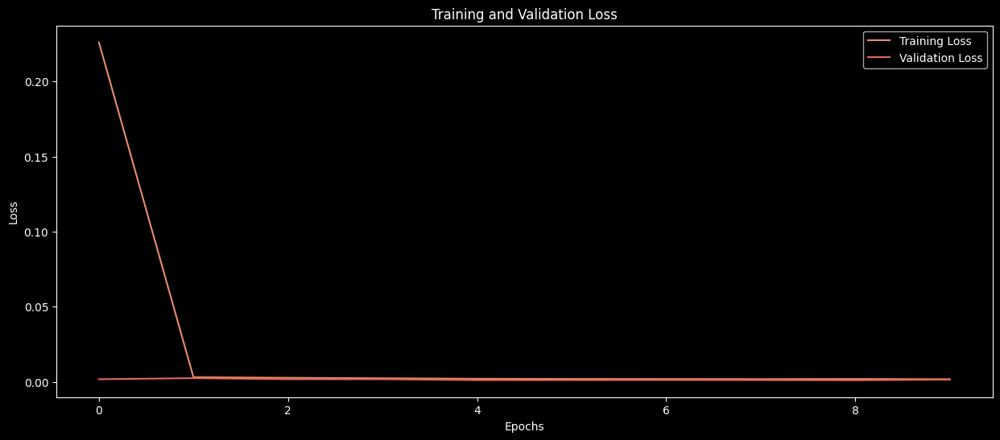

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


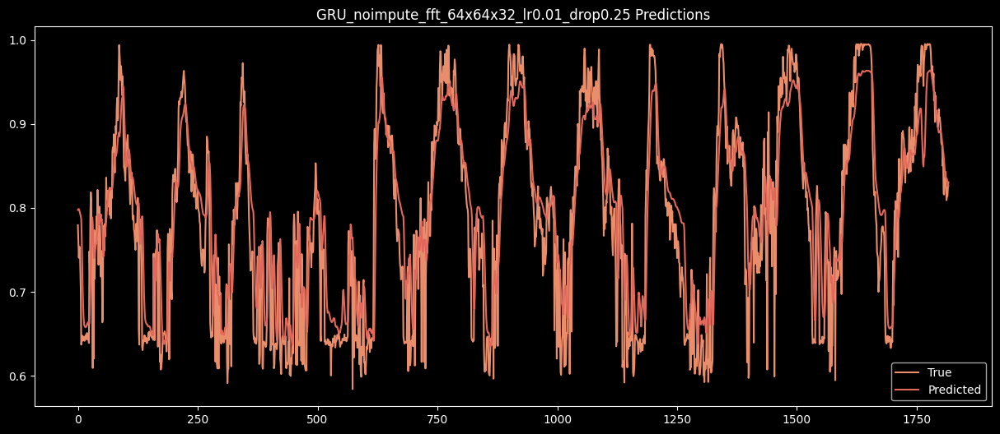

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
113   GRU_noimpute_fft_64x64x32_lr0.001_drop0.2  0.055581  0.040901  0.778081
114   GRU_noimpute_fft_64x32x16_lr0.001_drop0.2  0.068999  0.052608  0.658003
115  GRU_noimpute_fft_128x64x32_lr0.001_drop0.2  0.054447  0.040114  0.787045
116      GRU_noimpute_fft_64x32_lr0.01_drop0.25  0.051148  0.039634  0.812072
117   GRU_noimpute_fft_64x64x32_lr0.01_drop0.25  0.055860  0.042658  0.775848

[118 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_132"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_128 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_223 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_129 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_224 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_130 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_52 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_258 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_259 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.2085 - root_mean_squared_error: 0.3805 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0414
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0031 - root_mean_squared_error: 0.0561 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0479 - val_loss: 0.0025 - val_root_mean_squared_error: 0.0504
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0319
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0400
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0018 - root_mean_squared_error: 0.0423 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

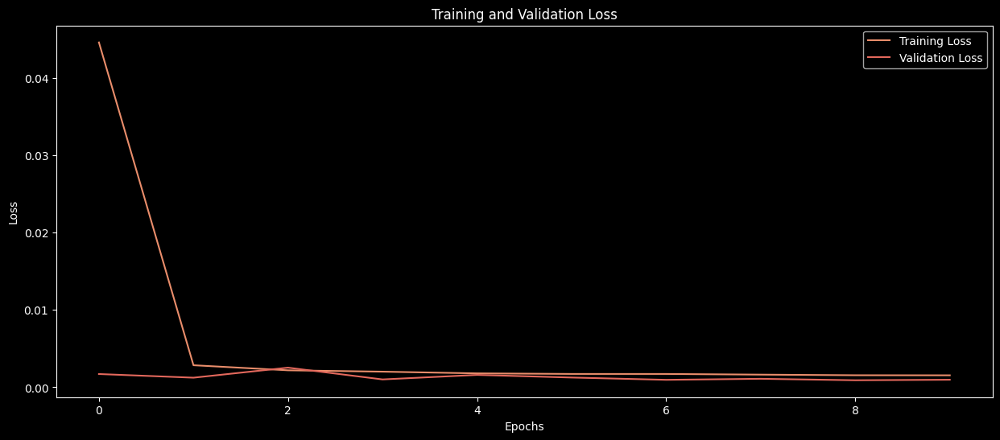

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


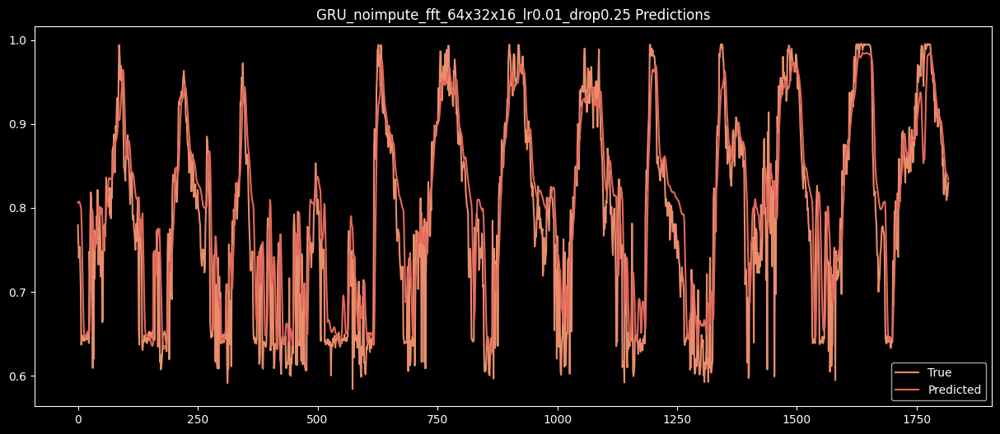

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
114   GRU_noimpute_fft_64x32x16_lr0.001_drop0.2  0.068999  0.052608  0.658003
115  GRU_noimpute_fft_128x64x32_lr0.001_drop0.2  0.054447  0.040114  0.787045
116      GRU_noimpute_fft_64x32_lr0.01_drop0.25  0.051148  0.039634  0.812072
117   GRU_noimpute_fft_64x64x32_lr0.01_drop0.25  0.055860  0.042658  0.775848
118   GRU_noimpute_fft_64x32x16_lr0.01_drop0.25  0.057452  0.042463  0.762893

[119 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_133"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_131 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_225 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_132 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_226 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_133 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_53 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_260 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_261 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 11s 15ms/step - loss: 1.0912 - root_mean_squared_error: 0.8437 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0430
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0032 - root_mean_squared_error: 0.0561 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0421
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0027 - root_mean_squared_error: 0.0524 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0022 - root_mean_squared_error: 0.0464 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0022 - root_mean_squared_error: 0.0470 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0317
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14

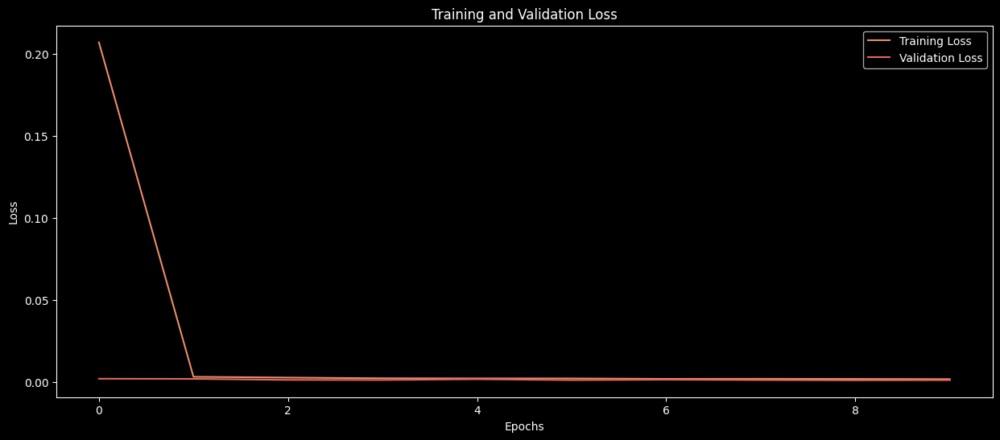

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


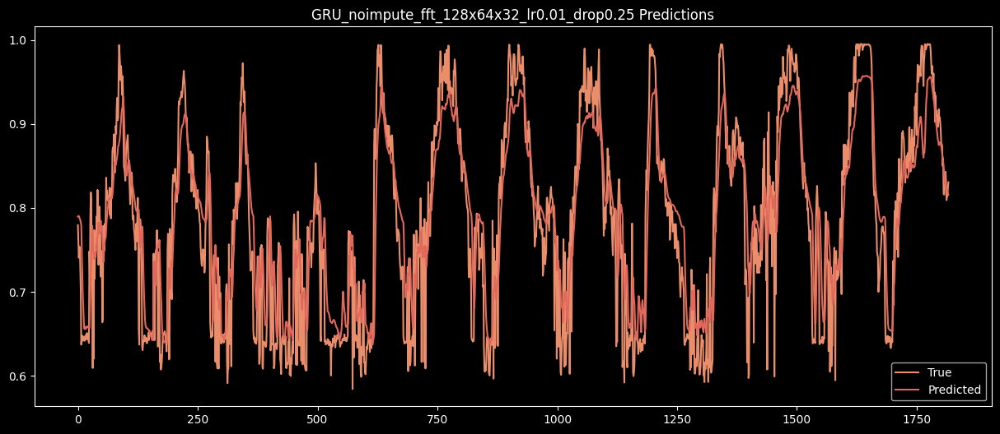

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
115  GRU_noimpute_fft_128x64x32_lr0.001_drop0.2  0.054447  0.040114  0.787045
116      GRU_noimpute_fft_64x32_lr0.01_drop0.25  0.051148  0.039634  0.812072
117   GRU_noimpute_fft_64x64x32_lr0.01_drop0.25  0.055860  0.042658  0.775848
118   GRU_noimpute_fft_64x32x16_lr0.01_drop0.25  0.057452  0.042463  0.762893
119  GRU_noimpute_fft_128x64x32_lr0.01_drop0.25  0.054825  0.042540  0.784084

[120 rows x 4 columns]


In [125]:
gen_train_GRU(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.0001, 0.1,'noimpute_fft',fft=True)
gen_train_GRU(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.001, 0.2,'noimpute_fft',fft=True)
gen_train_GRU(X_train_stand, y_train_stand, X_valid_stand, y_valid_stand, model_sizes, 0.01, 0.25,'noimpute_fft',fft=True)

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_134"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_134 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_227 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_135 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_54 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_262 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_263 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 7ms/step - loss: 0.0711 - root_mean_squared_error: 0.2334 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0463
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0041 - root_mean_squared_error: 0.0642 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0430
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0031 - root_mean_squared_error: 0.0557 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0443
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0028 - root_mean_squared_error: 0.0527 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0026 - root_mean_squared_error: 0.0506 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0390
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0491 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0372
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

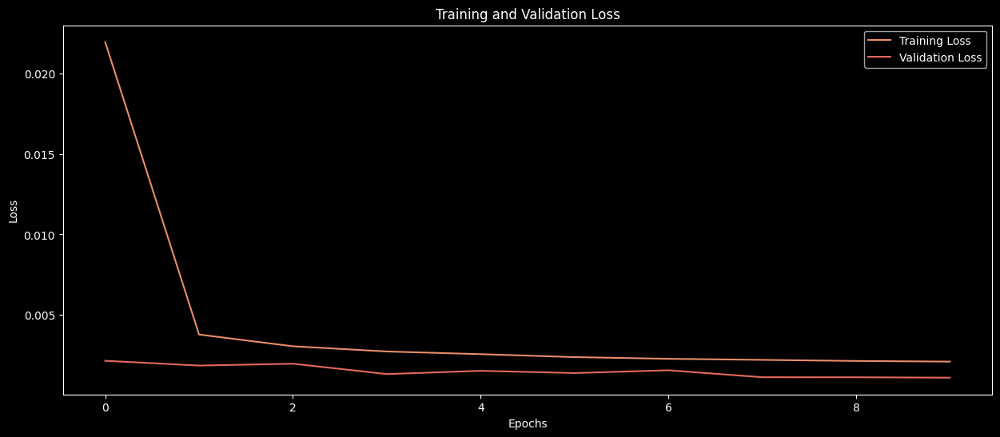

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


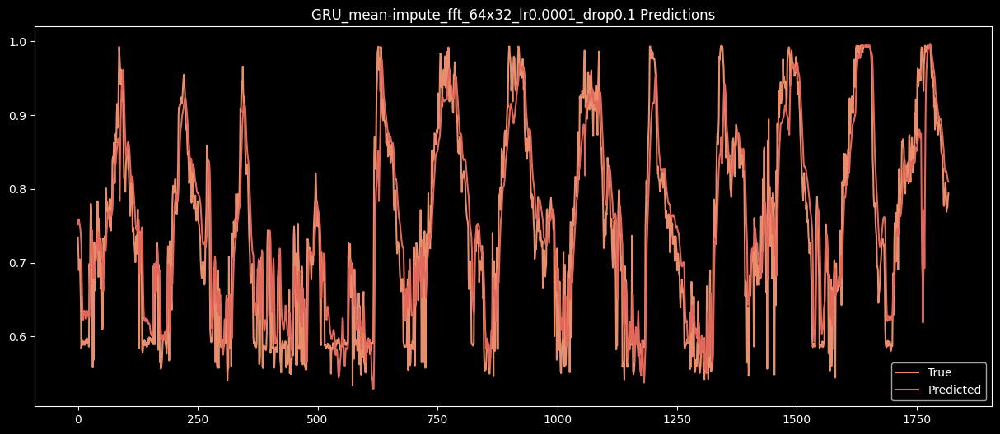

                                          Model      RMSE       MAE        R2
0          LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364  0.860394
1       LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667  0.689495
2       LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825  0.672503
3      LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493  0.706795
4           LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539  0.887449
..                                          ...       ...       ...       ...
116      GRU_noimpute_fft_64x32_lr0.01_drop0.25  0.051148  0.039634  0.812072
117   GRU_noimpute_fft_64x64x32_lr0.01_drop0.25  0.055860  0.042658  0.775848
118   GRU_noimpute_fft_64x32x16_lr0.01_drop0.25  0.057452  0.042463  0.762893
119  GRU_noimpute_fft_128x64x32_lr0.01_drop0.25  0.054825  0.042540  0.784084
120  GRU_mean-impute_fft_64x32_lr0.0001_drop0.1  0.059401  0.044973  0.802440

[121 rows x 4 columns]


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_135"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_136 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_228 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_137 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_229 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_138 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_55 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_264 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_265 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 39s 11ms/step - loss: 0.0172 - root_mean_squared_error: 0.1230 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0476
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0036 - root_mean_squared_error: 0.0601 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0450
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0030 - root_mean_squared_error: 0.0544 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0357
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0026 - root_mean_squared_error: 0.0507 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0350
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0489 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0345
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0379
Epoch 7/20
3204/3204 ━━━━━━━

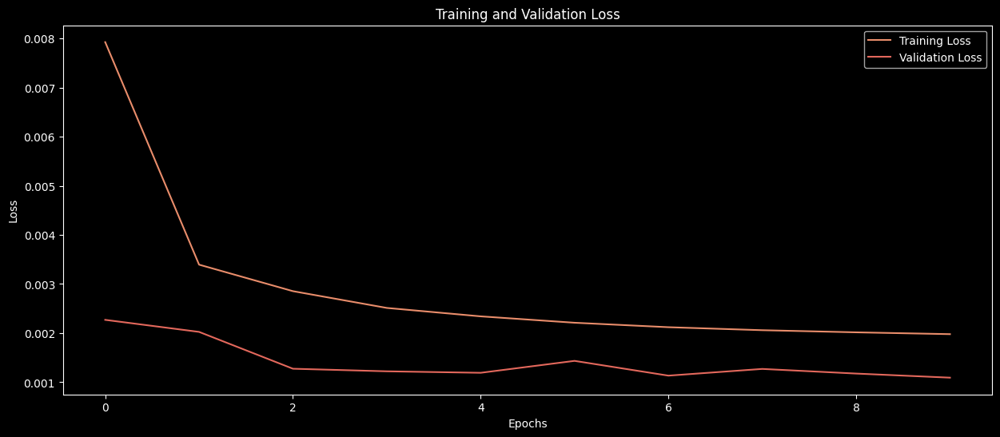

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


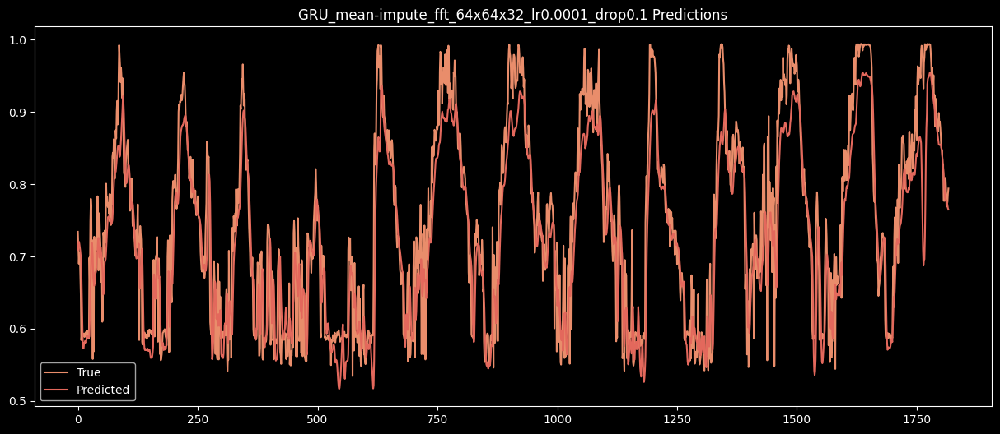

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
117      GRU_noimpute_fft_64x64x32_lr0.01_drop0.25  0.055860  0.042658   
118      GRU_noimpute_fft_64x32x16_lr0.01_drop0.25  0.057452  0.042463   
119     GRU_noimpute_fft_128x64x32_lr0.01_drop0.25  0.054825  0.042540   
120     GRU_mean-impute_fft_64x32_lr0.0001_drop0.1  0.059401  0.044973   
121  GRU_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.058929  0.044659   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_136"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_139 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_230 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_140 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_231 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_141 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_56 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_266 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_267 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 9ms/step - loss: 0.0119 - root_mean_squared_error: 0.1058 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0435
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0037 - root_mean_squared_error: 0.0606 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0389
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0030 - root_mean_squared_error: 0.0546 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0381
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0026 - root_mean_squared_error: 0.0513 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0346
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0024 - root_mean_squared_error: 0.0492 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0344
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

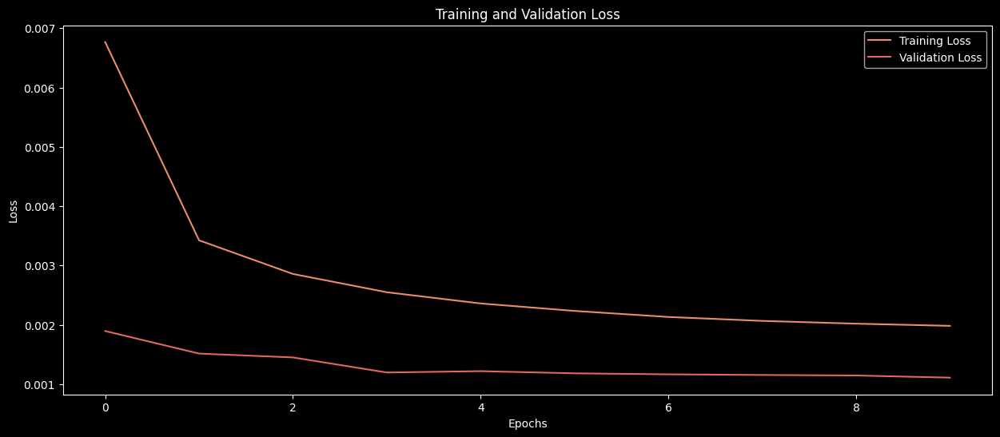

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


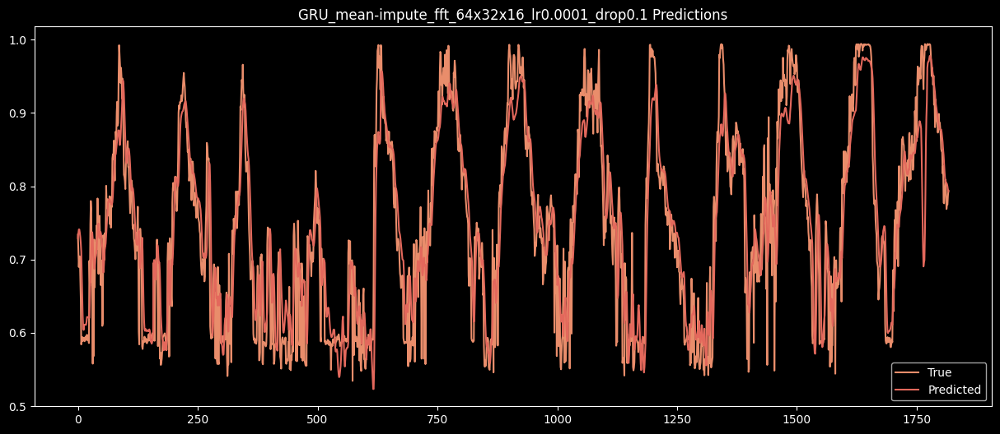

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
118      GRU_noimpute_fft_64x32x16_lr0.01_drop0.25  0.057452  0.042463   
119     GRU_noimpute_fft_128x64x32_lr0.01_drop0.25  0.054825  0.042540   
120     GRU_mean-impute_fft_64x32_lr0.0001_drop0.1  0.059401  0.044973   
121  GRU_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.058929  0.044659   
122  GRU_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.057214  0.043017   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_137"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_142 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_232 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_143 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_233 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_144 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_57 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_268 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_269 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 46s 13ms/step - loss: 0.0401 - root_mean_squared_error: 0.1722 - val_loss: 0.0030 - val_root_mean_squared_error: 0.0544
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 41s 13ms/step - loss: 0.0039 - root_mean_squared_error: 0.0628 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0482
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 41s 13ms/step - loss: 0.0032 - root_mean_squared_error: 0.0562 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0375
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 42s 13ms/step - loss: 0.0026 - root_mean_squared_error: 0.0514 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0361
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 42s 13ms/step - loss: 0.0024 - root_mean_squared_error: 0.0488 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 42s 13ms/step - loss: 0.0022 - root_mean_squared_error: 0.0471 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0354
Epoch 7/20
3204/3204 ━━━━━━━

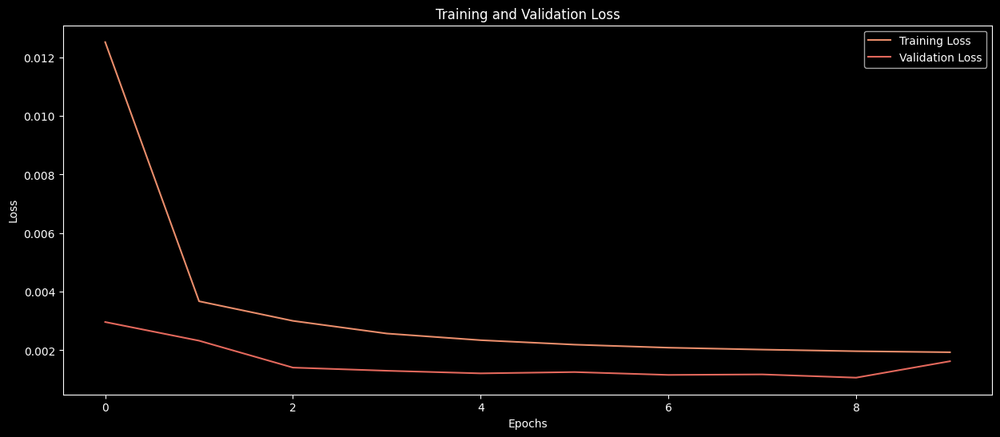

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


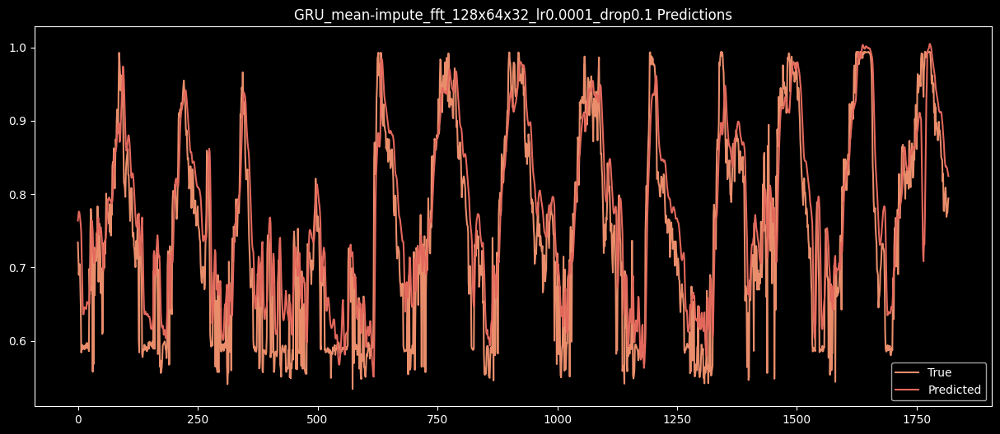

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
119      GRU_noimpute_fft_128x64x32_lr0.01_drop0.25  0.054825  0.042540   
120      GRU_mean-impute_fft_64x32_lr0.0001_drop0.1  0.059401  0.044973   
121   GRU_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.058929  0.044659   
122   GRU_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.057214  0.043017   
123  GRU_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.065161  0.051512   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_138"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_145 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_234 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_146 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_58 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_270 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_271 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 7ms/step - loss: 0.0134 - root_mean_squared_error: 0.1045 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0356
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0028 - root_mean_squared_error: 0.0525 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0486 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0418
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0021 - root_mean_squared_error: 0.0462 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0371
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0450 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0378
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0348
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

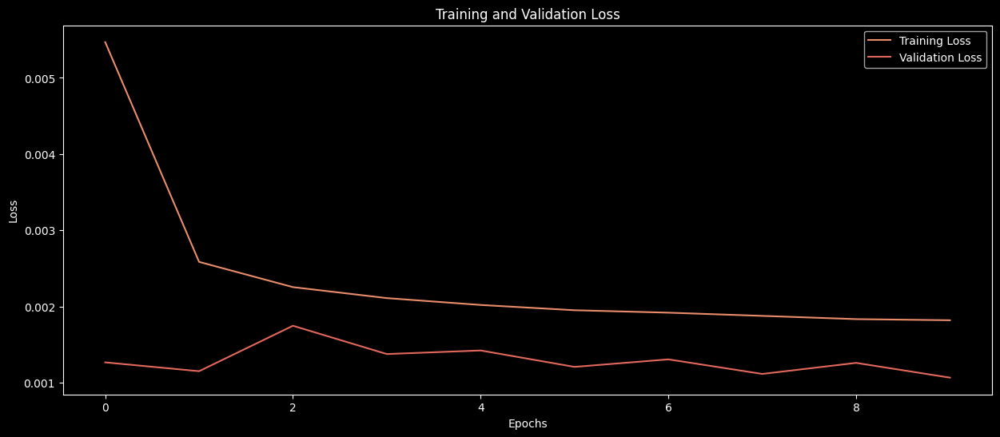

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


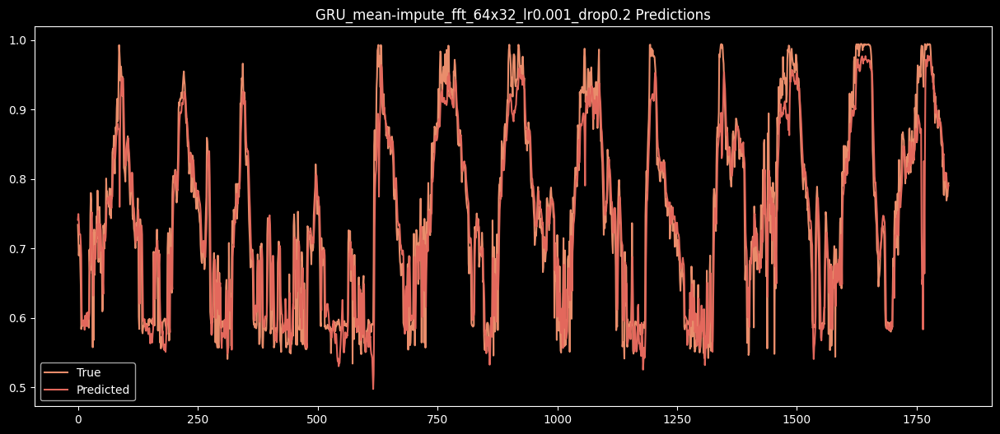

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
120      GRU_mean-impute_fft_64x32_lr0.0001_drop0.1  0.059401  0.044973   
121   GRU_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.058929  0.044659   
122   GRU_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.057214  0.043017   
123  GRU_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.065161  0.051512   
124       GRU_mean-impute_fft_64x32_lr0.001_drop0.2  0.050473  0.035245   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_139"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_147 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_235 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_148 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_236 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_149 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_59 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_272 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_273 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 10ms/step - loss: 0.0076 - root_mean_squared_error: 0.0821 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0385
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0025 - root_mean_squared_error: 0.0502 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0377
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0469 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0336
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0020 - root_mean_squared_error: 0.0443 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0441 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0378
Epoch 7/20
3204/3204 ━━━━━━━

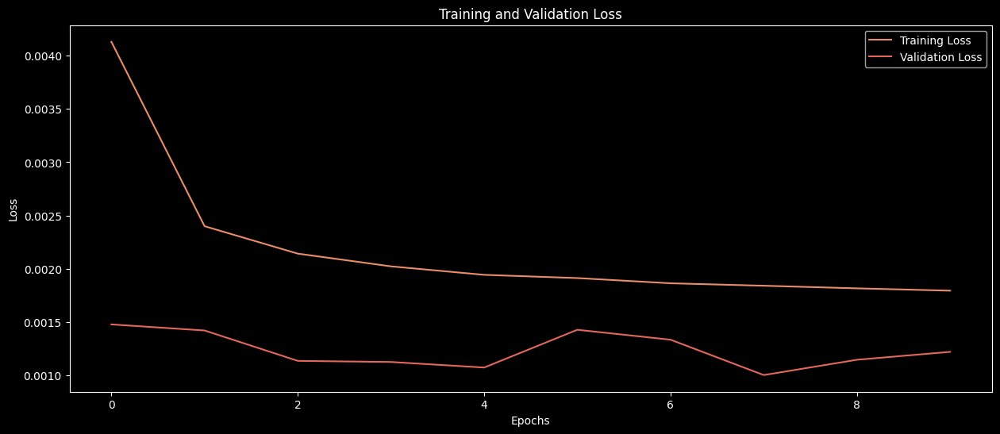

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


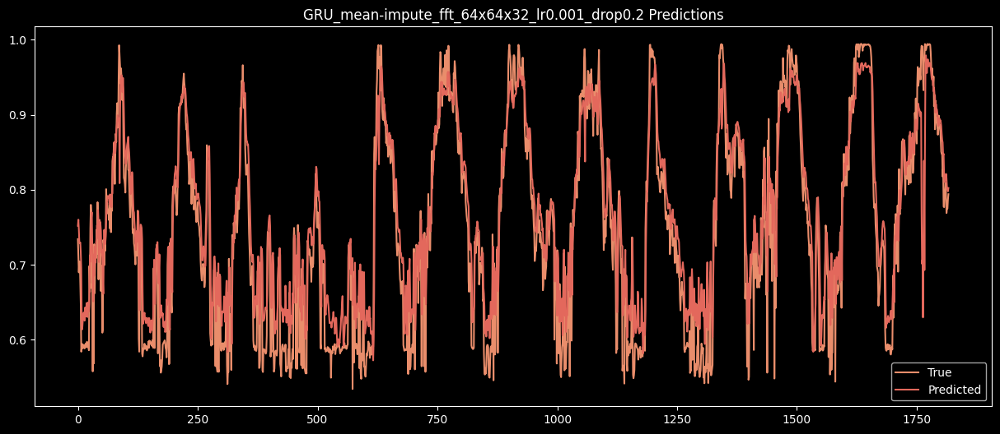

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
121   GRU_mean-impute_fft_64x64x32_lr0.0001_drop0.1  0.058929  0.044659   
122   GRU_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.057214  0.043017   
123  GRU_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.065161  0.051512   
124       GRU_mean-impute_fft_64x32_lr0.001_drop0.2  0.050473  0.035245   
125    GRU_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.053067  0.040532   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_140"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_150 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_237 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_151 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_238 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_152 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_60 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_274 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_275 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 34s 9ms/step - loss: 0.0145 - root_mean_squared_error: 0.1067 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0405
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 29s 9ms/step - loss: 0.0026 - root_mean_squared_error: 0.0513 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0345
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0022 - root_mean_squared_error: 0.0473 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0350
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0453 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0020 - root_mean_squared_error: 0.0449 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0019 - root_mean_squared_error: 0.0435 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

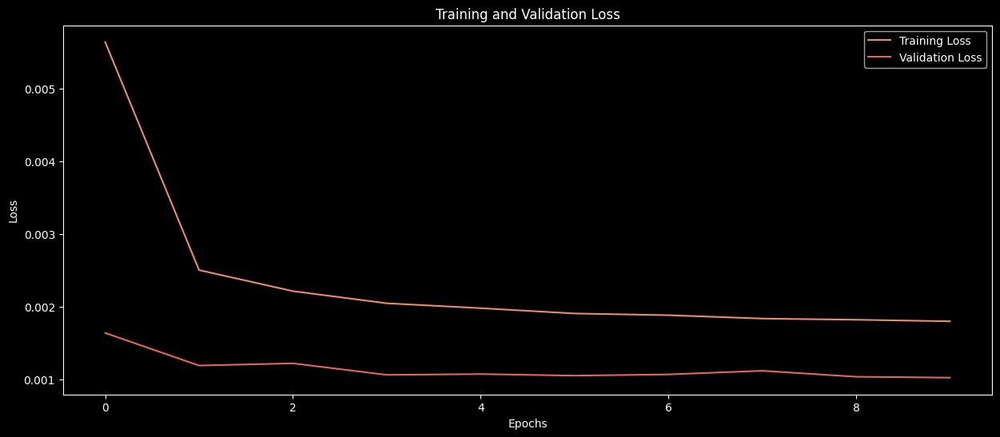

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


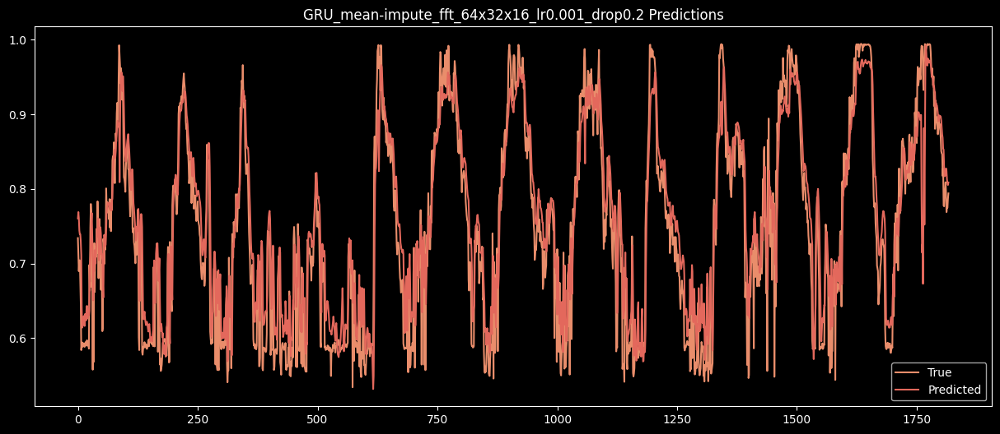

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
122   GRU_mean-impute_fft_64x32x16_lr0.0001_drop0.1  0.057214  0.043017   
123  GRU_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.065161  0.051512   
124       GRU_mean-impute_fft_64x32_lr0.001_drop0.2  0.050473  0.035245   
125    GRU_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.053067  0.040532   
126    GRU_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.052773  0.040288   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_141"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_153 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_239 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_154 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_240 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_155 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_61 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_276 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_277 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 46s 13ms/step - loss: 0.0157 - root_mean_squared_error: 0.1096 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0353
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 40s 12ms/step - loss: 0.0025 - root_mean_squared_error: 0.0503 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 40s 12ms/step - loss: 0.0023 - root_mean_squared_error: 0.0480 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0420
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 40s 12ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 40s 12ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 40s 12ms/step - loss: 0.0019 - root_mean_squared_error: 0.0439 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 7/20
3204/3204 ━━━━━━━

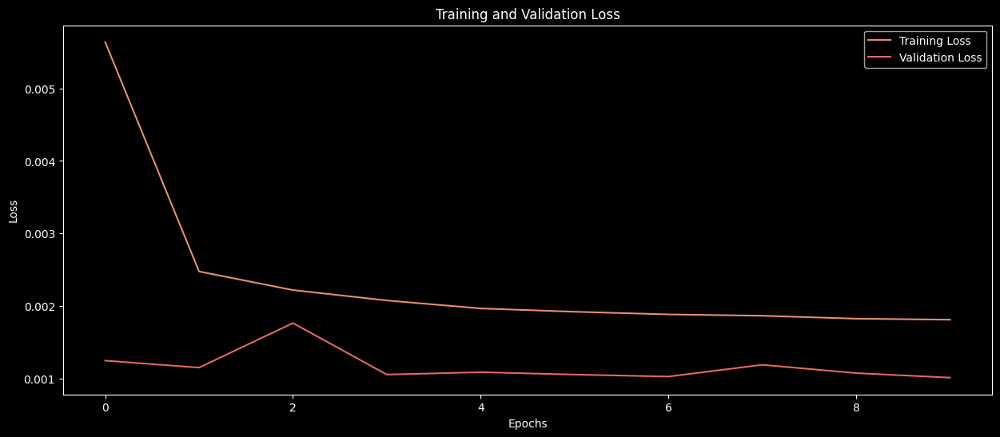

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


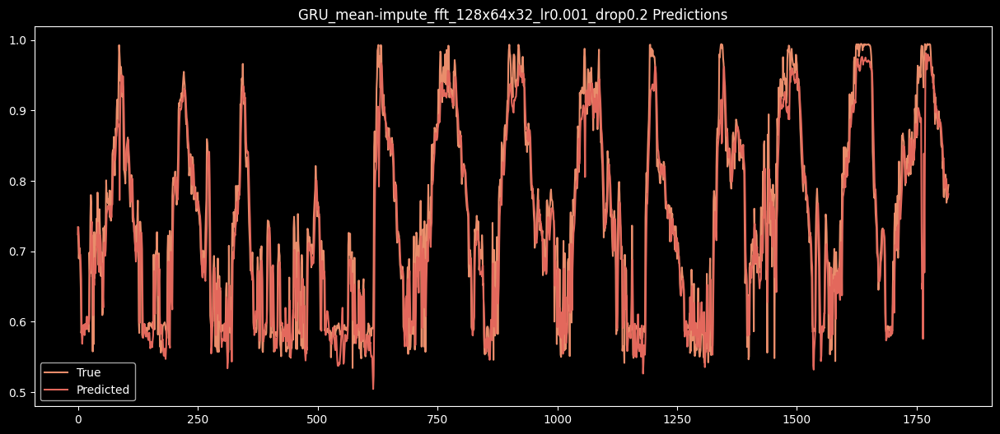

                                              Model      RMSE       MAE  \
0              LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1           LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2           LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3          LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4               LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                              ...       ...       ...   
123  GRU_mean-impute_fft_128x64x32_lr0.0001_drop0.1  0.065161  0.051512   
124       GRU_mean-impute_fft_64x32_lr0.001_drop0.2  0.050473  0.035245   
125    GRU_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.053067  0.040532   
126    GRU_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.052773  0.040288   
127   GRU_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.048754  0.033630   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
.. 

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_142"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_156 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_241 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_157 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_62 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_278 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_279 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 25s 7ms/step - loss: 0.1244 - root_mean_squared_error: 0.2644 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0027 - root_mean_squared_error: 0.0524 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0364
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0024 - root_mean_squared_error: 0.0493 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 0.0022 - root_mean_squared_error: 0.0468 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0332
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0454 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0021 - root_mean_squared_error: 0.0458 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0404
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

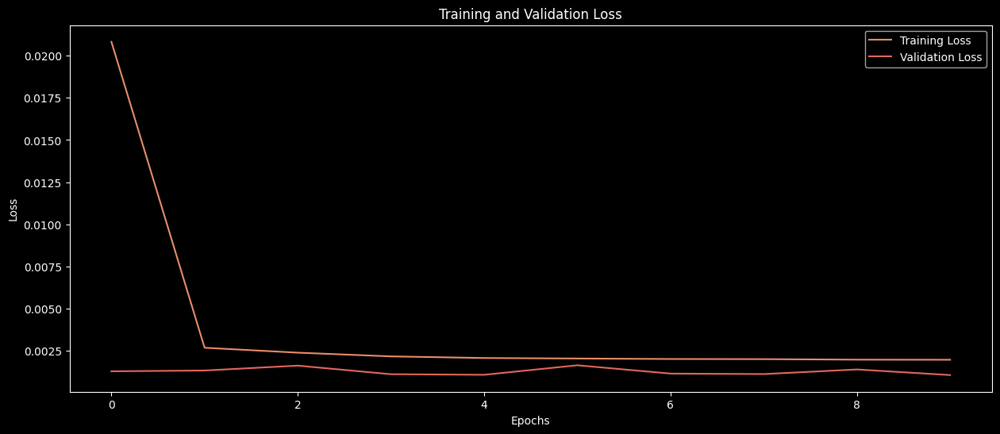

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


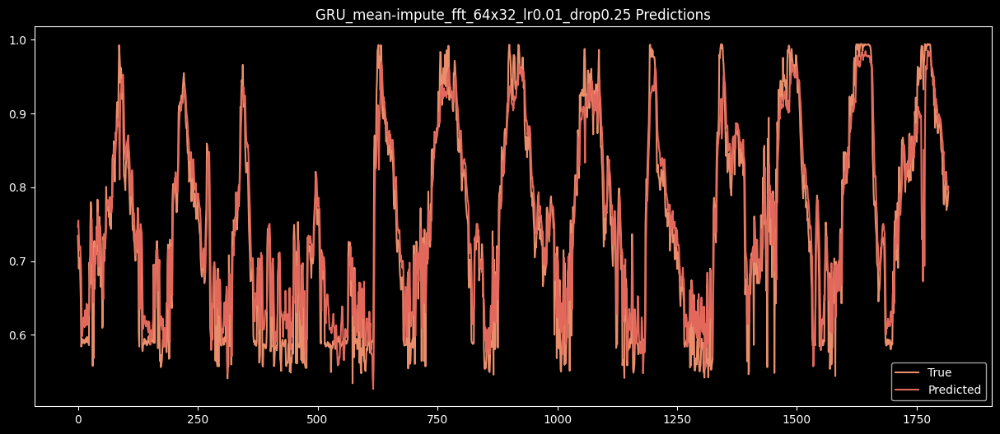

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
124      GRU_mean-impute_fft_64x32_lr0.001_drop0.2  0.050473  0.035245   
125   GRU_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.053067  0.040532   
126   GRU_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.052773  0.040288   
127  GRU_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.048754  0.033630   
128      GRU_mean-impute_fft_64x32_lr0.01_drop0.25  0.048364  0.035974   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_143"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_158 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_242 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_159 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_243 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_160 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_63 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_280 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_281 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 37s 10ms/step - loss: 0.2371 - root_mean_squared_error: 0.3559 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0030 - root_mean_squared_error: 0.0544 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0495 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0337
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0024 - root_mean_squared_error: 0.0489 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0371
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 32s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0471 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0435
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 31s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0421
Epoch 7/20
3204/3204 ━━━━━━━

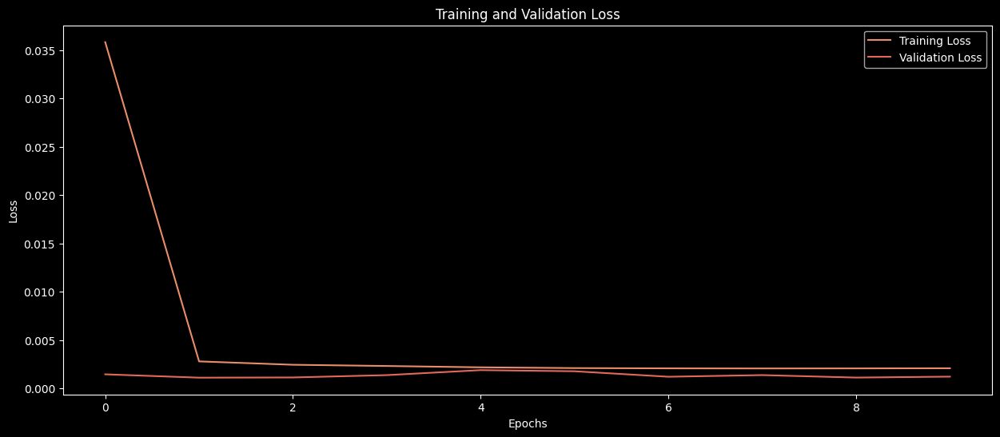

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


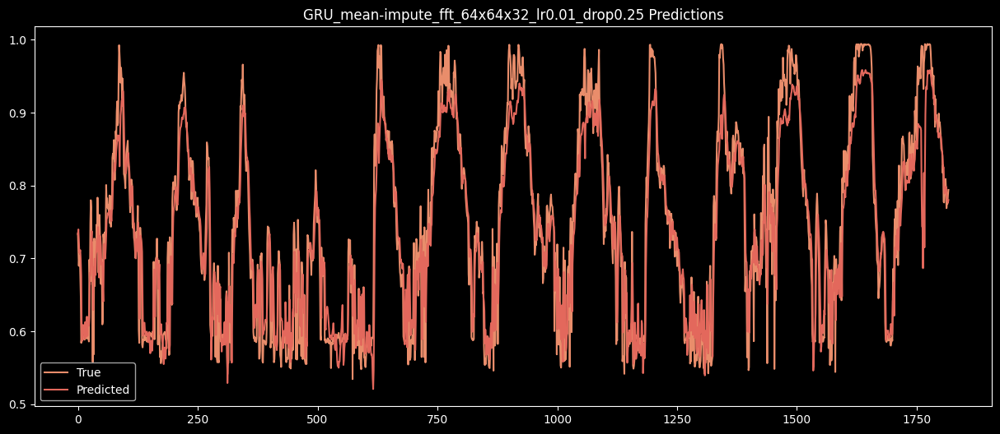

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
125   GRU_mean-impute_fft_64x64x32_lr0.001_drop0.2  0.053067  0.040532   
126   GRU_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.052773  0.040288   
127  GRU_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.048754  0.033630   
128      GRU_mean-impute_fft_64x32_lr0.01_drop0.25  0.048364  0.035974   
129   GRU_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.049281  0.036127   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_144"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_161 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_244 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_162 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_245 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_163 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_64 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_282 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_283 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 33s 9ms/step - loss: 0.0504 - root_mean_squared_error: 0.1729 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0342
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0025 - root_mean_squared_error: 0.0501 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0327
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0023 - root_mean_squared_error: 0.0483 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0492
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0022 - root_mean_squared_error: 0.0472 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0022 - root_mean_squared_error: 0.0464 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 28s 9ms/step - loss: 0.0021 - root_mean_squared_error: 0.0459 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0396
Epoch 7/20
3204/3204 ━━━━━━━━━━━━━

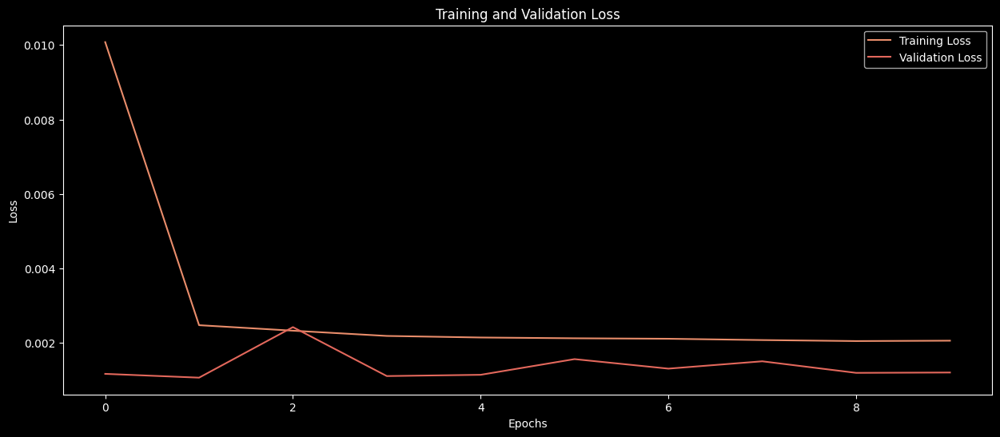

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


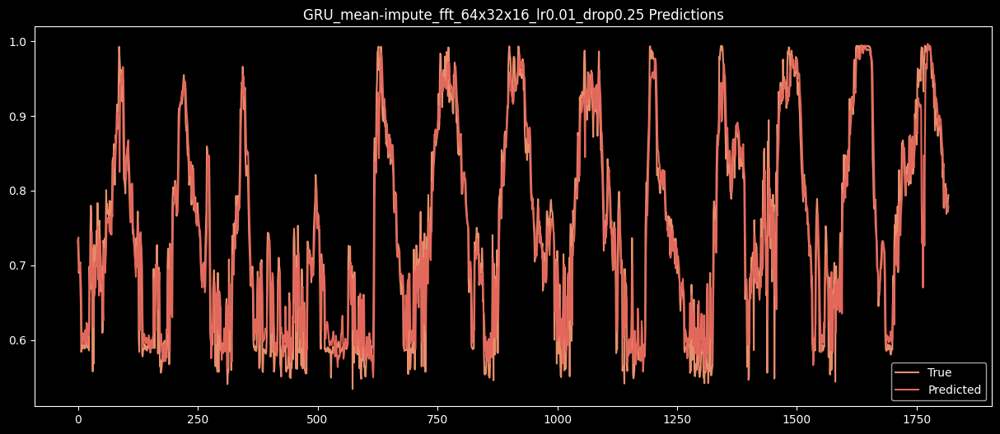

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
126   GRU_mean-impute_fft_64x32x16_lr0.001_drop0.2  0.052773  0.040288   
127  GRU_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.048754  0.033630   
128      GRU_mean-impute_fft_64x32_lr0.01_drop0.25  0.048364  0.035974   
129   GRU_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.049281  0.036127   
130   GRU_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.044238  0.031072   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_145"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_164 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_246 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_165 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_247 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_166 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_65 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_284 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_285 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 45s 12ms/step - loss: 0.1621 - root_mean_squared_error: 0.2987 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0373
Epoch 2/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0029 - root_mean_squared_error: 0.0537 - val_loss: 0.0031 - val_root_mean_squared_error: 0.0560
Epoch 3/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0025 - root_mean_squared_error: 0.0496 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0417
Epoch 4/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0023 - root_mean_squared_error: 0.0481 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 5/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0022 - root_mean_squared_error: 0.0467 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0420
Epoch 6/20
3204/3204 ━━━━━━━━━━━━━━━━━━━━ 38s 12ms/step - loss: 0.0020 - root_mean_squared_error: 0.0451 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0345
Epoch 7/20
3204/3204 ━━━━━━━

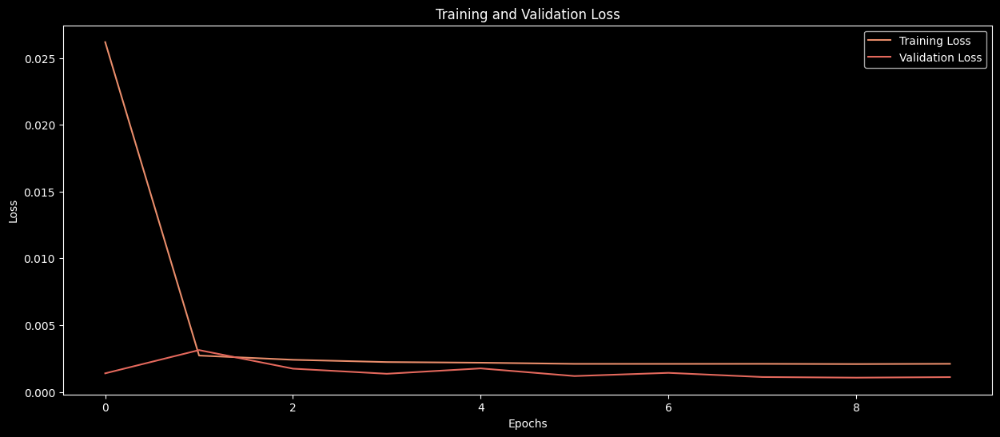

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


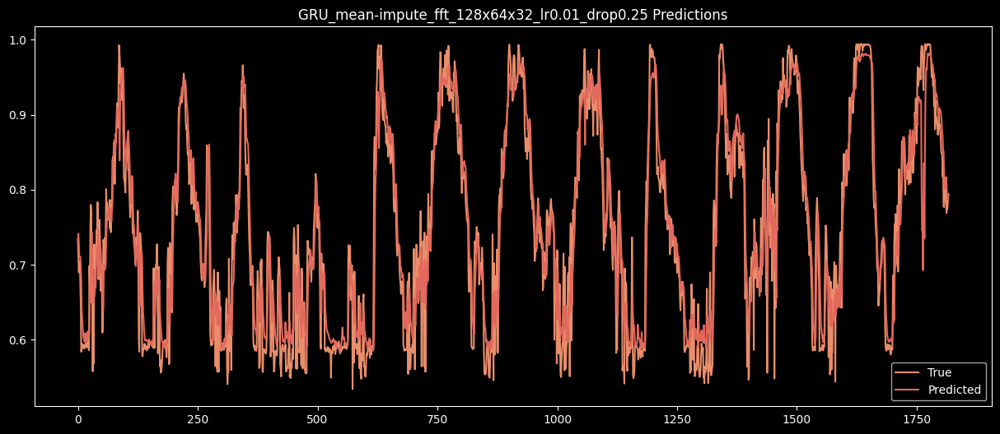

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
127  GRU_mean-impute_fft_128x64x32_lr0.001_drop0.2  0.048754  0.033630   
128      GRU_mean-impute_fft_64x32_lr0.01_drop0.25  0.048364  0.035974   
129   GRU_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.049281  0.036127   
130   GRU_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.044238  0.031072   
131  GRU_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.046927  0.034499   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

In [126]:
gen_train_GRU(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.0001, 0.1,'mean-impute_fft',fft=True)
gen_train_GRU(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.001, 0.2,'mean-impute_fft',fft=True)
gen_train_GRU(X_train_mean, y_train_mean, X_valid_mean, y_valid_mean, model_sizes, 0.01, 0.25,'mean-impute_fft',fft=True)

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_146"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_167 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_248 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_168 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_66 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_286 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_287 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0395 - root_mean_squared_error: 0.1934 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0414
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0074 - root_mean_squared_error: 0.0859 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0419
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0042 - root_mean_squared_error: 0.0648 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0364
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0030 - root_mean_squared_error: 0.0551 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0399
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0026 - root_mean_squared_error: 0.0514 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0024 - root_mean_squared_error: 0.0487 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0402
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step 

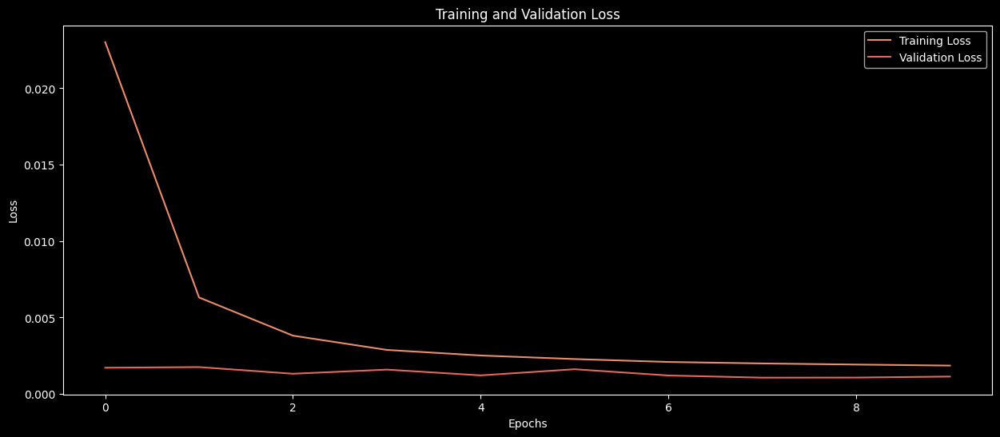

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


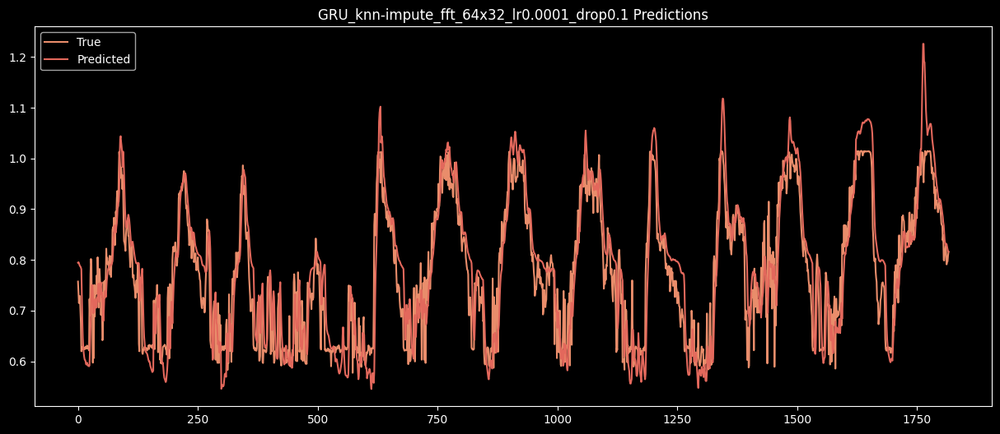

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
128      GRU_mean-impute_fft_64x32_lr0.01_drop0.25  0.048364  0.035974   
129   GRU_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.049281  0.036127   
130   GRU_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.044238  0.031072   
131  GRU_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.046927  0.034499   
132      GRU_knn-impute_fft_64x32_lr0.0001_drop0.1  0.060939  0.048110   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_147"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_169 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_249 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_170 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_250 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_171 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_67 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_288 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_289 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.0665 - root_mean_squared_error: 0.2298 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0435
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0063 - root_mean_squared_error: 0.0793 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0446
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0044 - root_mean_squared_error: 0.0661 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0428
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0035 - root_mean_squared_error: 0.0593 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0408
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0031 - root_mean_squared_error: 0.0553 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0385
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0028 - root_mean_squared_error: 0.0531 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10

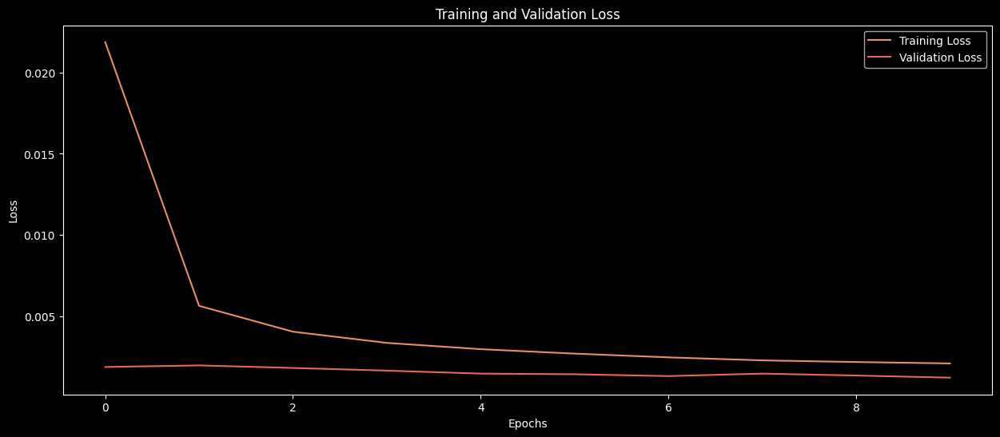

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


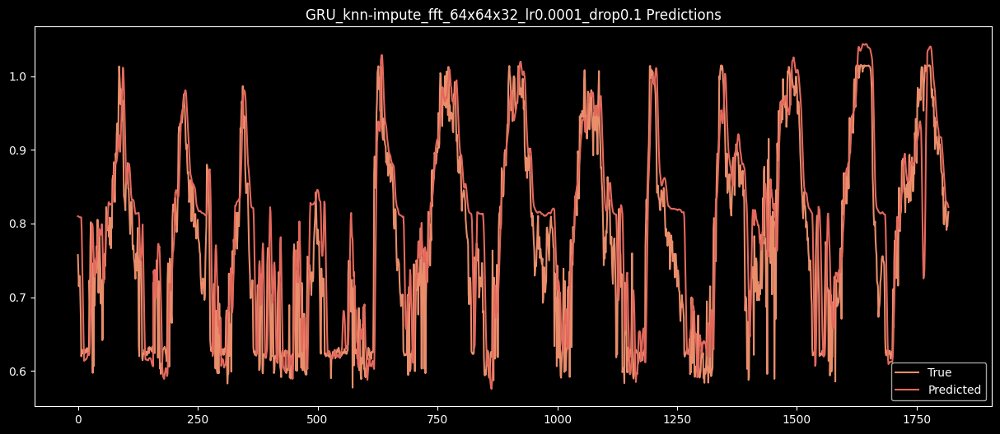

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
129   GRU_mean-impute_fft_64x64x32_lr0.01_drop0.25  0.049281  0.036127   
130   GRU_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.044238  0.031072   
131  GRU_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.046927  0.034499   
132      GRU_knn-impute_fft_64x32_lr0.0001_drop0.1  0.060939  0.048110   
133   GRU_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.070140  0.053274   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_148"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_172 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_251 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_173 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_252 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_174 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_68 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_290 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_291 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0243 - root_mean_squared_error: 0.1539 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0458
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0062 - root_mean_squared_error: 0.0787 - val_loss: 0.0021 - val_root_mean_squared_error: 0.0454
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0042 - root_mean_squared_error: 0.0649 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0386
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0032 - root_mean_squared_error: 0.0566 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0384
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0029 - root_mean_squared_error: 0.0536 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0025 - root_mean_squared_error: 0.0501 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0352
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step

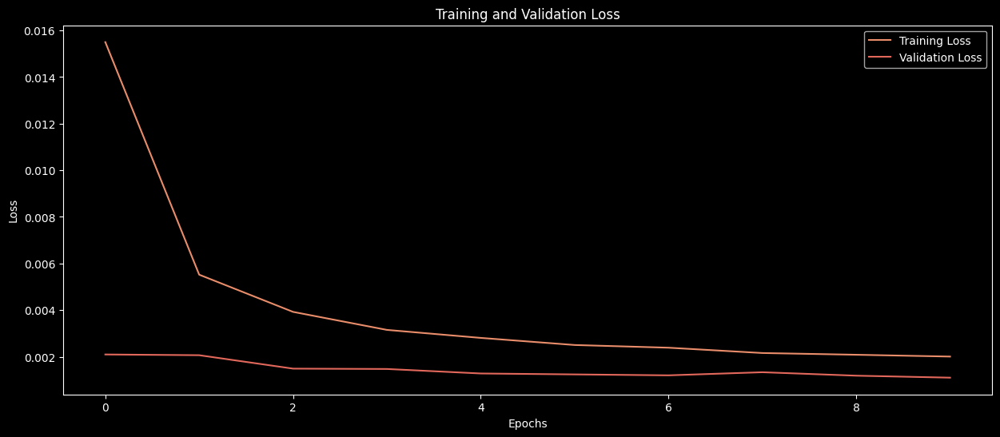

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


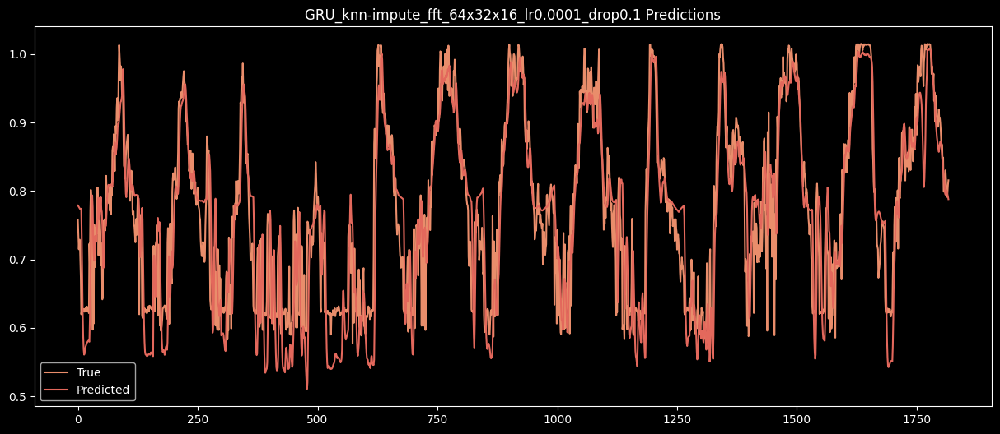

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
130   GRU_mean-impute_fft_64x32x16_lr0.01_drop0.25  0.044238  0.031072   
131  GRU_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.046927  0.034499   
132      GRU_knn-impute_fft_64x32_lr0.0001_drop0.1  0.060939  0.048110   
133   GRU_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.070140  0.053274   
134   GRU_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.062350  0.047474   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_149"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_175 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_253 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_176 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_254 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_177 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_69 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_292 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_293 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 11s 13ms/step - loss: 0.1826 - root_mean_squared_error: 0.3751 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0450
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0114 - root_mean_squared_error: 0.1065 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0384
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0061 - root_mean_squared_error: 0.0779 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0375
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0044 - root_mean_squared_error: 0.0662 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0386
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0037 - root_mean_squared_error: 0.0609 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0364
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0029 - root_mean_squared_error: 0.0540 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0380
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12

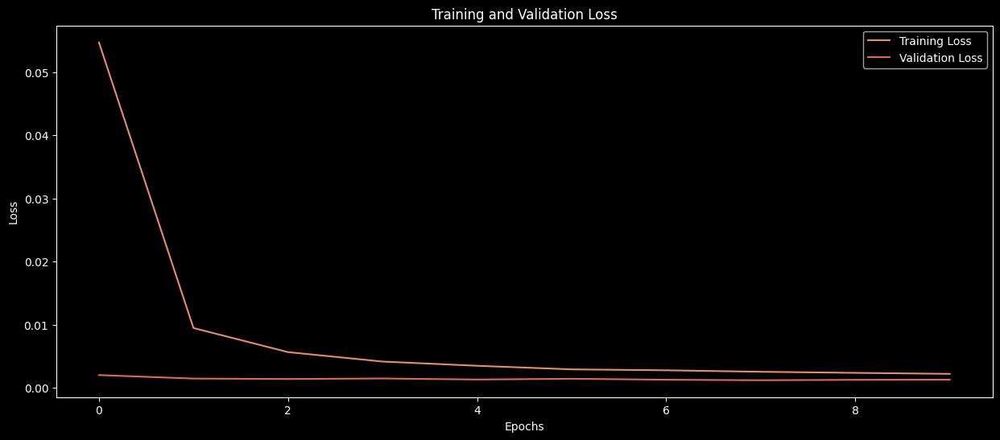

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


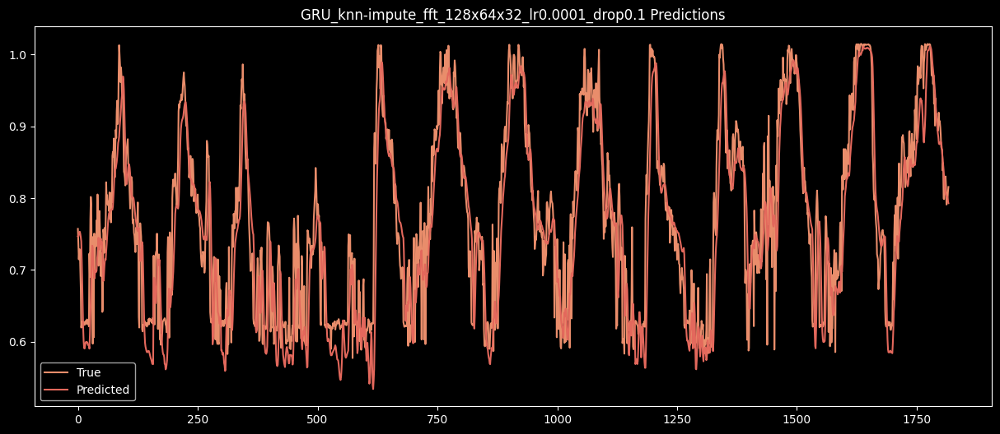

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
131  GRU_mean-impute_fft_128x64x32_lr0.01_drop0.25  0.046927  0.034499   
132      GRU_knn-impute_fft_64x32_lr0.0001_drop0.1  0.060939  0.048110   
133   GRU_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.070140  0.053274   
134   GRU_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.062350  0.047474   
135  GRU_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.058768  0.044822   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_150"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_178 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_255 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_179 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_70 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_294 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_295 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0398 - root_mean_squared_error: 0.1805 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0382
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0029 - root_mean_squared_error: 0.0541 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0021 - root_mean_squared_error: 0.0457 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0372
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0449 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0324
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 9.9937e-04 - val_root_mean_squared_error: 0.0316
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0018 - root_mean_squared_error: 0.0430 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0343
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/s

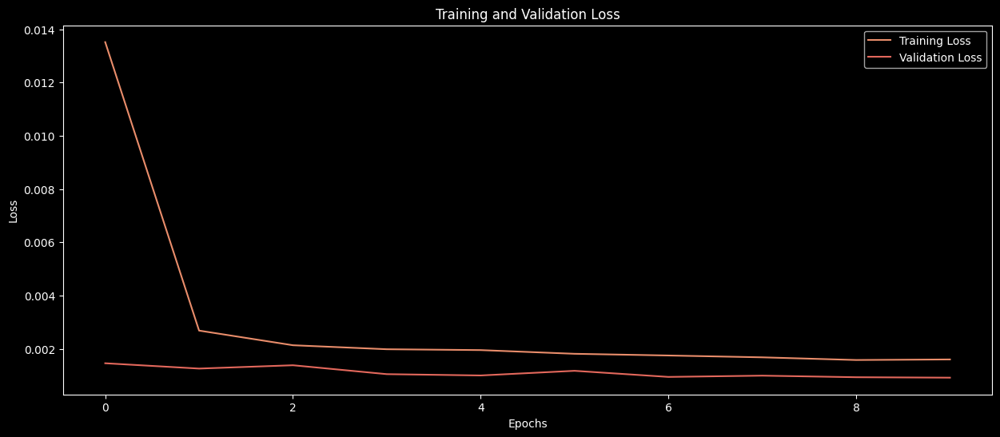

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


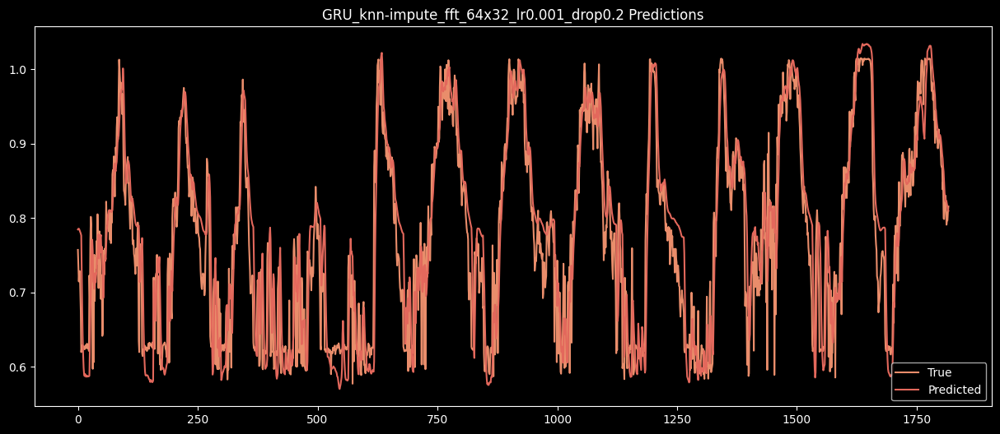

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
132      GRU_knn-impute_fft_64x32_lr0.0001_drop0.1  0.060939  0.048110   
133   GRU_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.070140  0.053274   
134   GRU_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.062350  0.047474   
135  GRU_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.058768  0.044822   
136       GRU_knn-impute_fft_64x32_lr0.001_drop0.2  0.055218  0.042532   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_151"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_180 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_256 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_181 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_257 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_182 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_71 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_296 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_297 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 15s 14ms/step - loss: 0.0269 - root_mean_squared_error: 0.1500 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0395
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0030 - root_mean_squared_error: 0.0544 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0378
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0023 - root_mean_squared_error: 0.0479 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0020 - root_mean_squared_error: 0.0450 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0335
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0018 - root_mean_squared_error: 0.0429 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0406
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0018 - root_mean_squared_error: 0.0424 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0328
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12

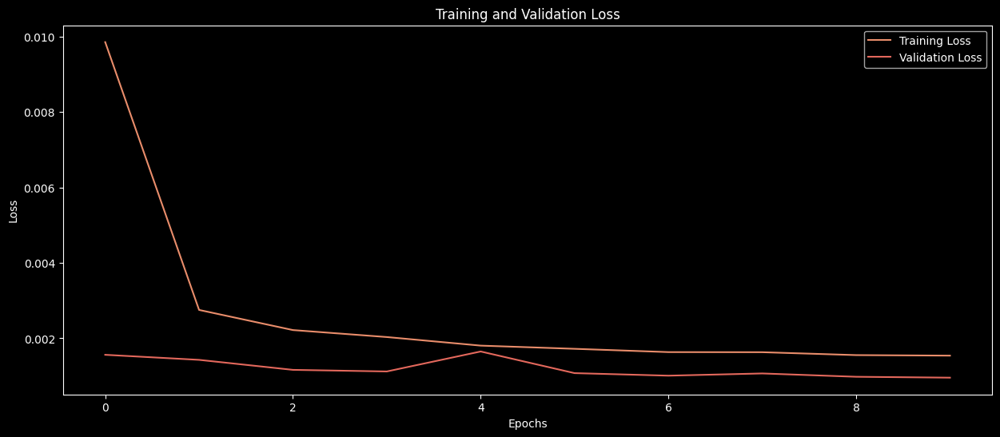

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


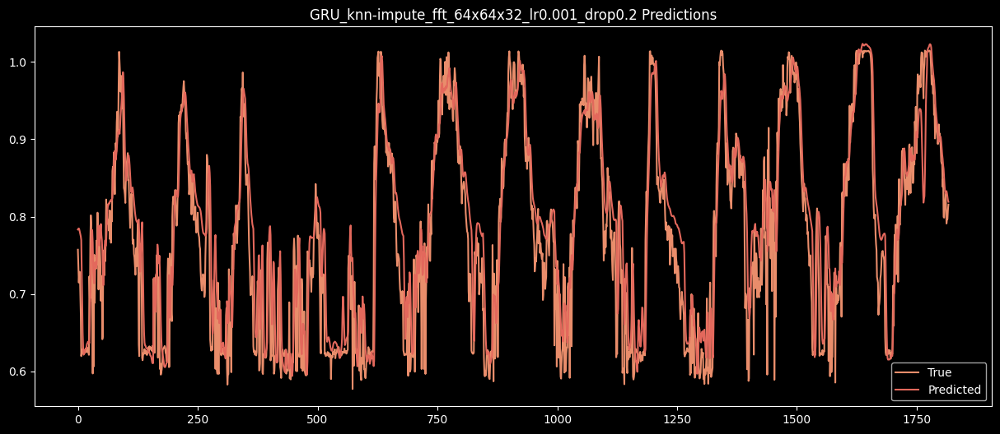

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
133   GRU_knn-impute_fft_64x64x32_lr0.0001_drop0.1  0.070140  0.053274   
134   GRU_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.062350  0.047474   
135  GRU_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.058768  0.044822   
136       GRU_knn-impute_fft_64x32_lr0.001_drop0.2  0.055218  0.042532   
137    GRU_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.056428  0.042100   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_152"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_183 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_258 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_184 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_259 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_185 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_72 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_298 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_299 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.0243 - root_mean_squared_error: 0.1454 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0438
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0034 - root_mean_squared_error: 0.0579 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0436
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0026 - root_mean_squared_error: 0.0511 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0474 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0334
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0467 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0021 - root_mean_squared_error: 0.0460 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0330
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10

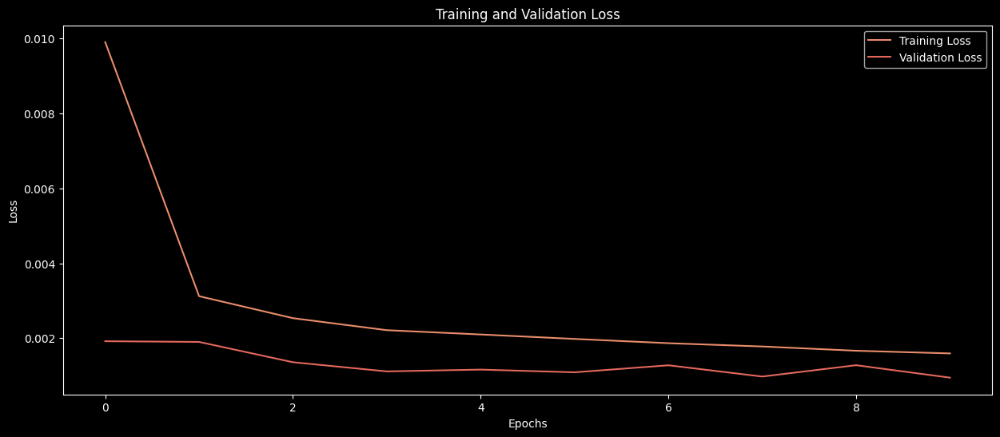

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


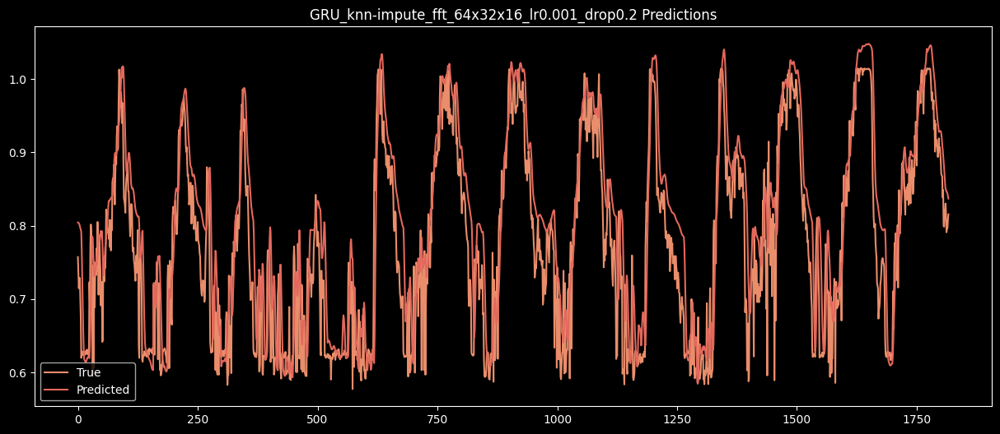

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
134   GRU_knn-impute_fft_64x32x16_lr0.0001_drop0.1  0.062350  0.047474   
135  GRU_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.058768  0.044822   
136       GRU_knn-impute_fft_64x32_lr0.001_drop0.2  0.055218  0.042532   
137    GRU_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.056428  0.042100   
138    GRU_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.066549  0.051760   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_153"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_186 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_260 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_187 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_261 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_188 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_73 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_300 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_301 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 12s 16ms/step - loss: 0.0917 - root_mean_squared_error: 0.2570 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0415
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0034 - root_mean_squared_error: 0.0581 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0464
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - loss: 0.0026 - root_mean_squared_error: 0.0512 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0355
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0024 - root_mean_squared_error: 0.0485 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0358
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0331
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - loss: 0.0020 - root_mean_squared_error: 0.0445 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0318
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 15

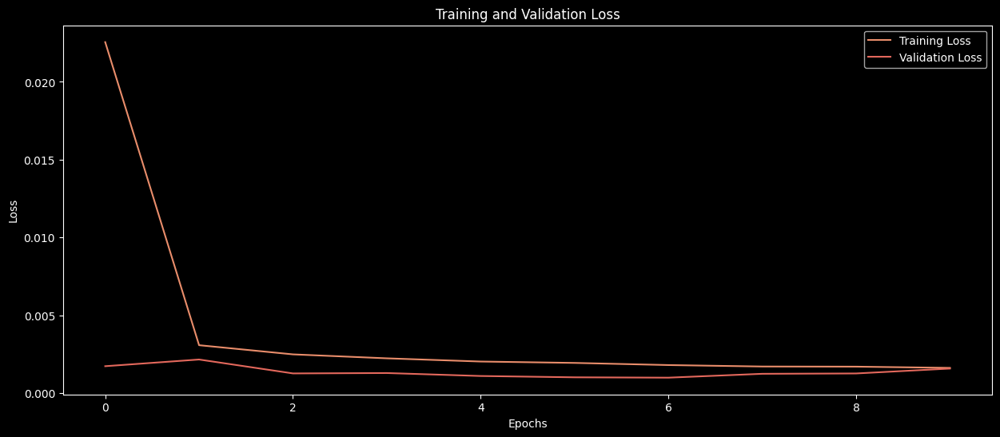

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step


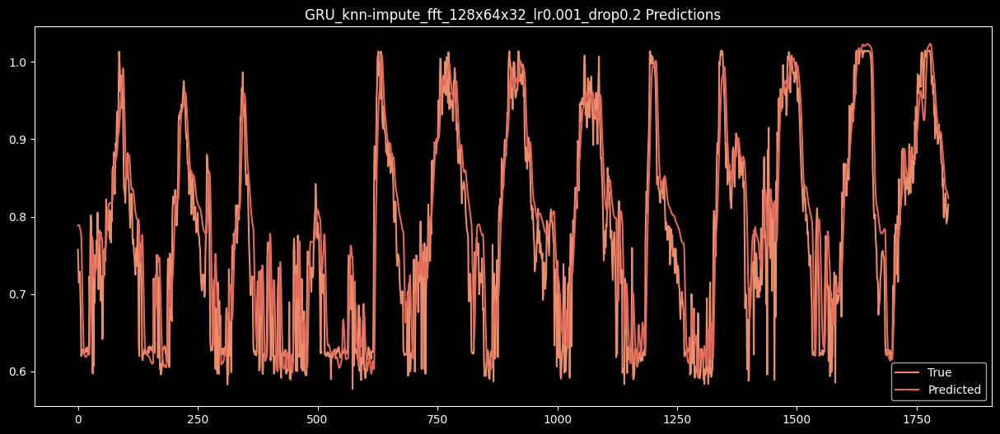

                                             Model      RMSE       MAE  \
0             LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1          LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2          LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3         LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4              LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                             ...       ...       ...   
135  GRU_knn-impute_fft_128x64x32_lr0.0001_drop0.1  0.058768  0.044822   
136       GRU_knn-impute_fft_64x32_lr0.001_drop0.2  0.055218  0.042532   
137    GRU_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.056428  0.042100   
138    GRU_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.066549  0.051760   
139   GRU_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.058341  0.043923   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_154"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_189 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_262 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_190 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_74 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_302 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_303 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,361 (106.88 KB)

 Trainable params: 27,361 (106.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - loss: 0.2608 - root_mean_squared_error: 0.4215 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0370
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0023 - root_mean_squared_error: 0.0476 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0339
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0020 - root_mean_squared_error: 0.0448 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0349
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0018 - root_mean_squared_error: 0.0428 - val_loss: 0.0010 - val_root_mean_squared_error: 0.0323
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0418 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0326
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - loss: 0.0017 - root_mean_squared_error: 0.0406 - val_loss: 0.0016 - val_root_mean_squared_error: 0.0403
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step 

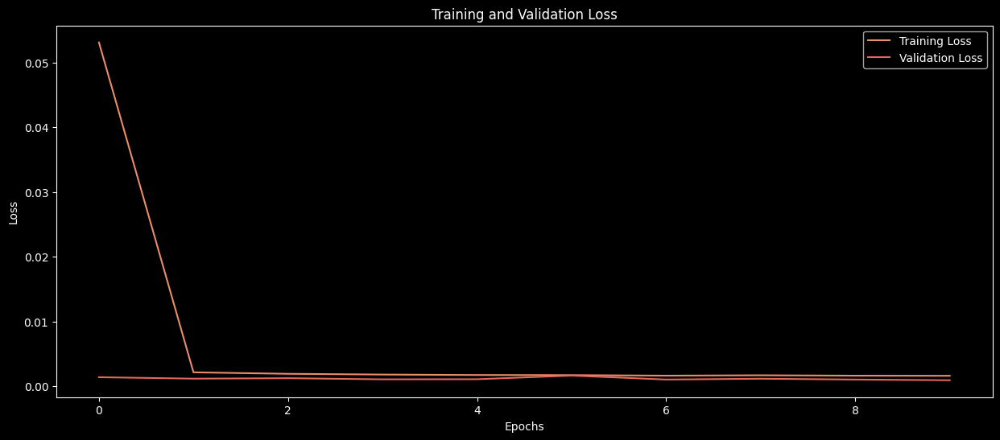

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


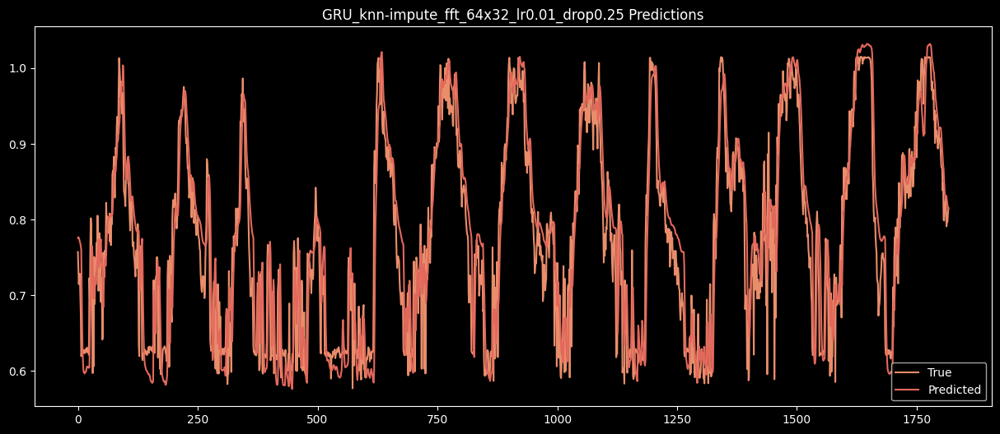

                                            Model      RMSE       MAE  \
0            LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1         LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2         LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3        LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4             LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                            ...       ...       ...   
136      GRU_knn-impute_fft_64x32_lr0.001_drop0.2  0.055218  0.042532   
137   GRU_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.056428  0.042100   
138   GRU_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.066549  0.051760   
139  GRU_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.058341  0.043923   
140      GRU_knn-impute_fft_64x32_lr0.01_drop0.25  0.053064  0.040878   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  
136  0.8139

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_155"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_191 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_263 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_192 (GRU)                   │ (None, 6, 64)          │        24,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_264 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_193 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_75 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_304 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_305 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,321 (204.38 KB)

 Trainable params: 52,321 (204.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 13ms/step - loss: 0.4054 - root_mean_squared_error: 0.5174 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0468
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0030 - root_mean_squared_error: 0.0550 - val_loss: 0.0015 - val_root_mean_squared_error: 0.0393
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0024 - root_mean_squared_error: 0.0487 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0369
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0022 - root_mean_squared_error: 0.0469 - val_loss: 0.0013 - val_root_mean_squared_error: 0.0363
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0020 - root_mean_squared_error: 0.0446 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0338
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 0.0019 - root_mean_squared_error: 0.0433 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 5s 12

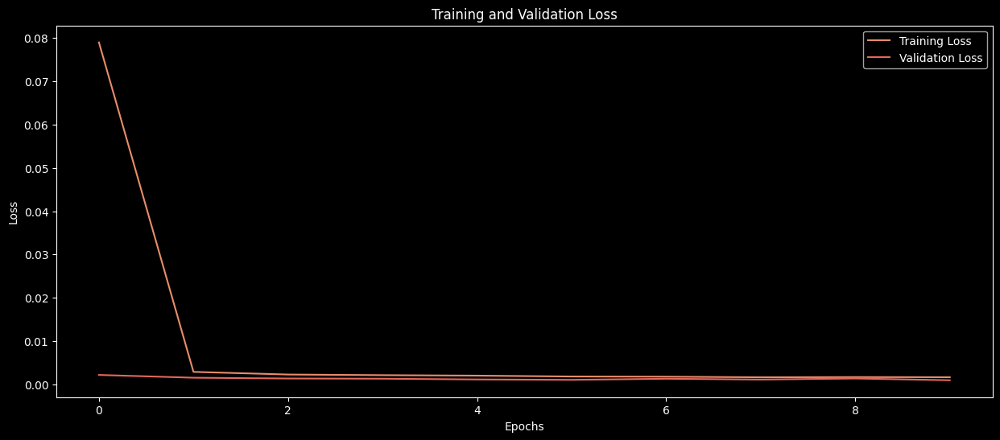

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


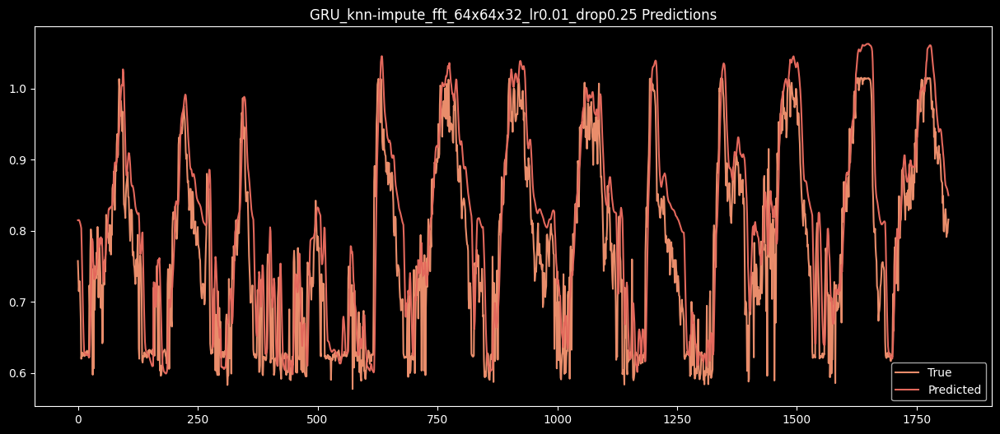

                                            Model      RMSE       MAE  \
0            LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1         LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2         LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3        LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4             LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                            ...       ...       ...   
137   GRU_knn-impute_fft_64x64x32_lr0.001_drop0.2  0.056428  0.042100   
138   GRU_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.066549  0.051760   
139  GRU_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.058341  0.043923   
140      GRU_knn-impute_fft_64x32_lr0.01_drop0.25  0.053064  0.040878   
141   GRU_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.070832  0.055841   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  
137  0.8057

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_156"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_194 (GRU)                   │ (None, 6, 64)          │        16,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_265 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_195 (GRU)                   │ (None, 6, 32)          │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_266 (Dropout)           │ (None, 6, 32)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_196 (GRU)                   │ (None, 16)             │         2,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_76 (FFTLayer)         │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_306 (Dense)               │ (None, 16)             │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_307 (Dense)               │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,561 (111.57 KB)

 Trainable params: 28,561 (111.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - loss: 0.1191 - root_mean_squared_error: 0.2881 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0431
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0028 - root_mean_squared_error: 0.0526 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0340
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0022 - root_mean_squared_error: 0.0464 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0325
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0019 - root_mean_squared_error: 0.0432 - val_loss: 0.0012 - val_root_mean_squared_error: 0.0341
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0018 - root_mean_squared_error: 0.0427 - val_loss: 9.8601e-04 - val_root_mean_squared_error: 0.0314
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - loss: 0.0017 - root_mean_squared_error: 0.0414 - val_loss: 9.3039e-04 - val_root_mean_squared_error: 0.0305
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━

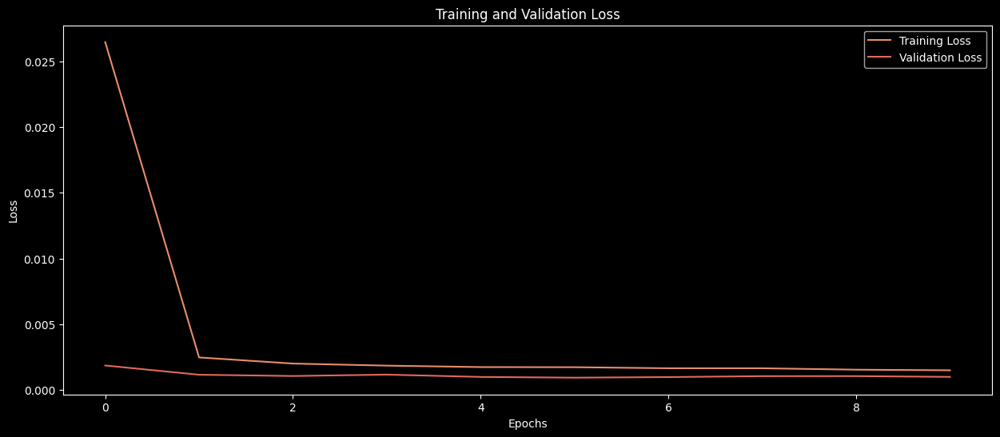

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


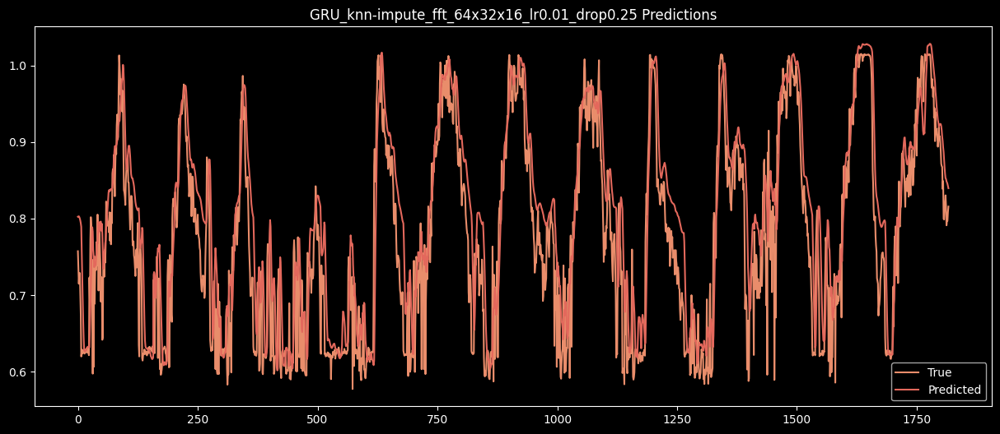

                                            Model      RMSE       MAE  \
0            LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1         LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2         LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3        LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4             LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                            ...       ...       ...   
138   GRU_knn-impute_fft_64x32x16_lr0.001_drop0.2  0.066549  0.051760   
139  GRU_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.058341  0.043923   
140      GRU_knn-impute_fft_64x32_lr0.01_drop0.25  0.053064  0.040878   
141   GRU_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.070832  0.055841   
142   GRU_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.064184  0.049392   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  
138  0.7298

c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_157"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_197 (GRU)                   │ (None, 6, 128)         │        57,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_267 (Dropout)           │ (None, 6, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_198 (GRU)                   │ (None, 6, 64)          │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_268 (Dropout)           │ (None, 6, 64)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_199 (GRU)                   │ (None, 32)             │         9,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fft_layer_77 (FFTLayer)         │ (None, 49)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_308 (Dense)               │ (None, 32)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_309 (Dense)               │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 105,505 (412.13 KB)

 Trainable params: 105,505 (412.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 12s 15ms/step - loss: 0.6934 - root_mean_squared_error: 0.6936 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0413
Epoch 2/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0031 - root_mean_squared_error: 0.0559 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0374
Epoch 3/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0026 - root_mean_squared_error: 0.0505 - val_loss: 0.0014 - val_root_mean_squared_error: 0.0372
Epoch 4/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0021 - root_mean_squared_error: 0.0461 - val_loss: 0.0017 - val_root_mean_squared_error: 0.0411
Epoch 5/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0021 - root_mean_squared_error: 0.0457 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0448
Epoch 6/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step - loss: 0.0021 - root_mean_squared_error: 0.0456 - val_loss: 0.0011 - val_root_mean_squared_error: 0.0333
Epoch 7/20
433/433 ━━━━━━━━━━━━━━━━━━━━ 6s 14

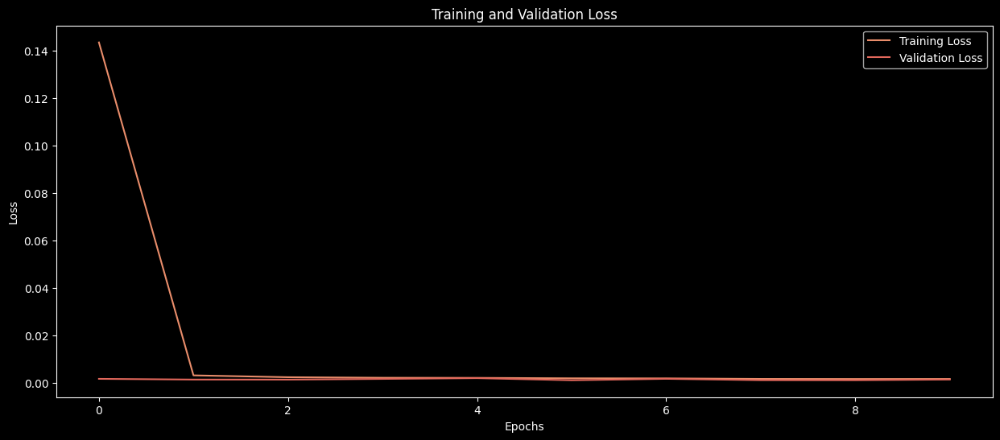

57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


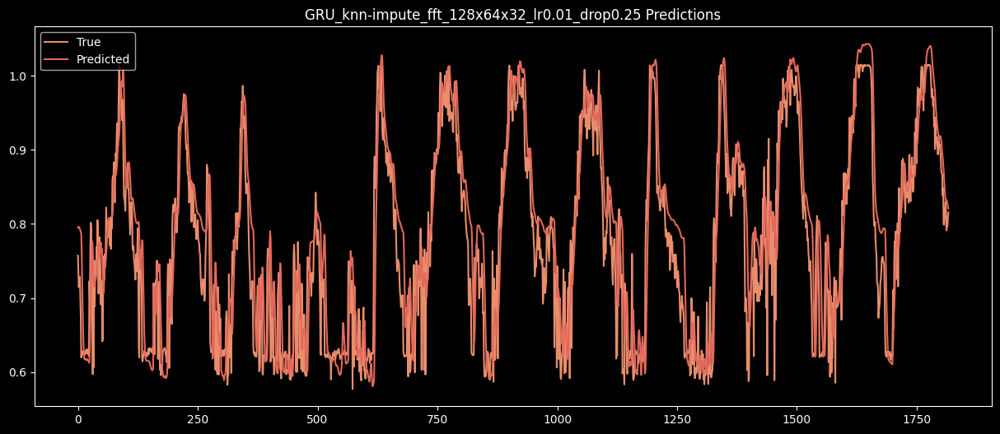

                                            Model      RMSE       MAE  \
0            LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1         LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2         LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3        LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4             LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                            ...       ...       ...   
139  GRU_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.058341  0.043923   
140      GRU_knn-impute_fft_64x32_lr0.01_drop0.25  0.053064  0.040878   
141   GRU_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.070832  0.055841   
142   GRU_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.064184  0.049392   
143  GRU_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.060021  0.045896   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  
139  0.7923

In [127]:
gen_train_GRU(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.0001, 0.1,'knn-impute_fft',fft=True)
gen_train_GRU(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.001, 0.2,'knn-impute_fft',fft=True)
gen_train_GRU(X_train_knn, y_train_knn, X_valid_knn, y_valid_knn, model_sizes, 0.01, 0.25,'knn-impute_fft',fft=True)

In [128]:
print(all_results)

                                            Model      RMSE       MAE  \
0            LSTM_noimpute_64x32_lr0.0001_drop0.1  0.044084  0.031364   
1         LSTM_noimpute_64x64x32_lr0.0001_drop0.1  0.065746  0.051667   
2         LSTM_noimpute_64x32x16_lr0.0001_drop0.1  0.067521  0.051825   
3        LSTM_noimpute_128x64x32_lr0.0001_drop0.1  0.063888  0.048493   
4             LSTM_noimpute_64x32_lr0.001_drop0.2  0.039583  0.027539   
..                                            ...       ...       ...   
139  GRU_knn-impute_fft_128x64x32_lr0.001_drop0.2  0.058341  0.043923   
140      GRU_knn-impute_fft_64x32_lr0.01_drop0.25  0.053064  0.040878   
141   GRU_knn-impute_fft_64x64x32_lr0.01_drop0.25  0.070832  0.055841   
142   GRU_knn-impute_fft_64x32x16_lr0.01_drop0.25  0.064184  0.049392   
143  GRU_knn-impute_fft_128x64x32_lr0.01_drop0.25  0.060021  0.045896   

           R2  
0    0.860394  
1    0.689495  
2    0.672503  
3    0.706795  
4    0.887449  
..        ...  
139  0.7923